In [1]:
import os
import sys
sys.path.append(os.path.expanduser("~"))
from camel_dataloader import get_astro_data,get_astro_data_2D_from_3D
from utils import draw_figure, compute_pk, plot_residual
from UNet_apply import applyCNN, applyCNN_TF
import comet_ml
import torch
from torch import nn
from torch.nn.functional import mse_loss, l1_loss
import torch.nn as nn
import torch.nn.functional as F
import torch.fft as fft
from torch import autograd, Tensor
from lightning.pytorch import LightningModule, Trainer, seed_everything
from lightning.pytorch.loggers import CometLogger
from lightning.pytorch.callbacks import LearningRateMonitor, ModelCheckpoint
from typing import Optional, Tuple
from torch.special import expm1
from tqdm import trange
from torch.distributions.normal import Normal
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.ticker import FormatStrFormatter
import Pk_library as PKL

device = torch.device("cuda") if torch.cuda.is_available() else "mps"
print(device)
colors = [(0, 'blue'), (0.5, 'white'), (1, 'red')]
cmap = LinearSegmentedColormap.from_list('custom', colors)

vmin = -2.0
vmax = 2.0


[rank: 0] Seed set to 7


cuda
cuda


In [44]:
import importlib
import UNet_apply
import camel_dataloader
import utils
importlib.reload(UNet_apply) 
importlib.reload(camel_dataloader) 
from camel_dataloader import get_astro_data,get_astro_data_2D_from_3D
from utils import draw_figure, compute_pk, plot_residual

from UNet_apply import applyCNN, applyCNN_TF

[rank: 0] Seed set to 7


cuda


In [2]:
cropsize = 256
batch_size = 12
num_workers = 8
   
dataset = 'Astrid'

In [3]:
dm_25_thick = get_astro_data(
        dataset,
        num_workers=num_workers,
        batch_size=batch_size,
    )

In [7]:
path = '/pscratch/sd/l/lindajin/LOGS/baryonize_DM/62ce892d8ce84414ad1d864f0b3c09a3/checkpoints/latest-epoch=9-step=1750.ckpt'

# Testing UNet_apply

In [ ]:
conditioning, params, target = next(iter(dm_25_thick.test_dataloader()))
sample, _ = torch.vmap(lambda c, p: applyCNN(c, cond=True, params=p),
    randomness='same')(conditioning.unsqueeze(1), params.unsqueeze(1))

cpu

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.00 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Ti

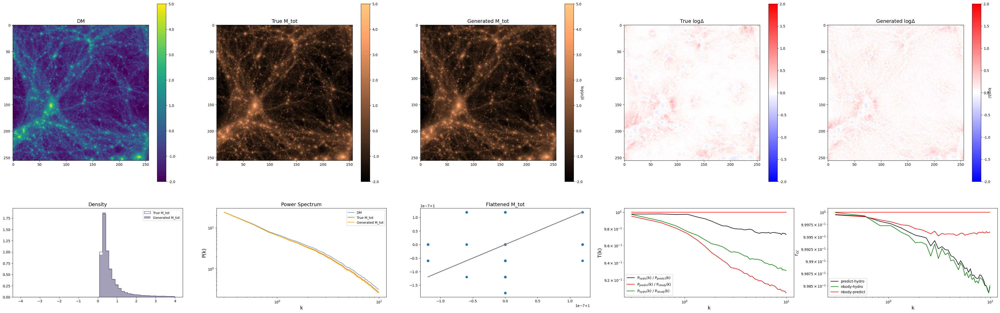

In [36]:
fig = draw_figure(target,sample.unsqueeze(1).detach().numpy(),conditioning,'Astrid')

In [33]:
print(f'l1_loss: {l1_loss(target,sample)}')

l1_loss: 0.09919463843107224


/tmp/ipykernel_54516/1600592569.py:1: UserWarning: Using a target size (torch.Size([50, 256, 256])) that is different to the input size (torch.Size([50, 1, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  print(f'l1_loss: {l1_loss(target,sample)}')


In [34]:
sample.mean(),sample.std()

(tensor(-1.3737e-10, grad_fn=<MeanBackward0>),
 tensor(0.3547, grad_fn=<StdBackward0>))

## Only L1 lr:5e-3

suite: Astrid


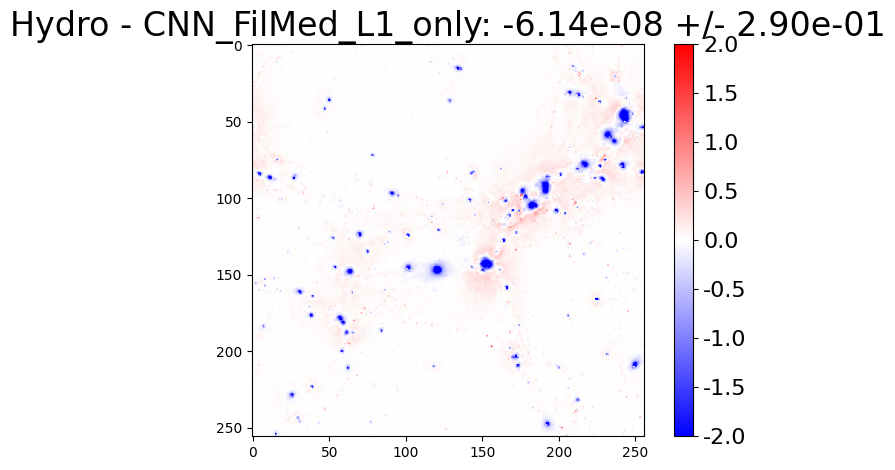

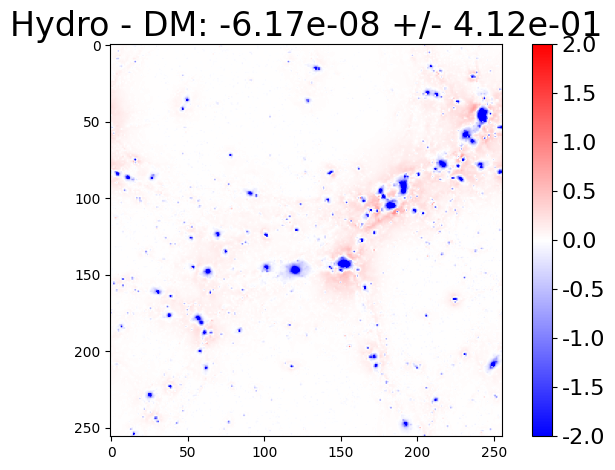


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


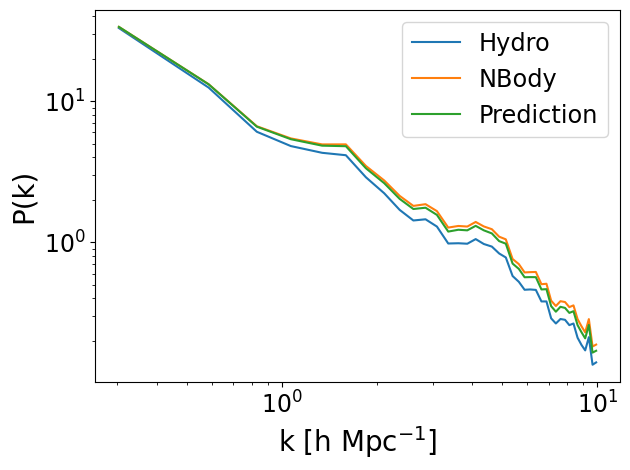

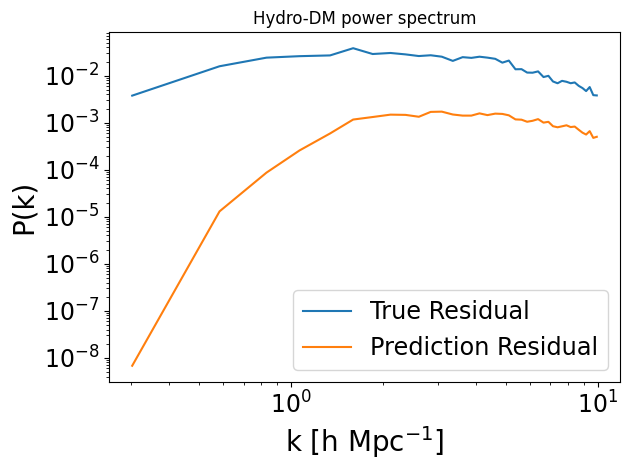

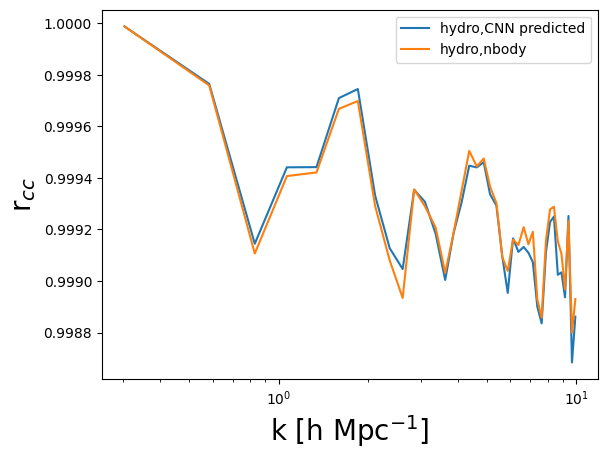

/tmp/ipykernel_1207862/915868940.py:107: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


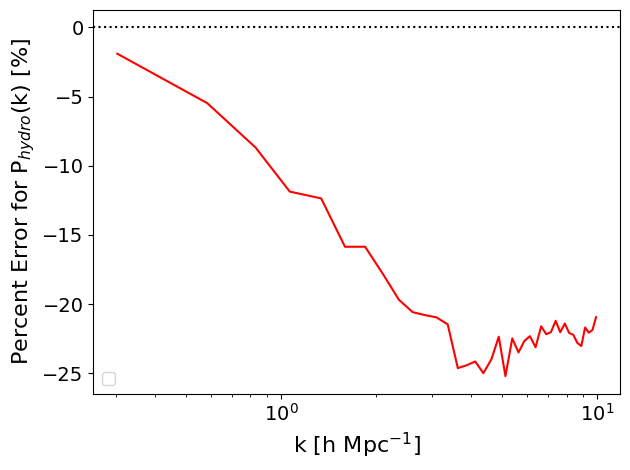

/tmp/ipykernel_1207862/915868940.py:117: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


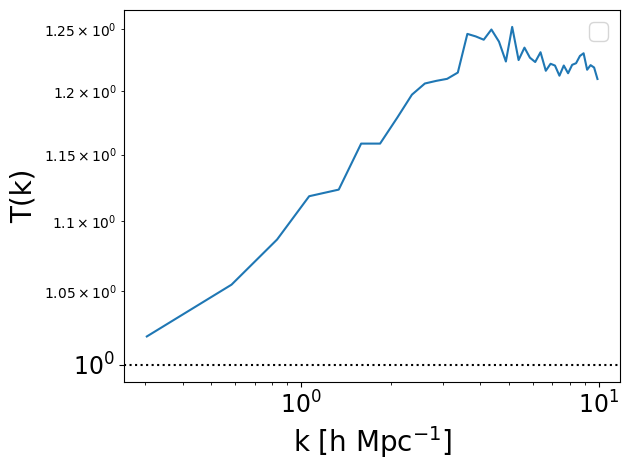

suite: Astrid


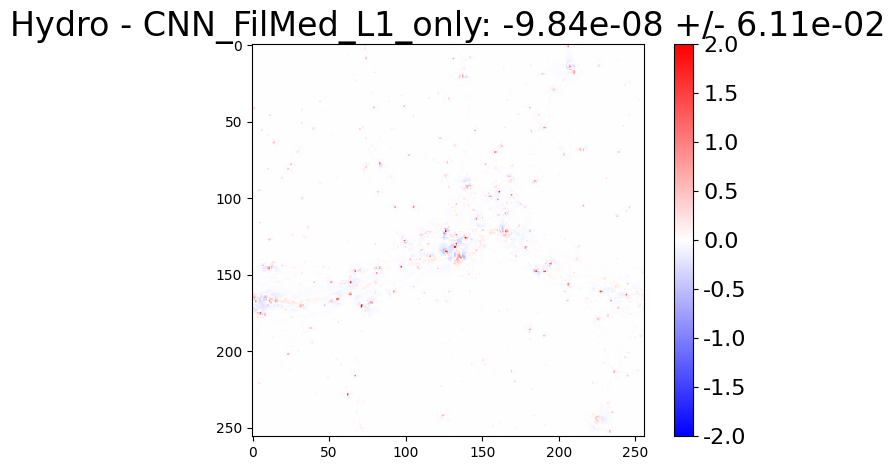

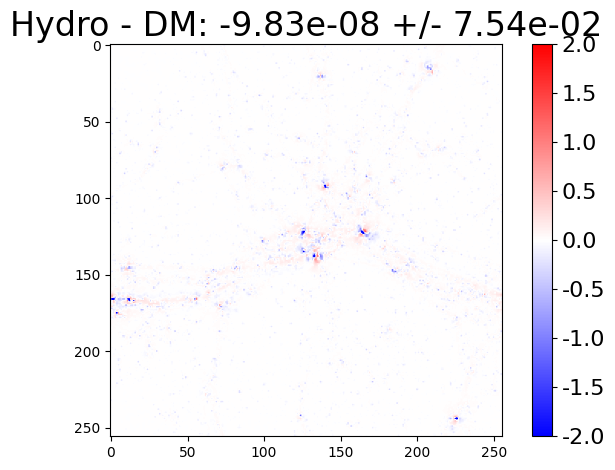


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


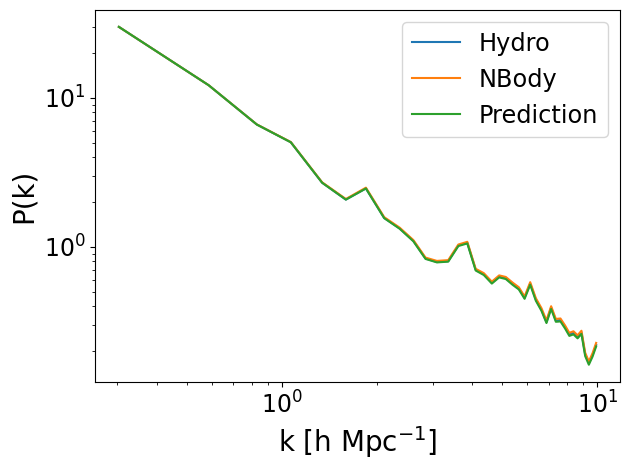

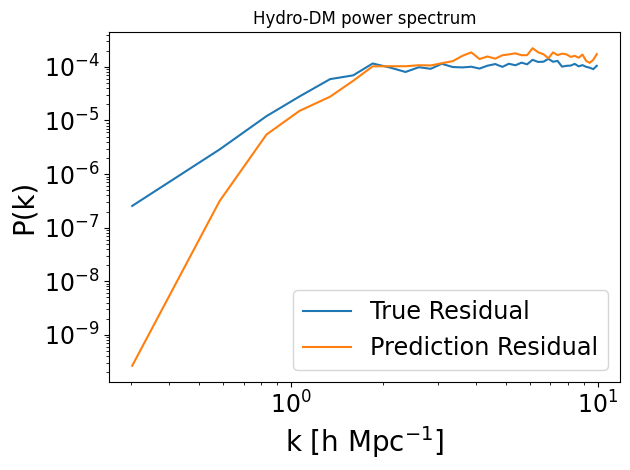

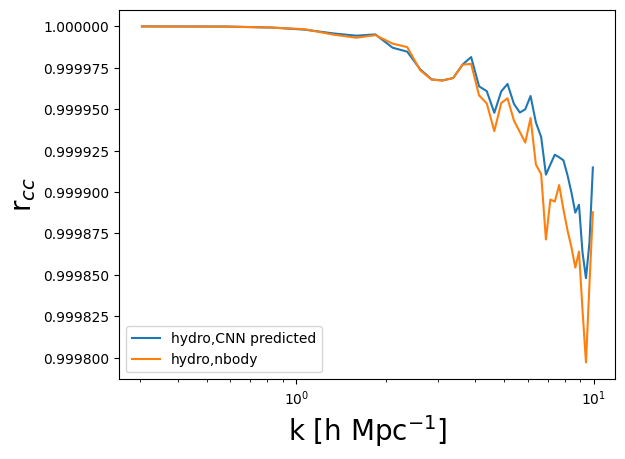

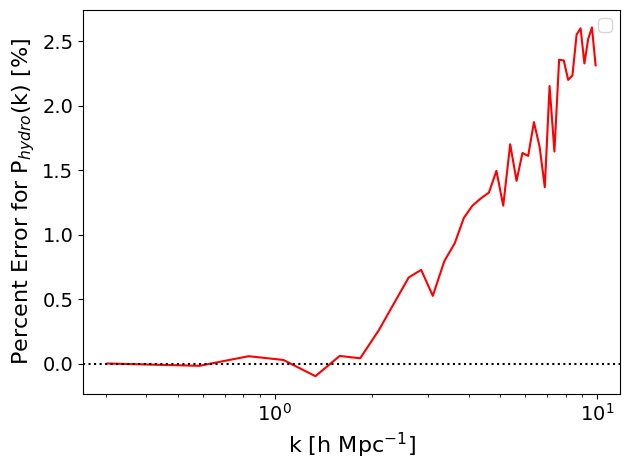

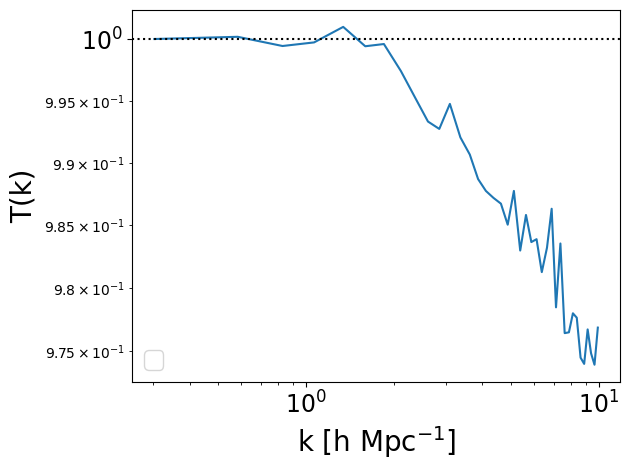

suite: Astrid


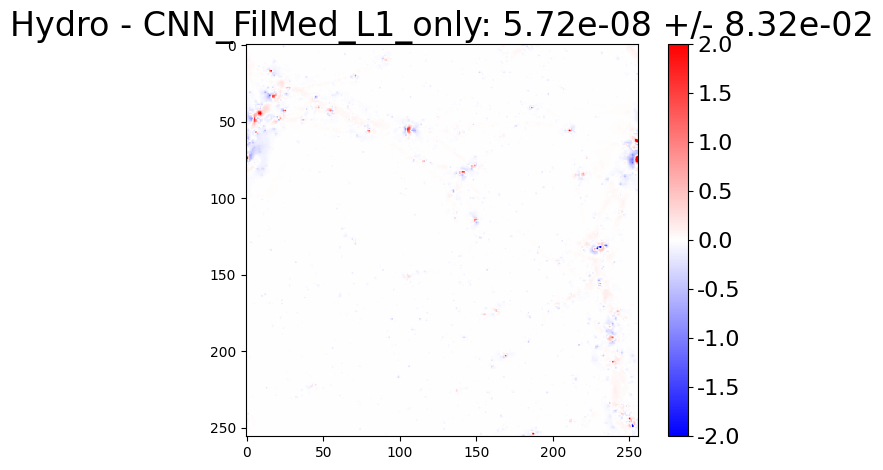

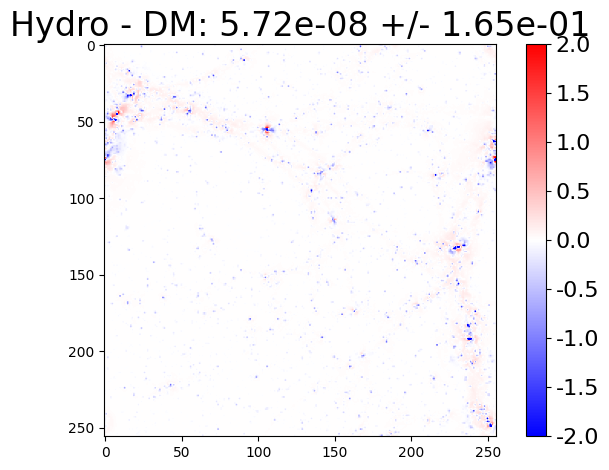


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


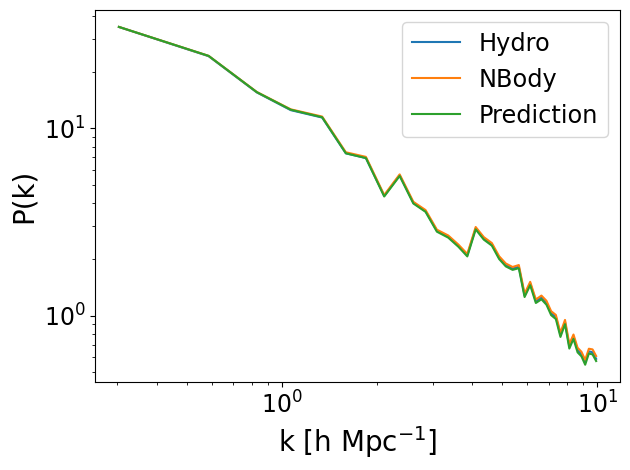

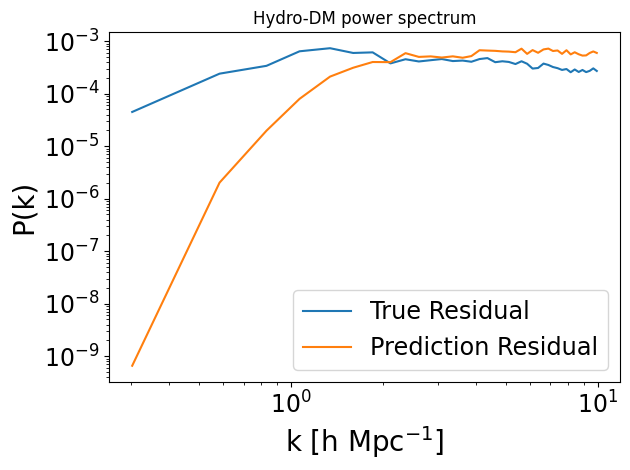

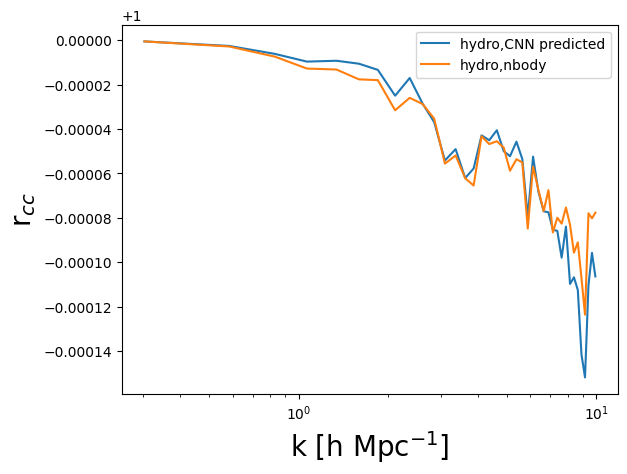

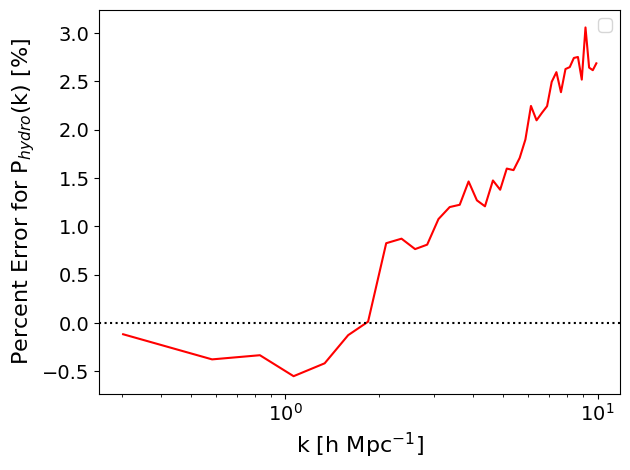

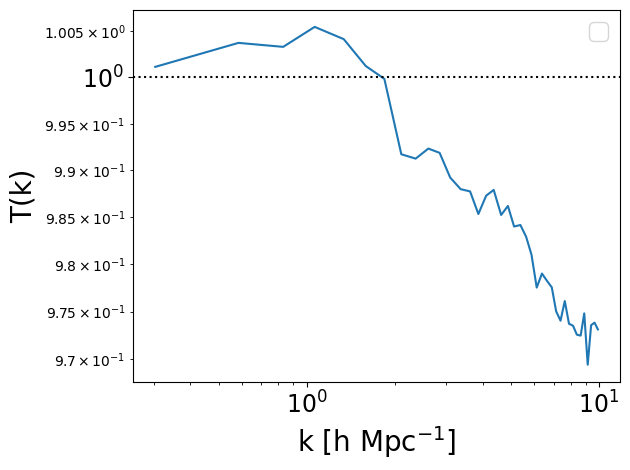

suite: Astrid


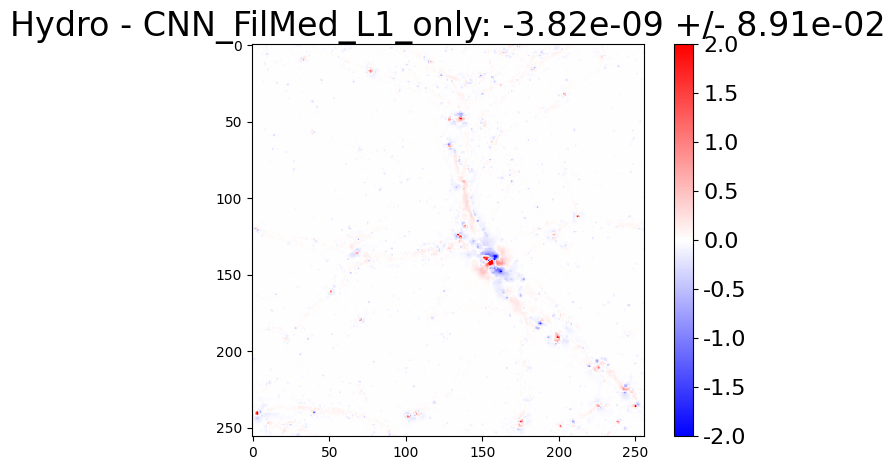

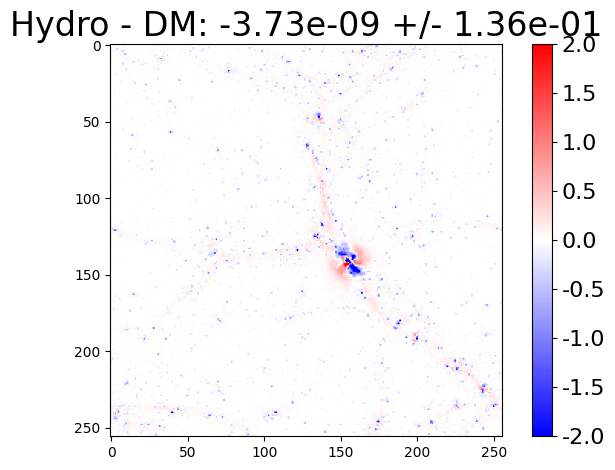


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


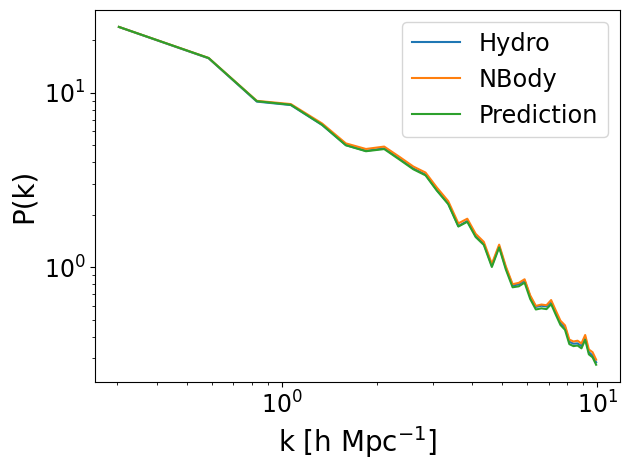

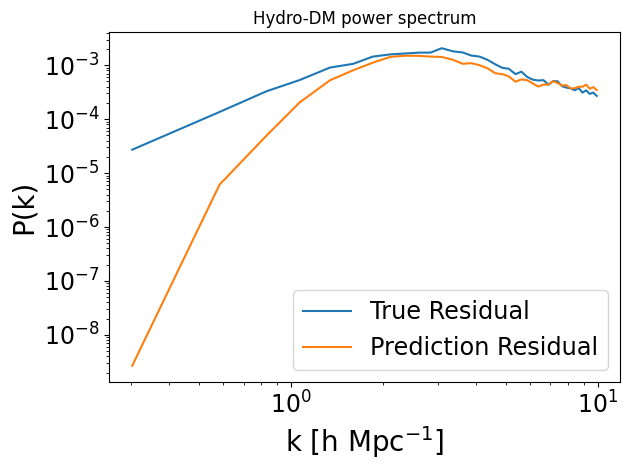

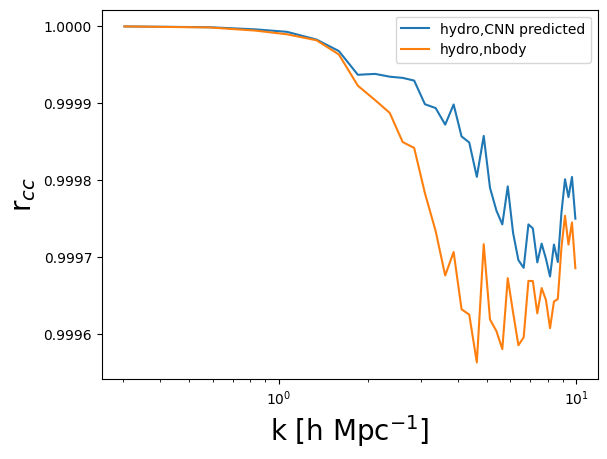

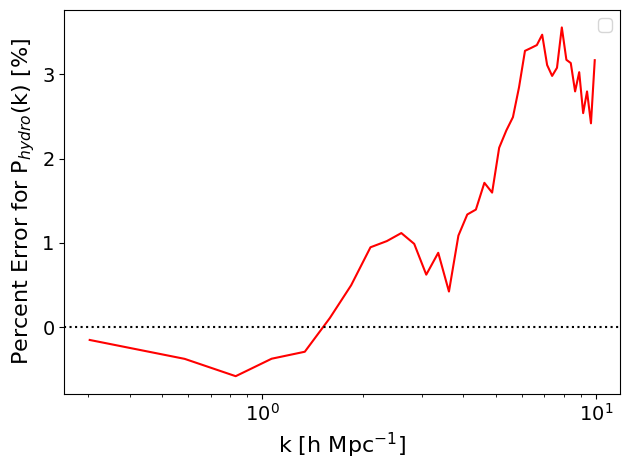

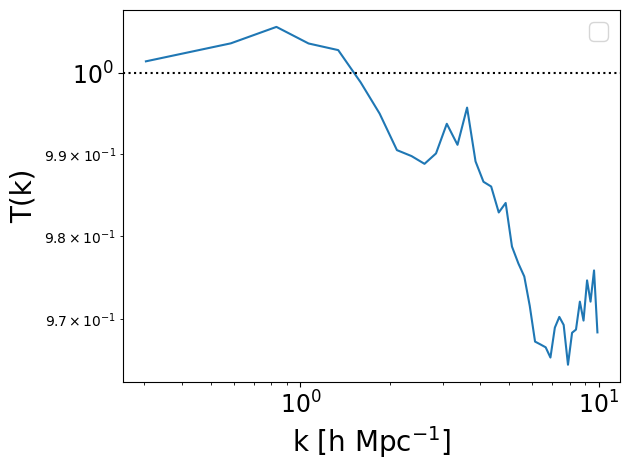

suite: Astrid


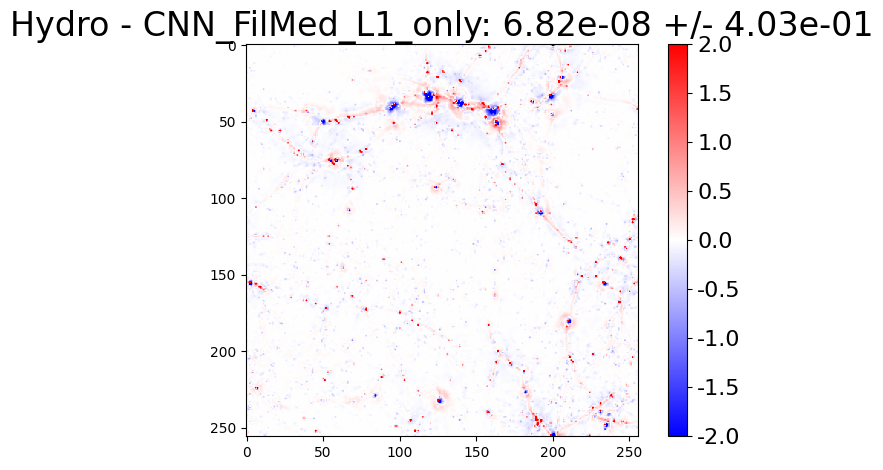

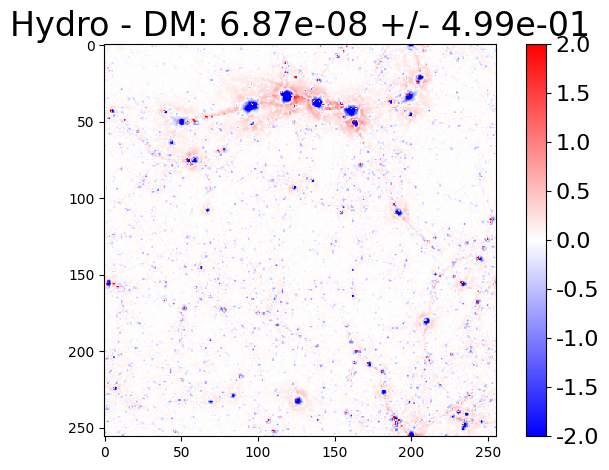


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


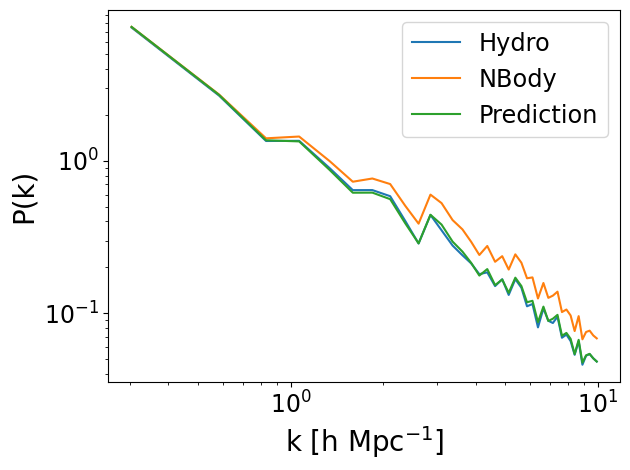

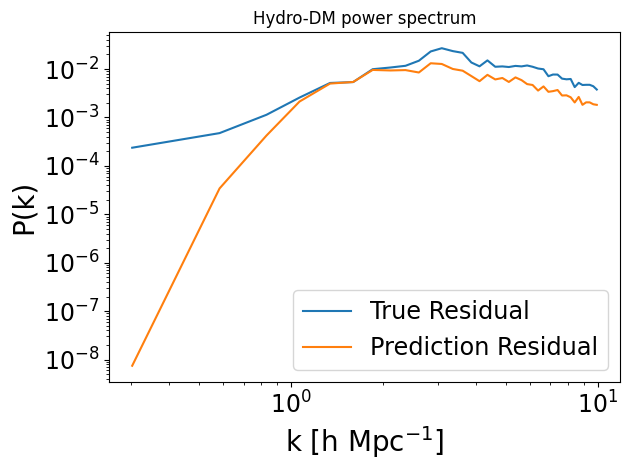

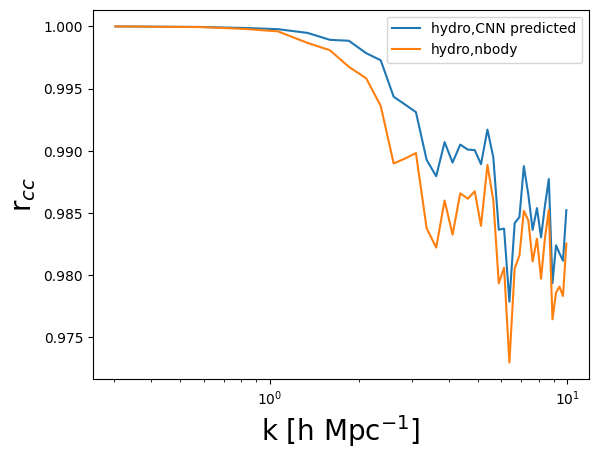

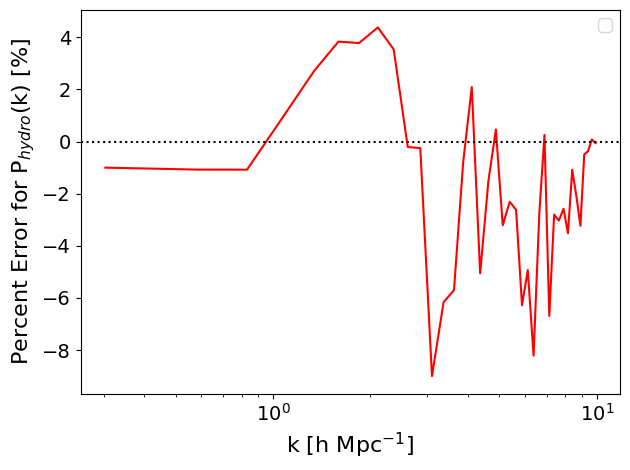

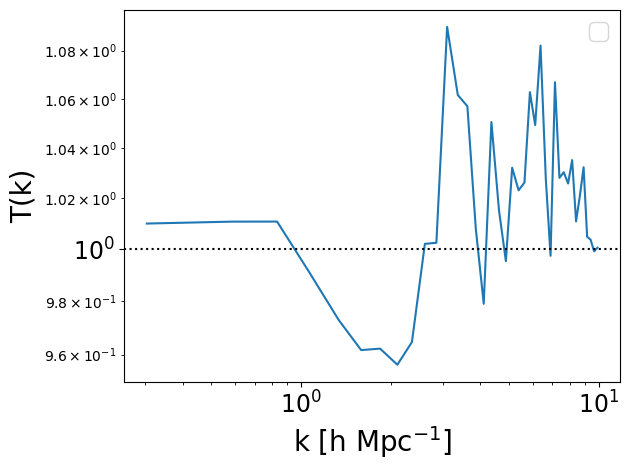

In [5]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_L1_only'

simulations = [0,10, 50,100, 200]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    #diff = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    #true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## Only Fourier [2,20]*1e-4 lr:5e-3
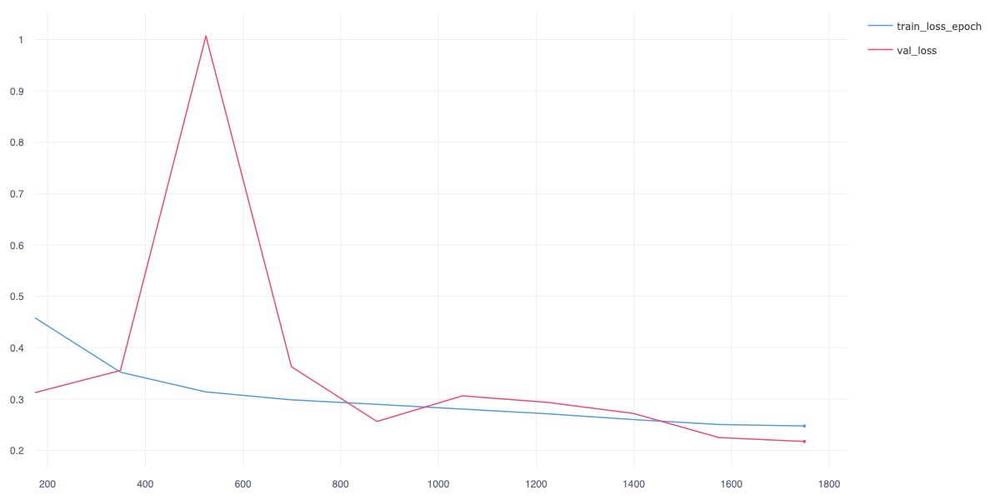

suite: Astrid


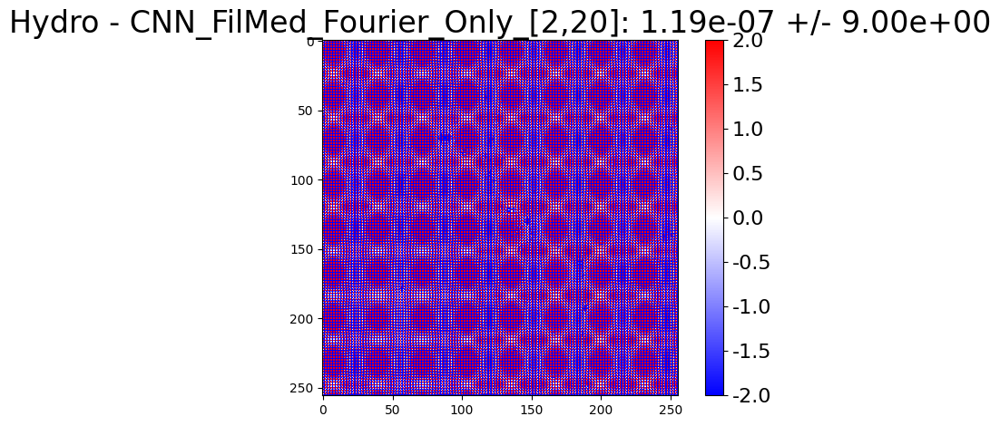

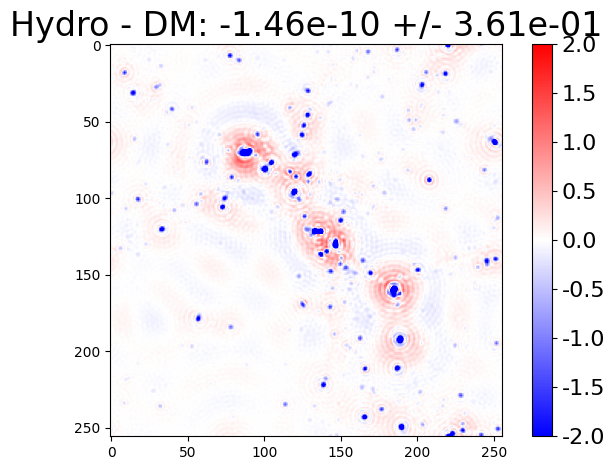


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


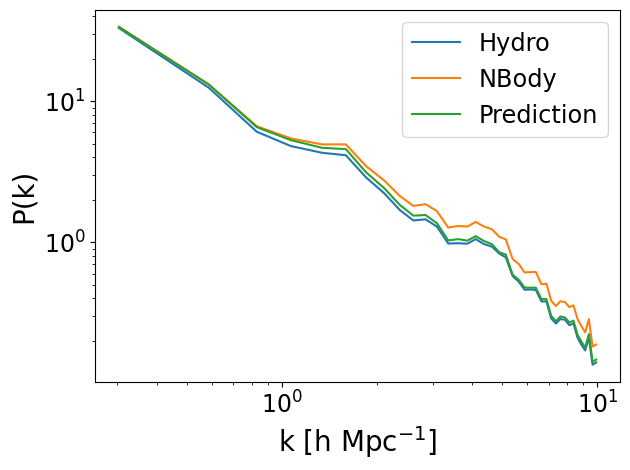

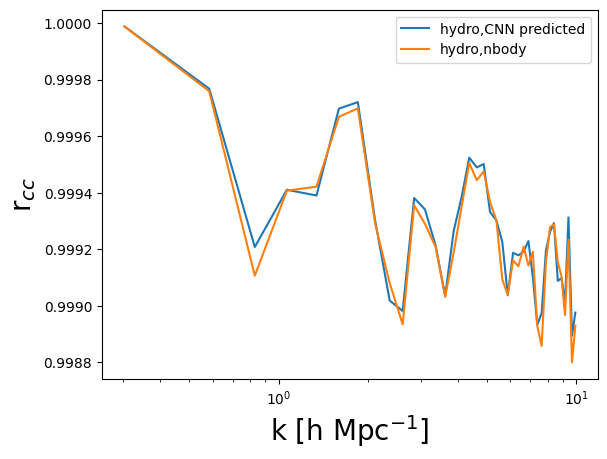

/tmp/ipykernel_415464/3632366390.py:96: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


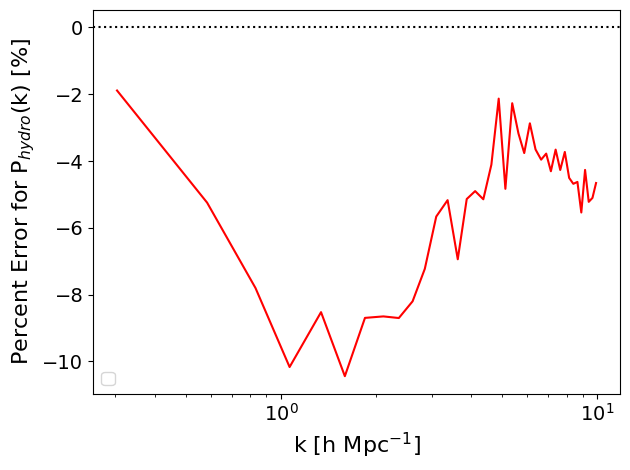

/tmp/ipykernel_415464/3632366390.py:106: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


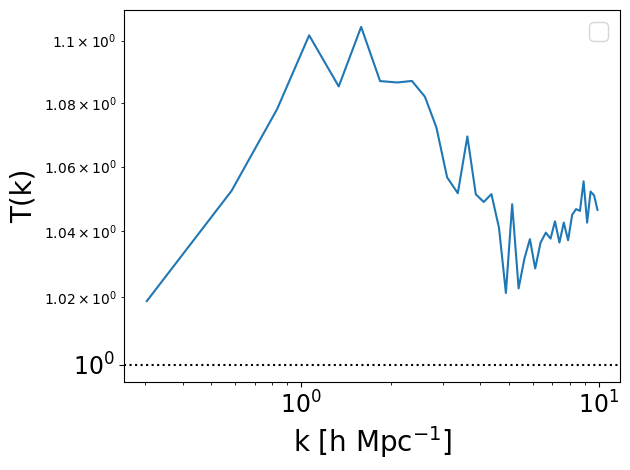

suite: Astrid


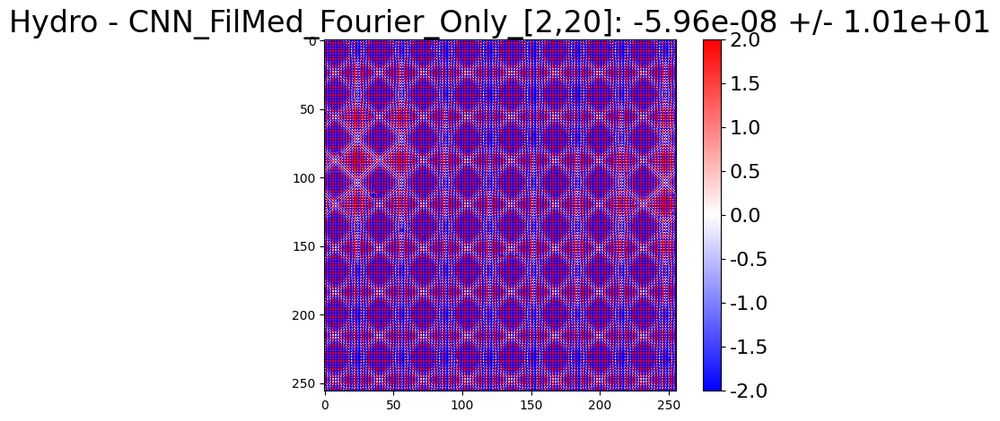

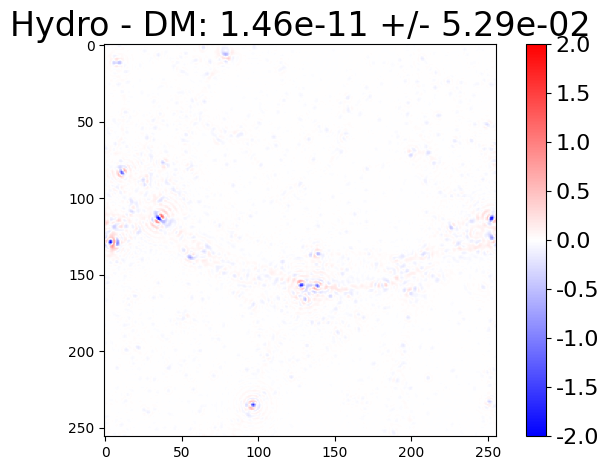


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


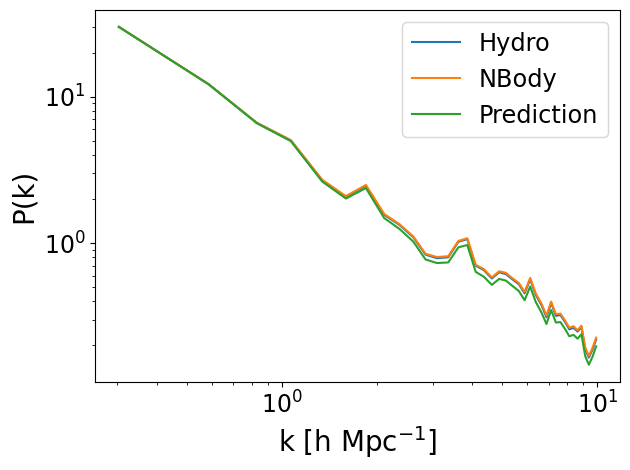

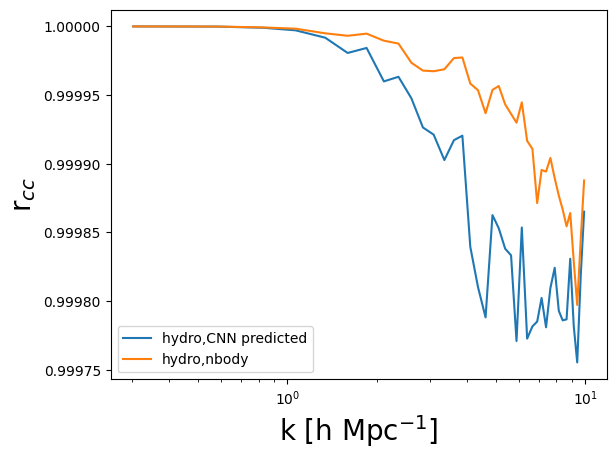

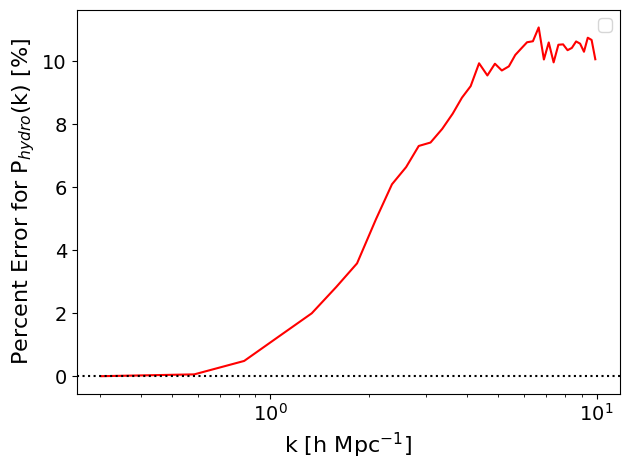

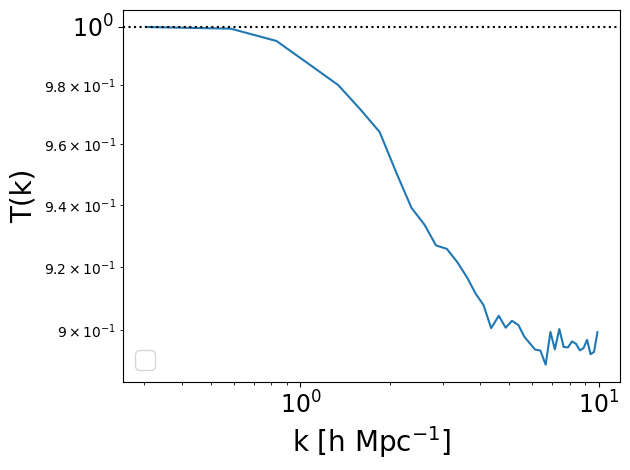

suite: Astrid


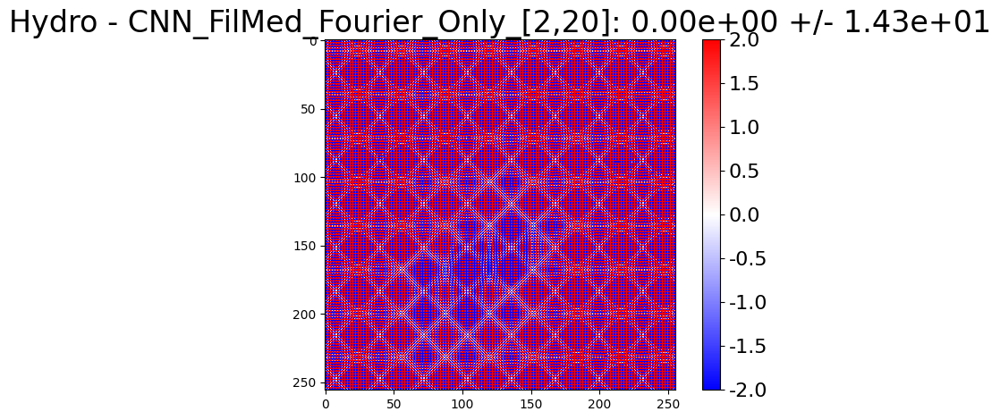

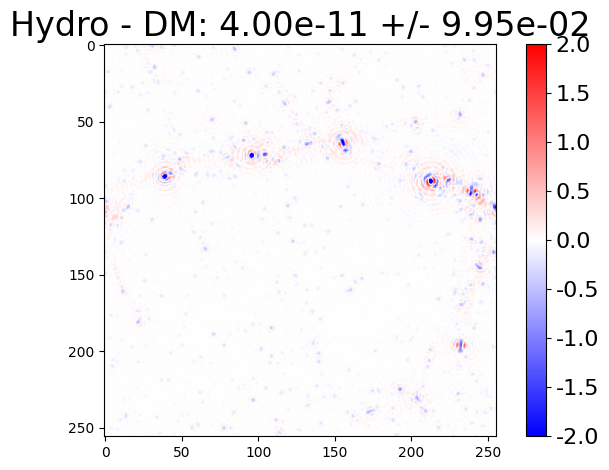


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


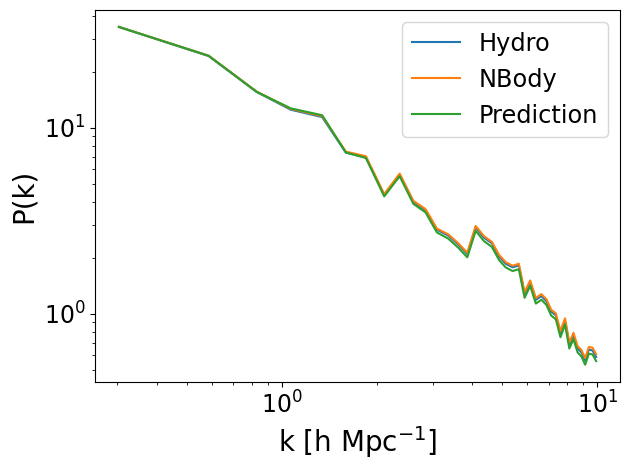

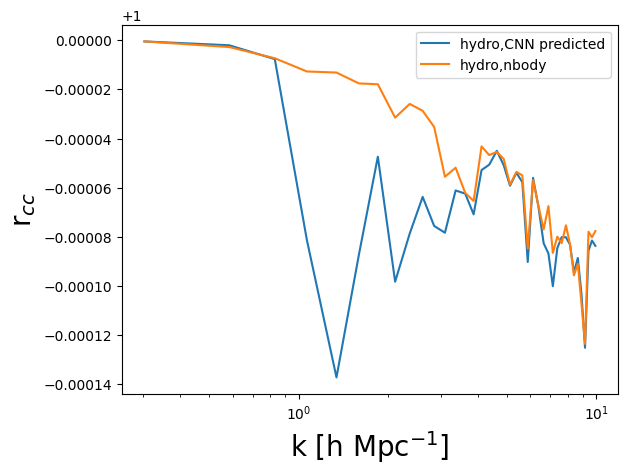

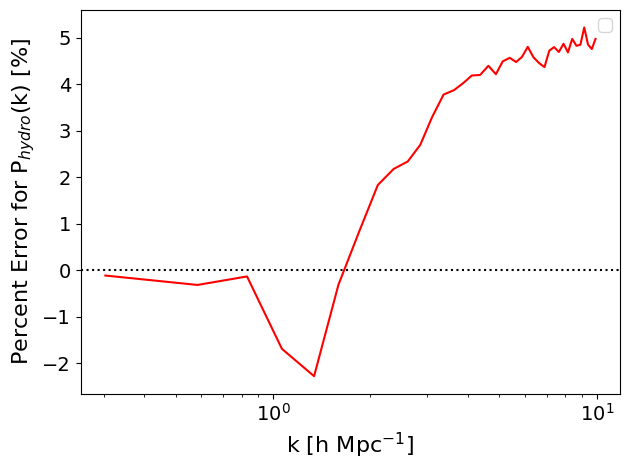

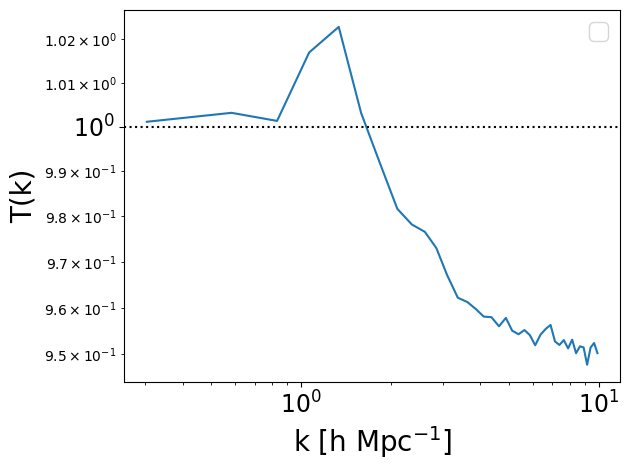

suite: Astrid


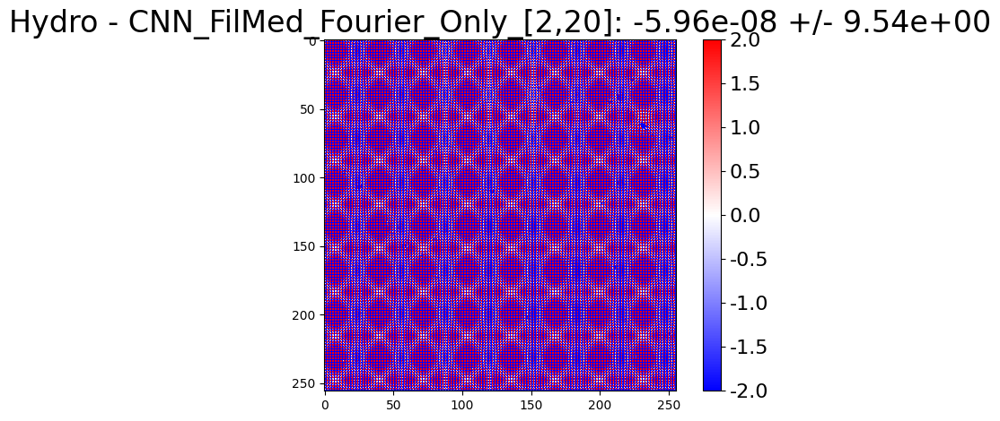

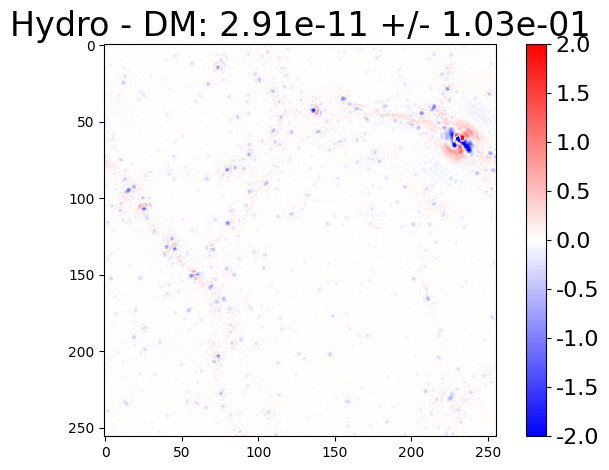


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


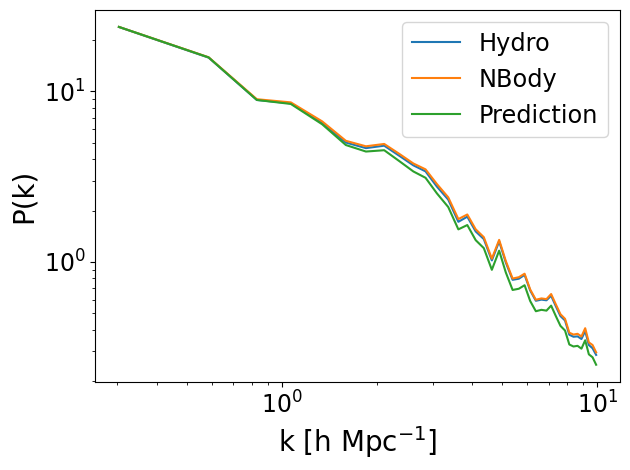

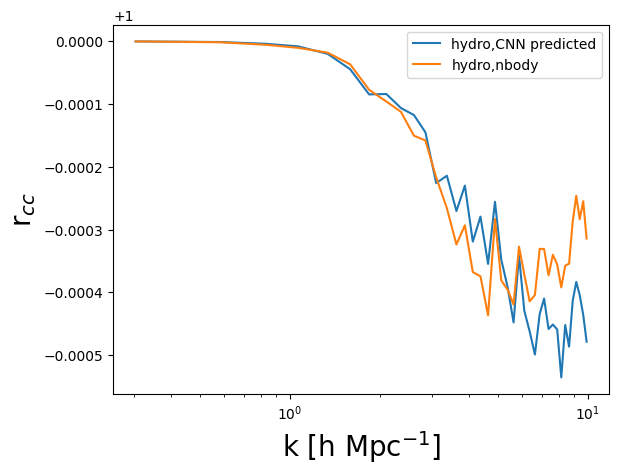

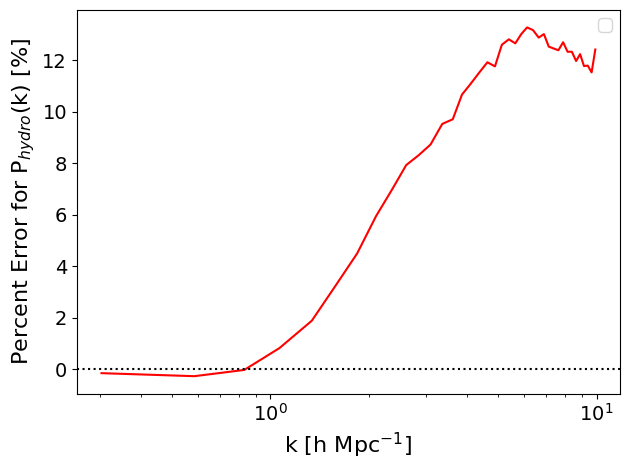

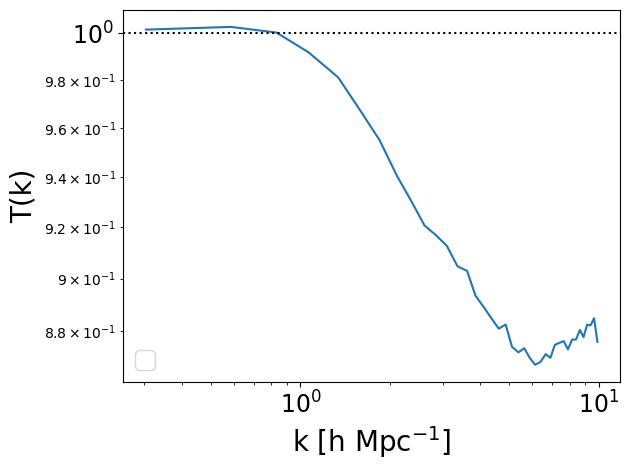

In [24]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_Fourier_Only_[2,20]'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
filter_mask = torch.zeros_like(k)
filter_mask[(k >= 2) & (k <= 20)] = 1
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0,10, 50,100]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = residual_grid.reshape(256,256)
    filtered_image = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## Only Fourier [2,20]*1e-4  **lr:1e-4**
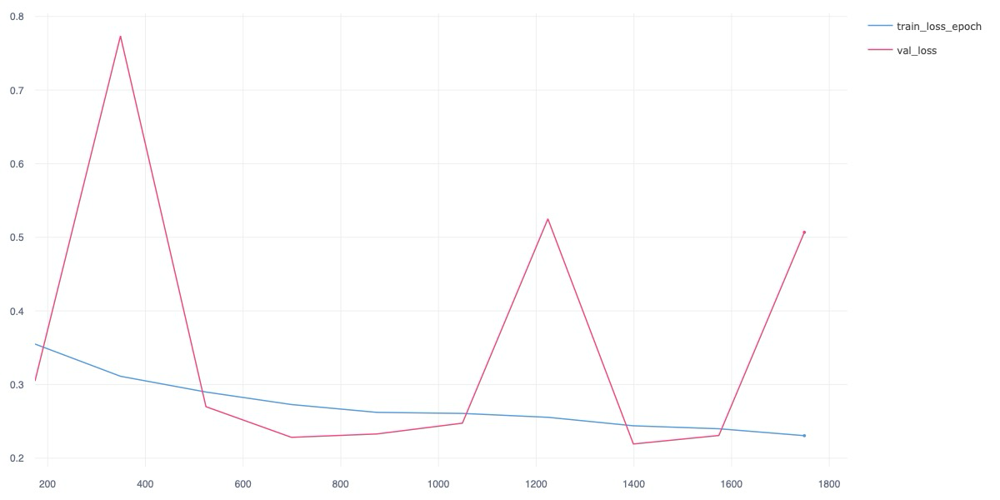

suite: Astrid


/global/homes/l/lindajin/UNet_apply.py:491: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict=torch.load(ckpt, map_location=torch.device("cpu"))["state_dict"]


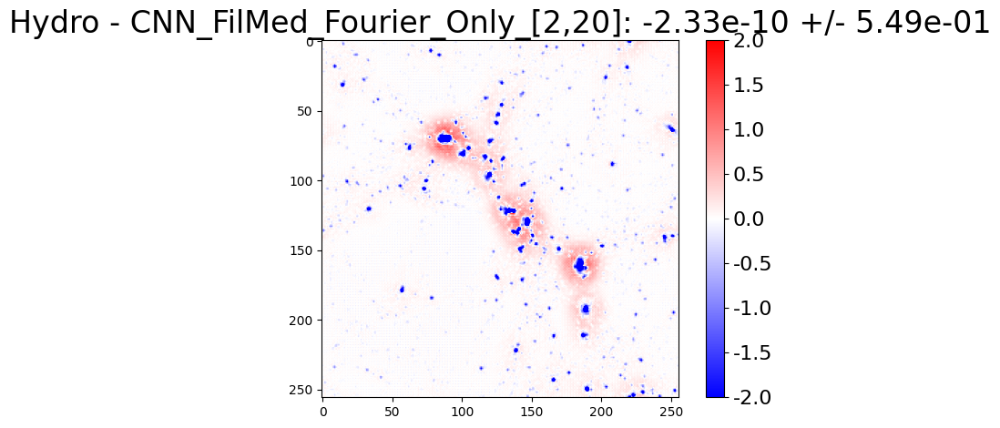

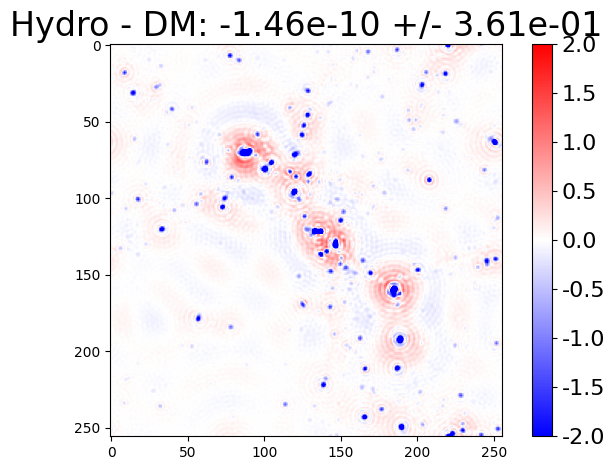


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


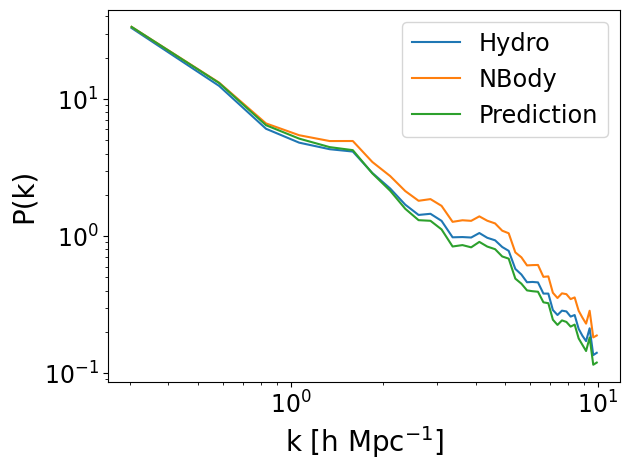

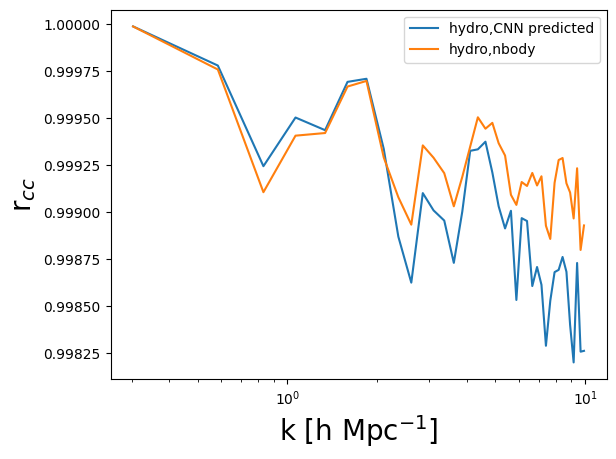

/tmp/ipykernel_415464/3632366390.py:96: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


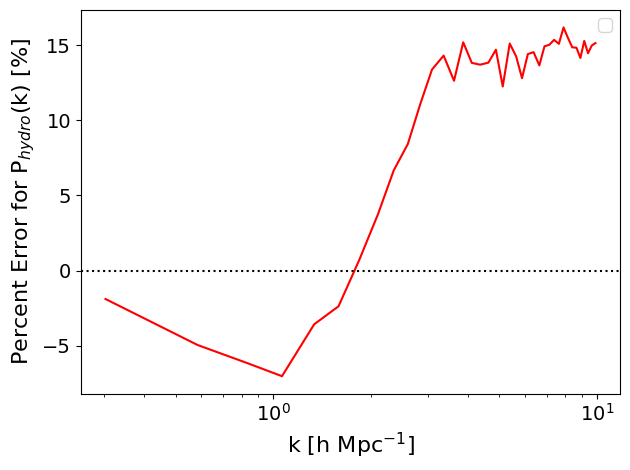

/tmp/ipykernel_415464/3632366390.py:106: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


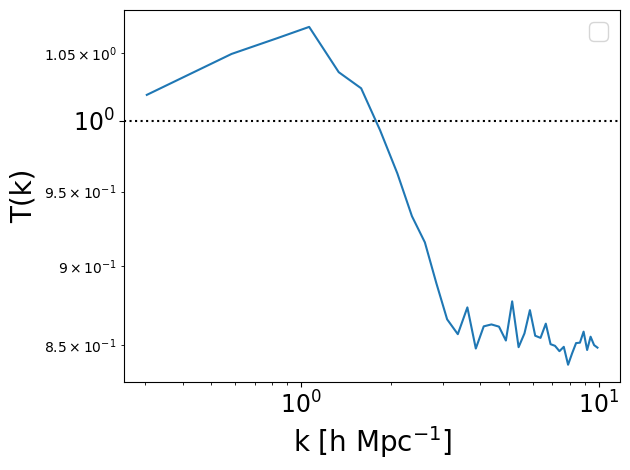

suite: Astrid


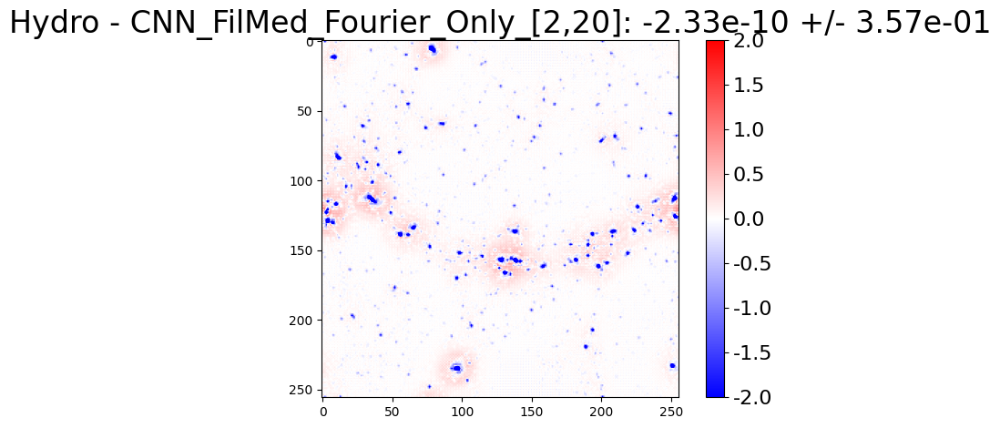

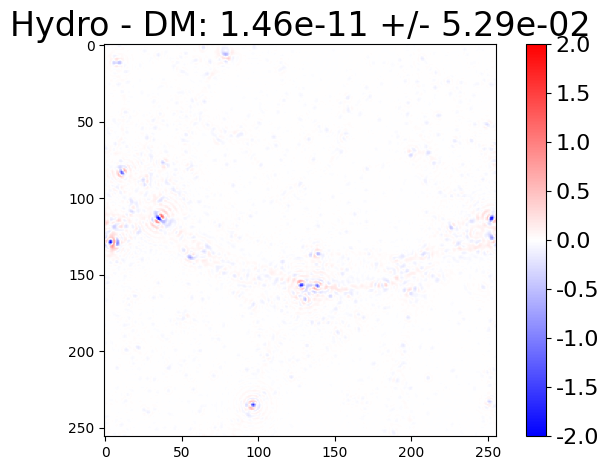


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


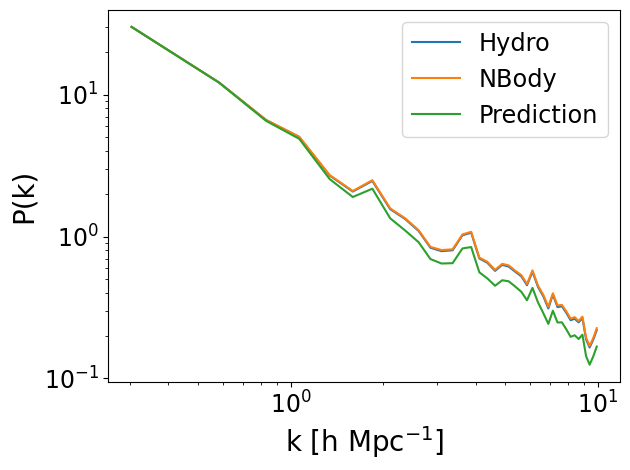

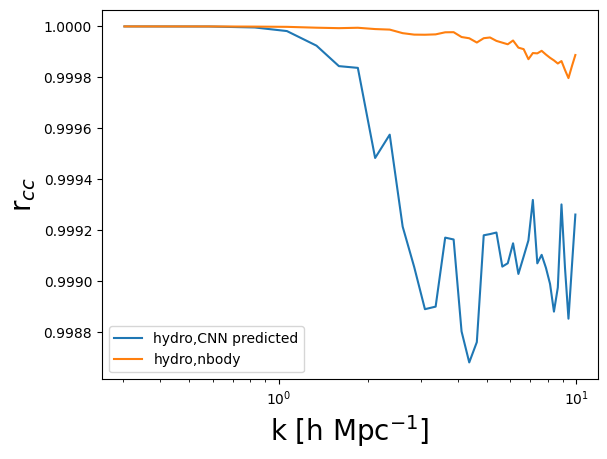

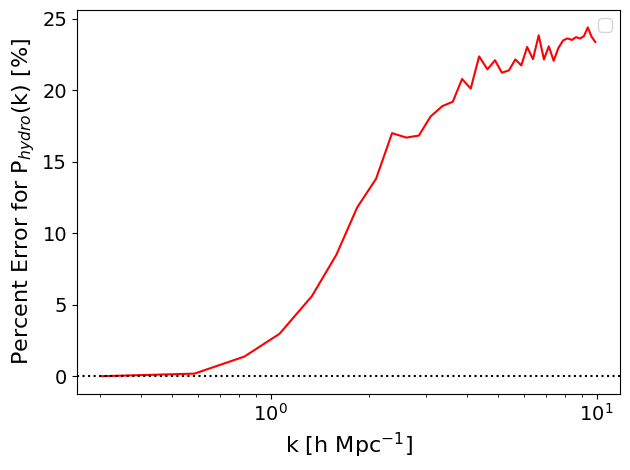

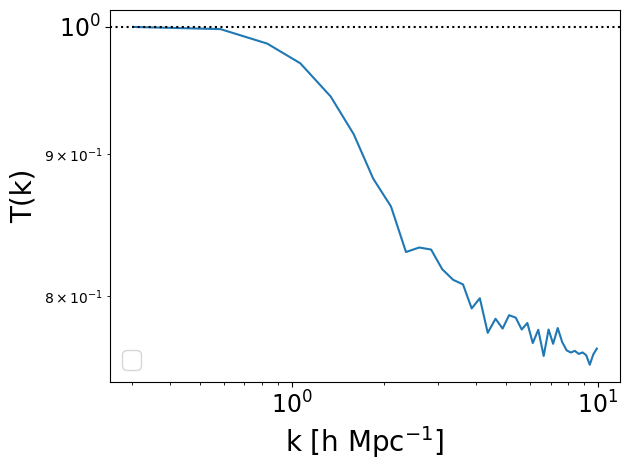

suite: Astrid


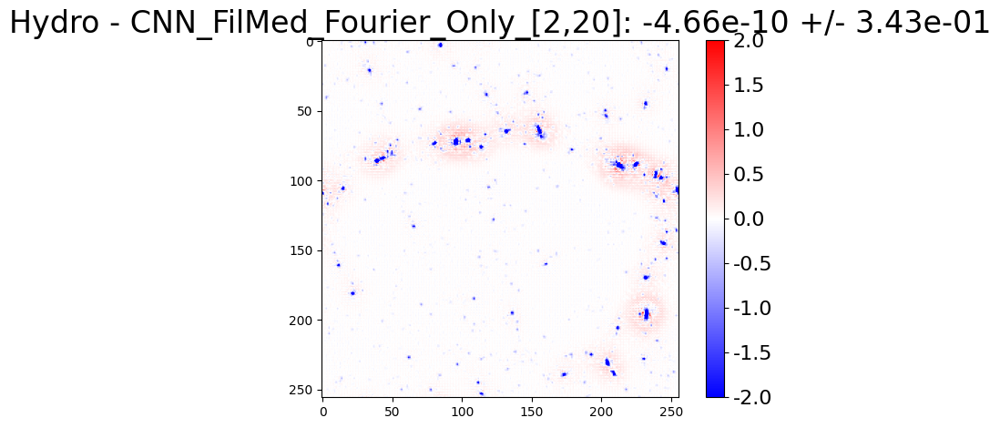

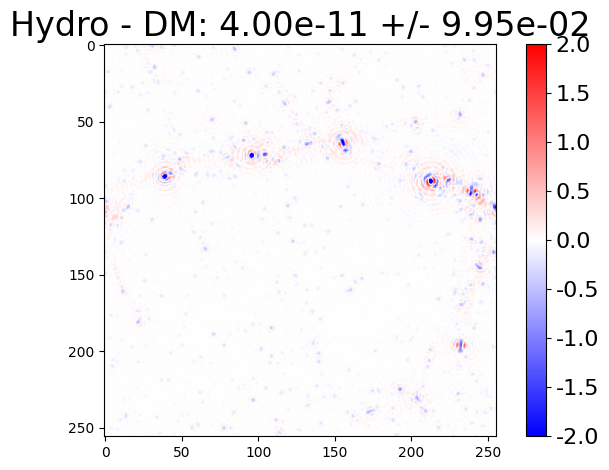


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


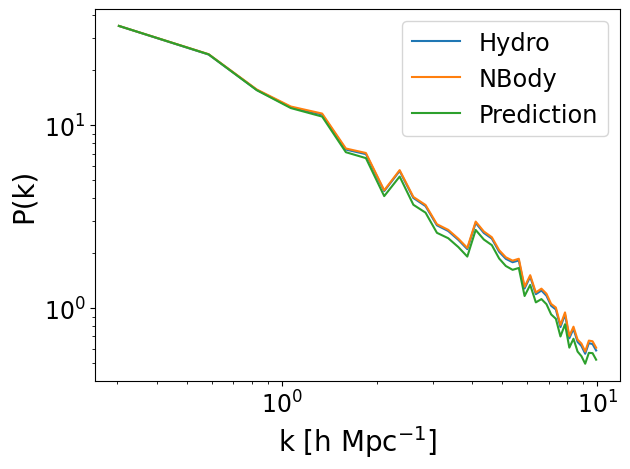

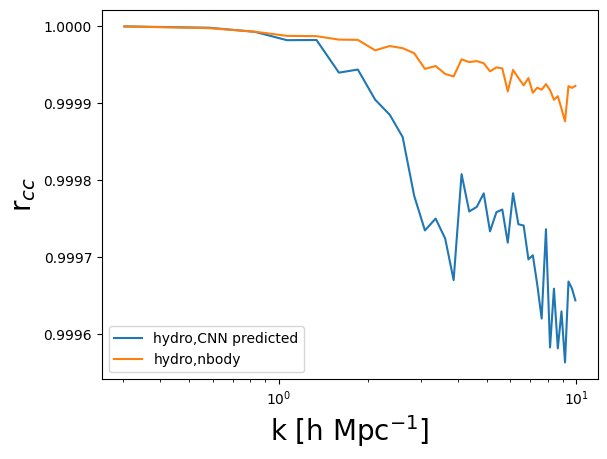

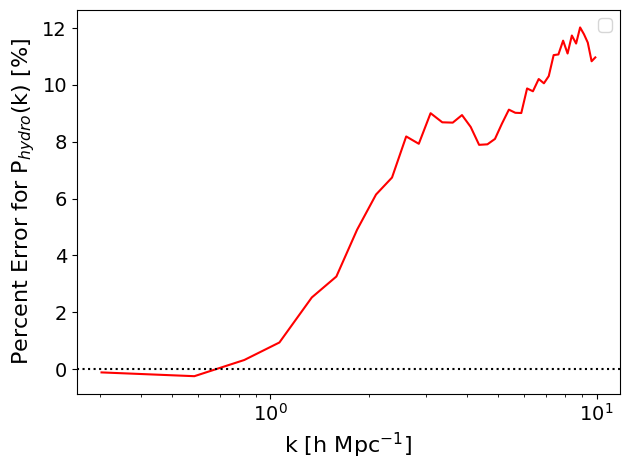

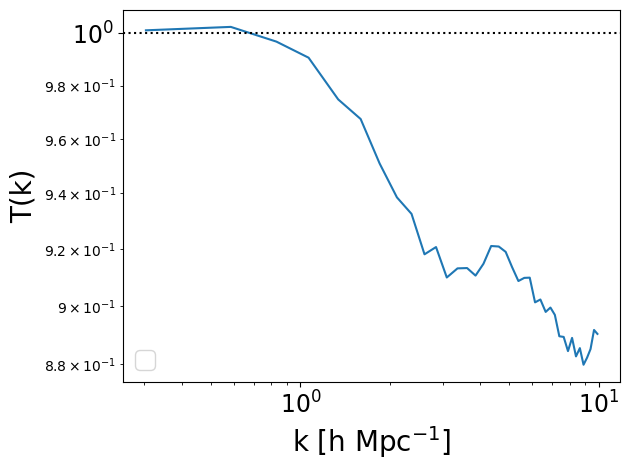

suite: Astrid


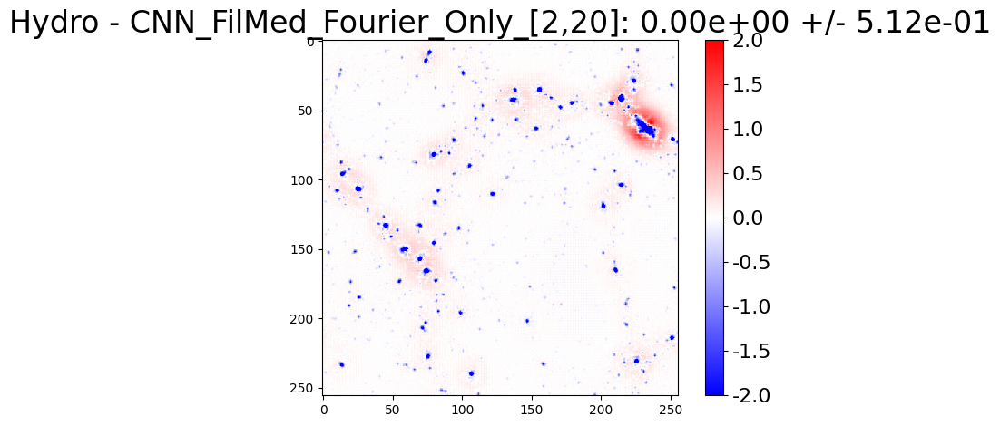

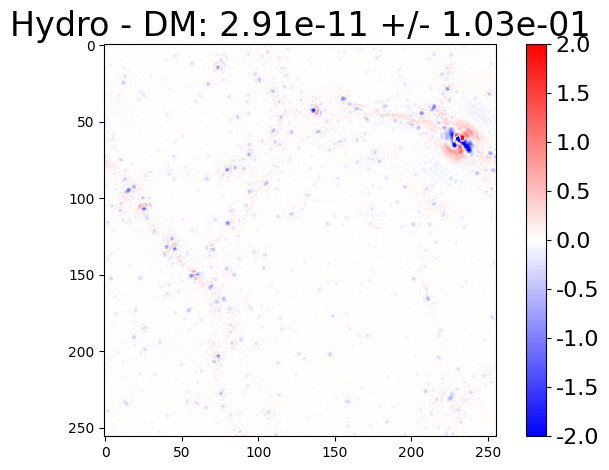


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


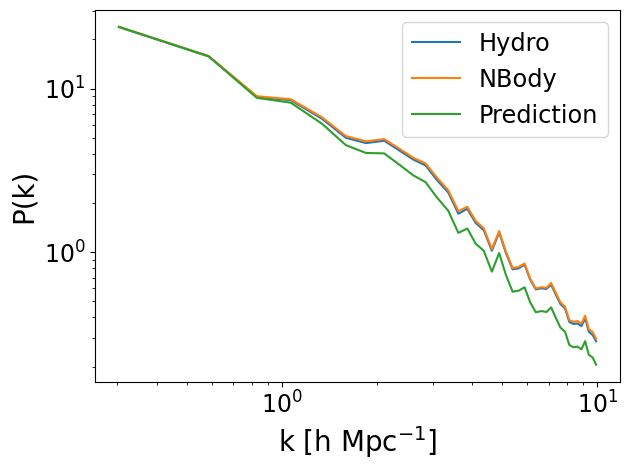

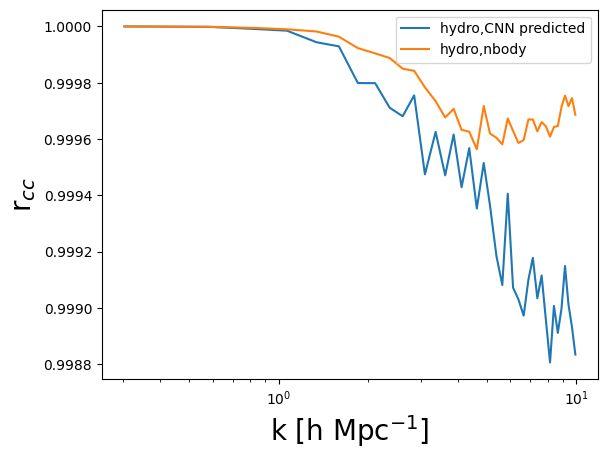

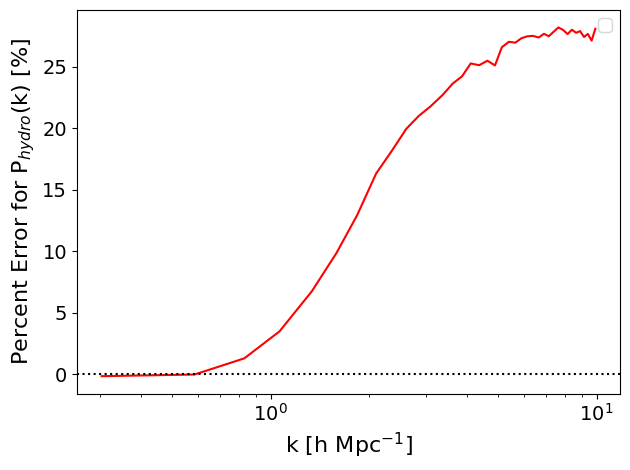

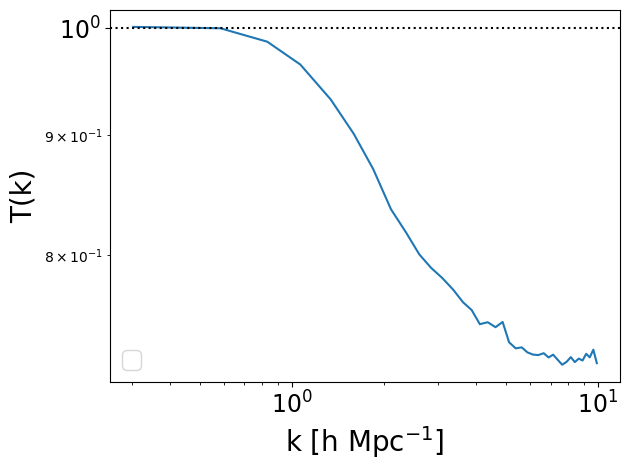

In [26]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_Fourier_Only_[2,20]'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
filter_mask = torch.zeros_like(k)
filter_mask[(k >= 2) & (k <= 20)] = 1
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0,10, 50,100]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = residual_grid.reshape(256,256)
    filtered_image = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## Only Fourier [3,10]*1e-7 lr:1e-3
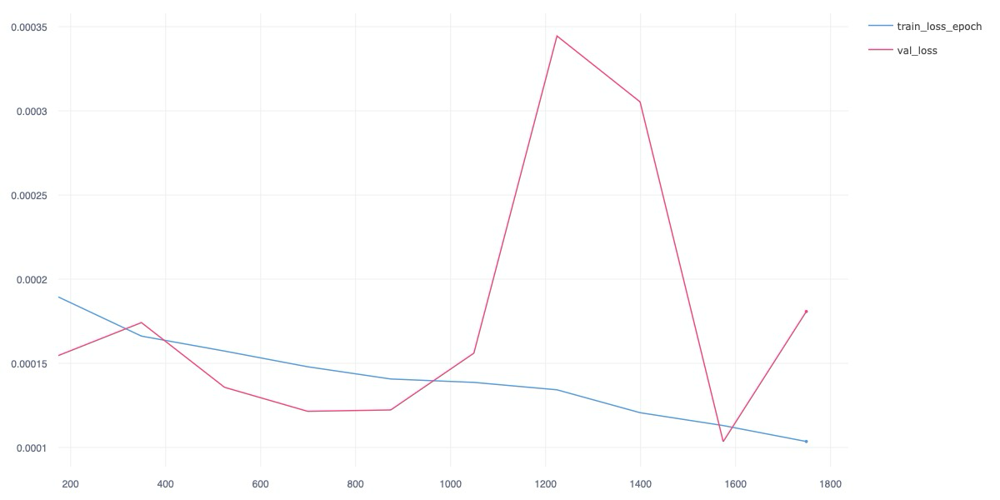

suite: Astrid


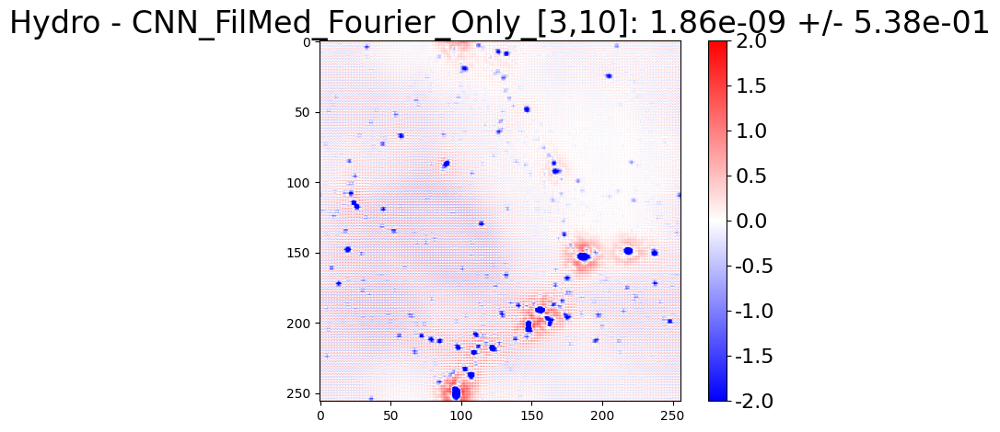

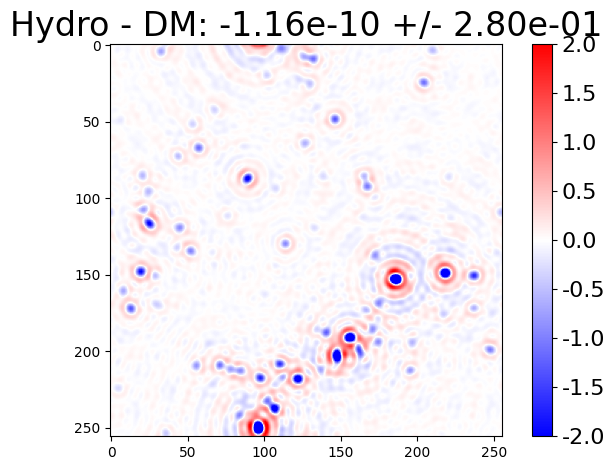


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


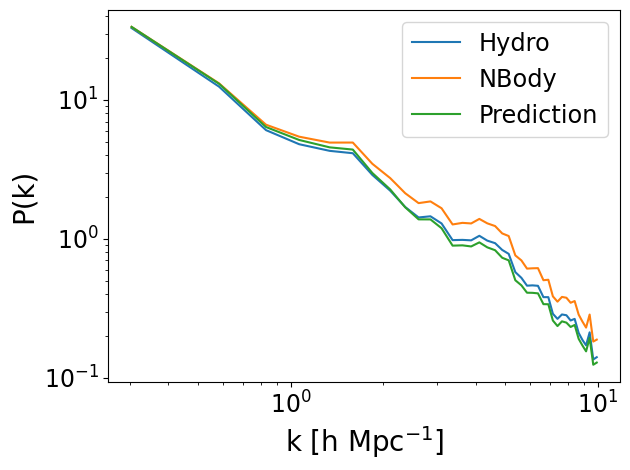

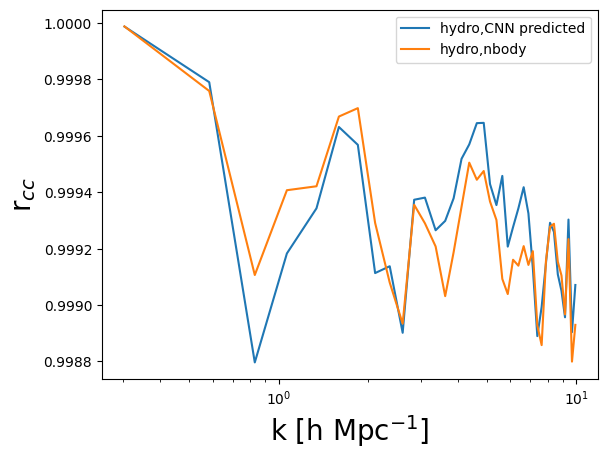

/tmp/ipykernel_415464/1716910862.py:96: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


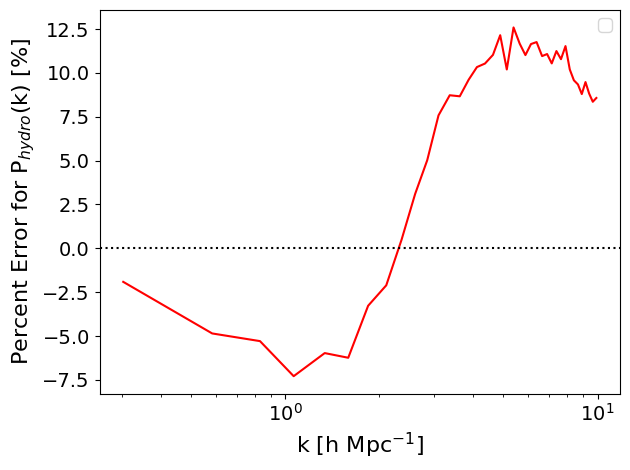

/tmp/ipykernel_415464/1716910862.py:106: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


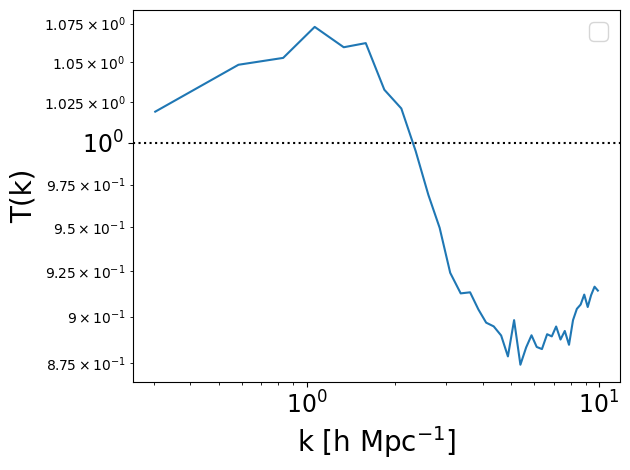

suite: Astrid


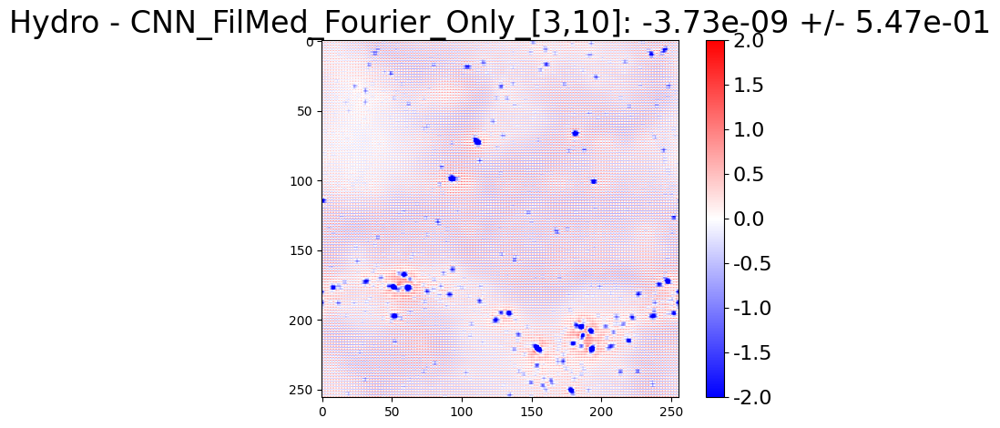

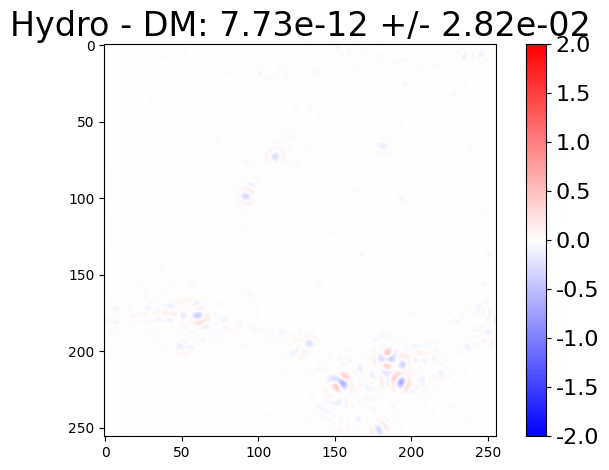


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


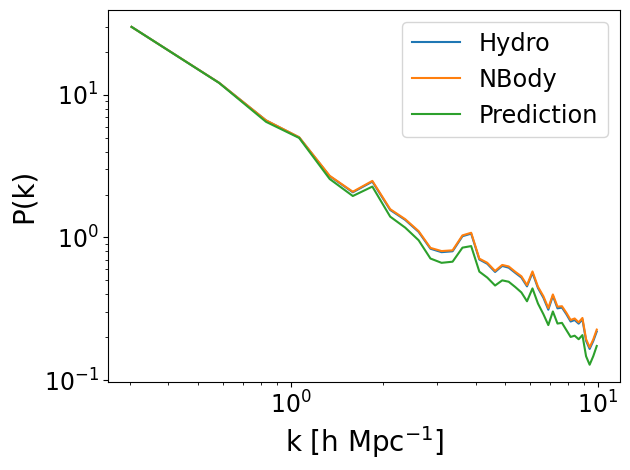

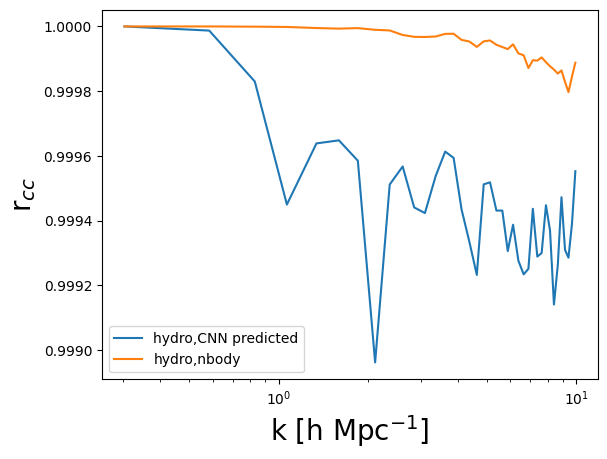

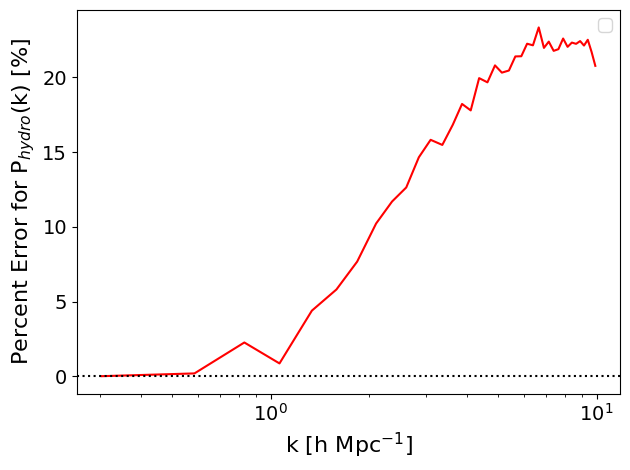

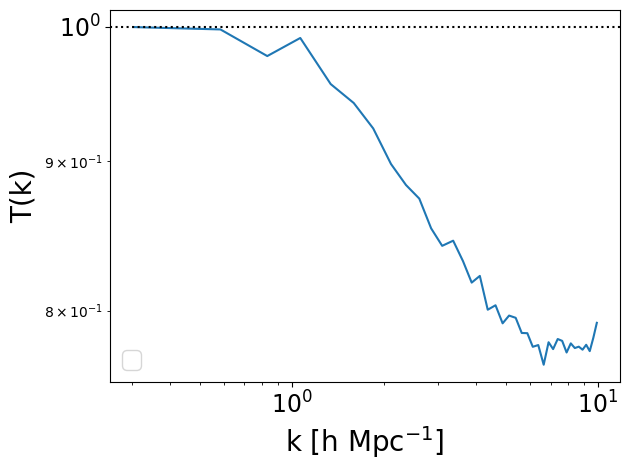

suite: Astrid


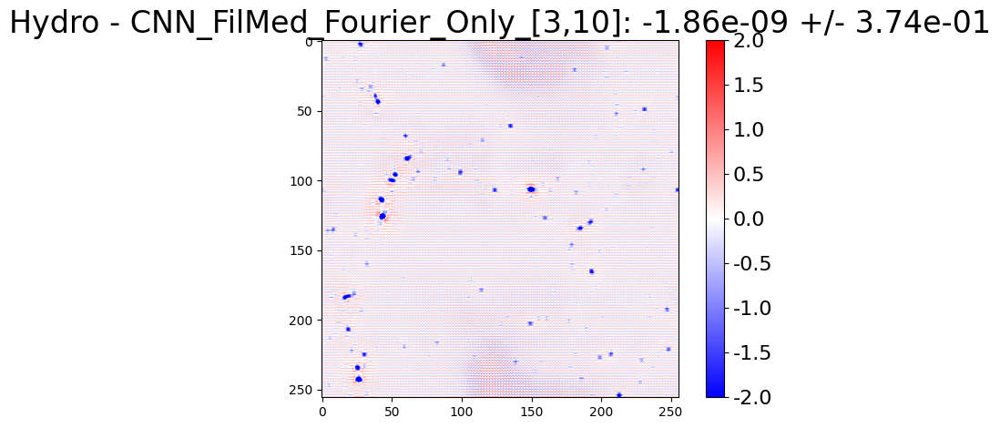

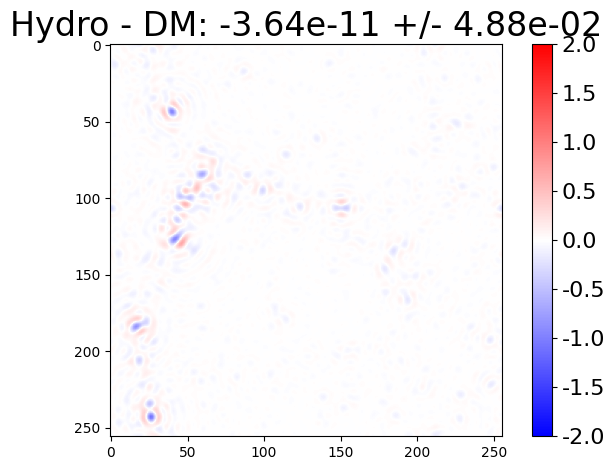


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


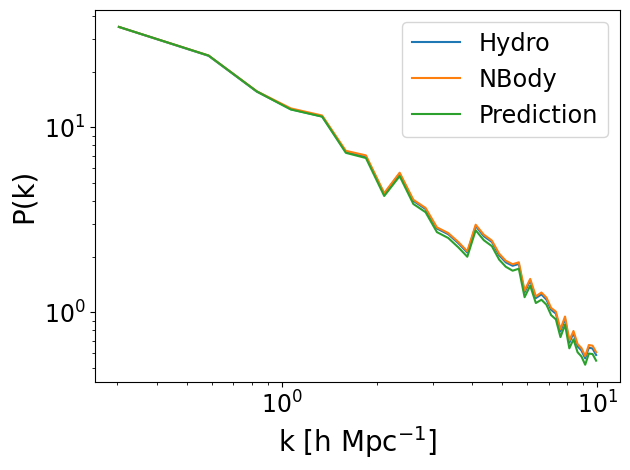

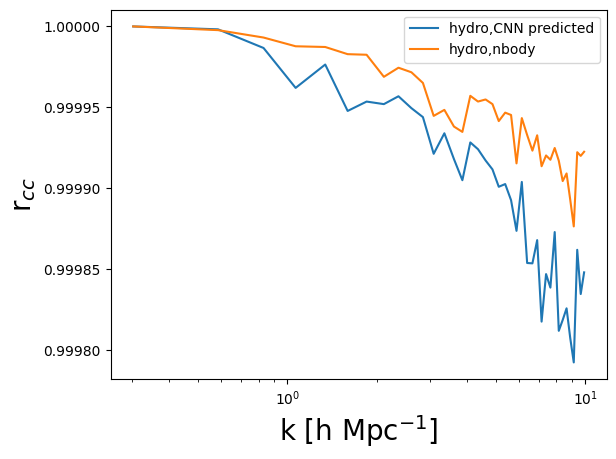

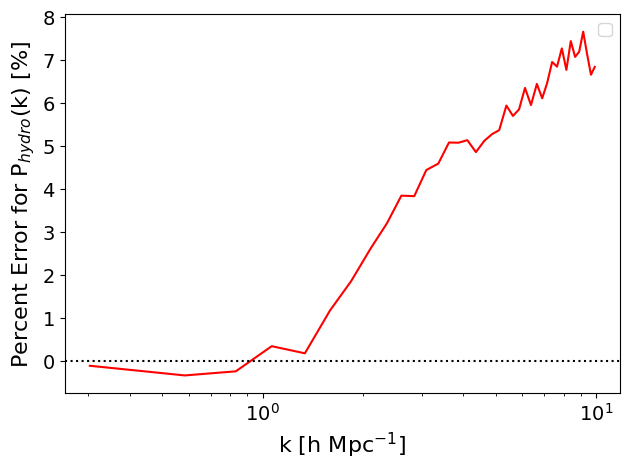

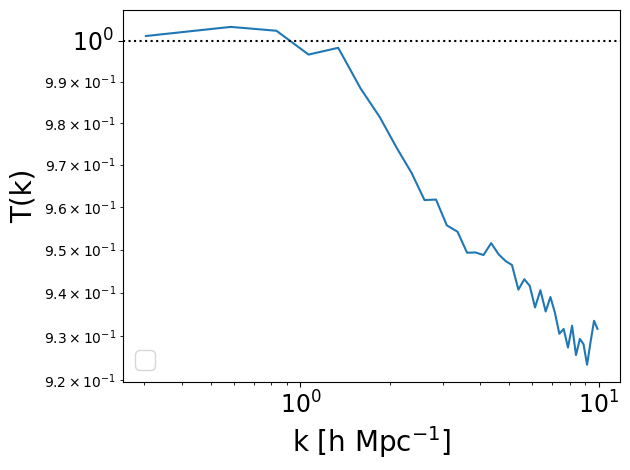

suite: Astrid


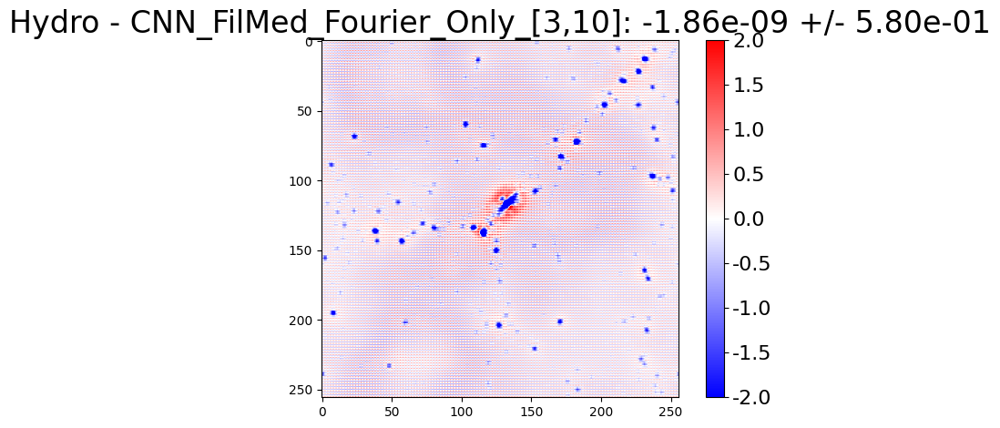

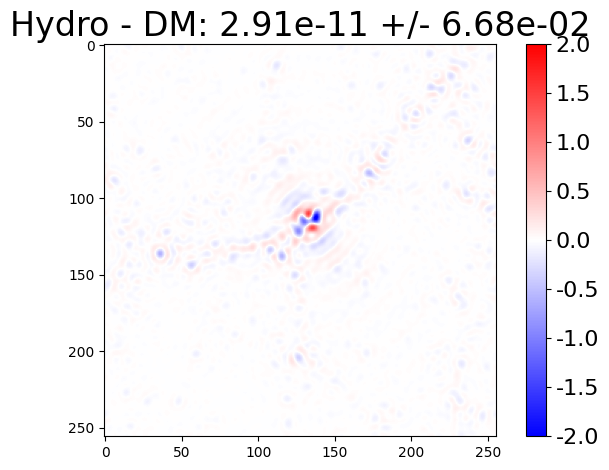


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


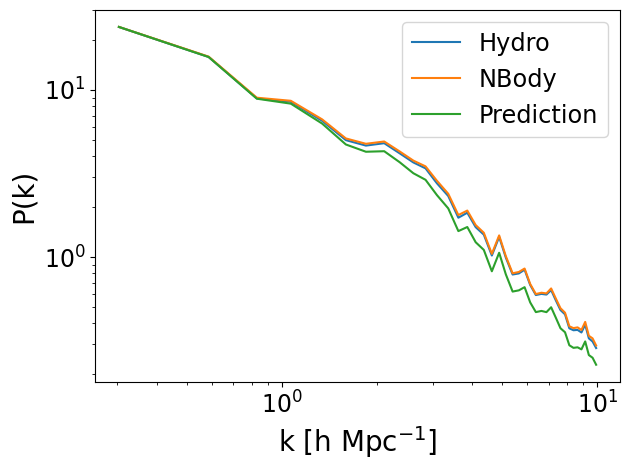

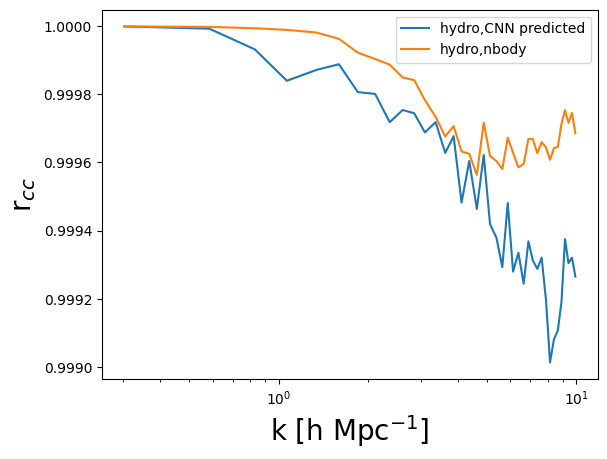

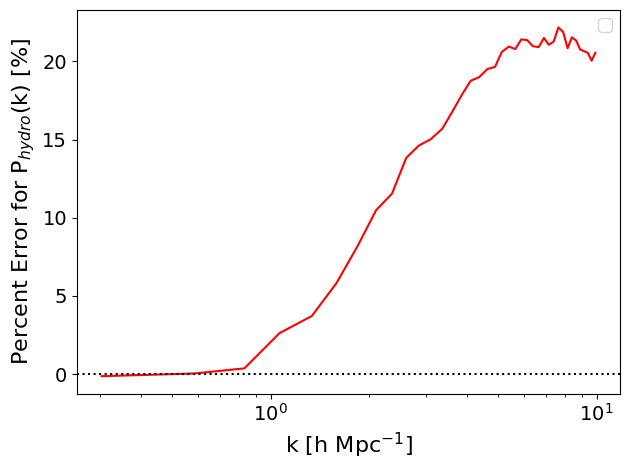

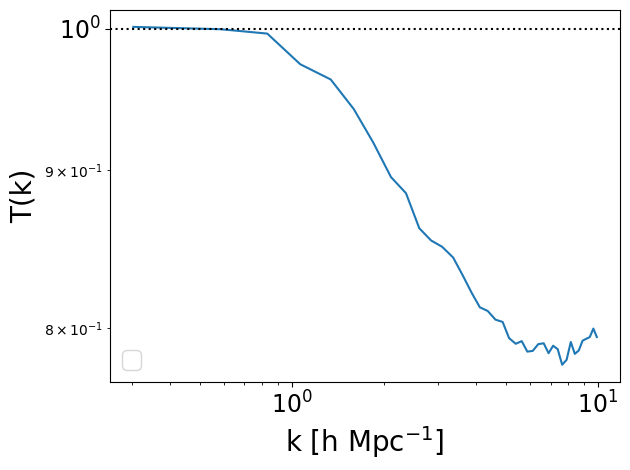

In [21]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_Fourier_Only_[3,10]'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
filter_mask = torch.zeros_like(k)
filter_mask[(k >= 3) & (k <= 10)] = 1
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0,10, 50,100]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = residual_grid.reshape(256,256)
    filtered_image = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## Only Fourier [3,10]*1e-7 lr:1e-3 **adamw decay: 1e-5 -> 1e-2**
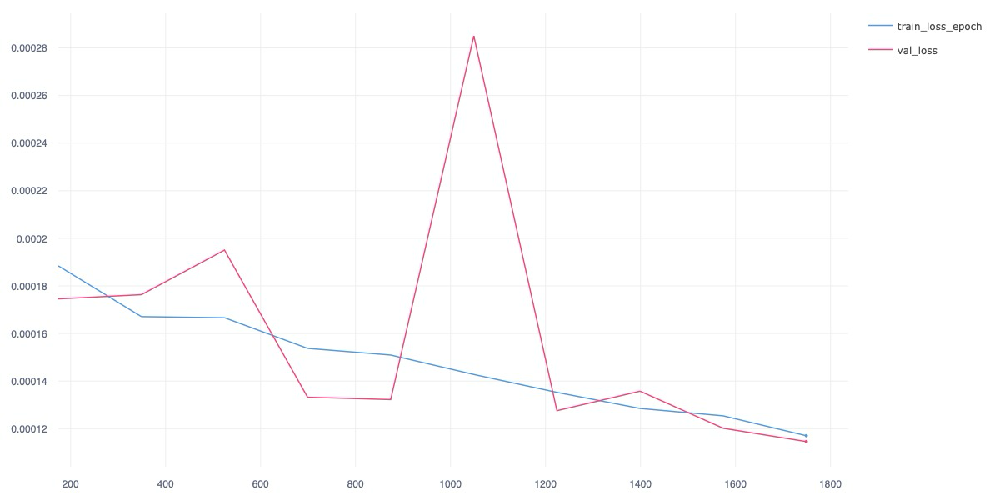

suite: Astrid


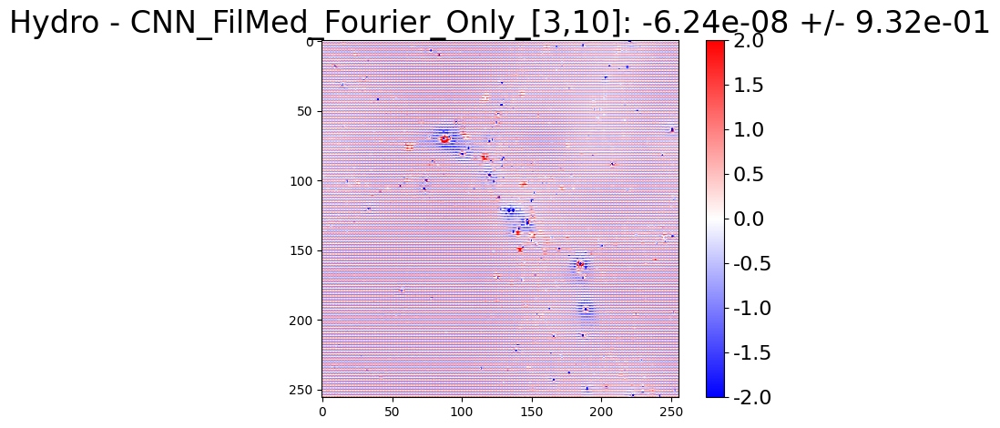

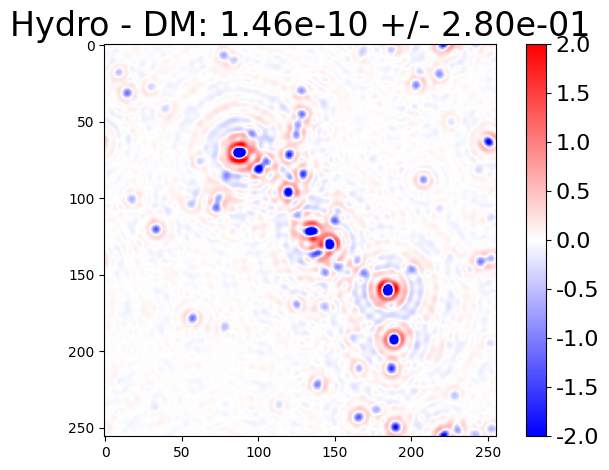


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


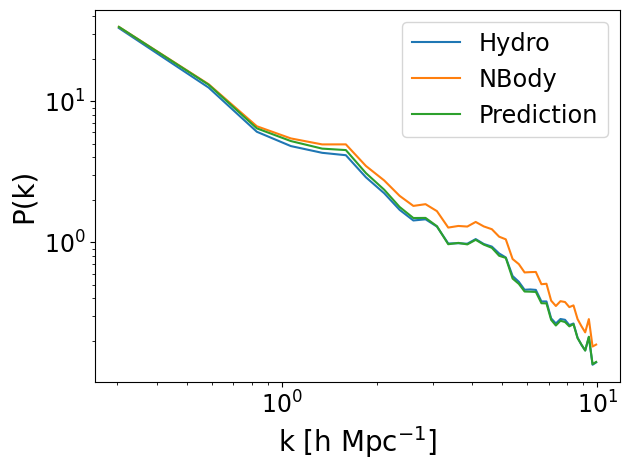

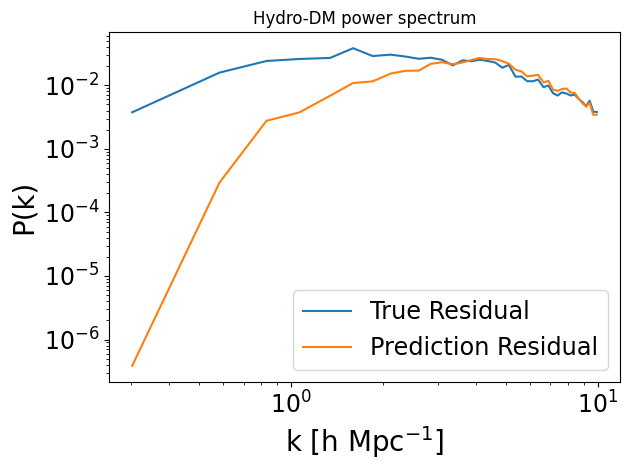

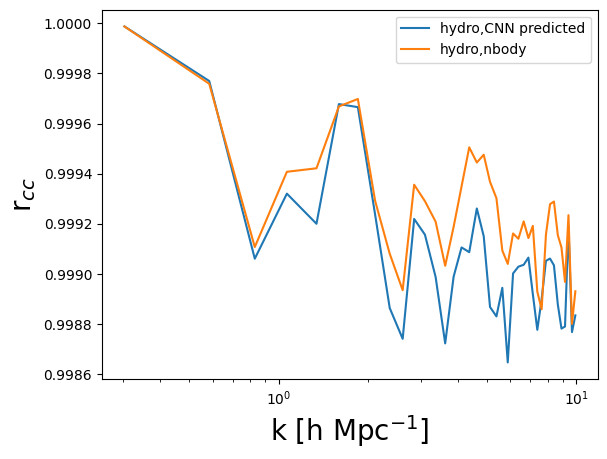

/tmp/ipykernel_1223295/992846171.py:118: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


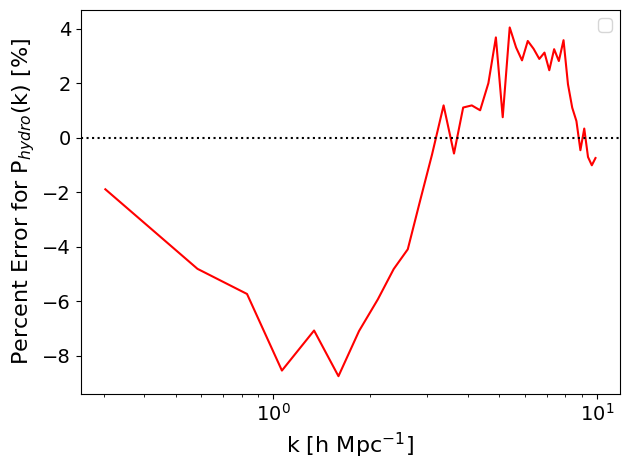

/tmp/ipykernel_1223295/992846171.py:128: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


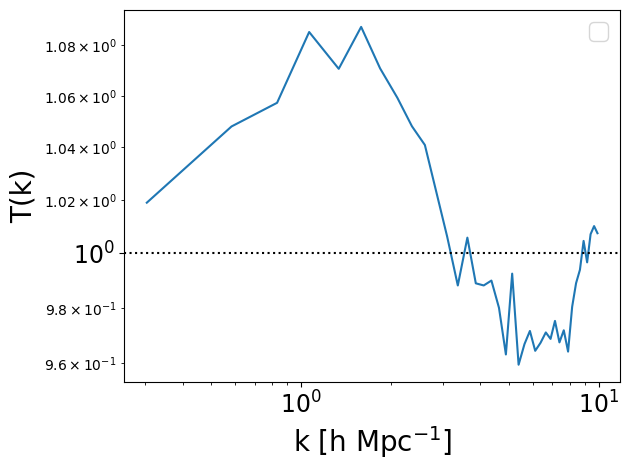

suite: Astrid


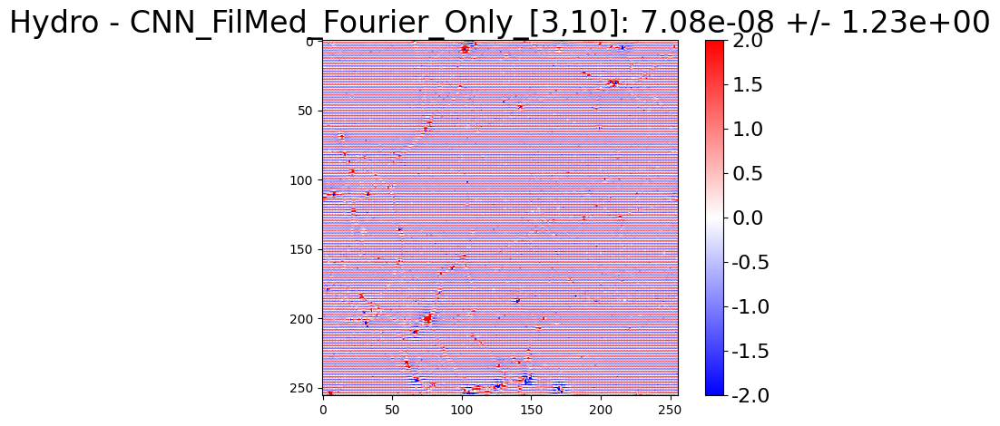

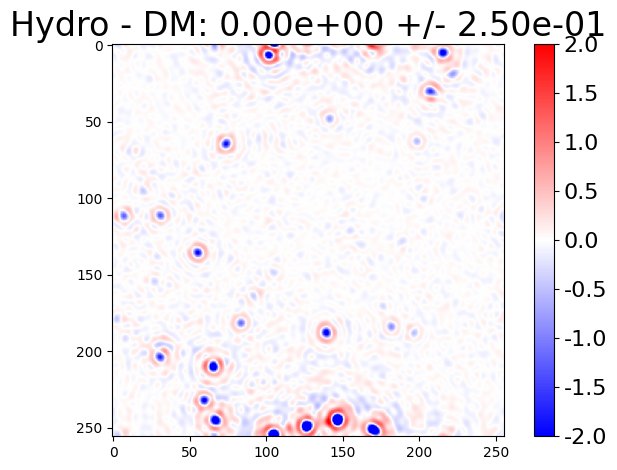


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


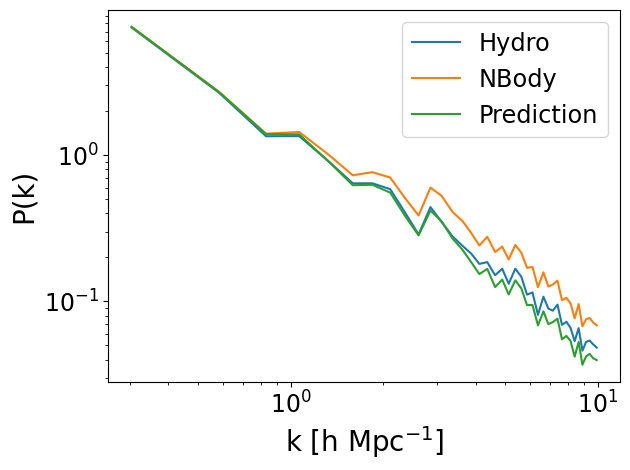

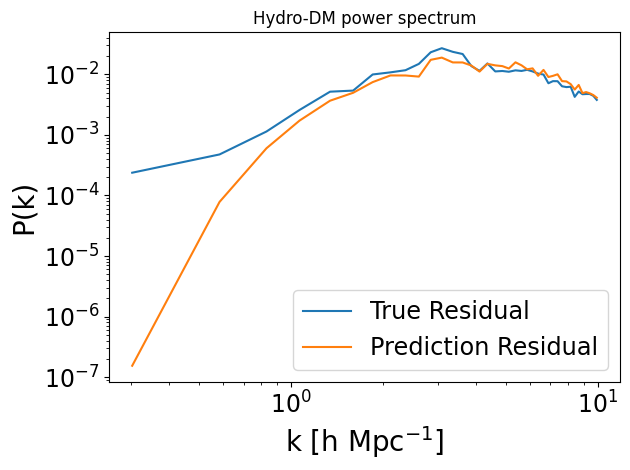

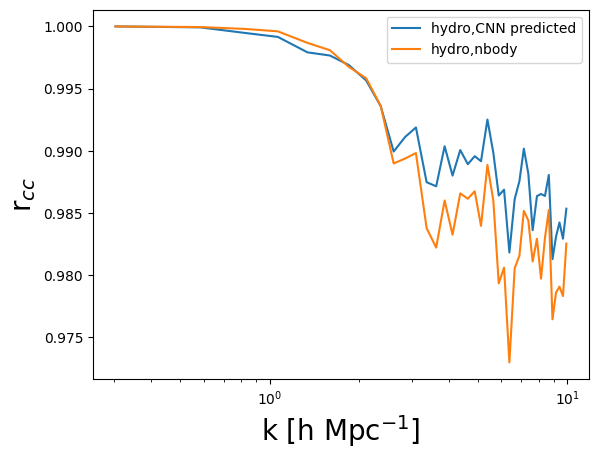

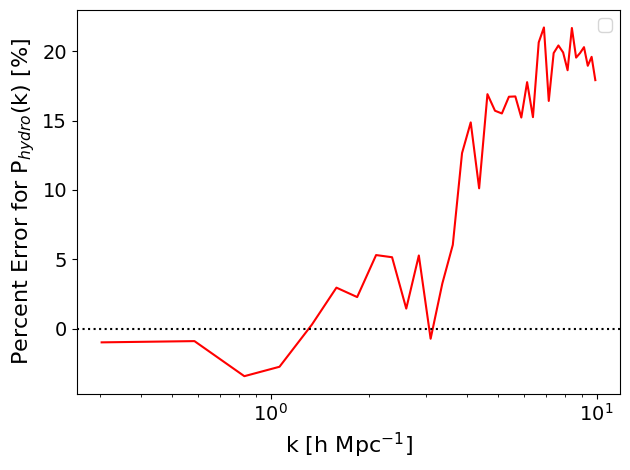

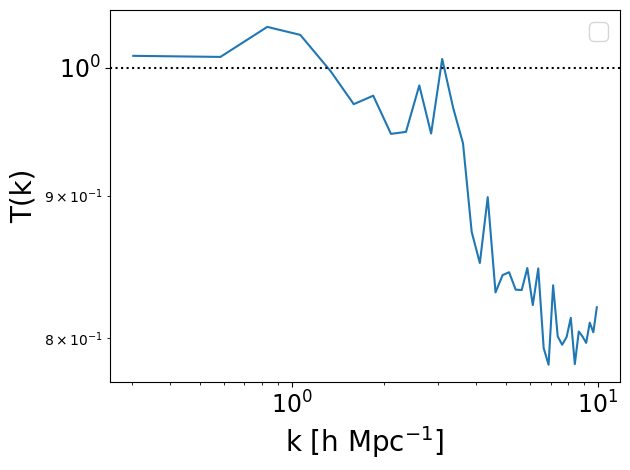

In [8]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_Fourier_Only_[3,10]'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
filter_mask = torch.zeros_like(k)
filter_mask[(k >= 3) & (k <= 10)] = 1
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0,200]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    filtered_image = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefi
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## Only Fourier [3,10]*1e-7 lr:1e-3 adamw decay: 1e-5 -> 1e-2  **Butterworth window for L_fft**
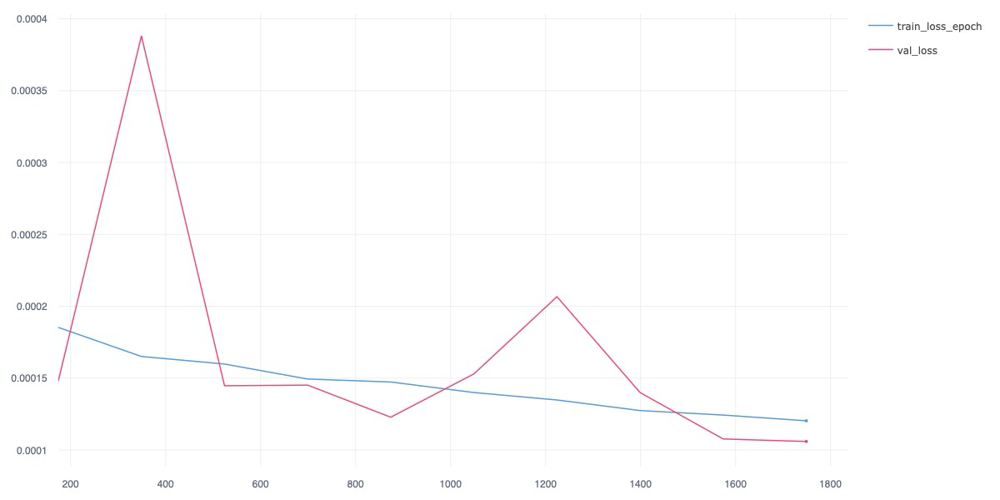

suite: Astrid


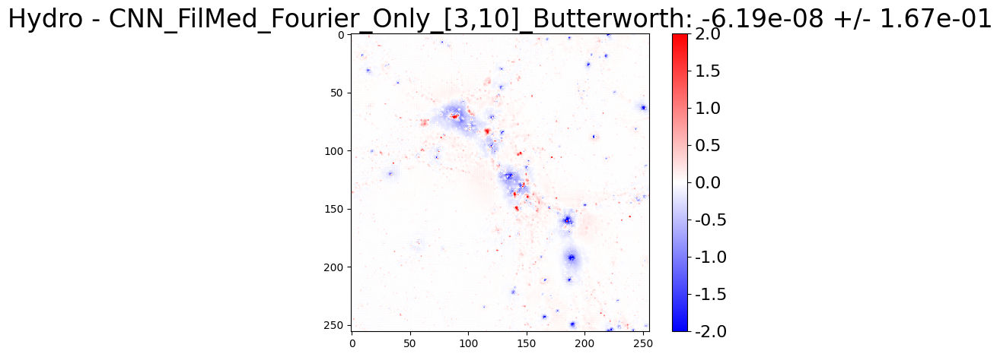

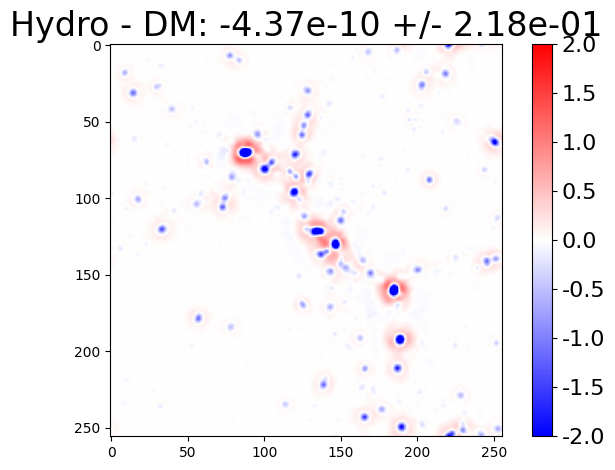


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


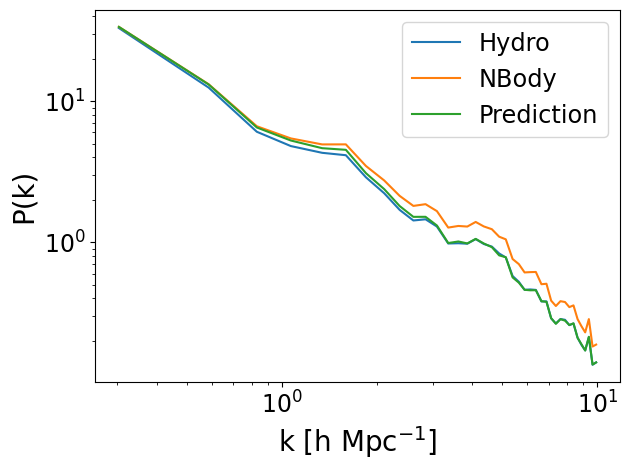

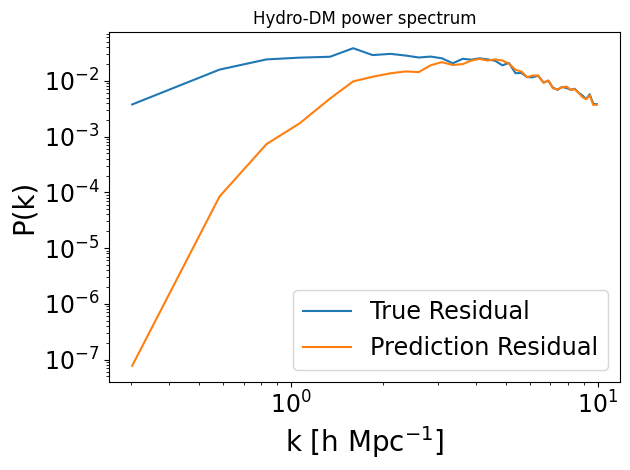

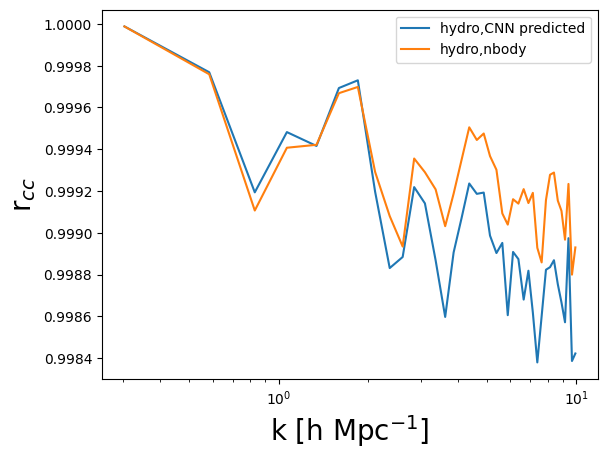

/tmp/ipykernel_1223295/2675718174.py:120: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


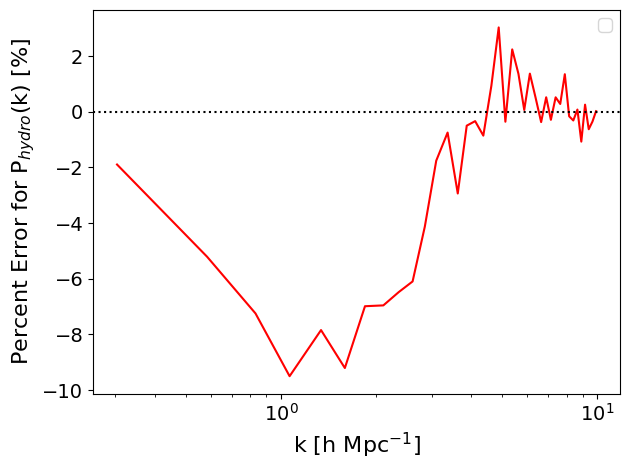

/tmp/ipykernel_1223295/2675718174.py:130: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


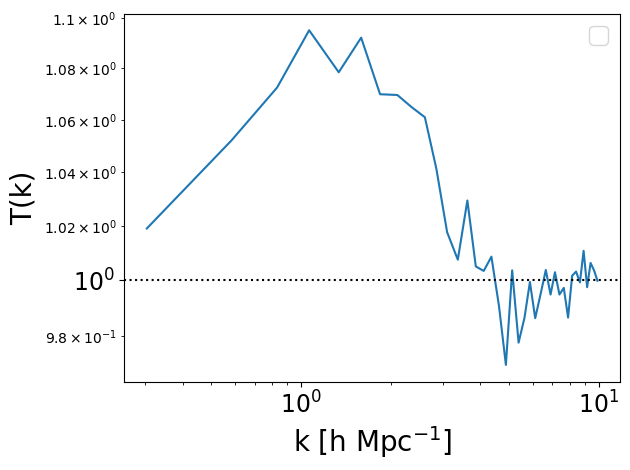

suite: Astrid


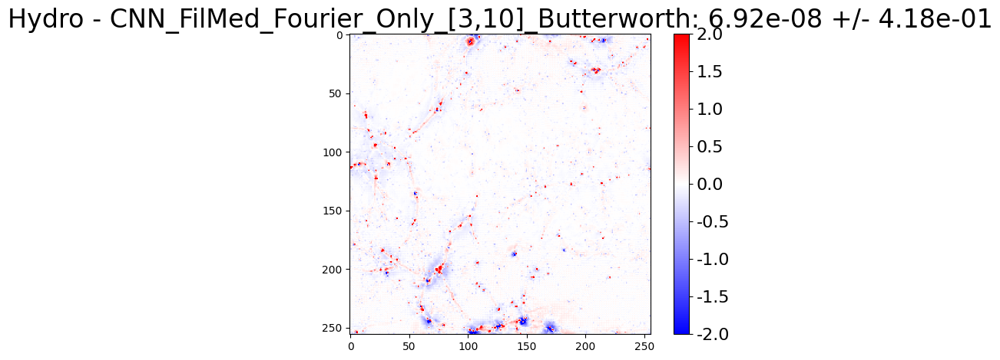

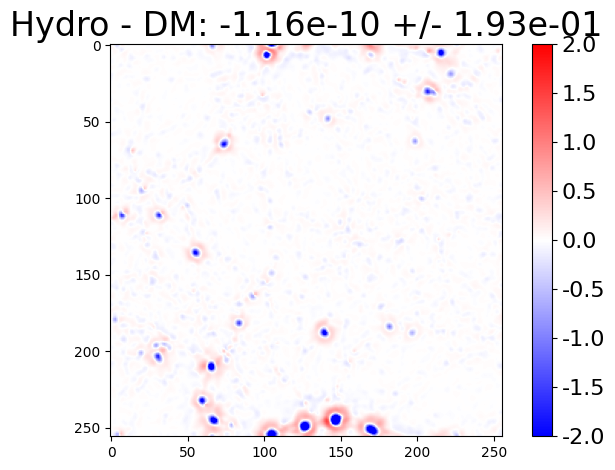


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


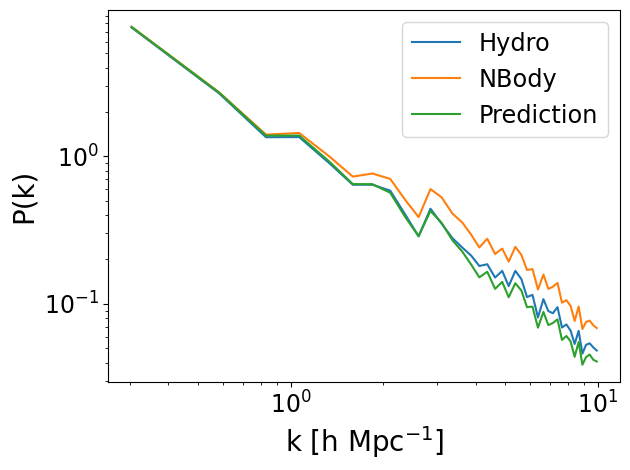

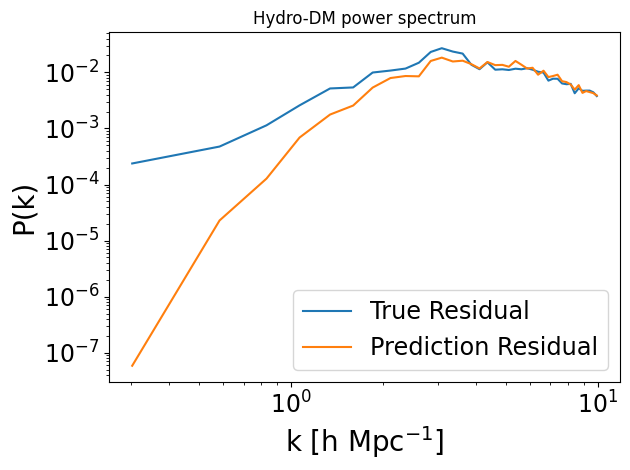

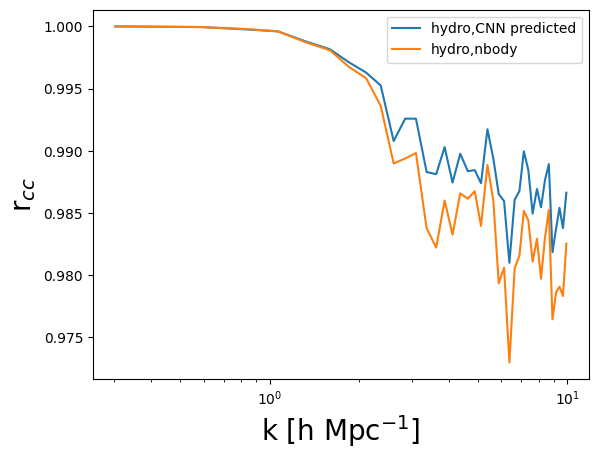

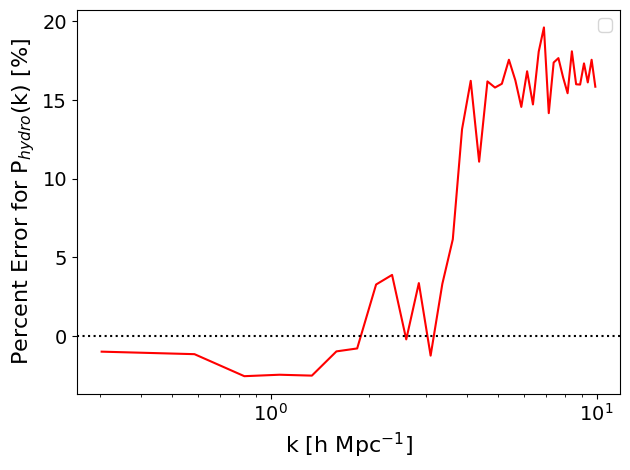

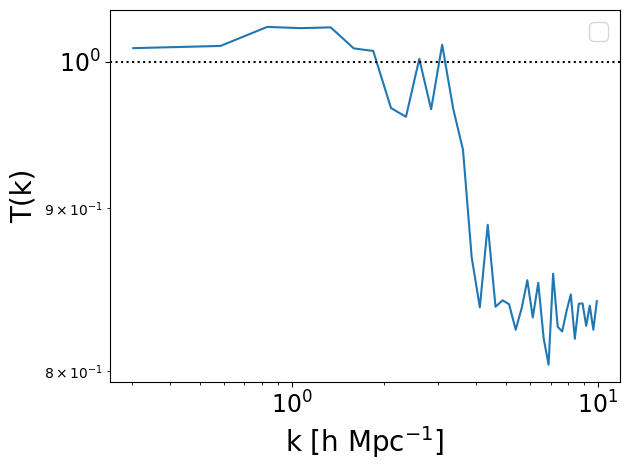

In [10]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_Fourier_Only_[3,10]_Butterworth'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
order = 2 
low_pass = 1 / (1 + (k / 10)**(2 * order))
high_pass = 1 / (1 + (3 / k)**(2 * order))
filter_mask = low_pass*high_pass
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0,200]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    filtered_image = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## BEST L1 + **epoch 2/10 Fourier**  [3,10]*1e-5 lr:1e-3 adamw decay: 1e-5 -> 1e-2  Butterworth window for L_fft
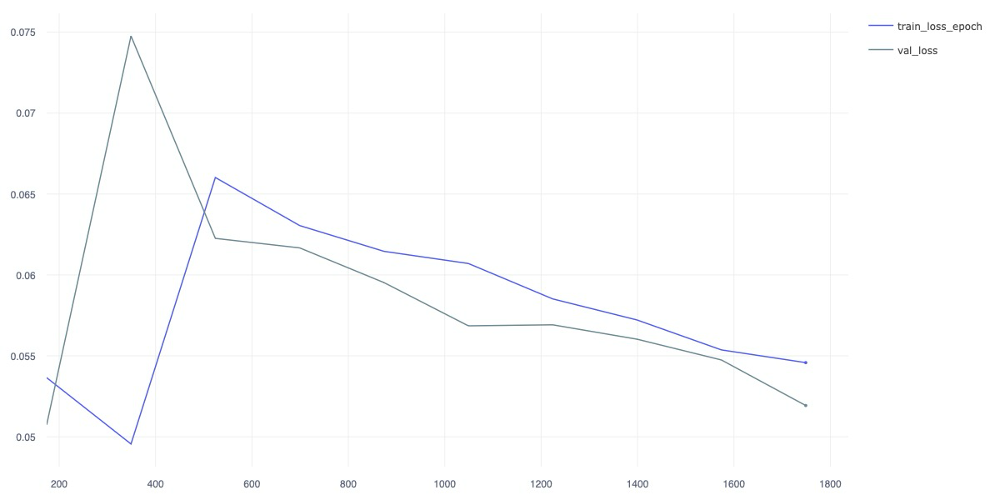
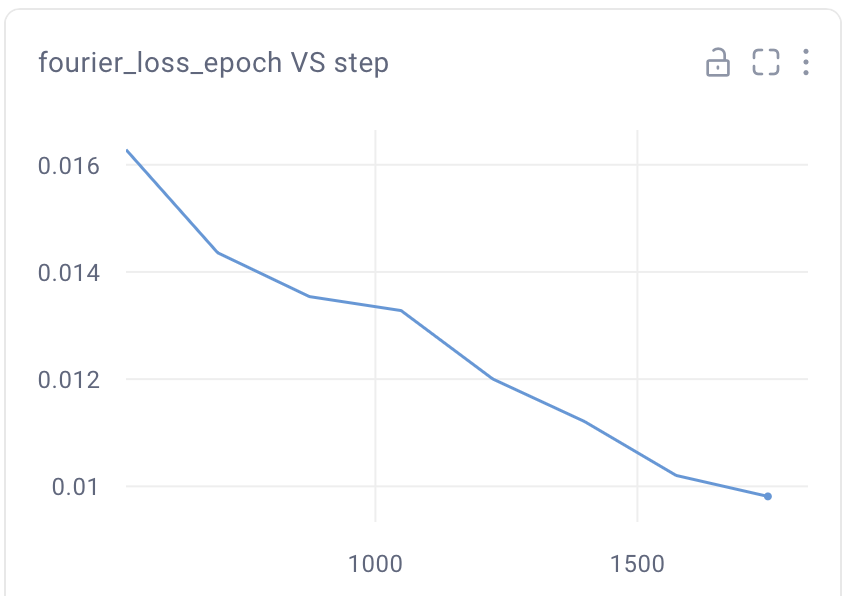
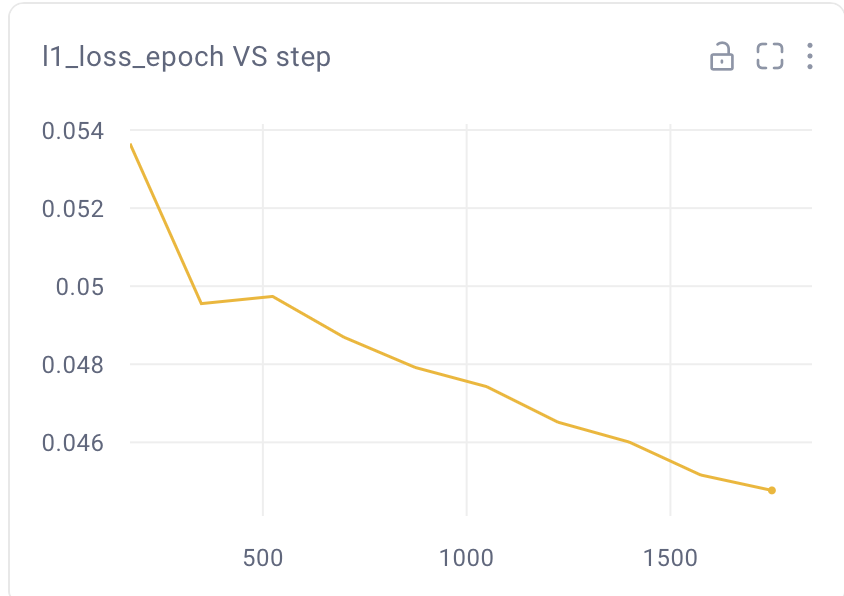

suite: Astrid
no high pass


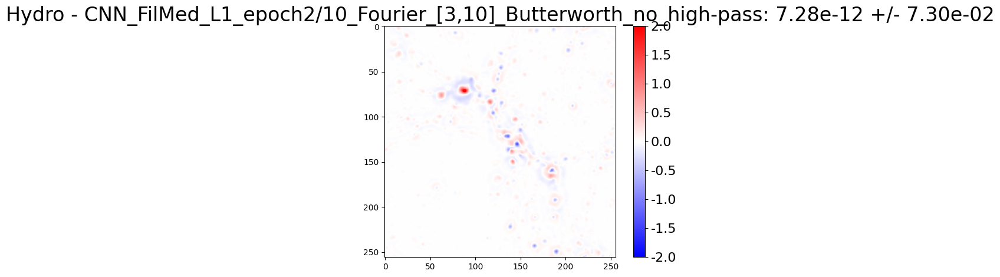

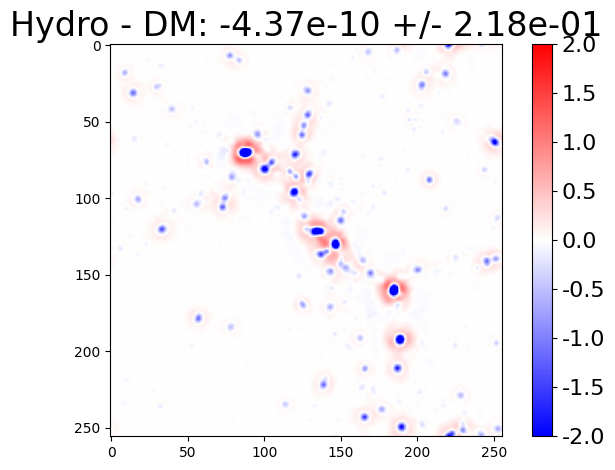

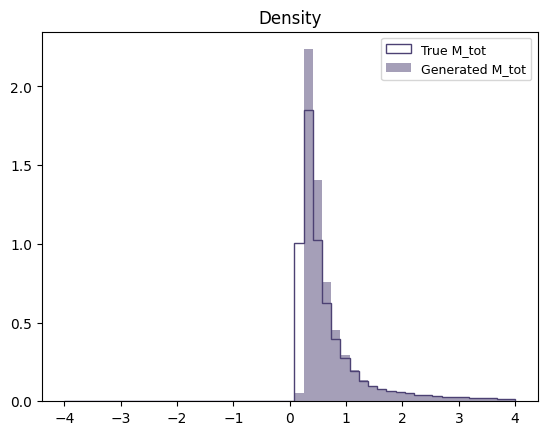


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


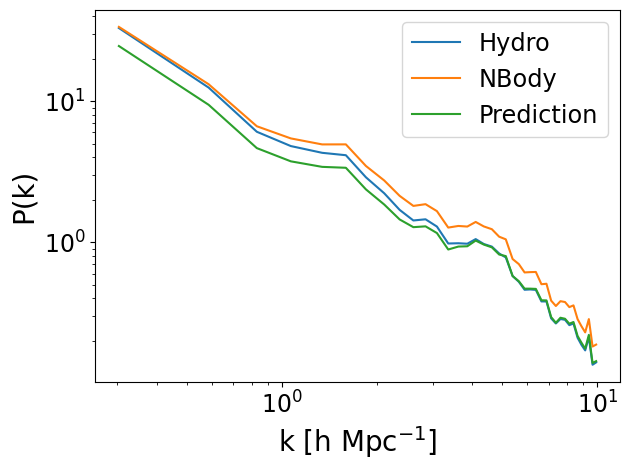

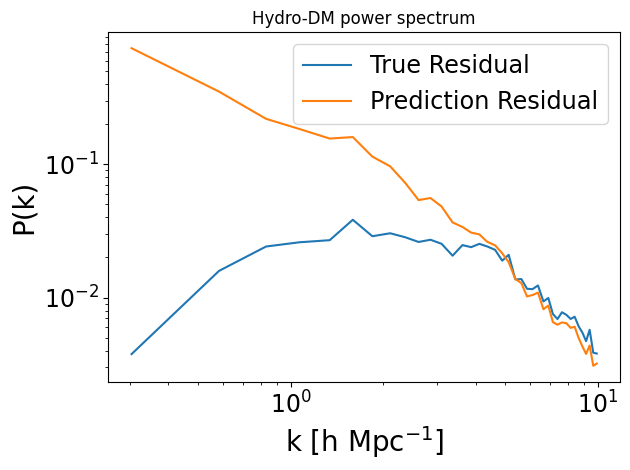

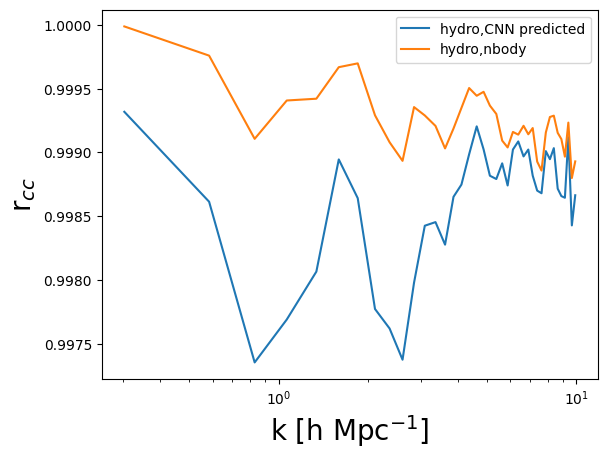

/tmp/ipykernel_54516/2979125856.py:126: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


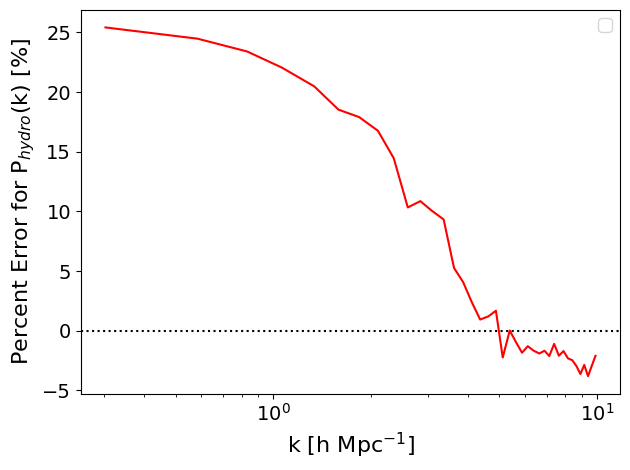

/tmp/ipykernel_54516/2979125856.py:136: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


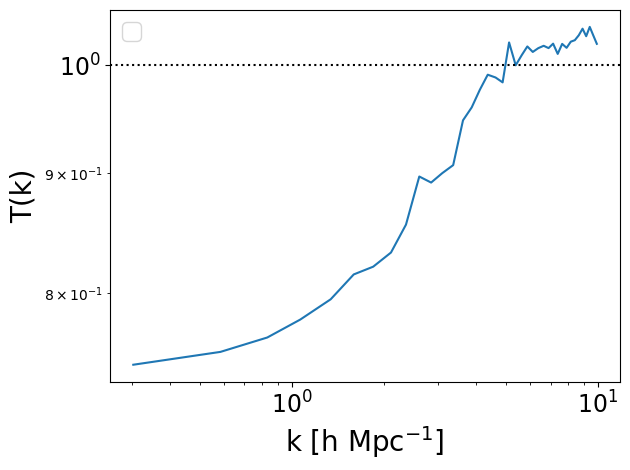

suite: Astrid
no high pass


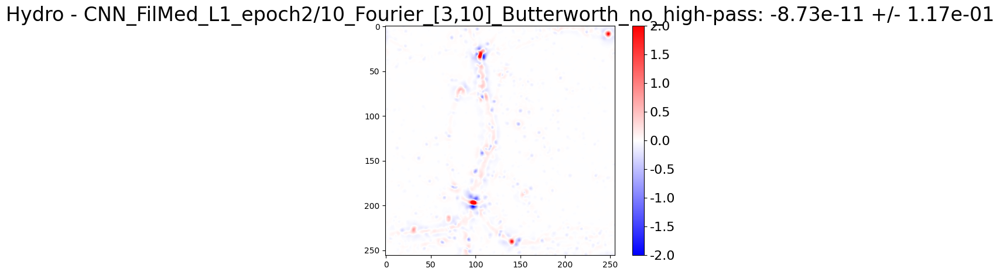

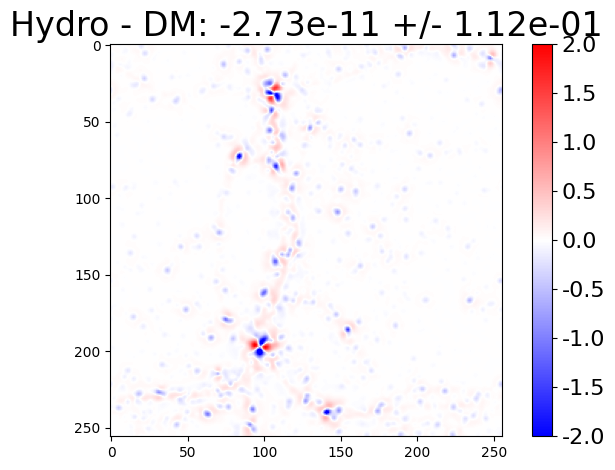

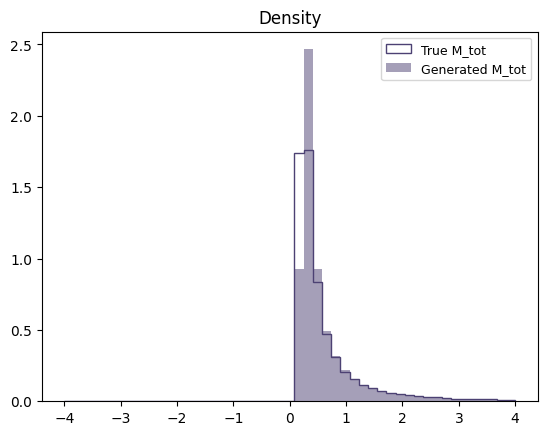


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


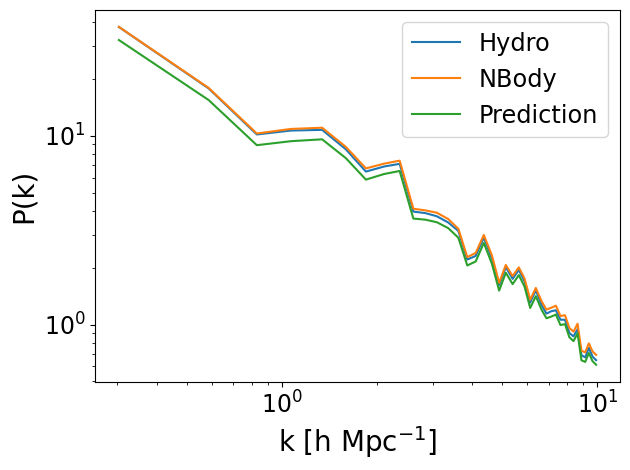

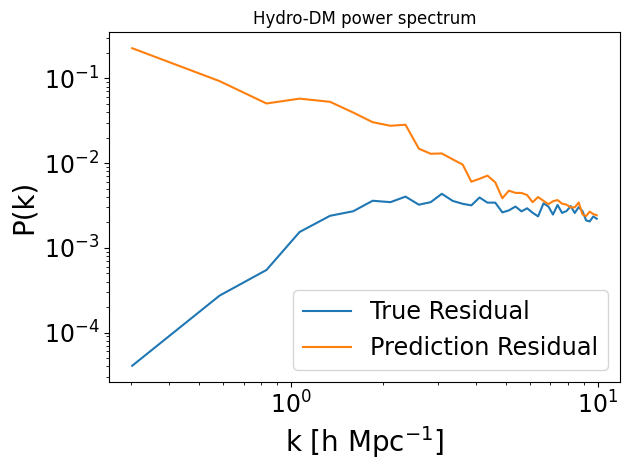

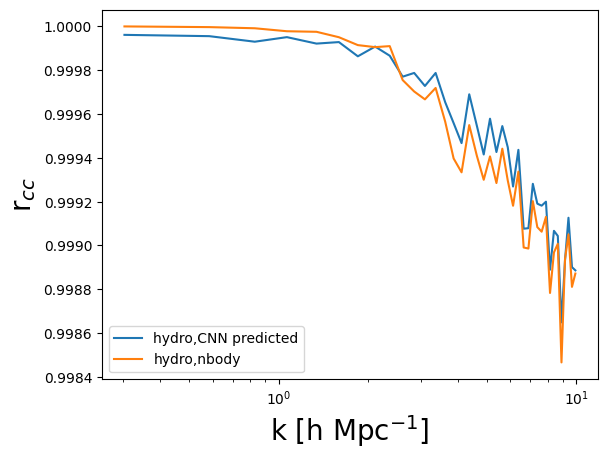

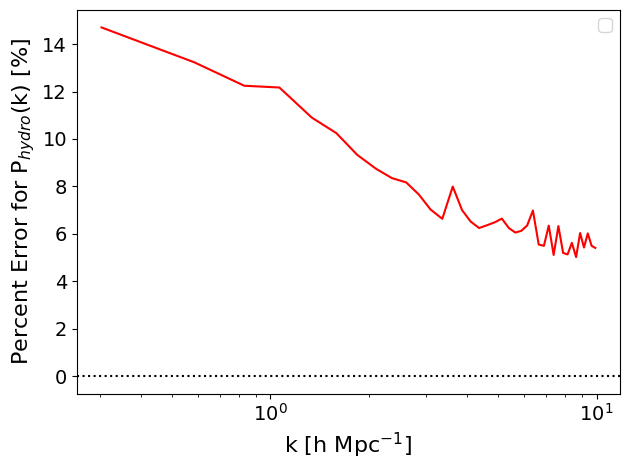

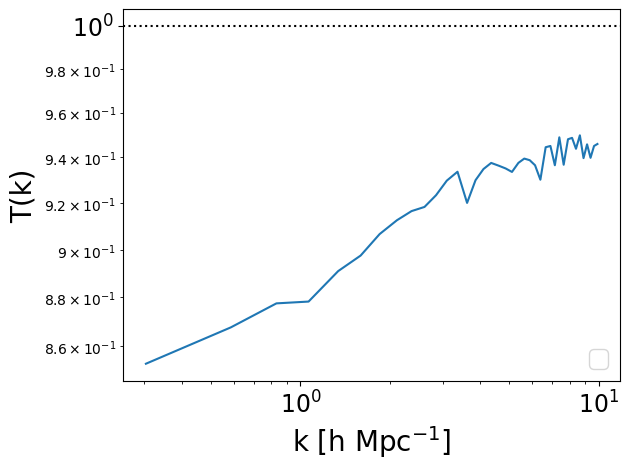

suite: Astrid
no high pass


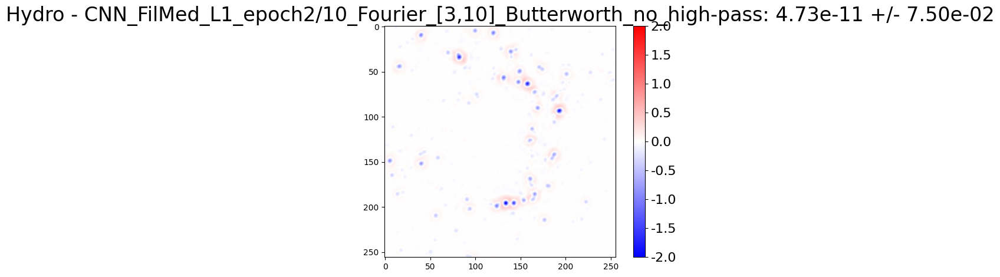

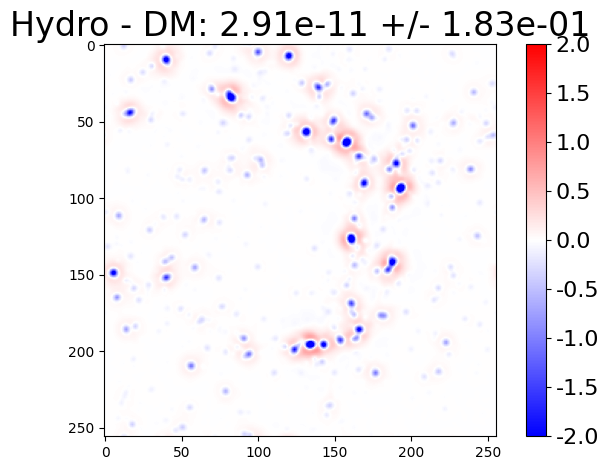

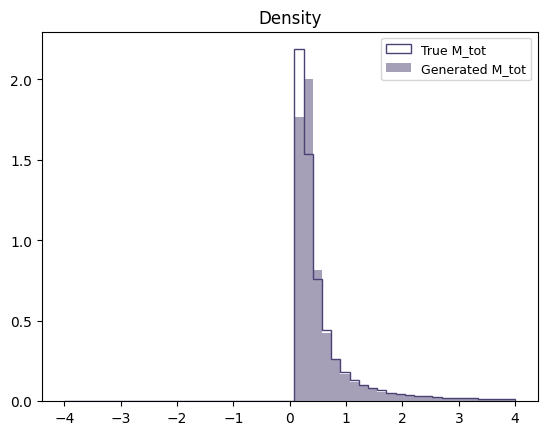


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


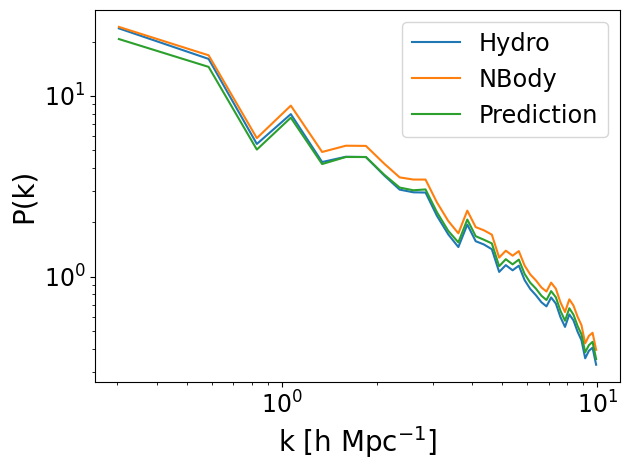

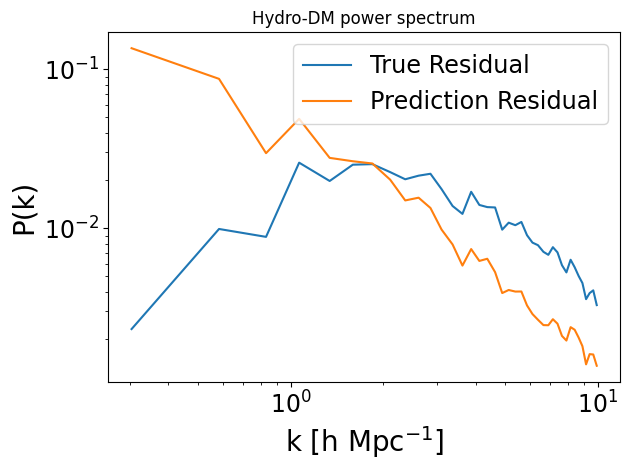

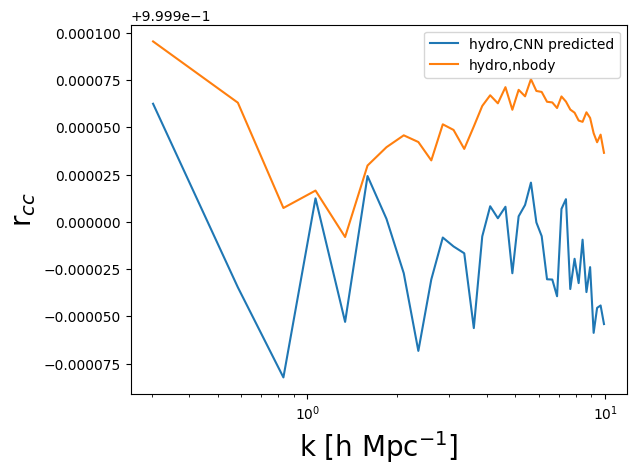

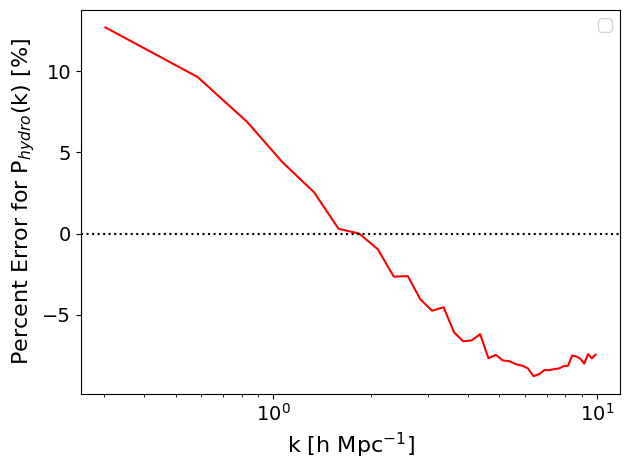

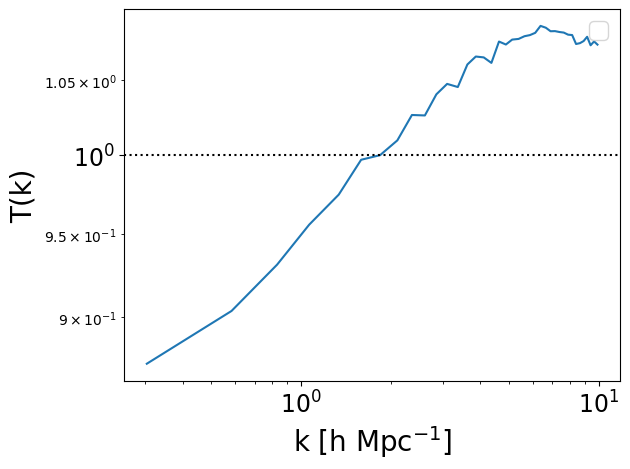

suite: Astrid
no high pass


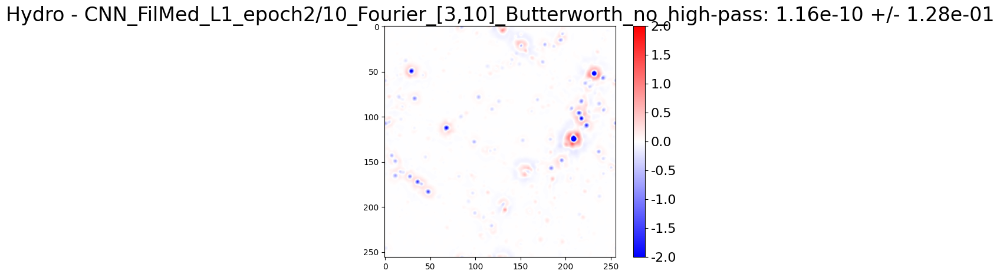

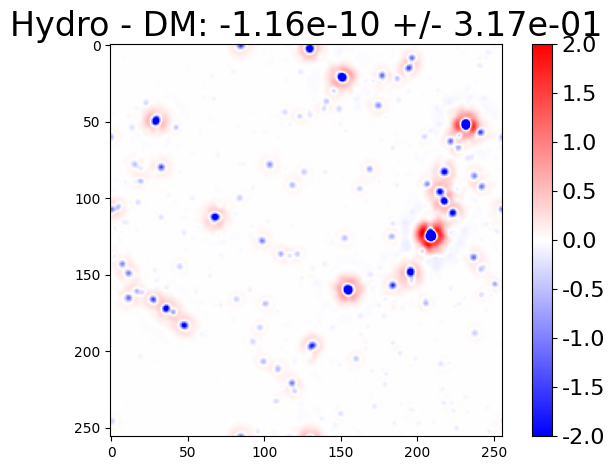

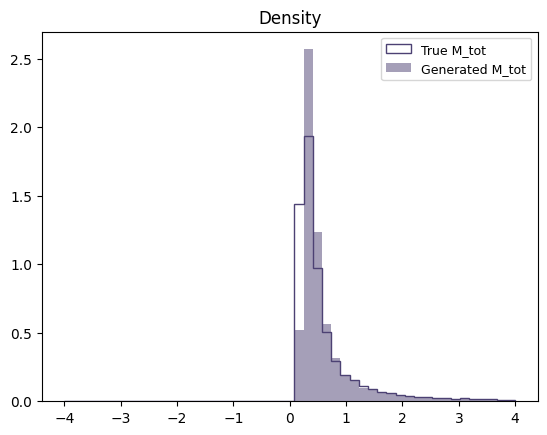


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


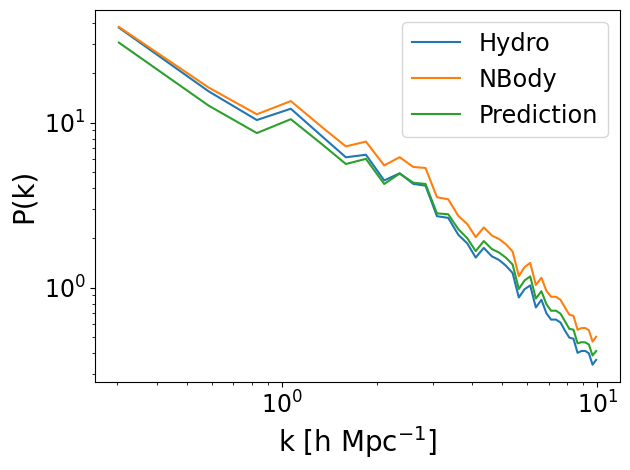

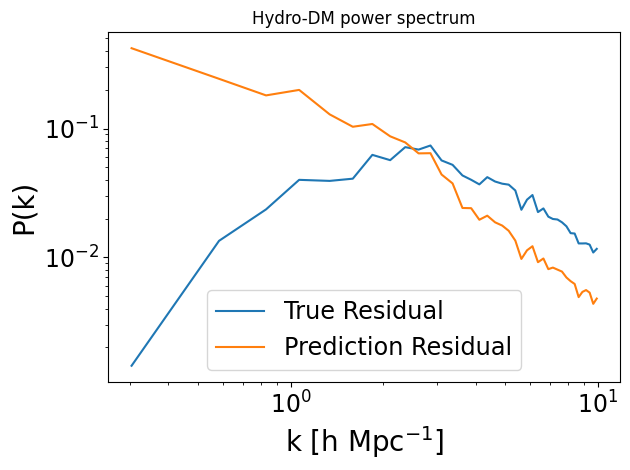

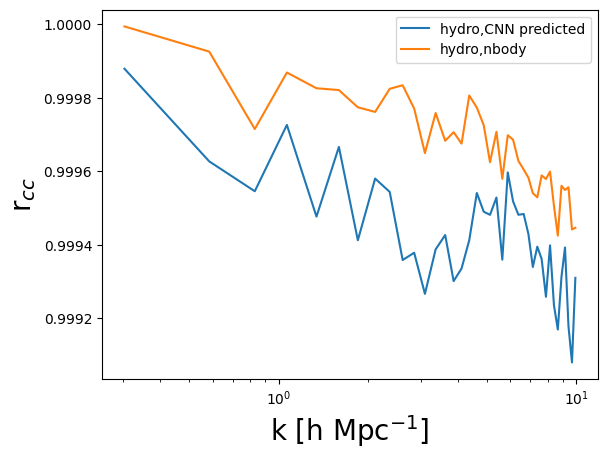

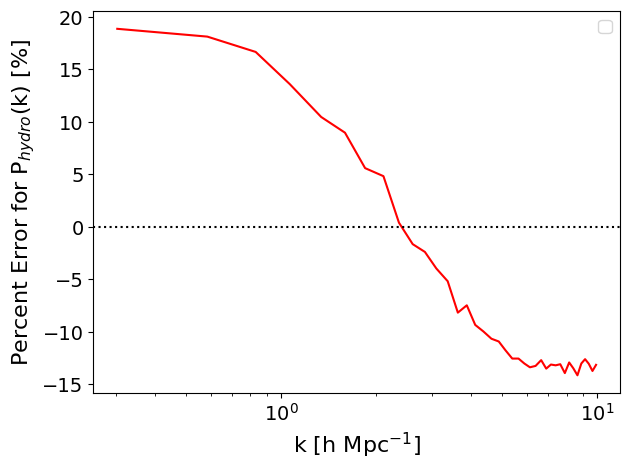

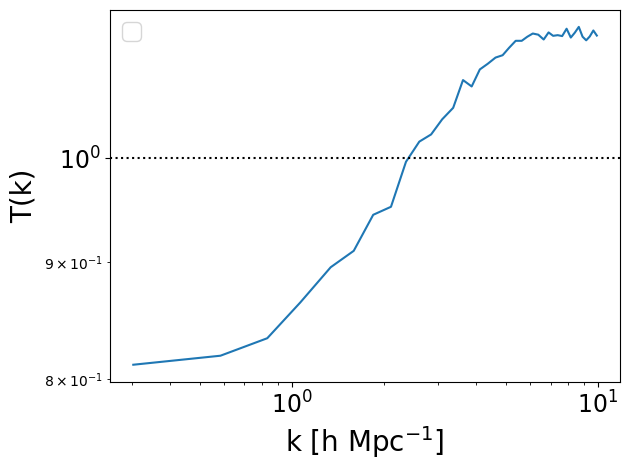

suite: Astrid
no high pass


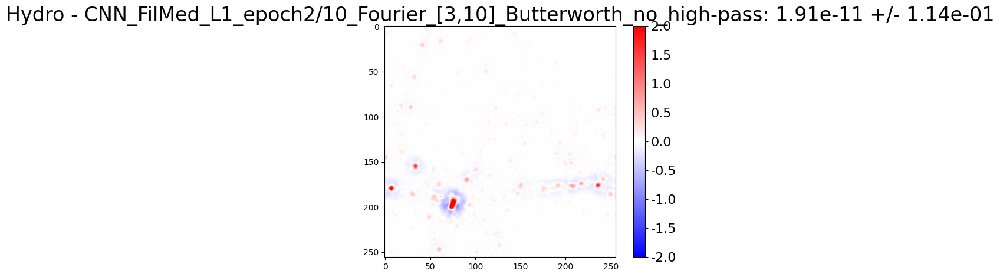

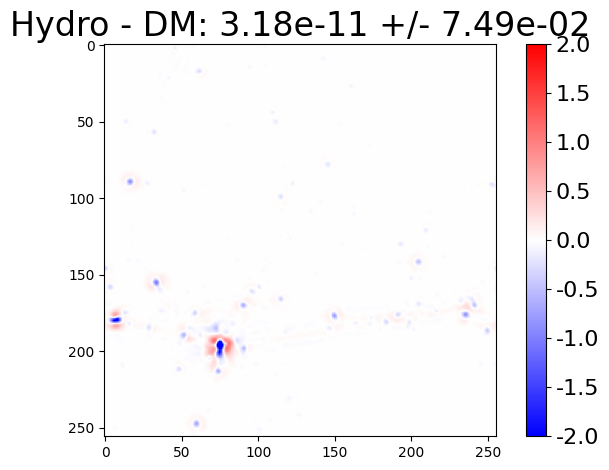

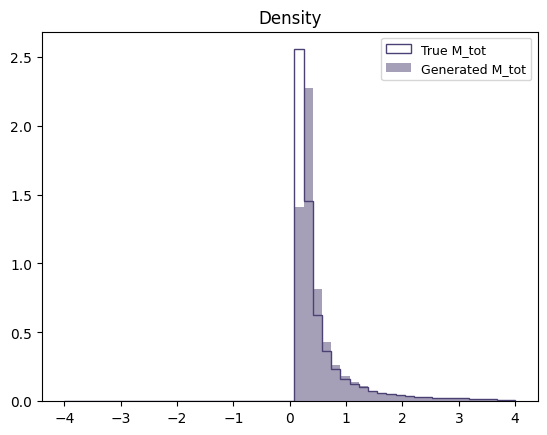


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


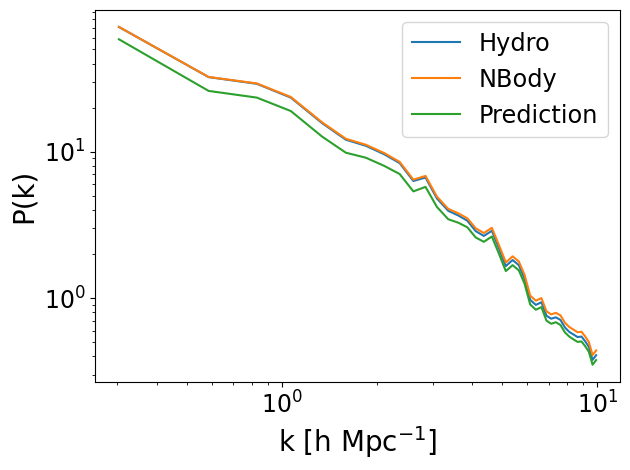

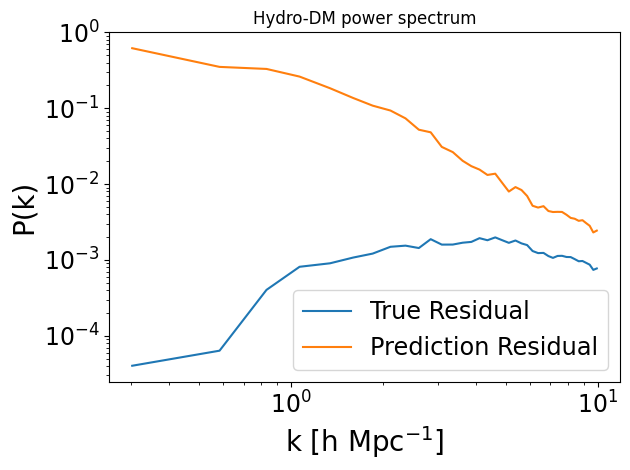

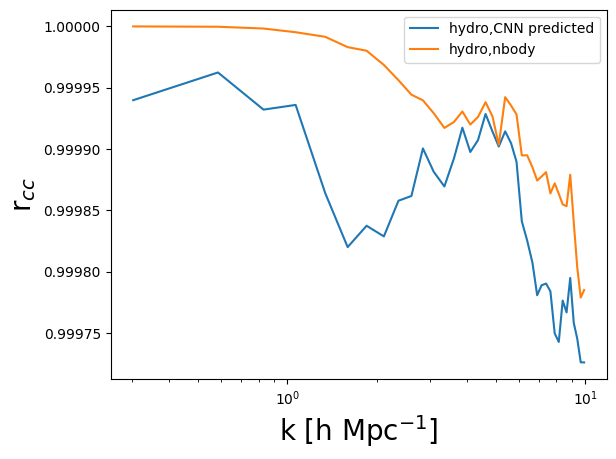

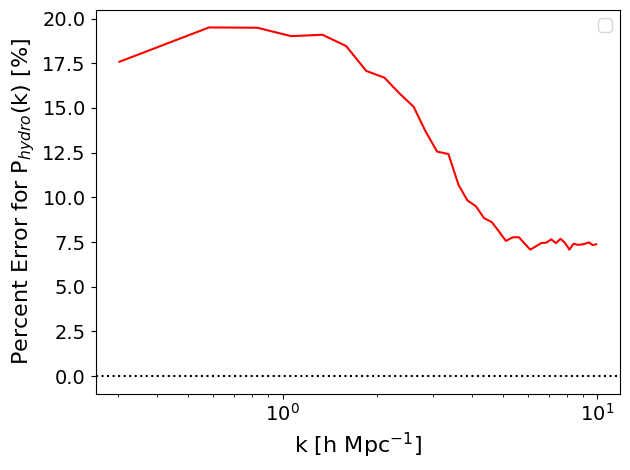

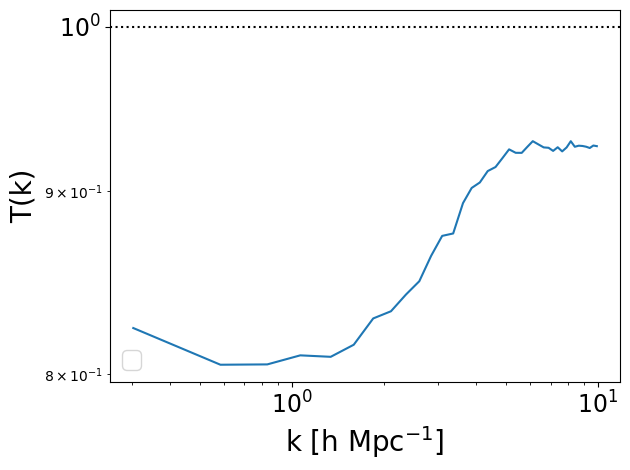

suite: Astrid
no high pass


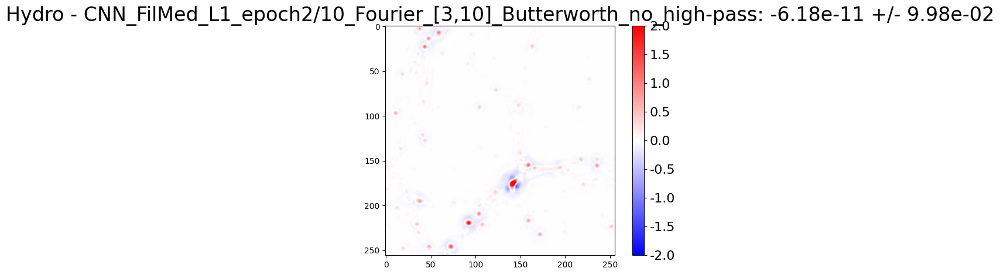

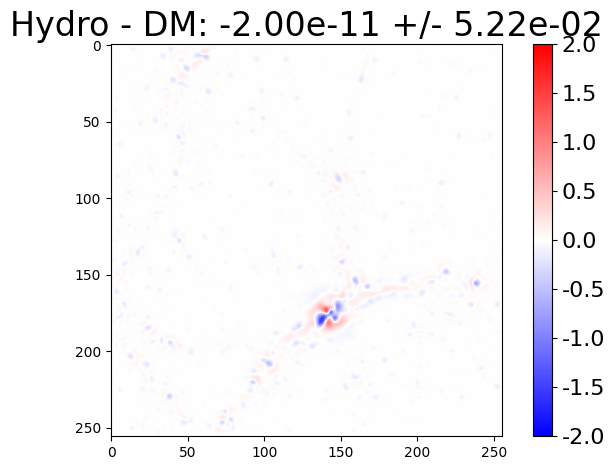

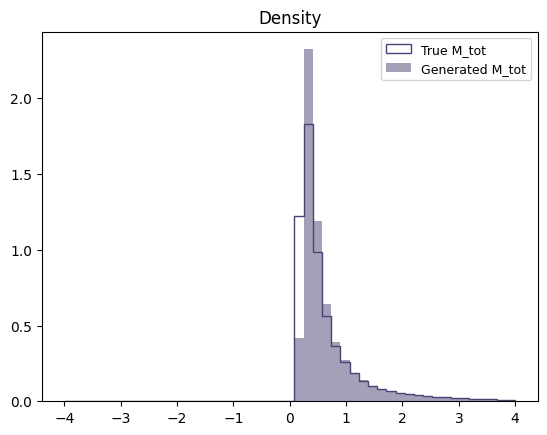


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


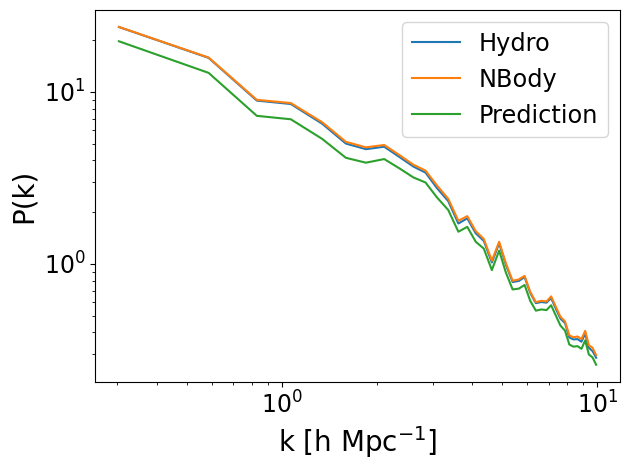

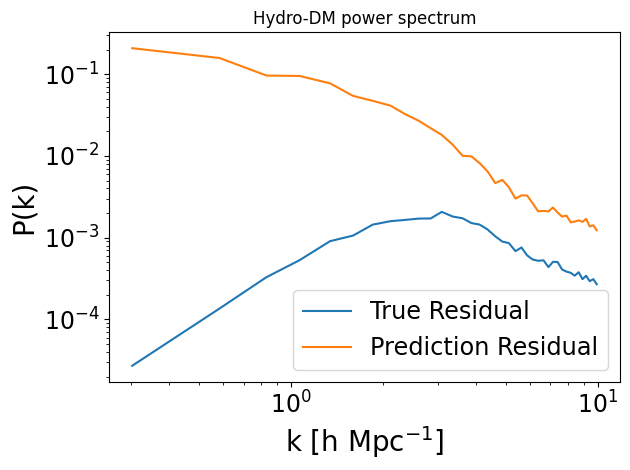

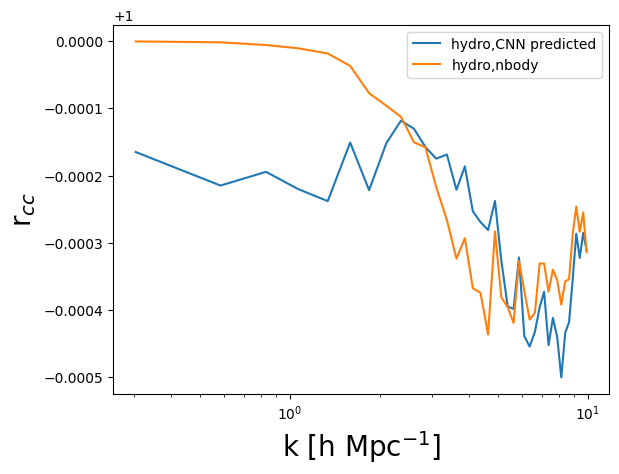

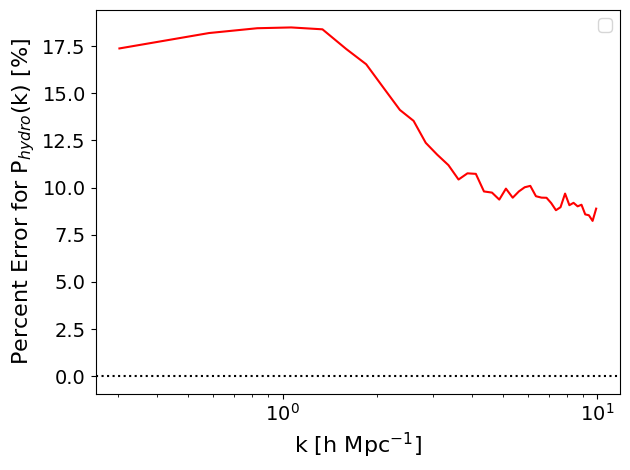

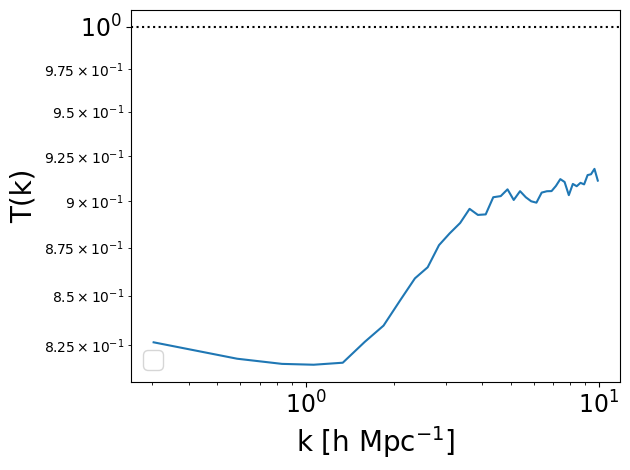

suite: Astrid
no high pass


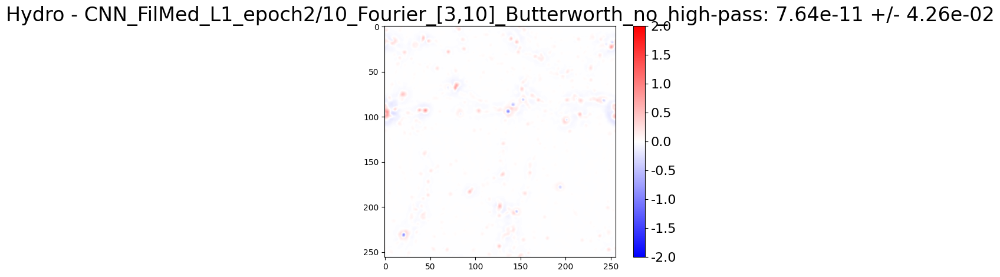

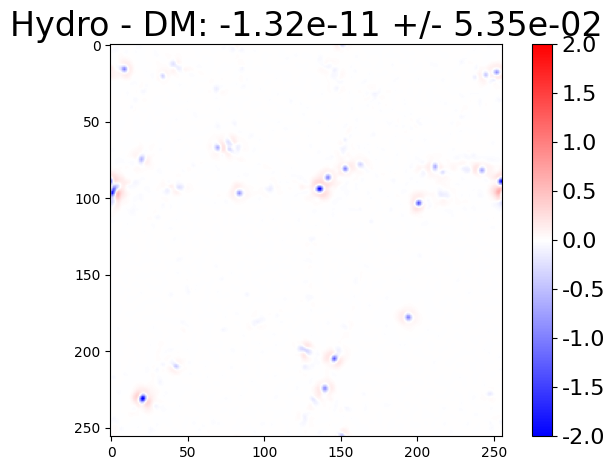

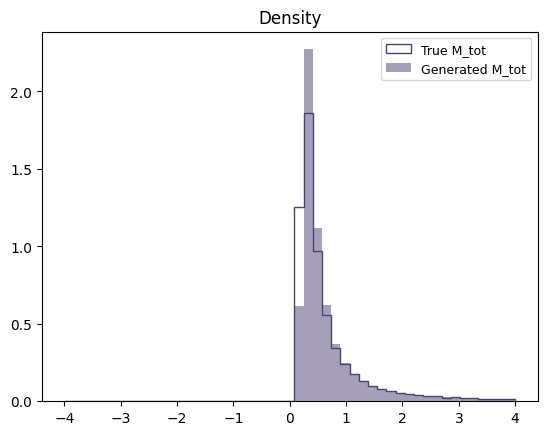


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


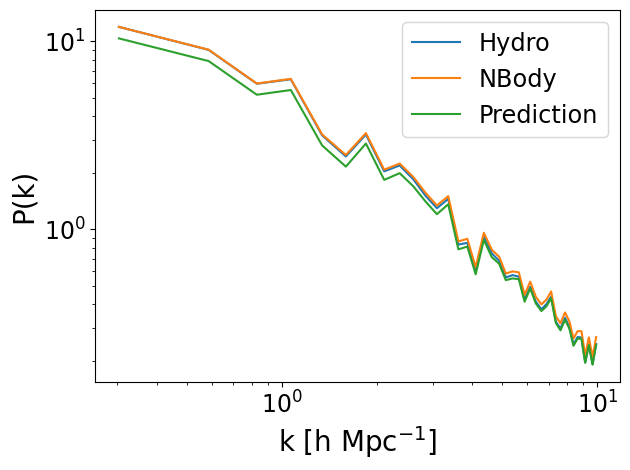

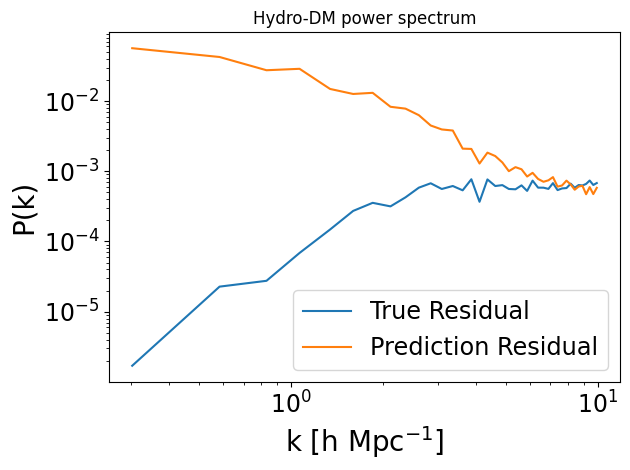

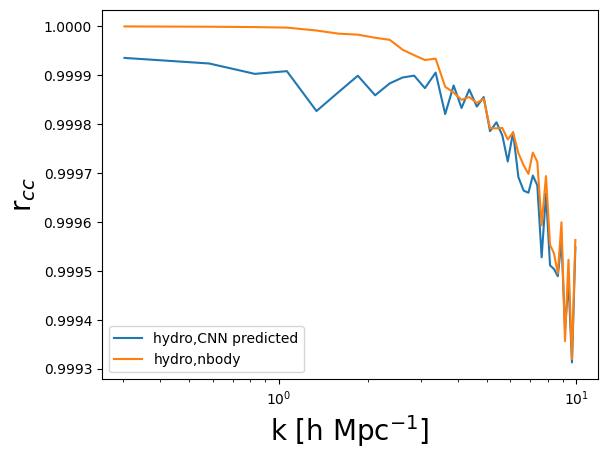

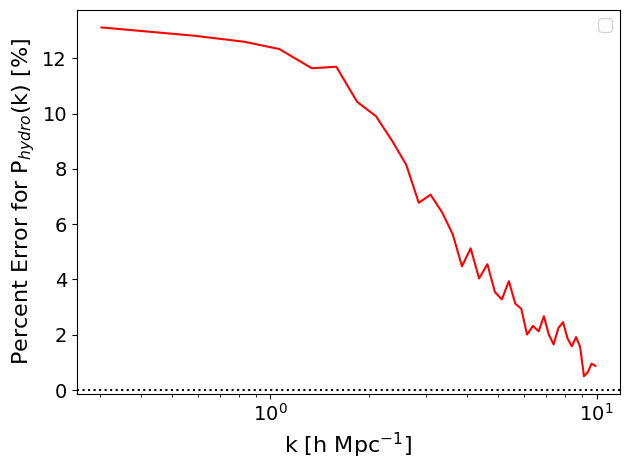

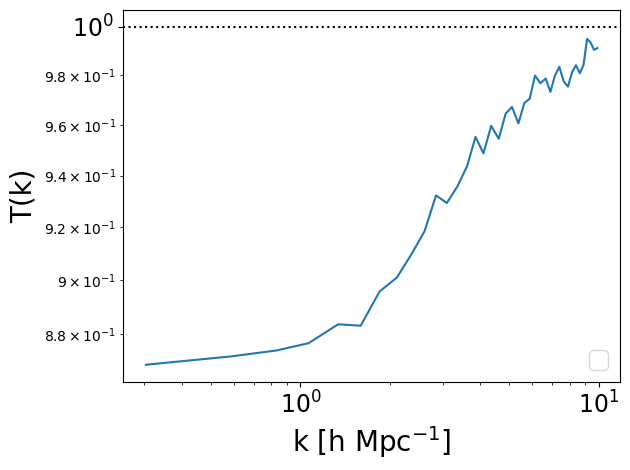

suite: Astrid
no high pass


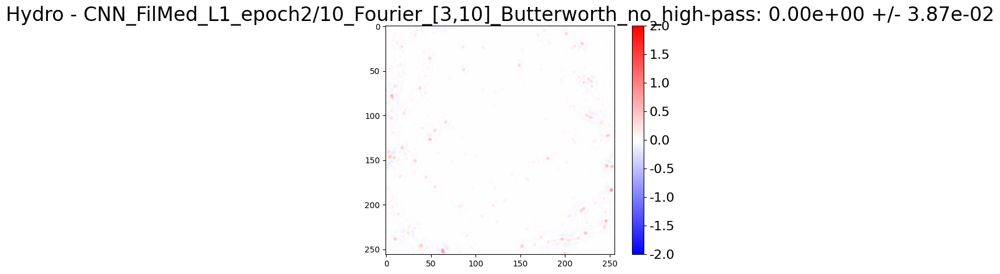

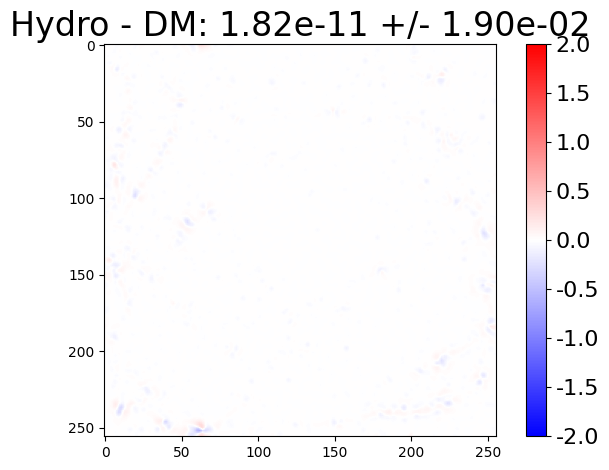

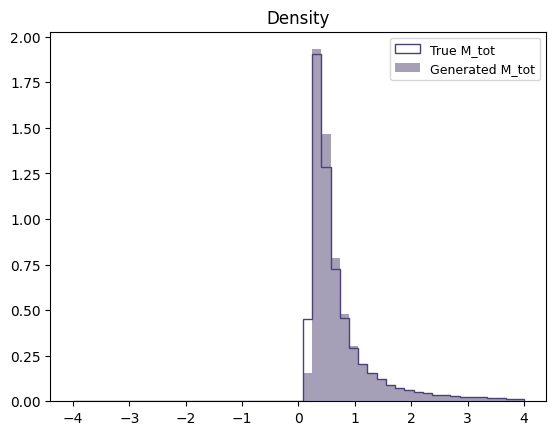


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


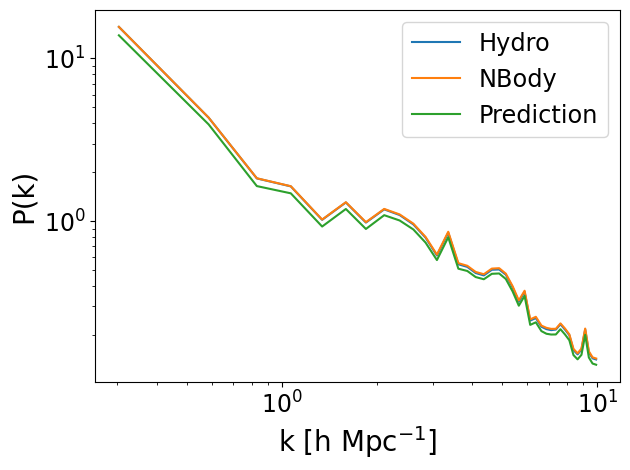

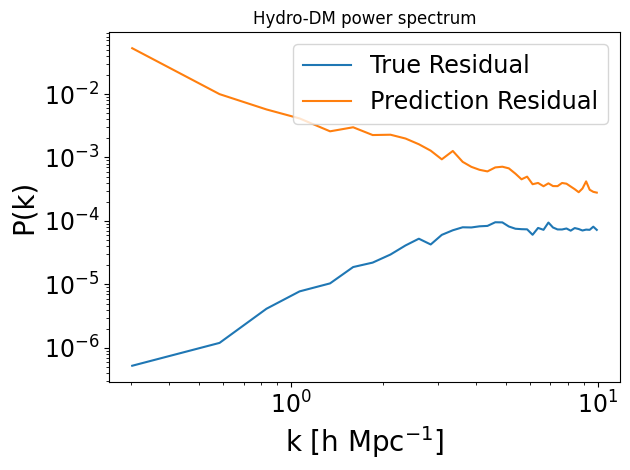

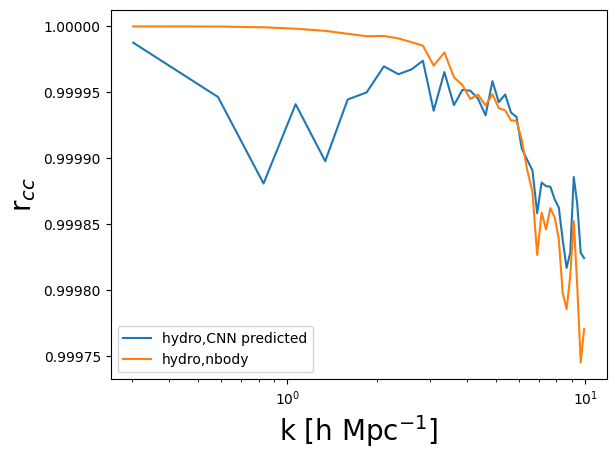

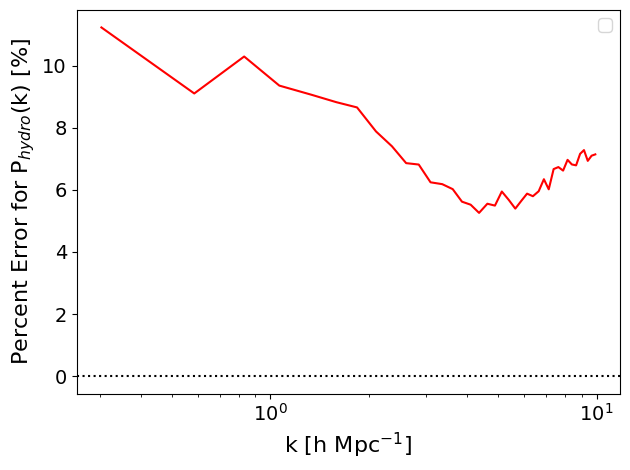

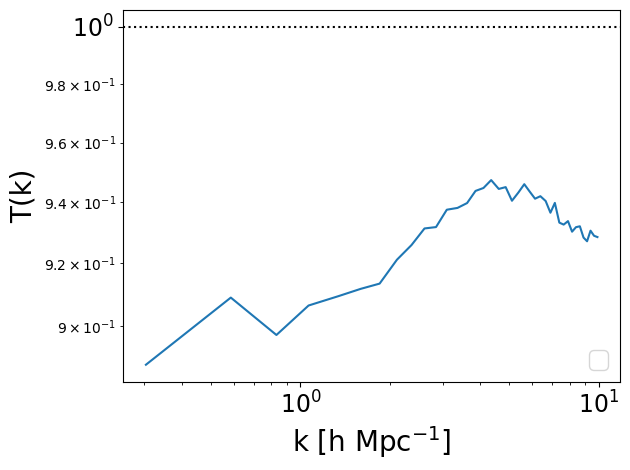

suite: Astrid
no high pass


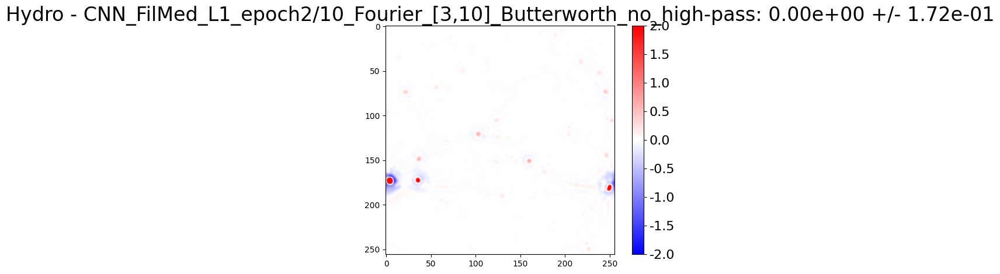

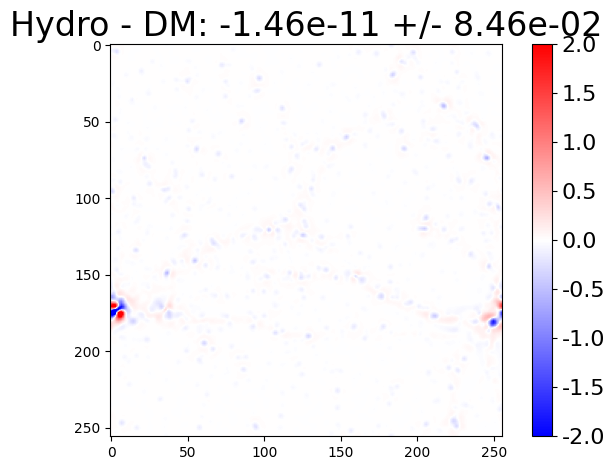

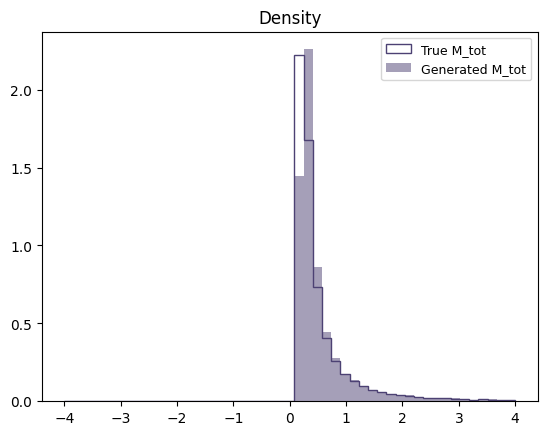


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


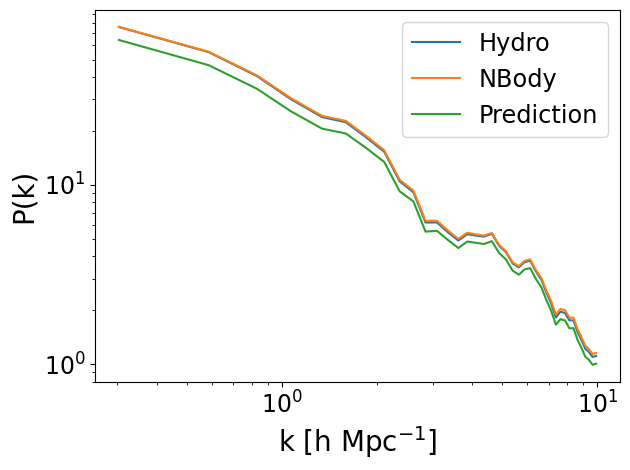

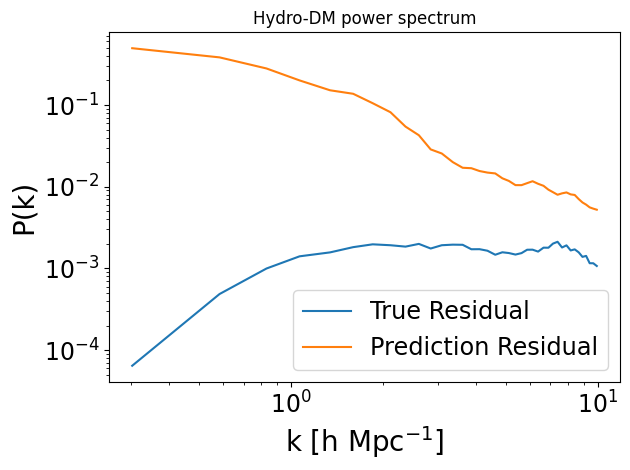

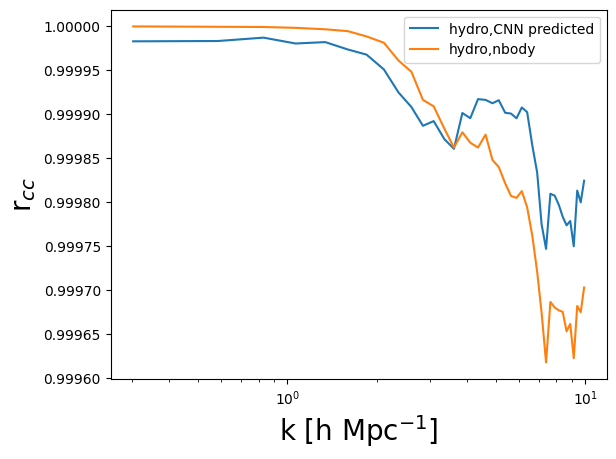

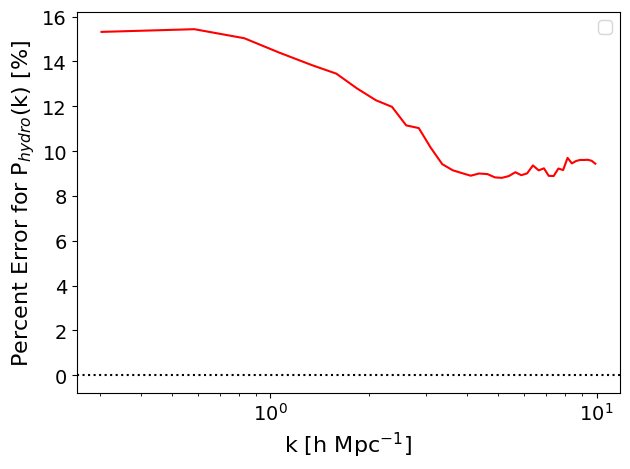

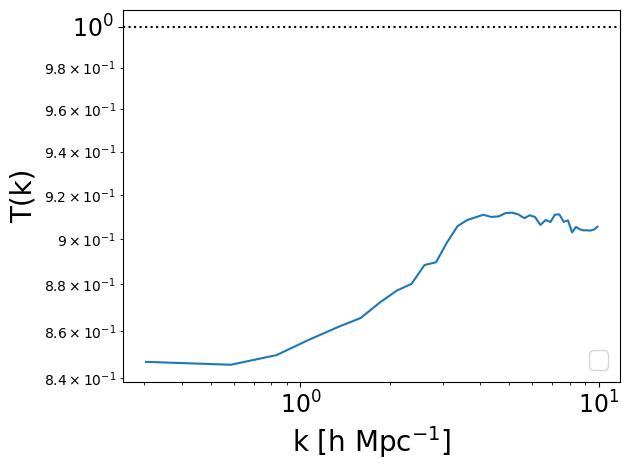

suite: Astrid
no high pass


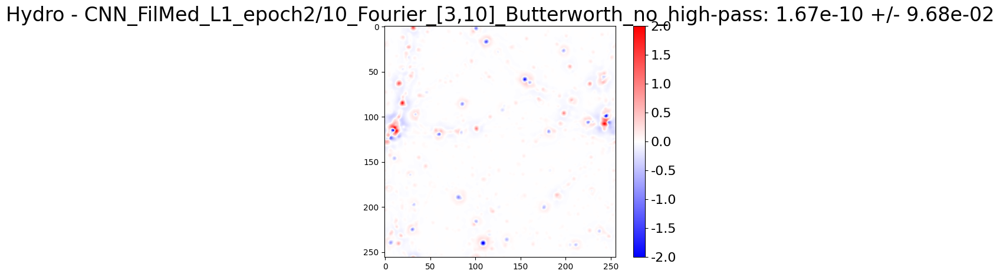

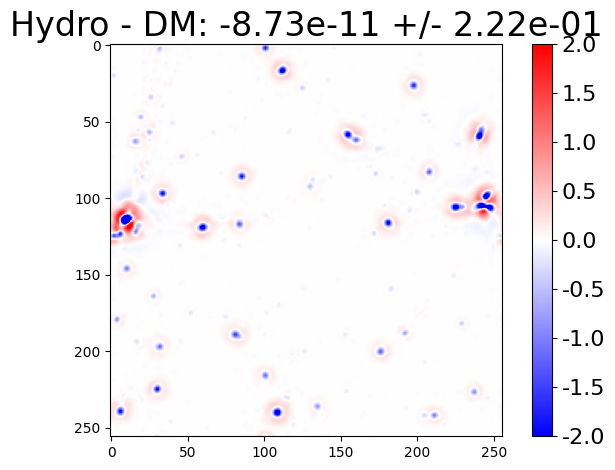

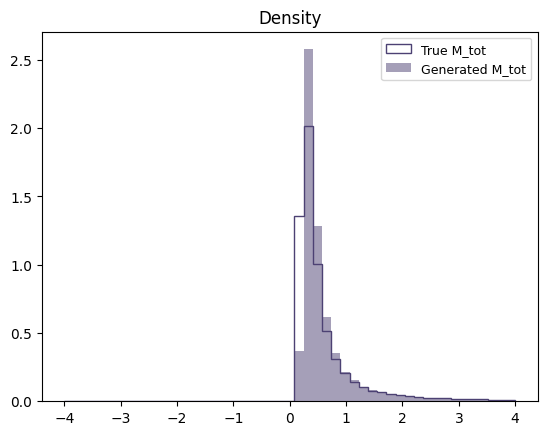


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


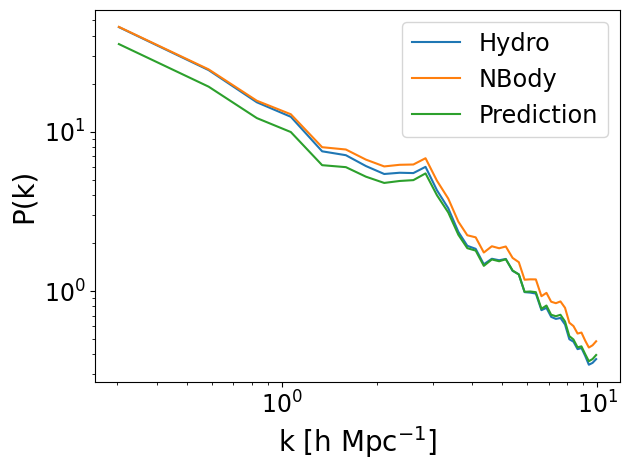

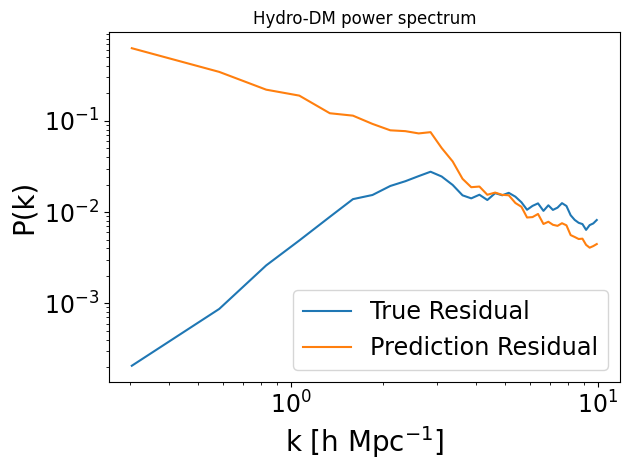

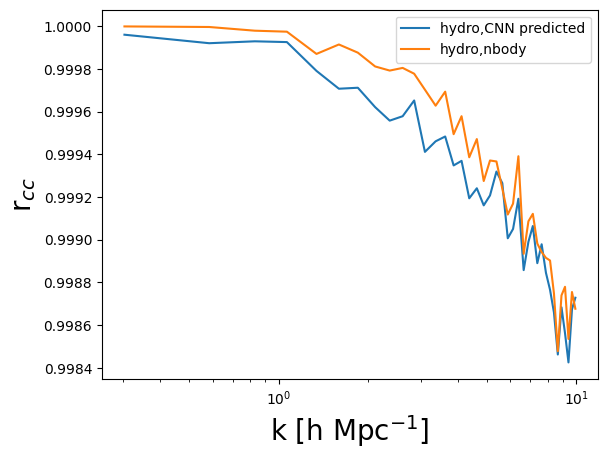

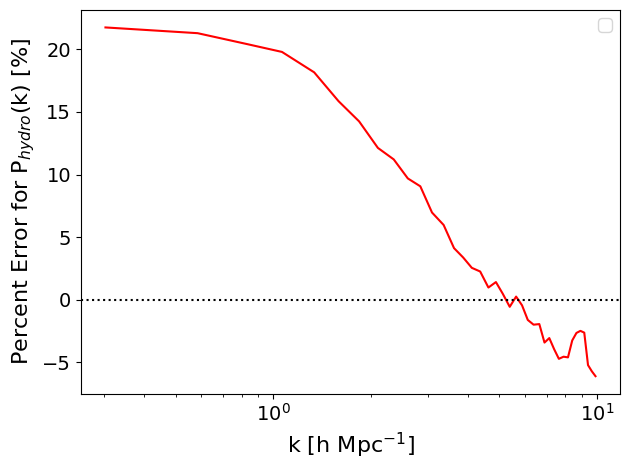

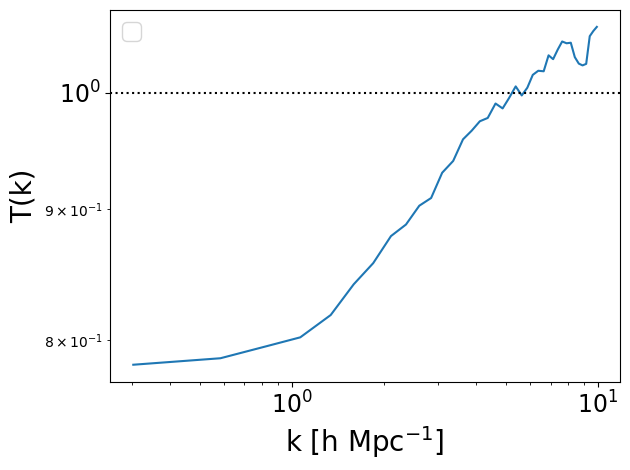

suite: Astrid
no high pass


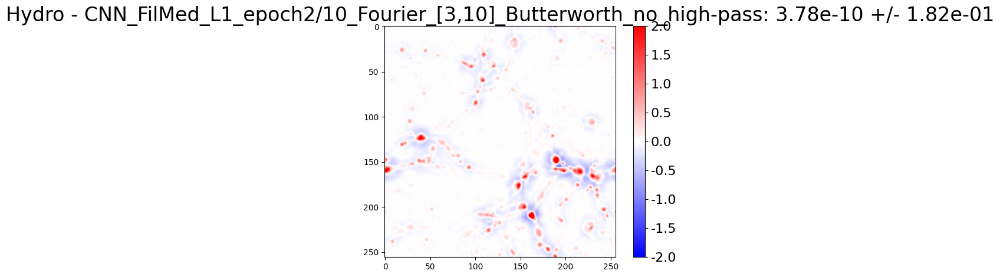

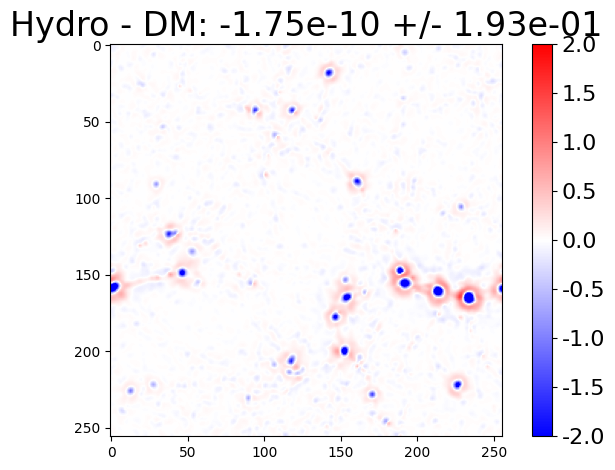

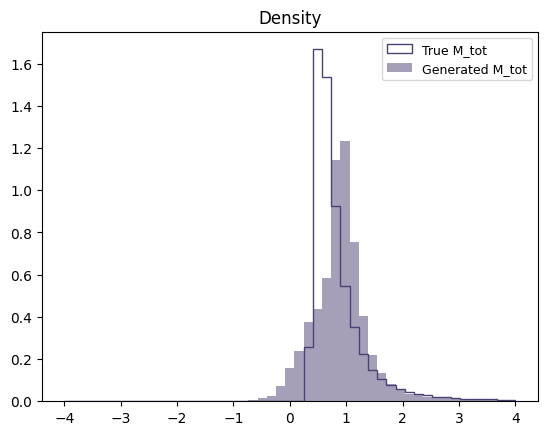


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


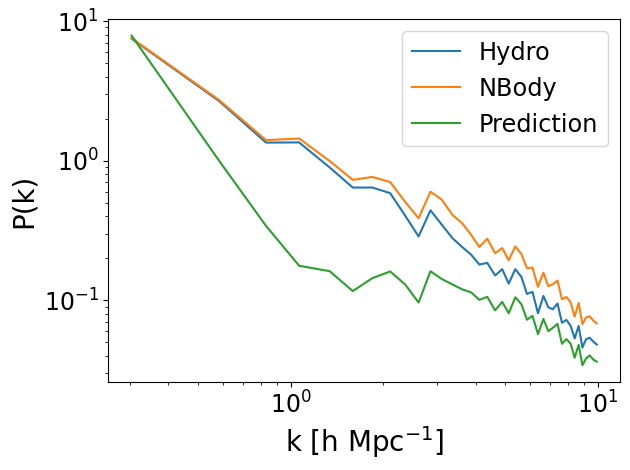

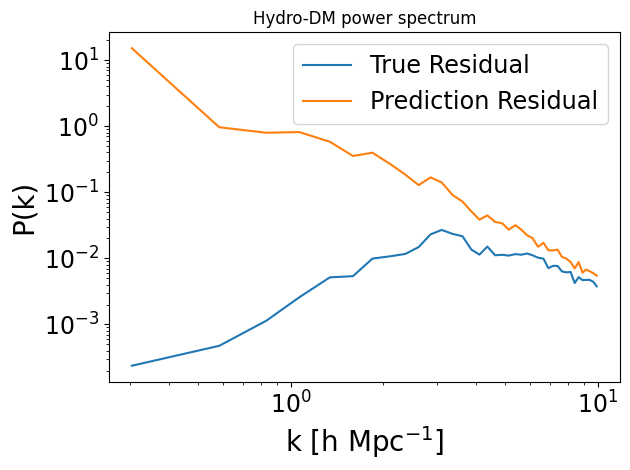

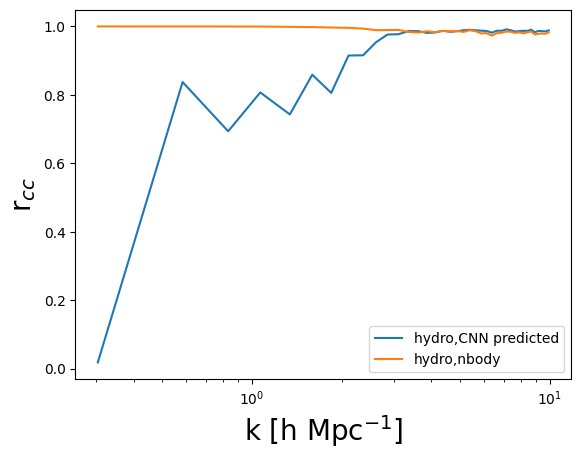

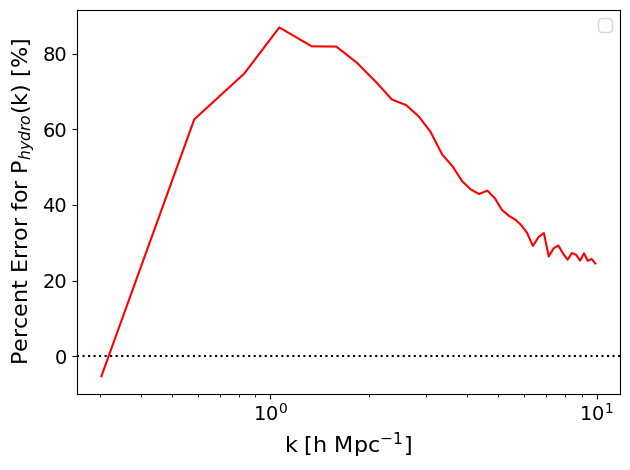

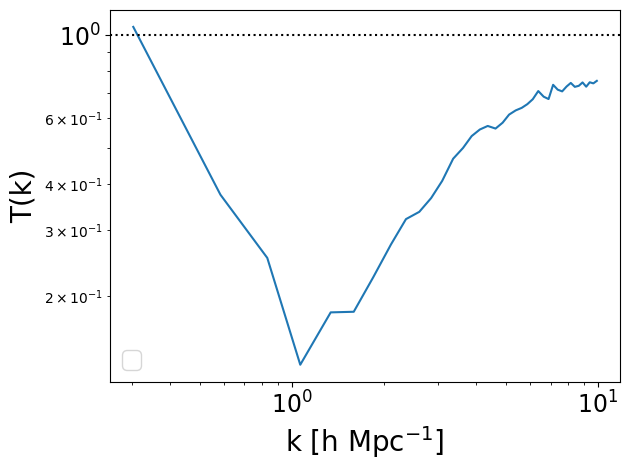

suite: Astrid
no high pass


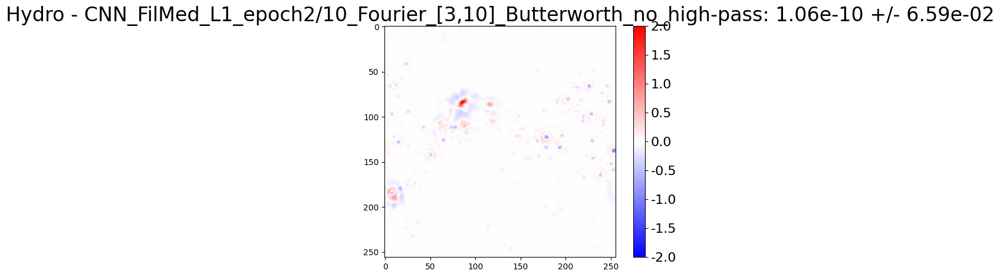

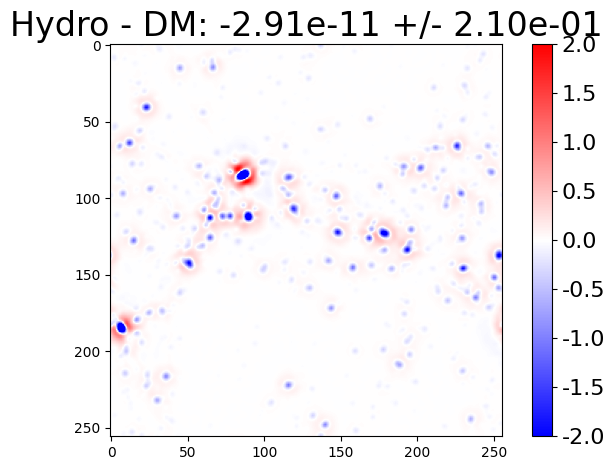

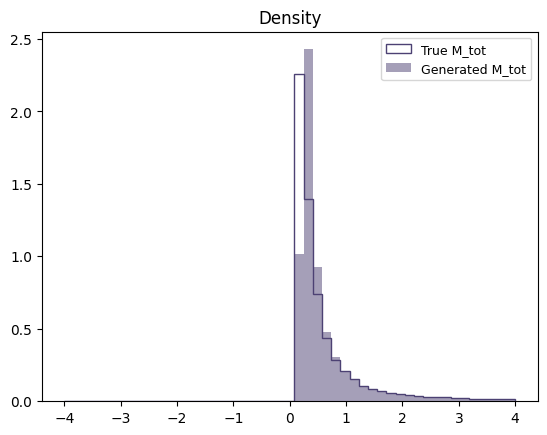


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


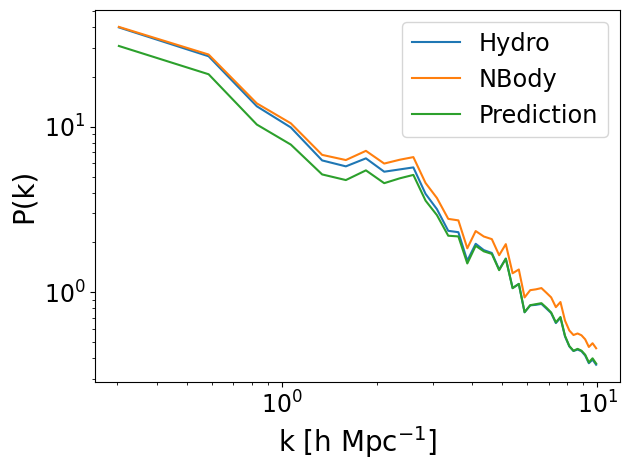

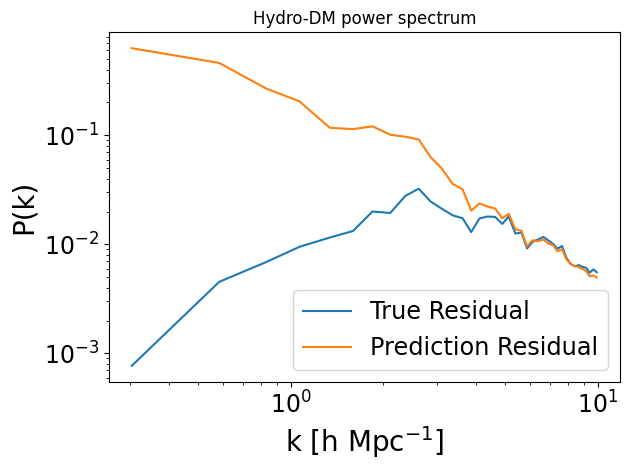

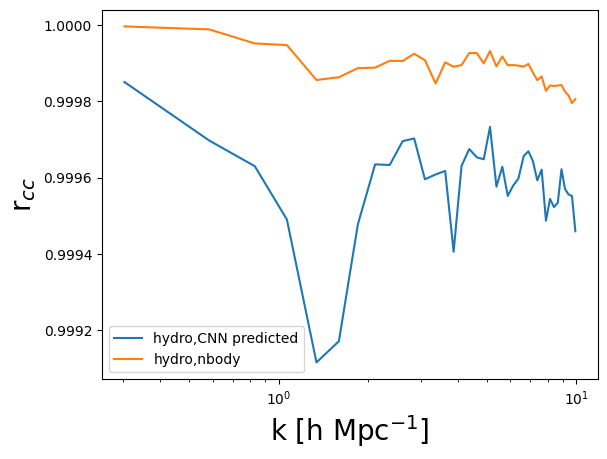

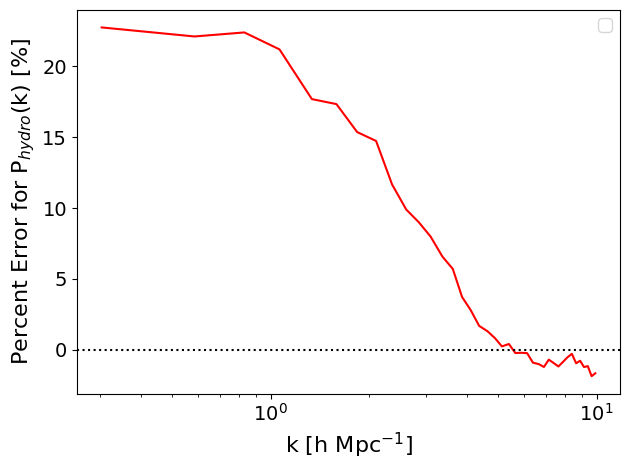

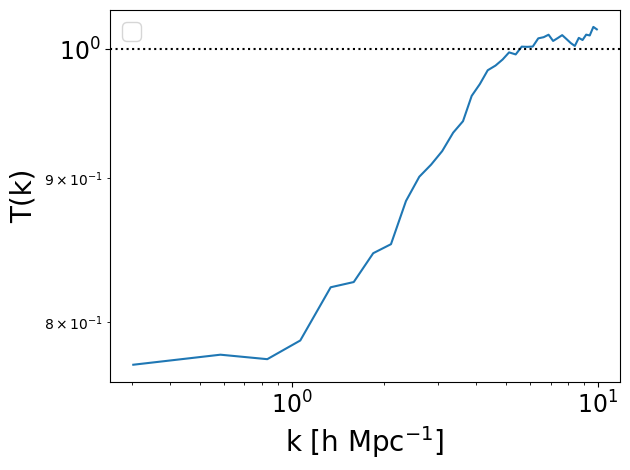

suite: Astrid
no high pass


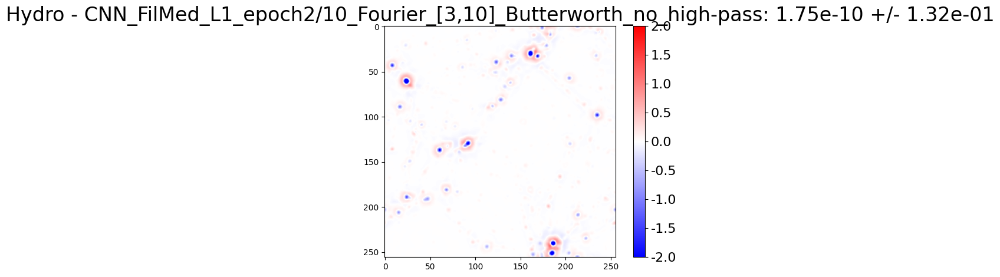

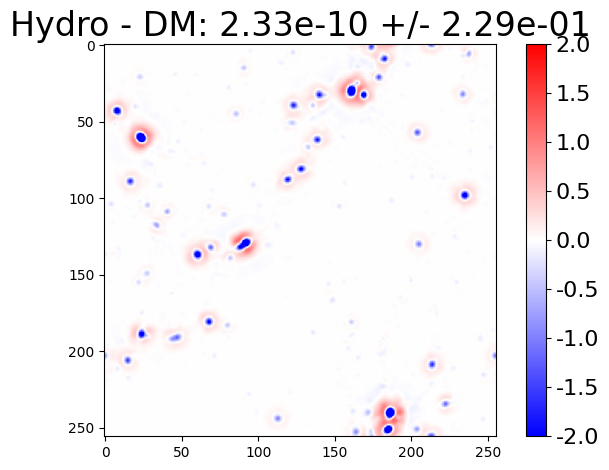

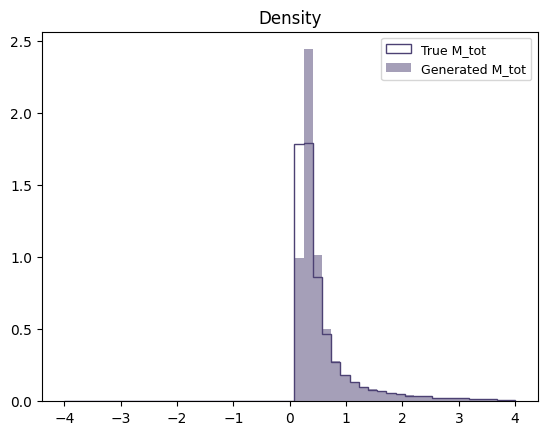


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


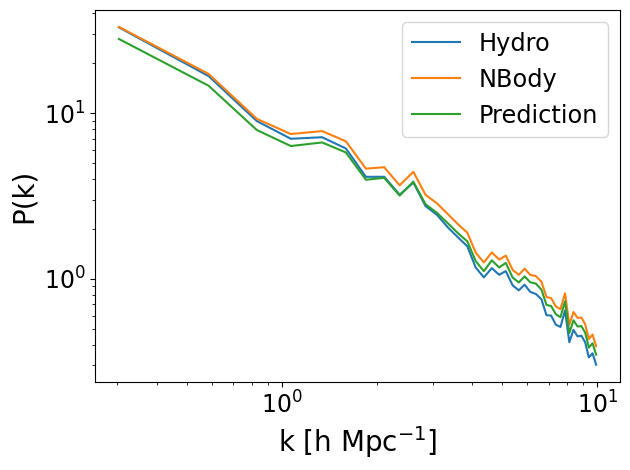

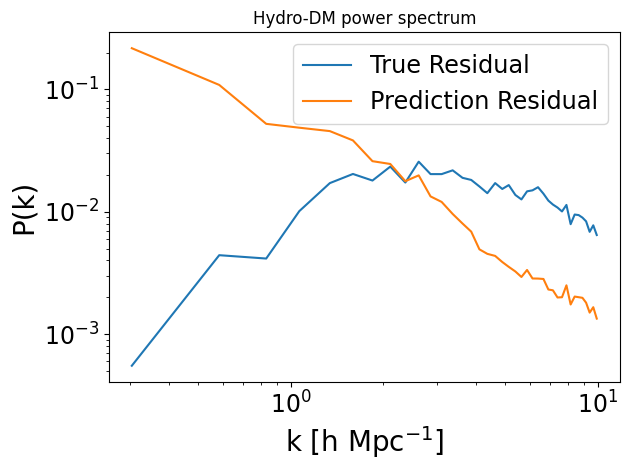

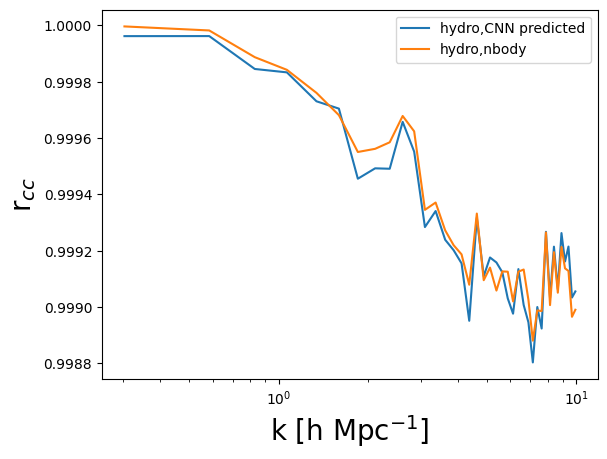

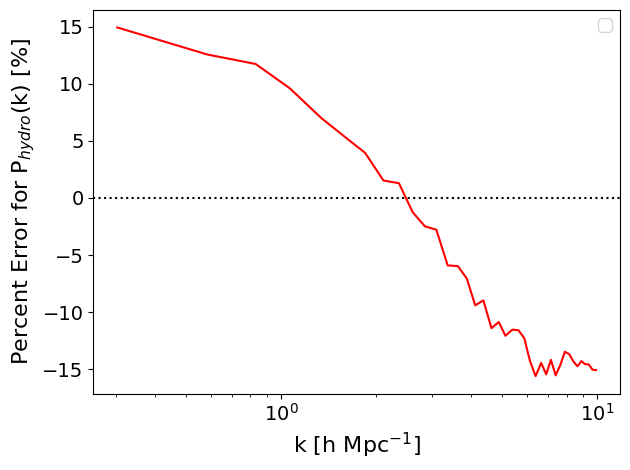

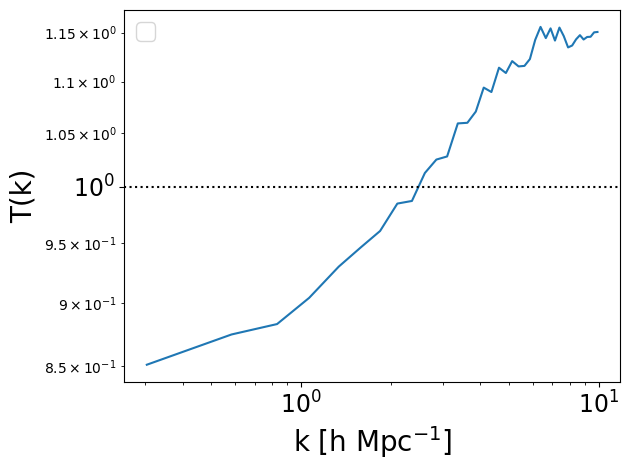

suite: Astrid
no high pass


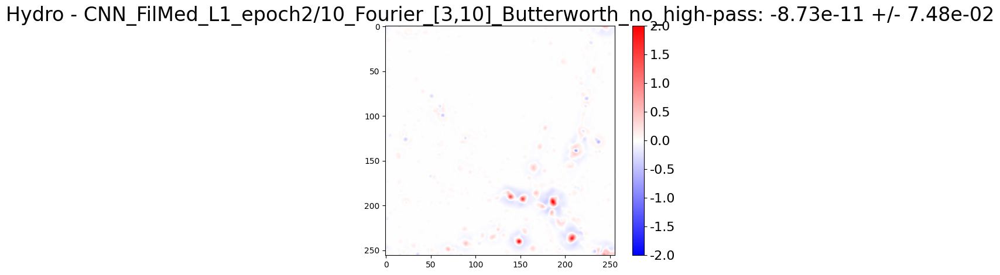

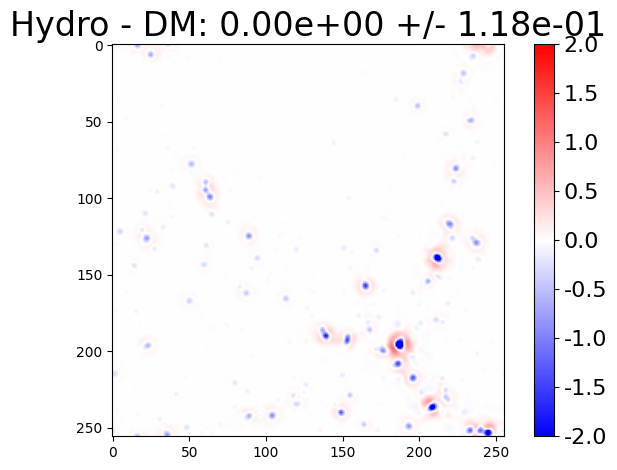

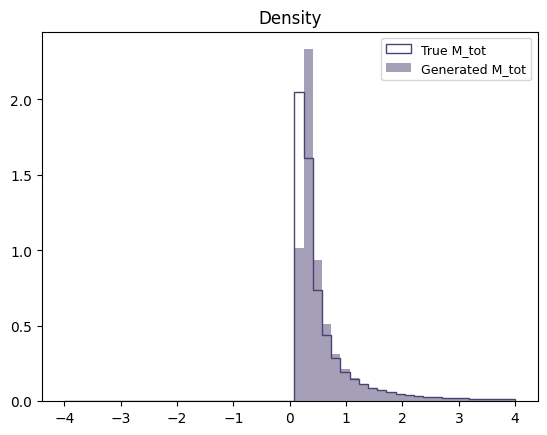


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


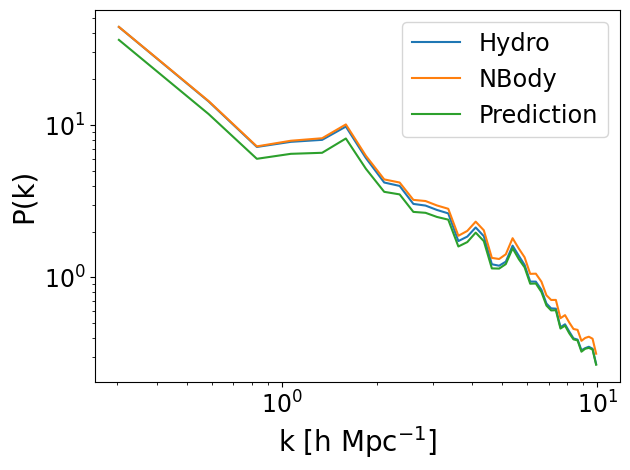

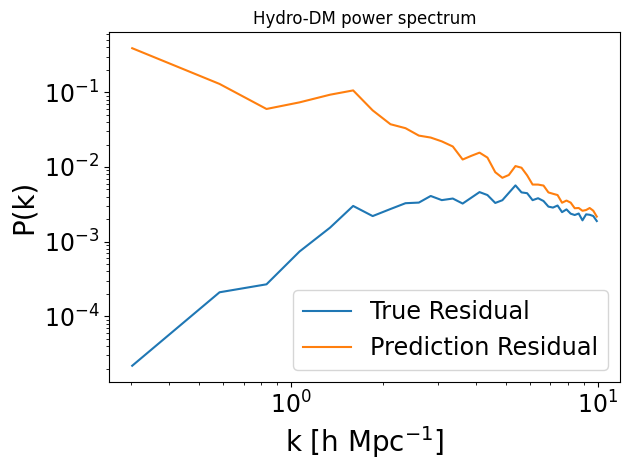

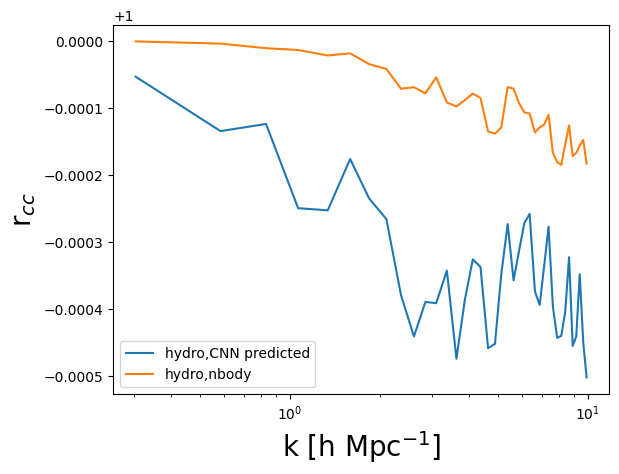

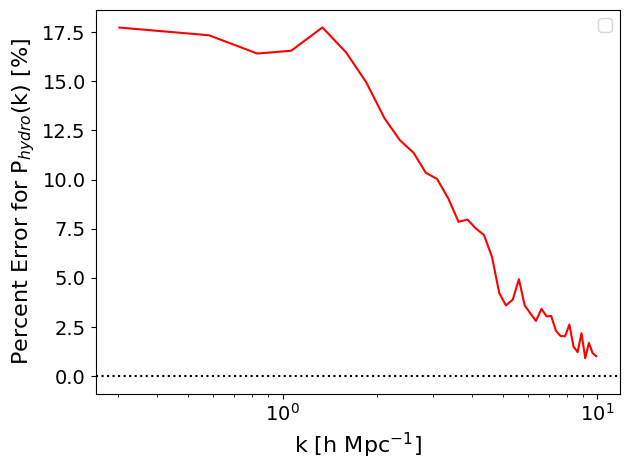

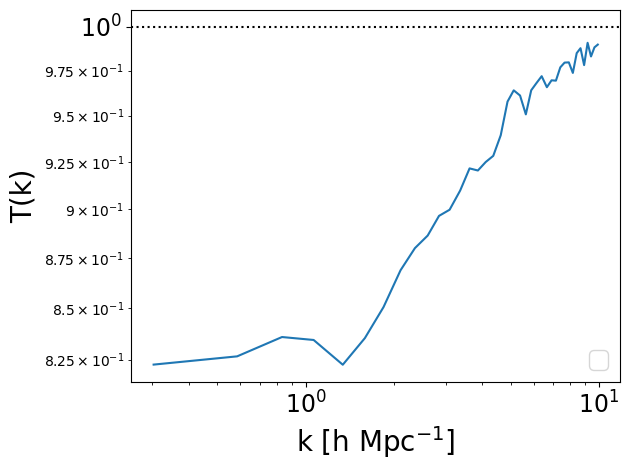

suite: Astrid
no high pass


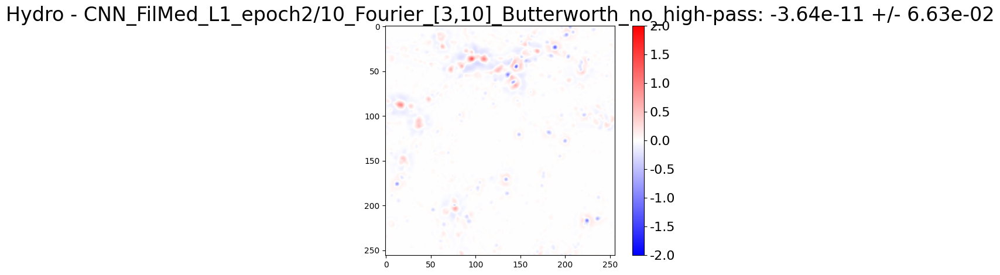

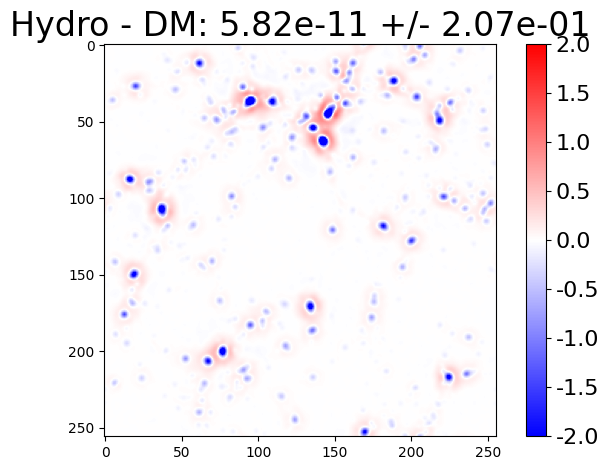

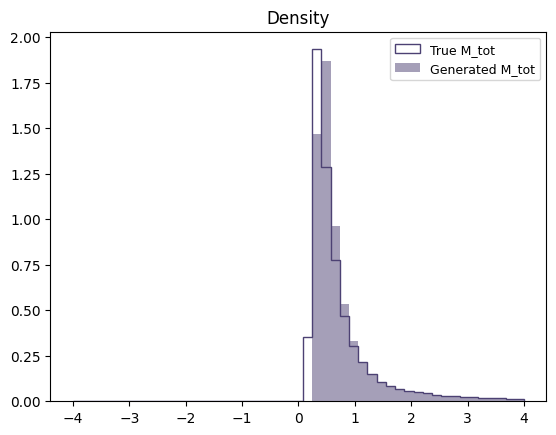


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


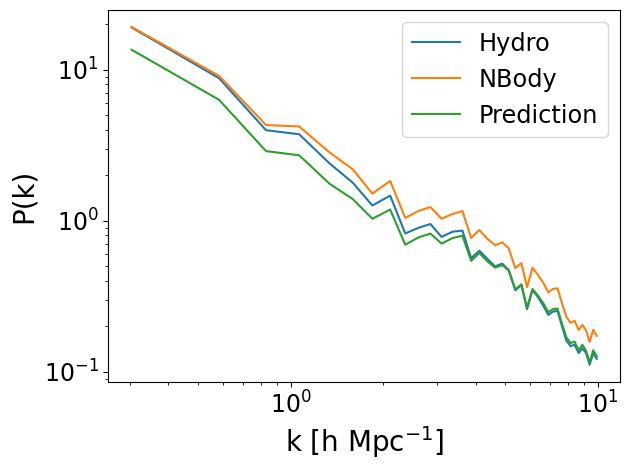

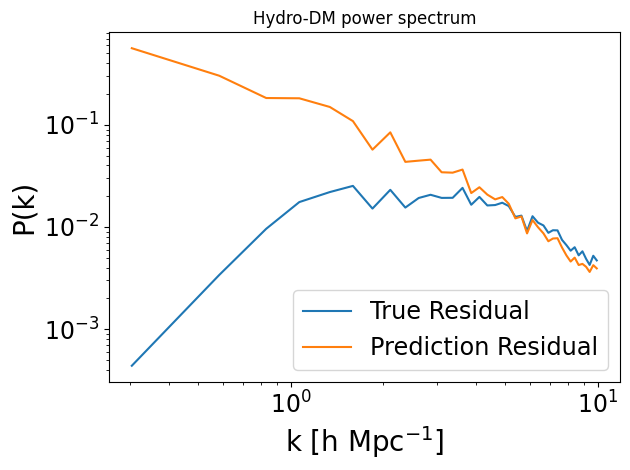

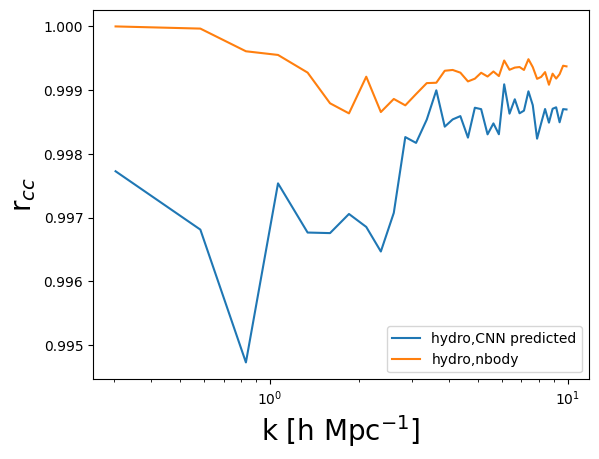

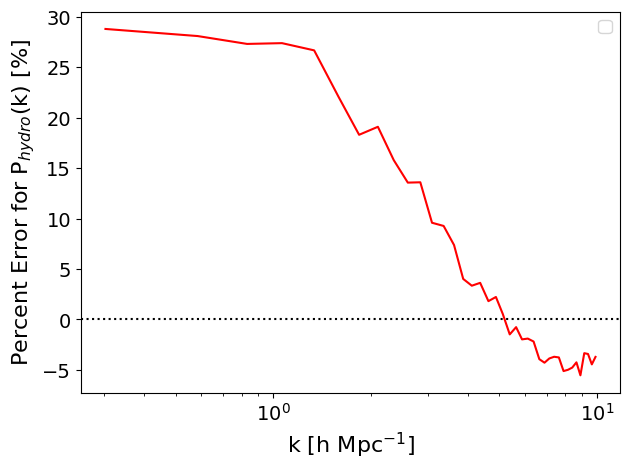

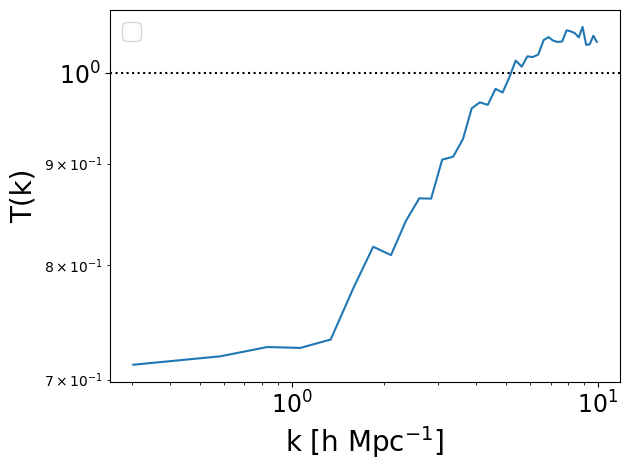

In [45]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_L1_epoch2/10_Fourier_[3,10]_Butterworth_no_high-pass'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
order = 2 
low_pass = 1 / (1 + (k / 10)**(2 * order))
high_pass = 1 / (1 + (3 / k)**(2 * order))
filter_mask = low_pass*high_pass
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = np.arange(0, 300, 20)
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    diff = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    plt.hist((conditioning+target).detach().flatten(), bins=np.linspace(-4, 4, 50), histtype='step', color='#4c4173', label="True M_tot", density=True)
    plt.hist(postTF_grid.detach().flatten(), bins=np.linspace(-4, 4, 50), alpha=0.5, color='#4c4173', label="Generated M_tot", density=True)
    plt.legend(fontsize=9)
    plt.title("Density")
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## L1 + epoch 2/10 Fourier [3,10]* **5e-5** lr:1e-3 adamw decay: 1e-5 -> 1e-2  Butterworth window for L_fft
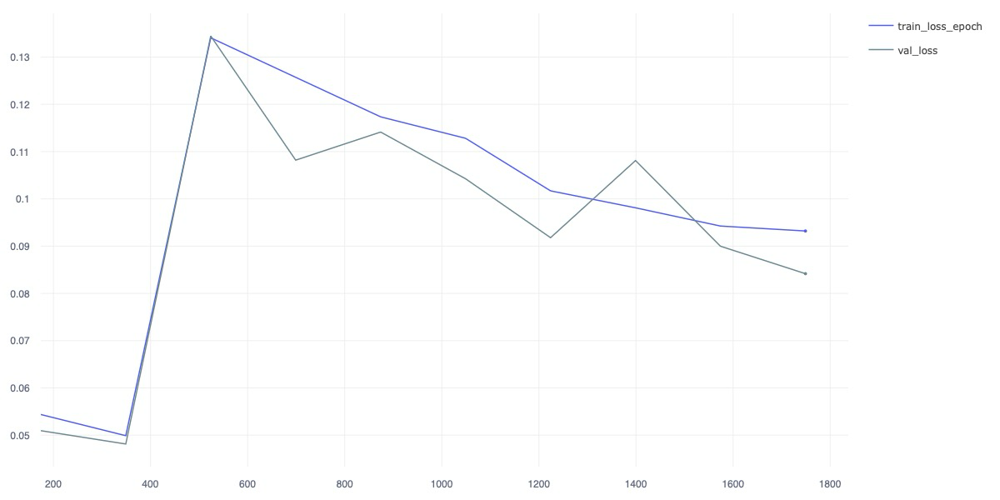

suite: Astrid


/global/homes/l/lindajin/UNet_apply.py:495: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict=torch.load(ckpt, map_location=torch.device("cpu"))["state_dict"]


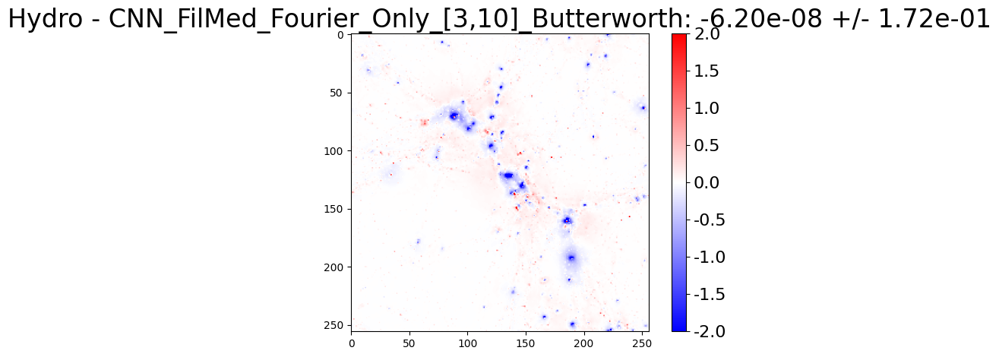

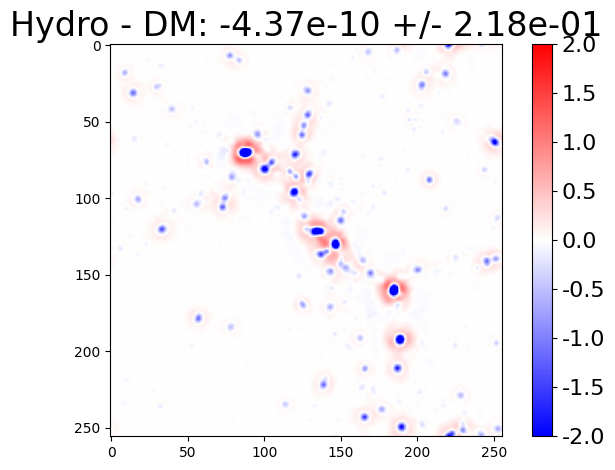


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


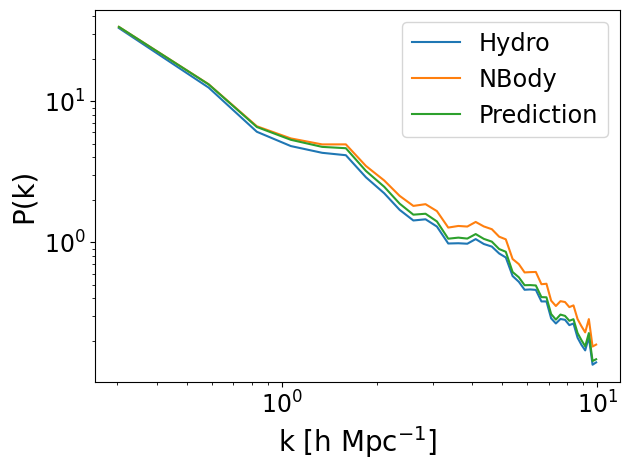

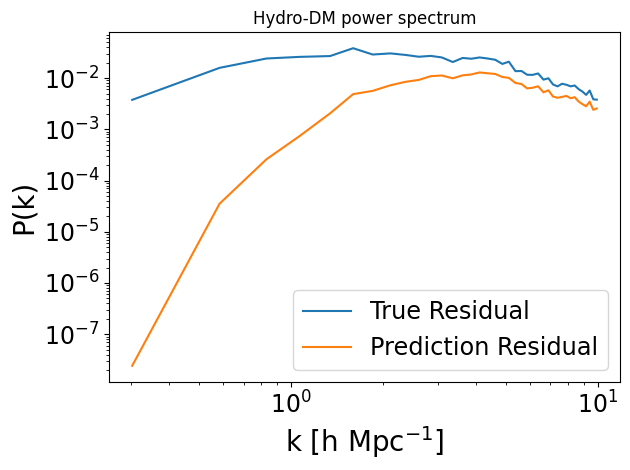

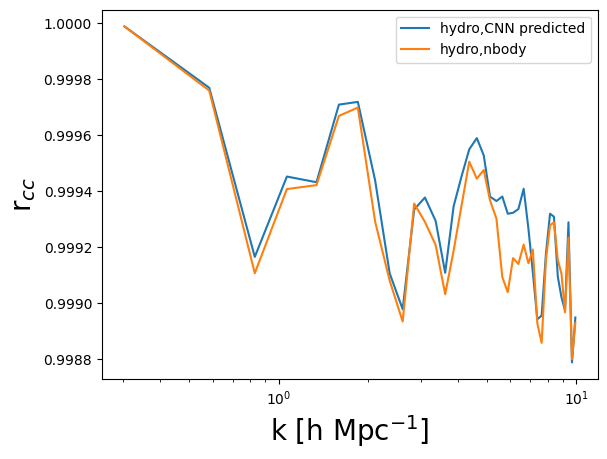

/tmp/ipykernel_1304379/1605644766.py:120: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


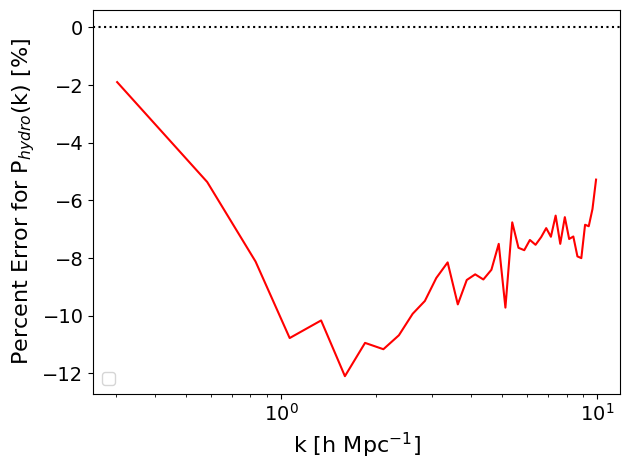

/tmp/ipykernel_1304379/1605644766.py:130: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


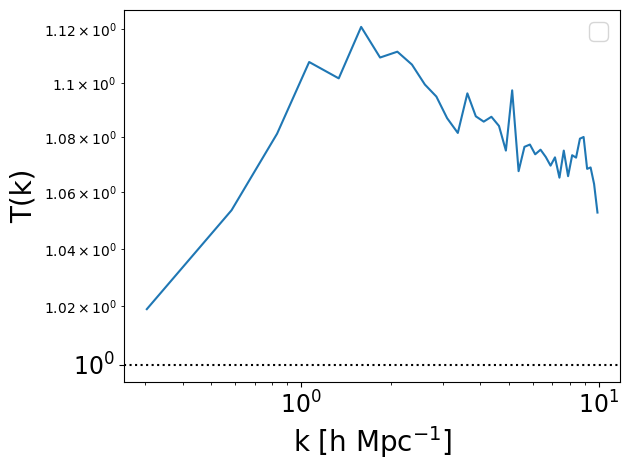

suite: Astrid


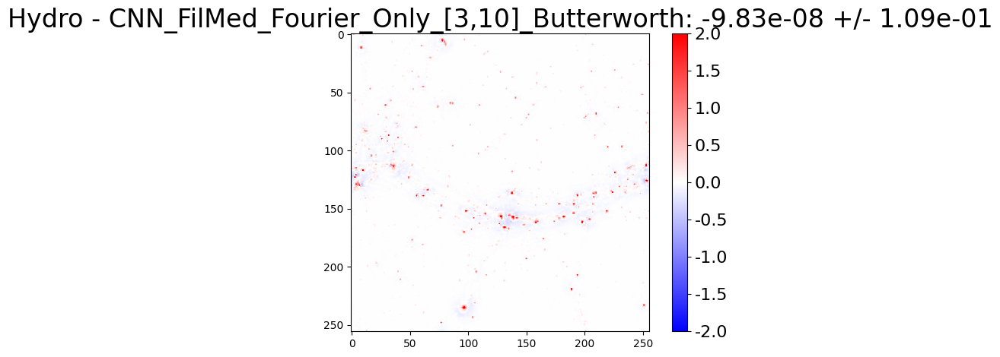

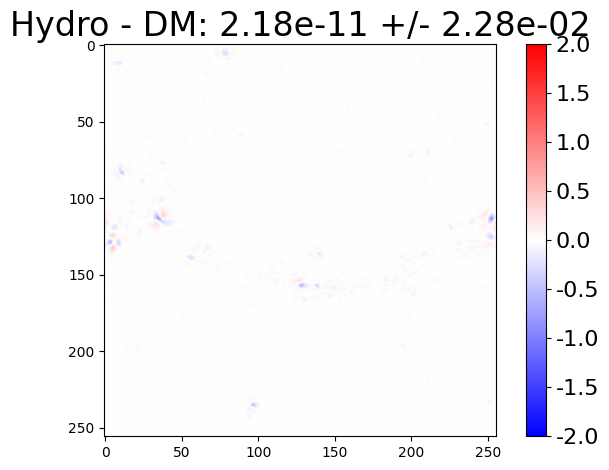


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


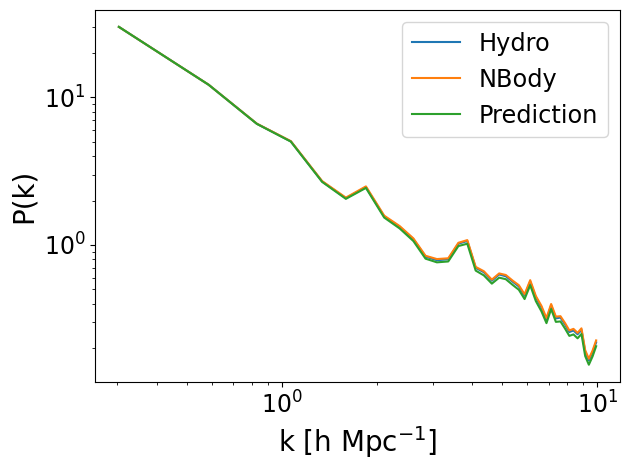

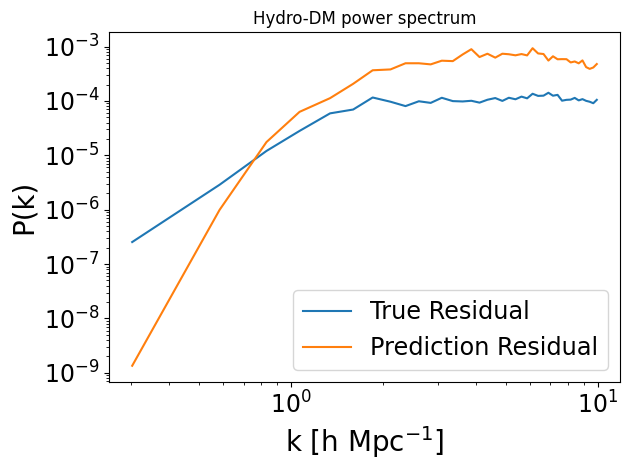

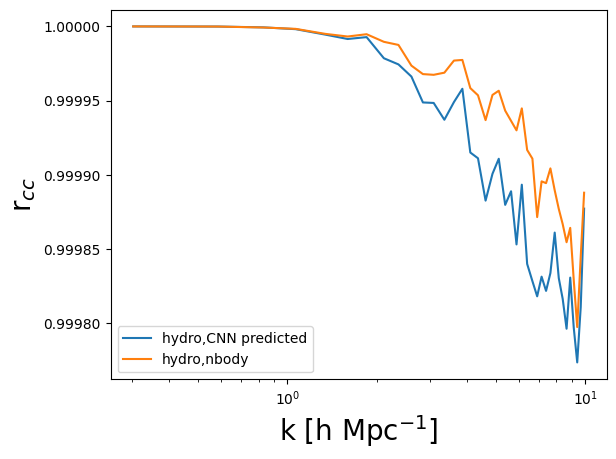

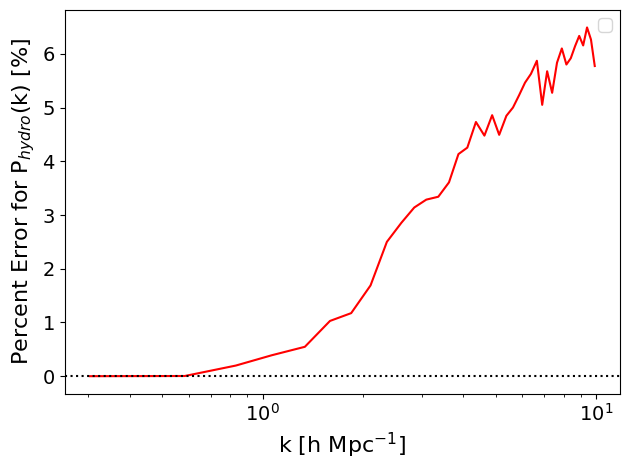

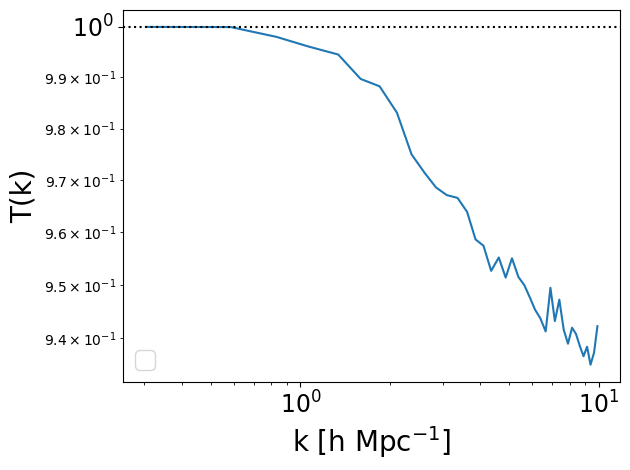

suite: Astrid


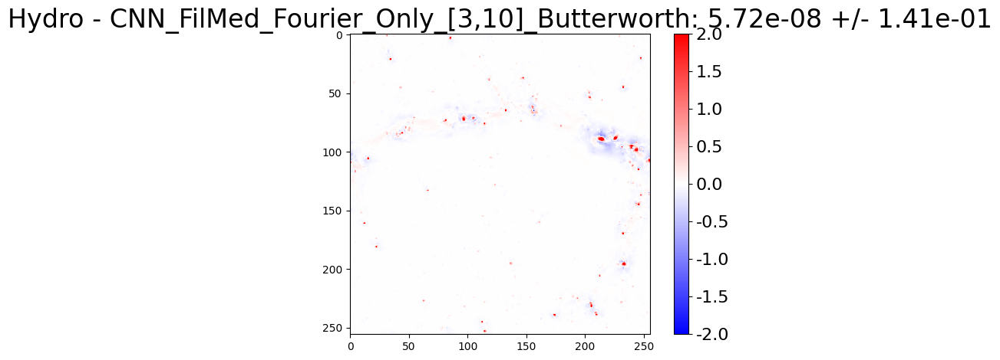

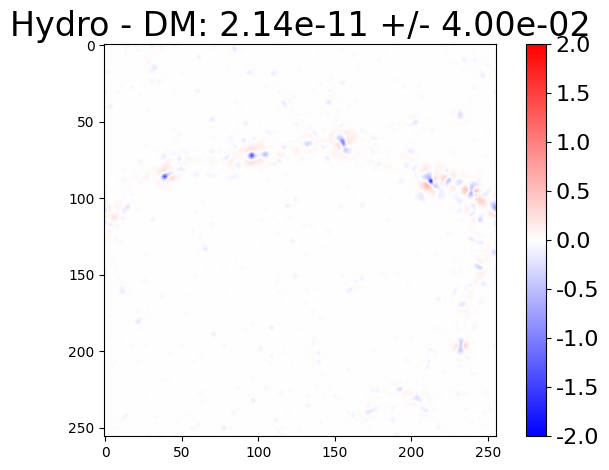


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


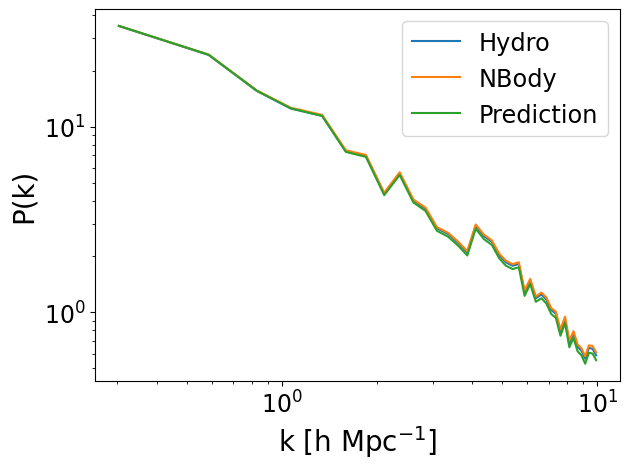

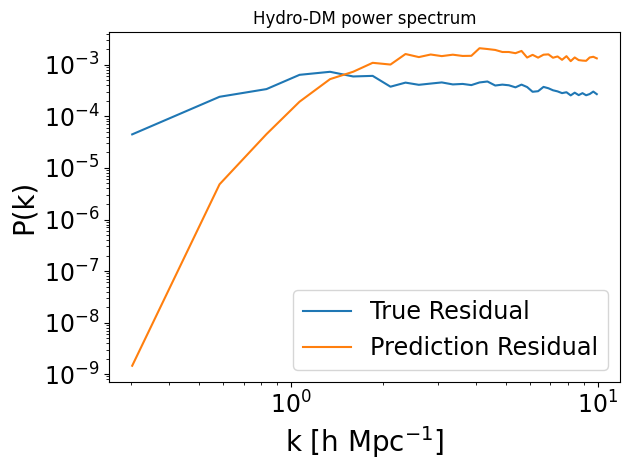

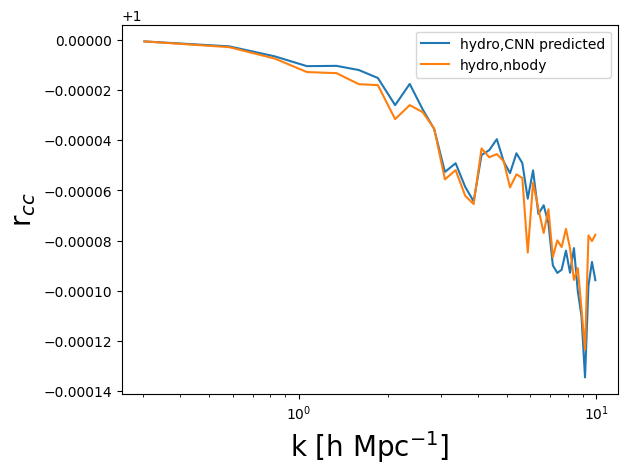

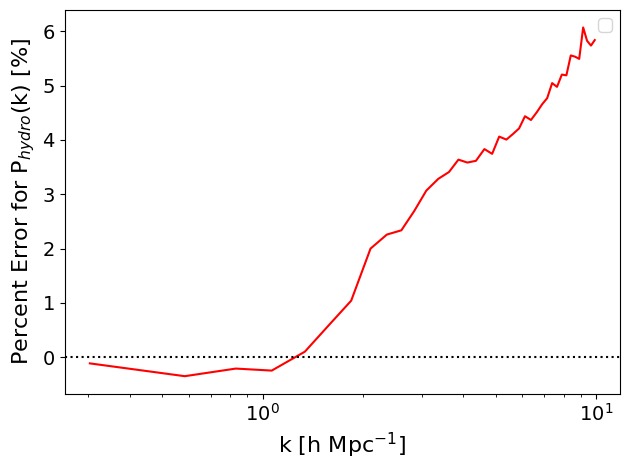

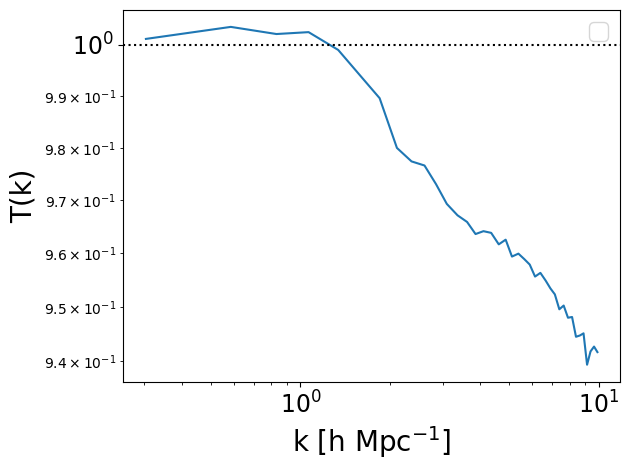

suite: Astrid


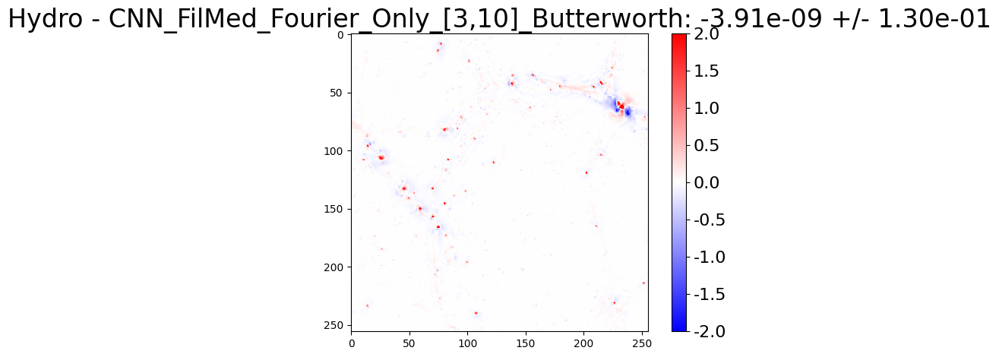

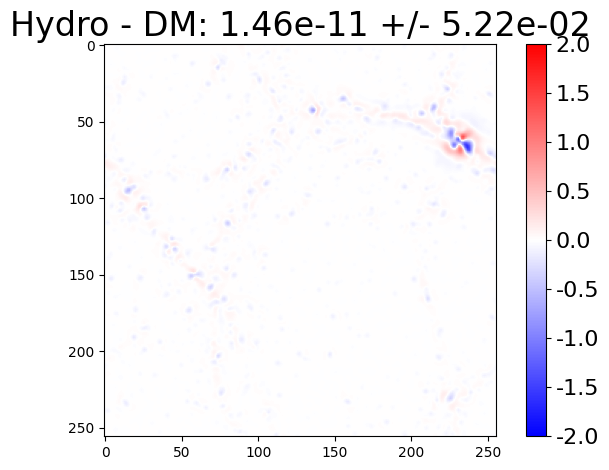


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


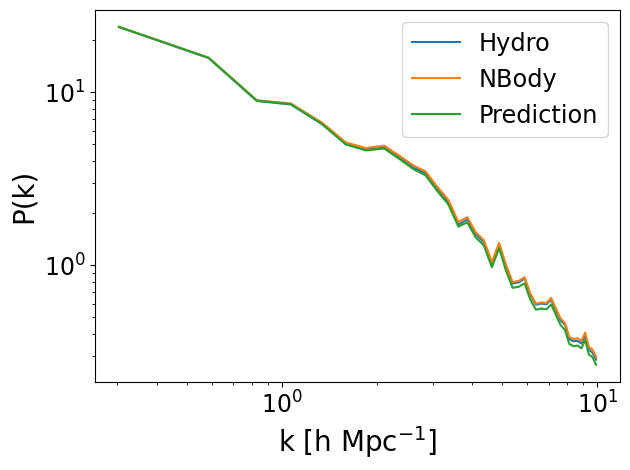

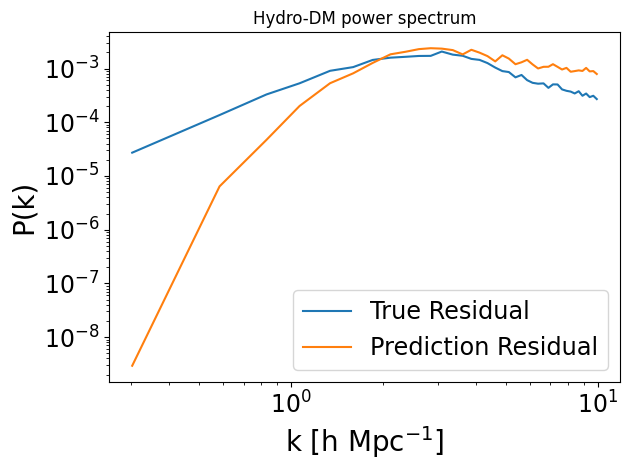

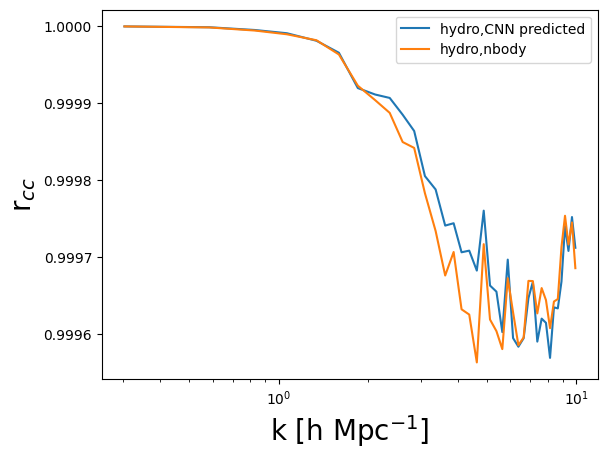

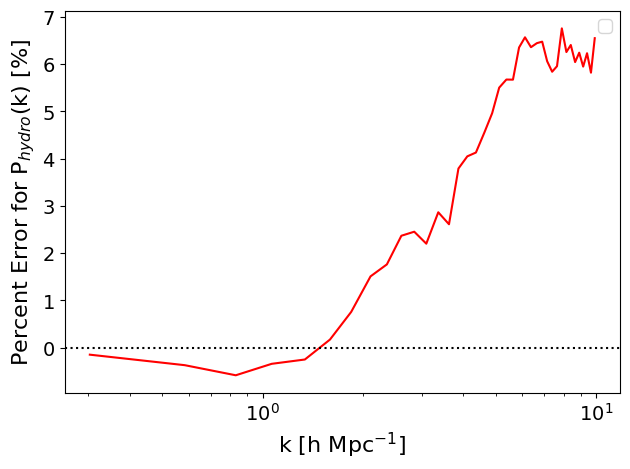

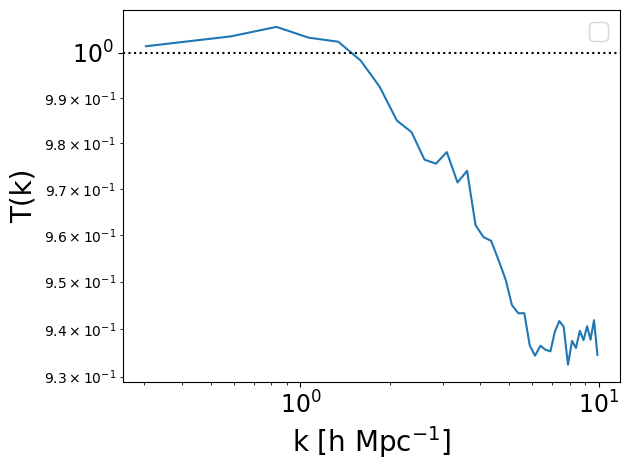

In [9]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_Fourier_Only_[3,10]_Butterworth'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
order = 2 
low_pass = 1 / (1 + (k / 10)**(2 * order))
high_pass = 1 / (1 + (3 / k)**(2 * order))
filter_mask = low_pass*high_pass
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0,10, 50,100]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    filtered_image = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## L1 + epoch 5/10 Fourier [3,10]* **1e-5** lr:1e-3 adamw decay: 1e-5 -> 1e-2  Butterworth window for L_fft
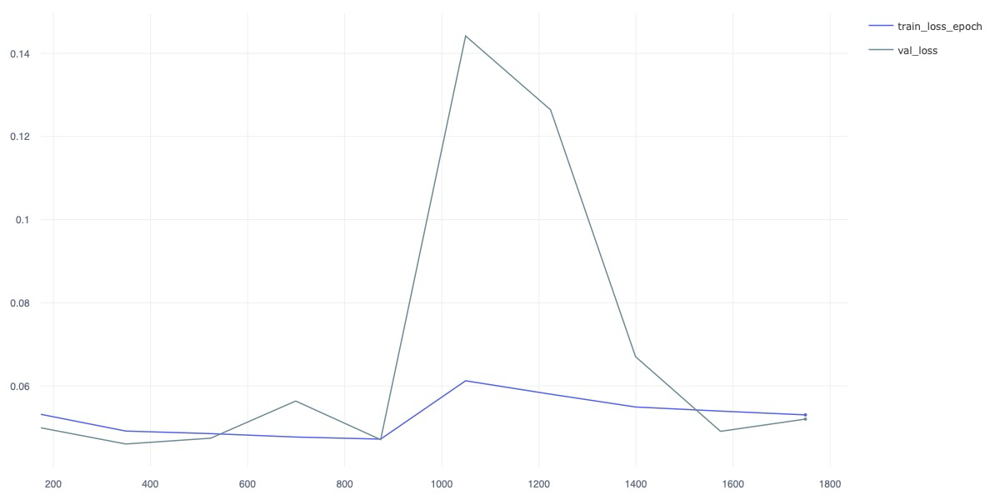

suite: Astrid


/global/homes/l/lindajin/UNet_apply.py:496: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict=torch.load(ckpt, map_location=torch.device("cpu"))["state_dict"]


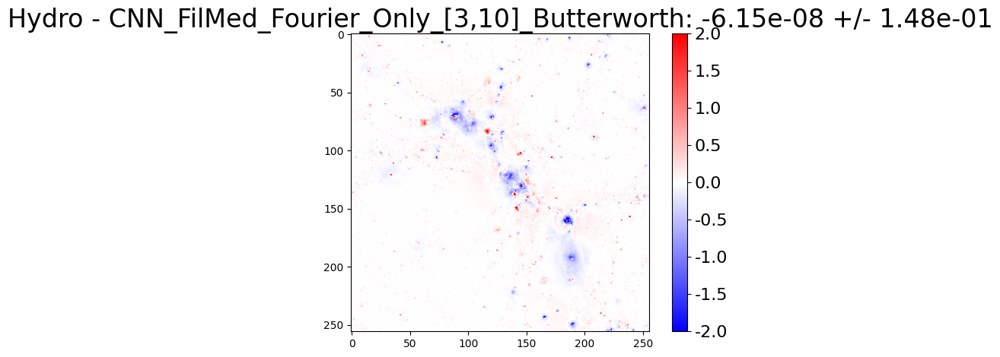

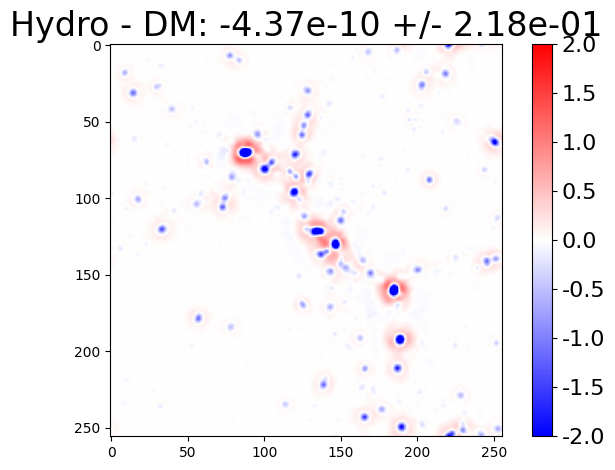


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


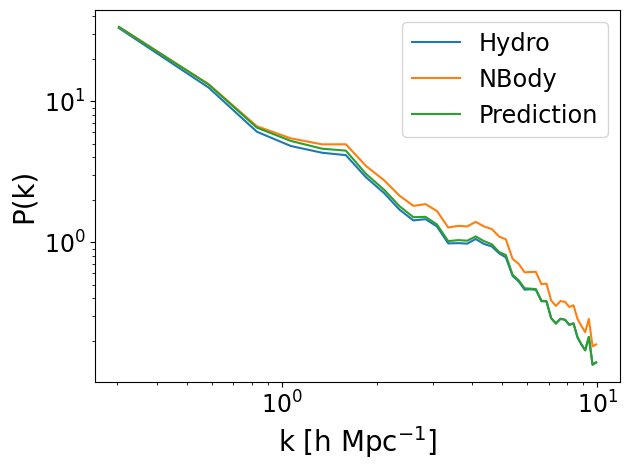

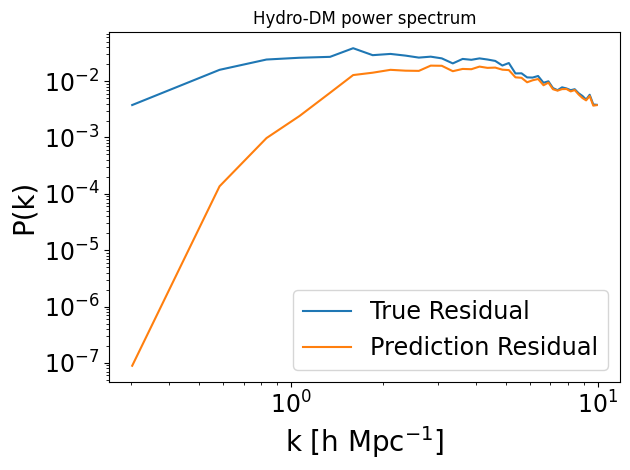

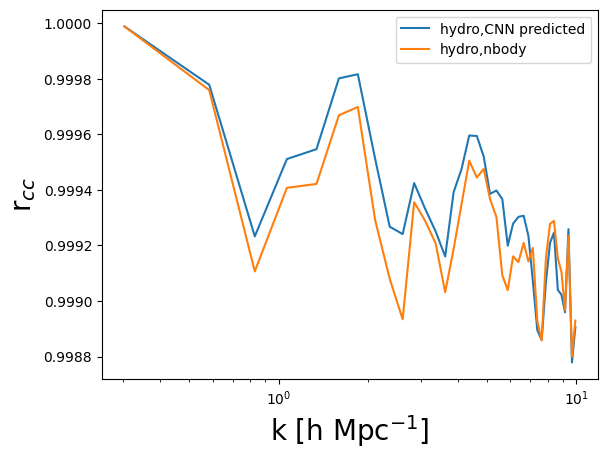

/tmp/ipykernel_1304379/1605644766.py:120: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


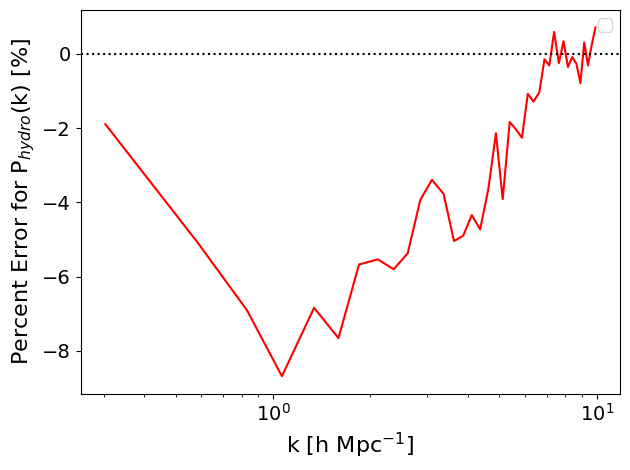

/tmp/ipykernel_1304379/1605644766.py:130: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


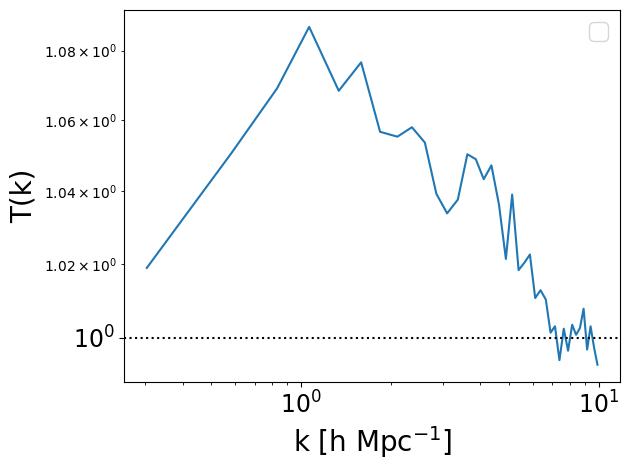

suite: Astrid


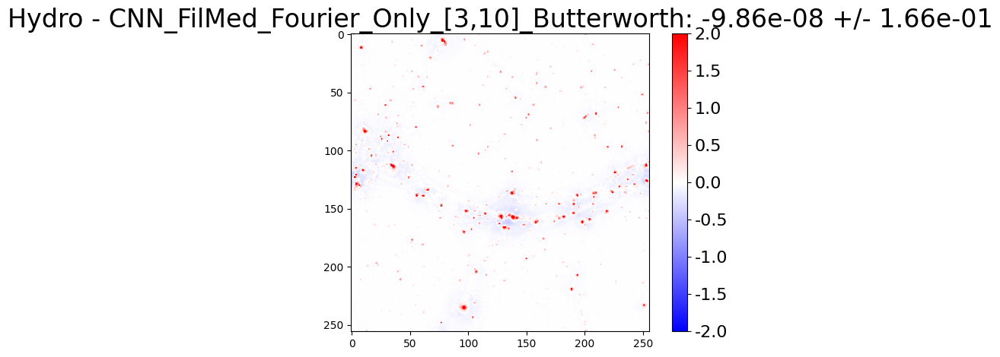

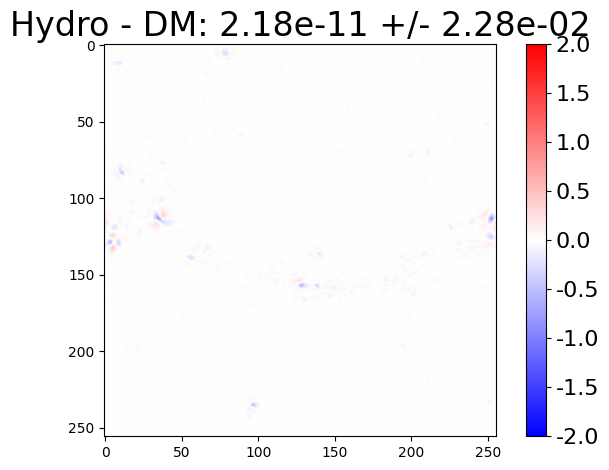


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


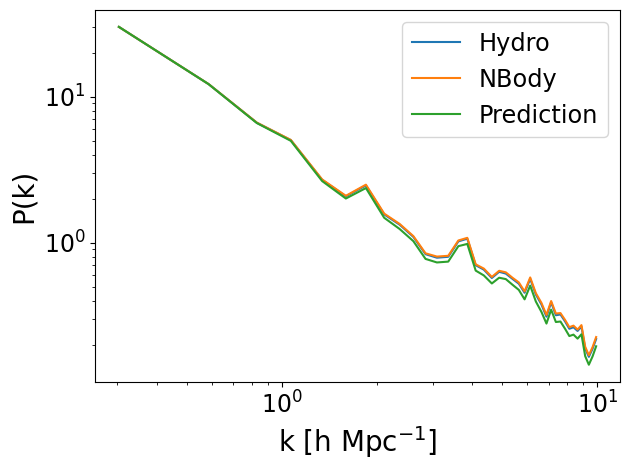

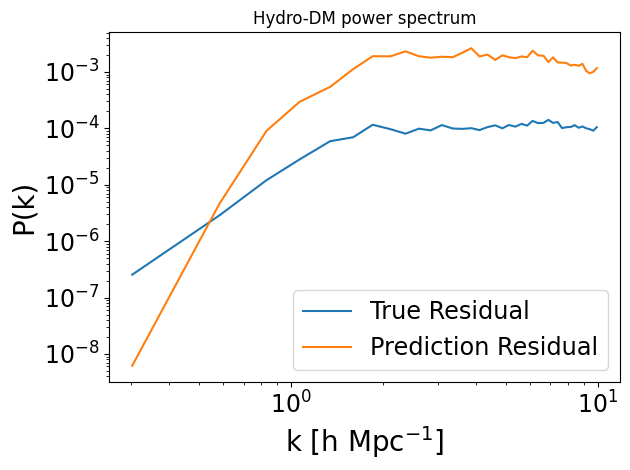

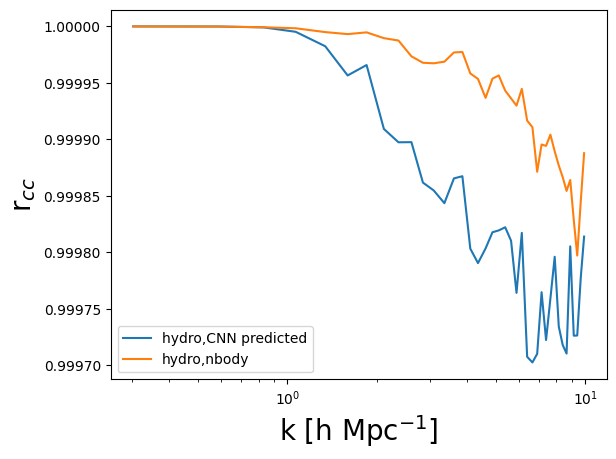

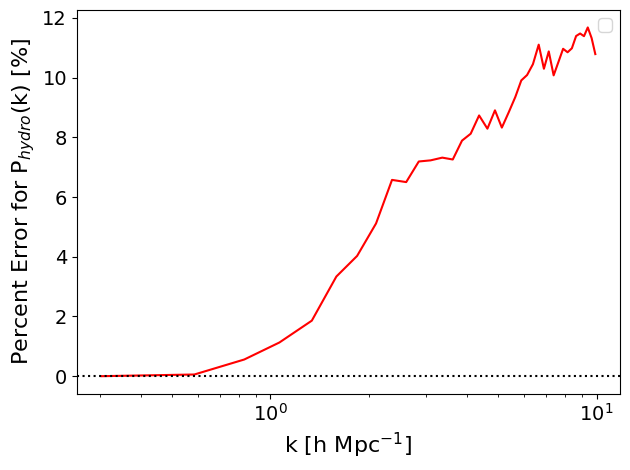

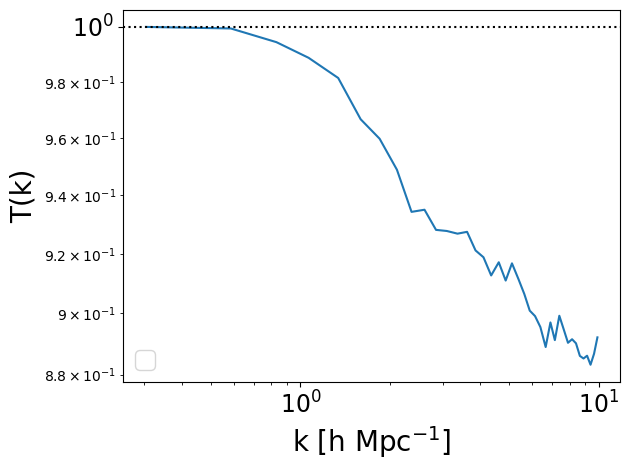

suite: Astrid


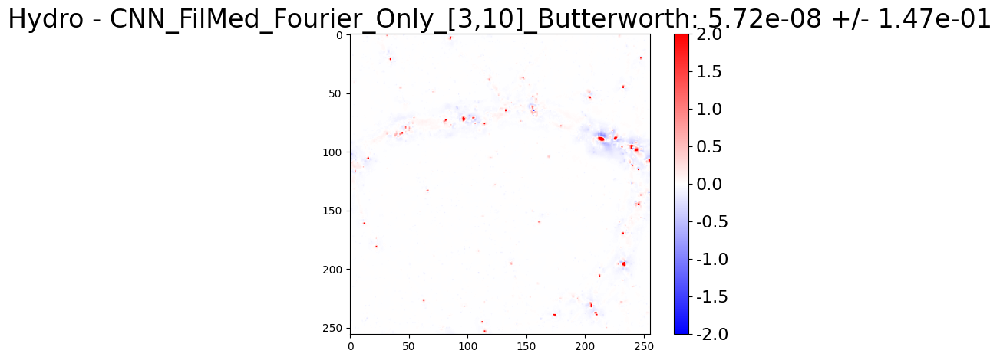

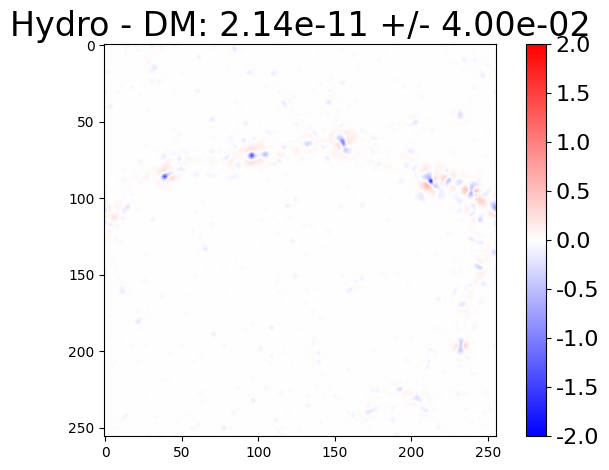


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


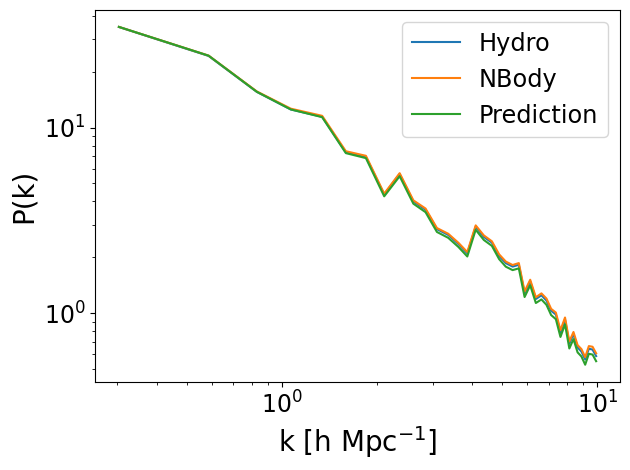

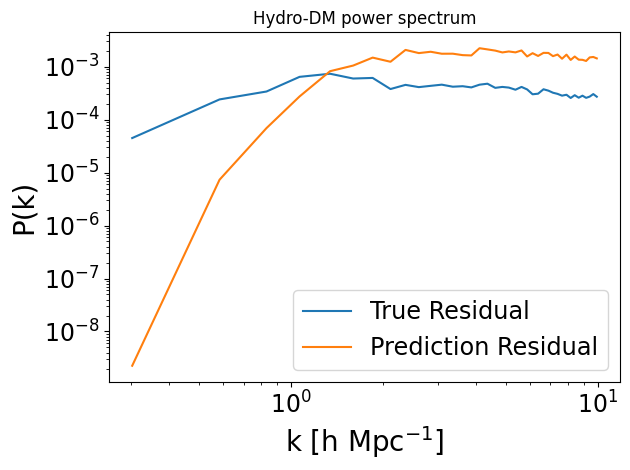

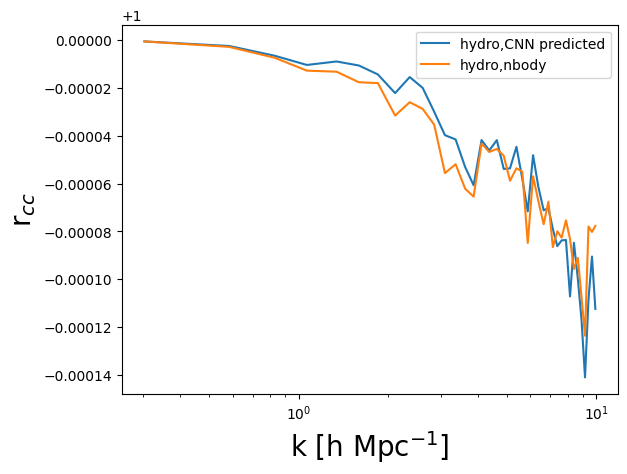

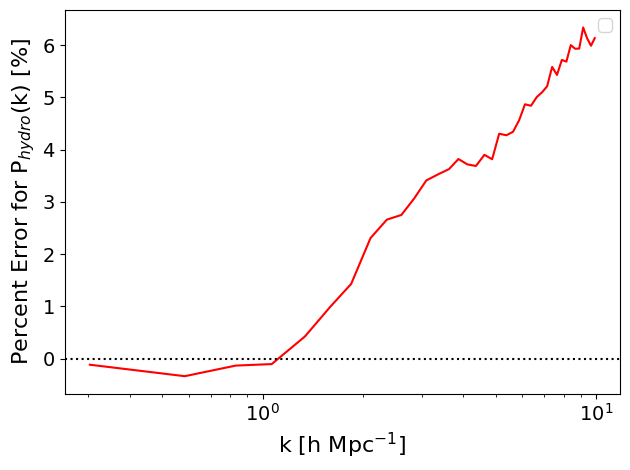

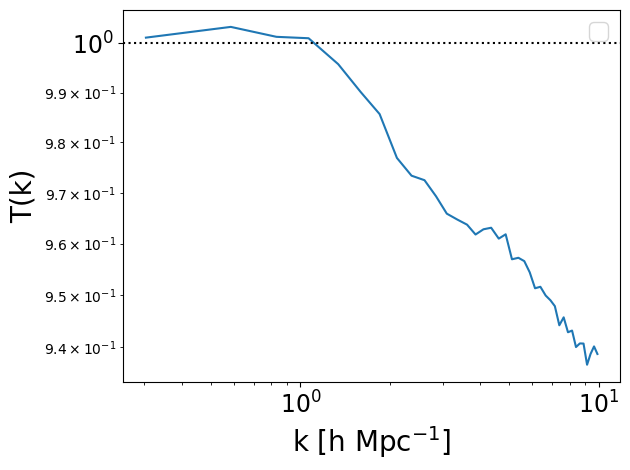

suite: Astrid


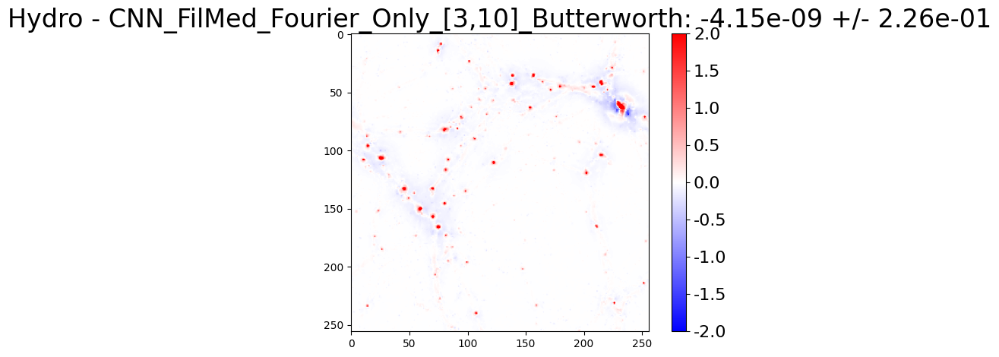

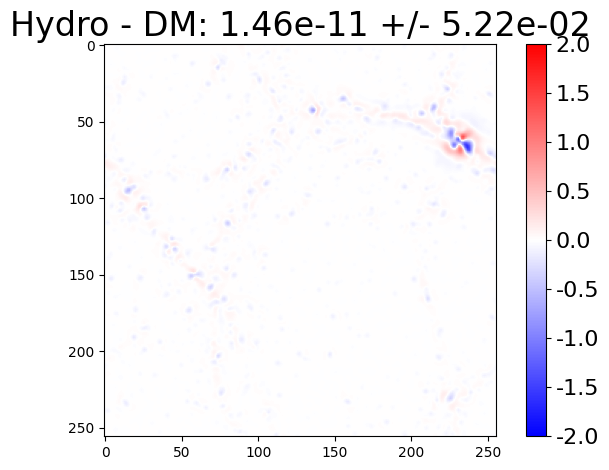


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


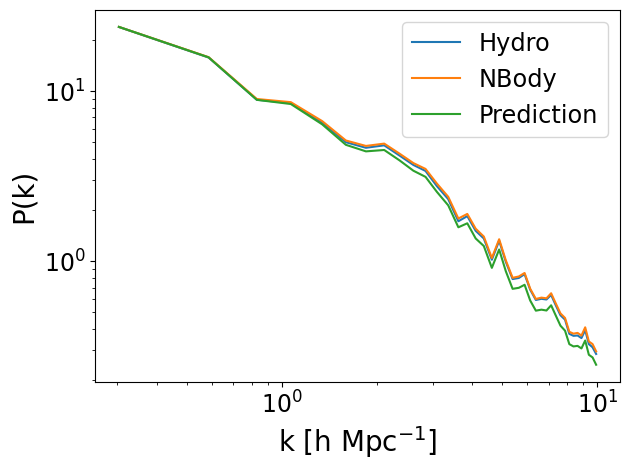

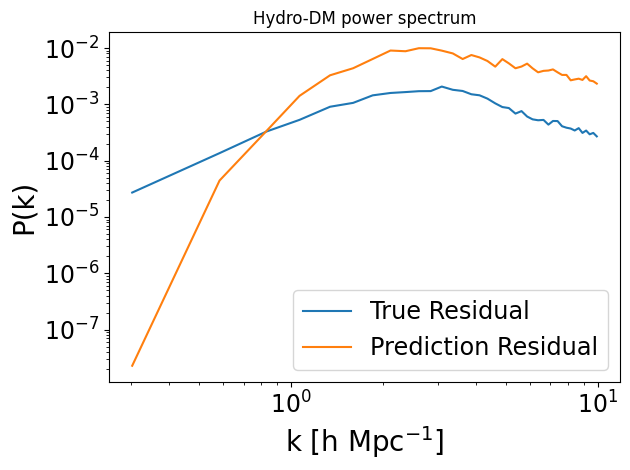

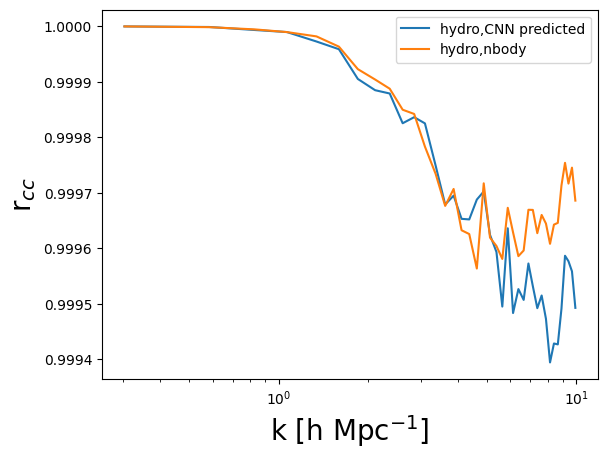

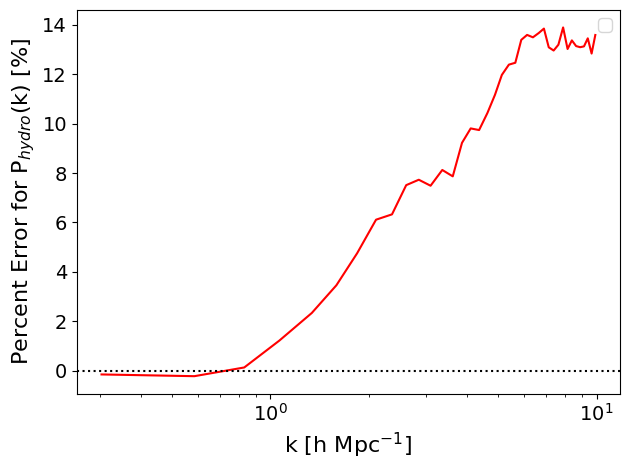

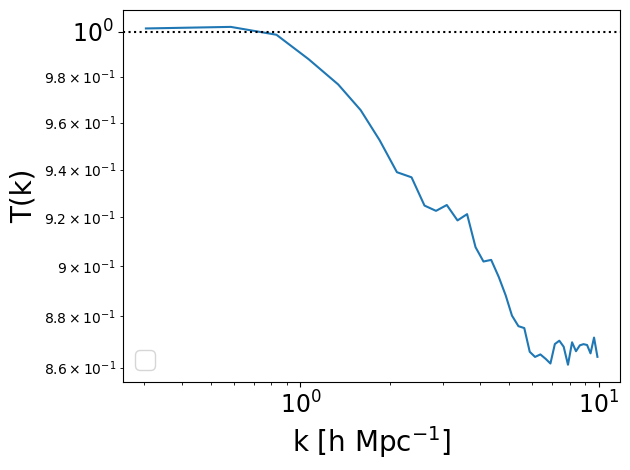

In [11]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_Fourier_Only_[3,10]_Butterworth'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
order = 2 
low_pass = 1 / (1 + (k / 10)**(2 * order))
high_pass = 1 / (1 + (3 / k)**(2 * order))
filter_mask = low_pass*high_pass
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0,10, 50,100]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    filtered_image = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## L1 + epoch **10/15** Fourier **[1,10]** * 1e-5 lr:1e-3 adamw decay: 1e-5 -> 1e-2  Butterworth window for L_fft
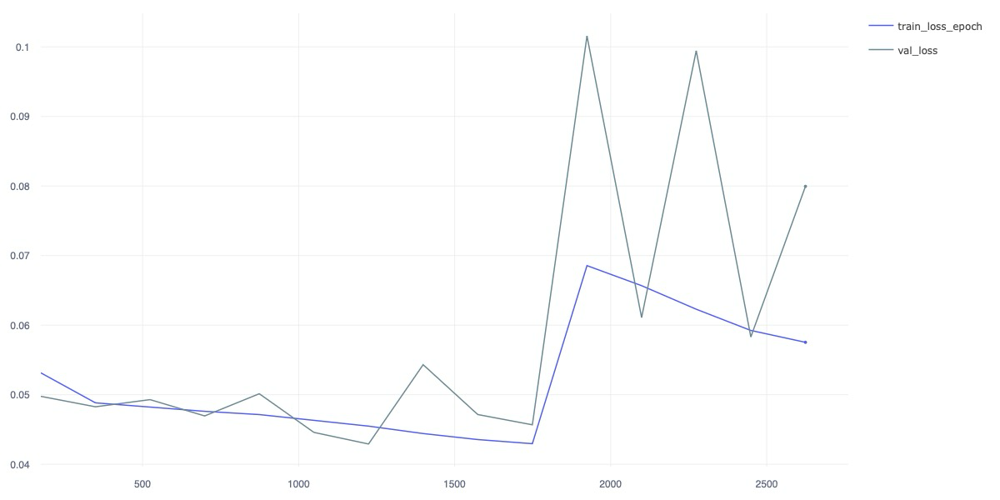

suite: Astrid


/global/homes/l/lindajin/UNet_apply.py:497: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict=torch.load(ckpt, map_location=torch.device("cpu"))["state_dict"]


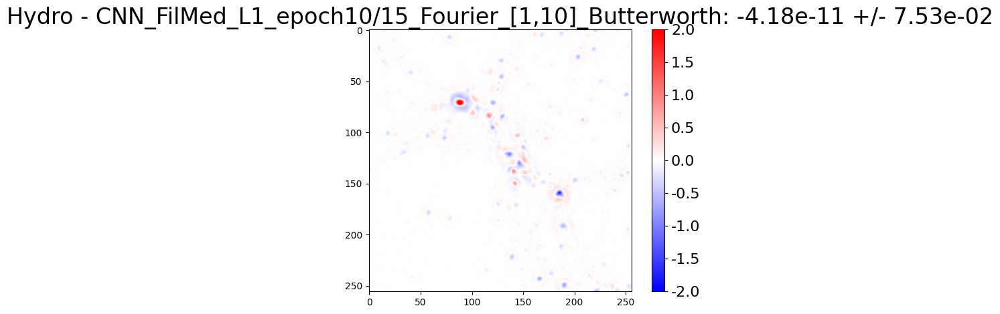

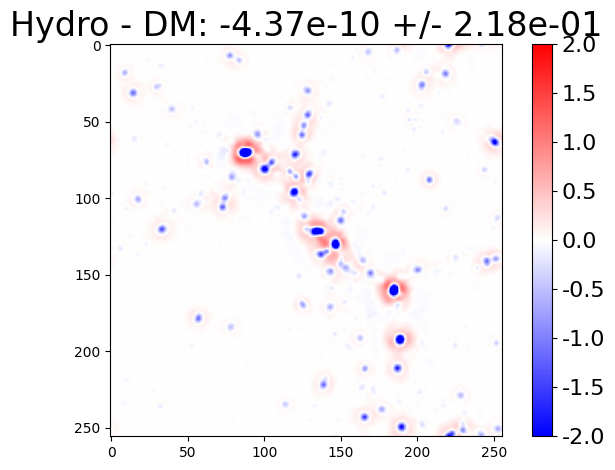


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


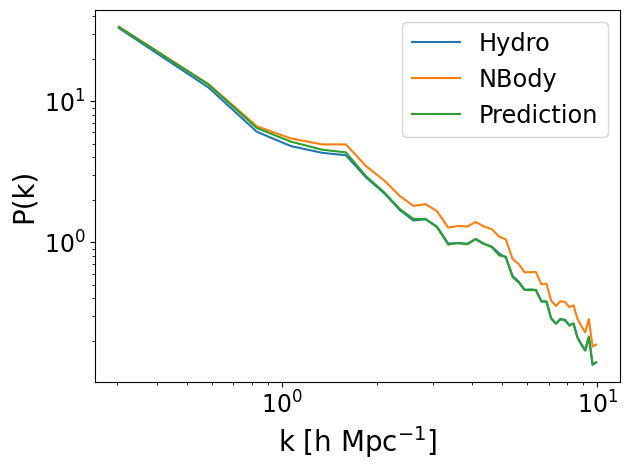

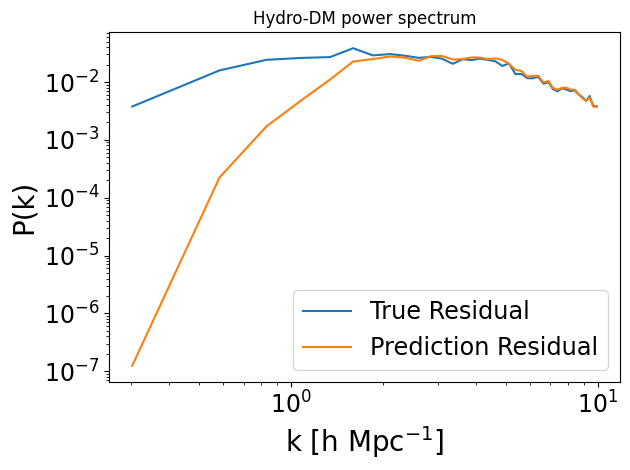

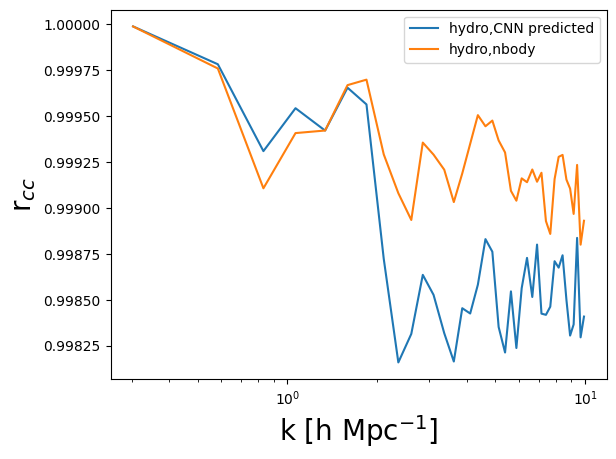

/tmp/ipykernel_1223295/1153060964.py:120: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


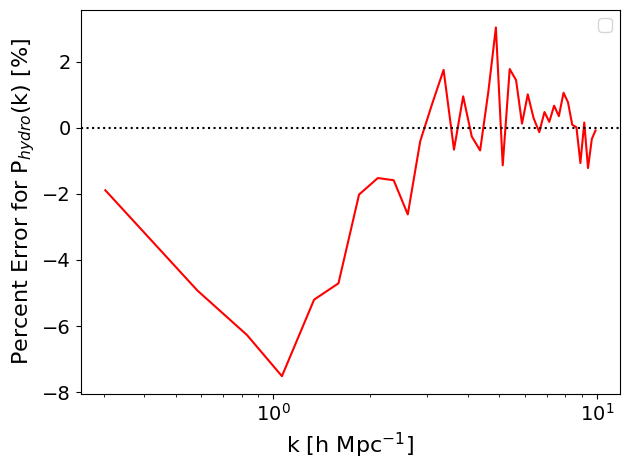

/tmp/ipykernel_1223295/1153060964.py:130: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


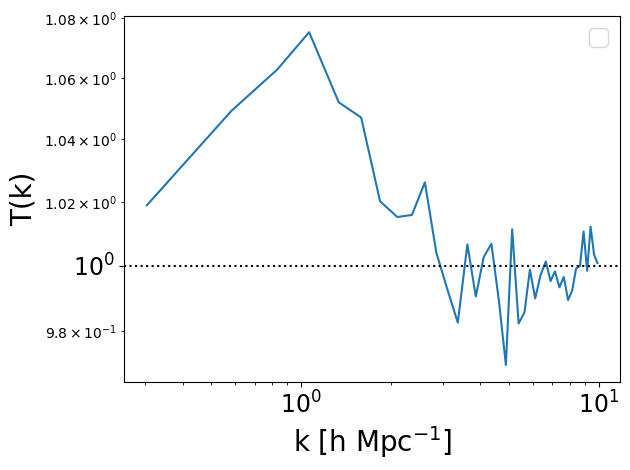

suite: Astrid


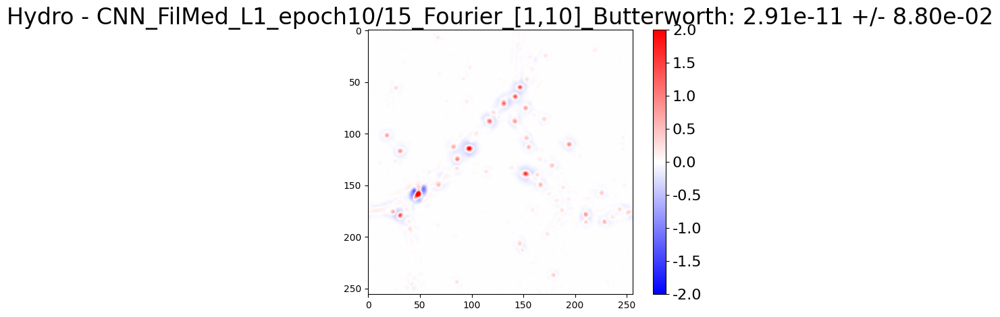

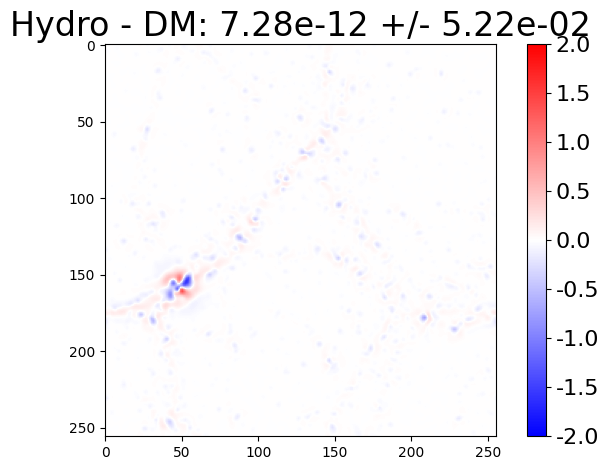


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


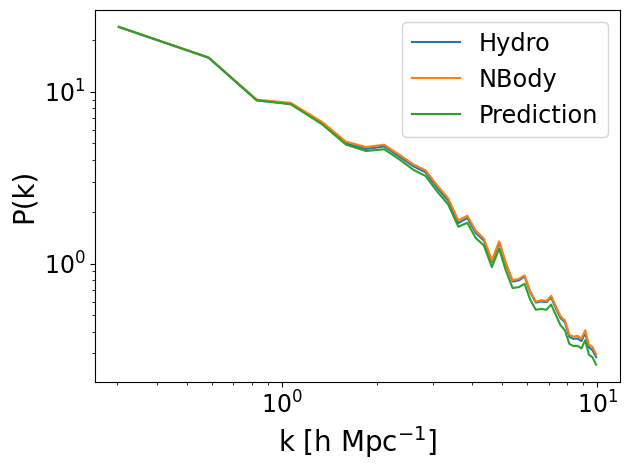

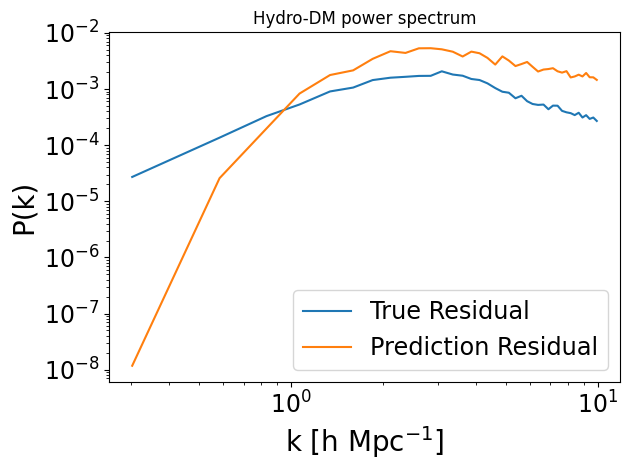

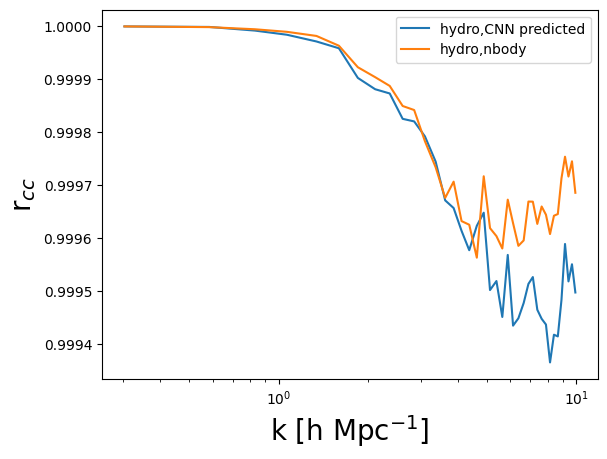

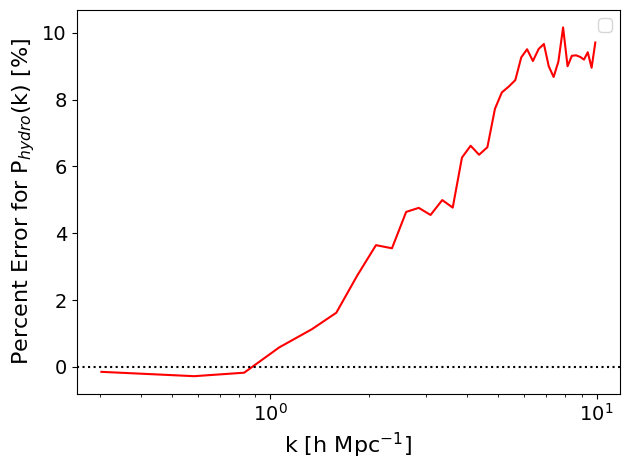

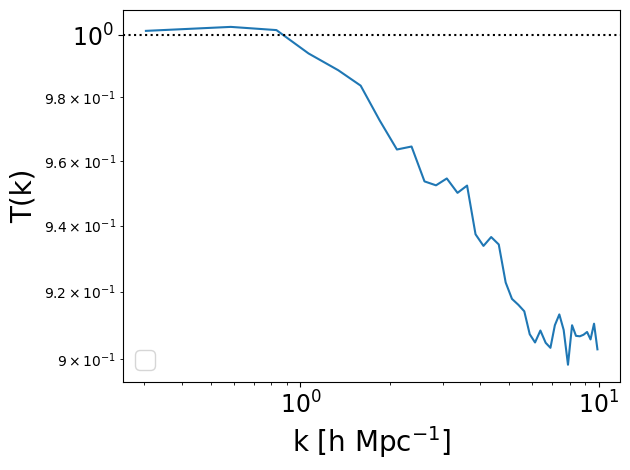

suite: Astrid


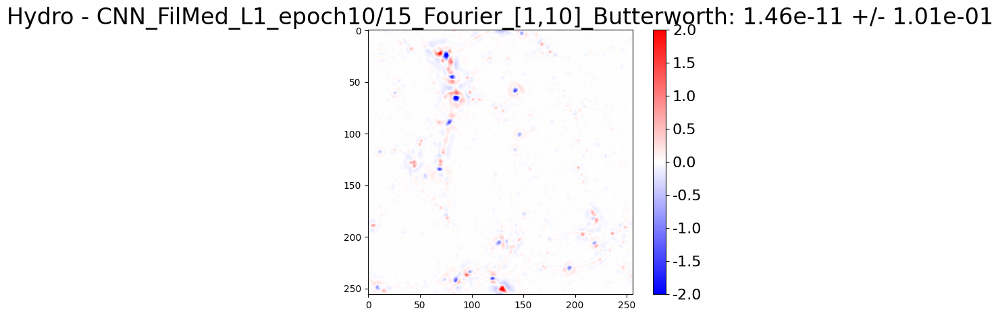

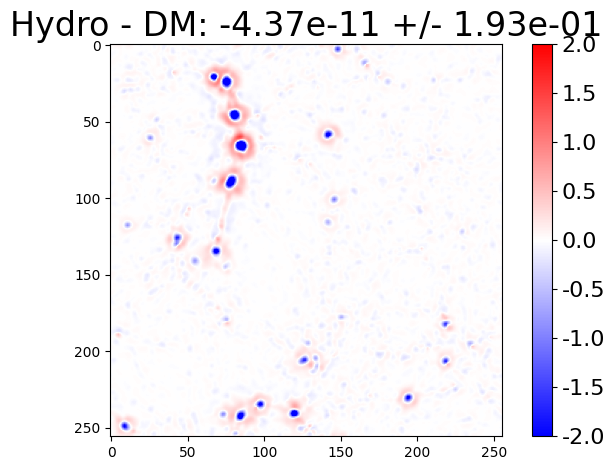


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


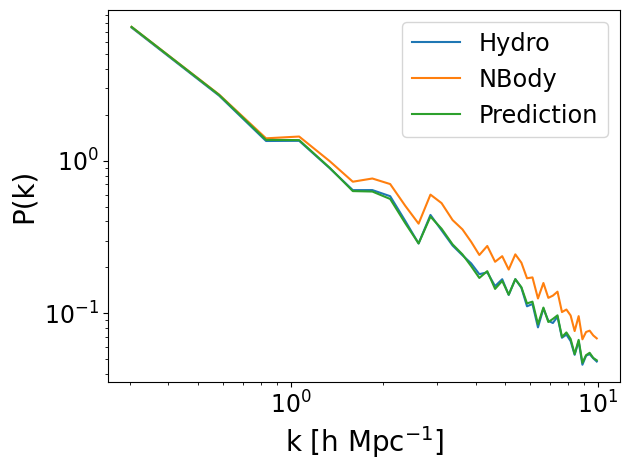

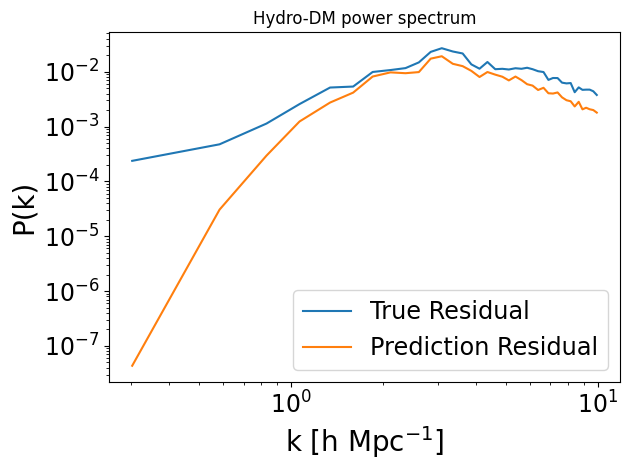

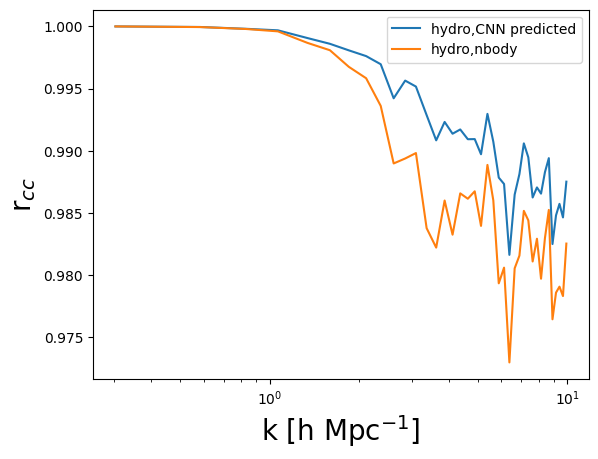

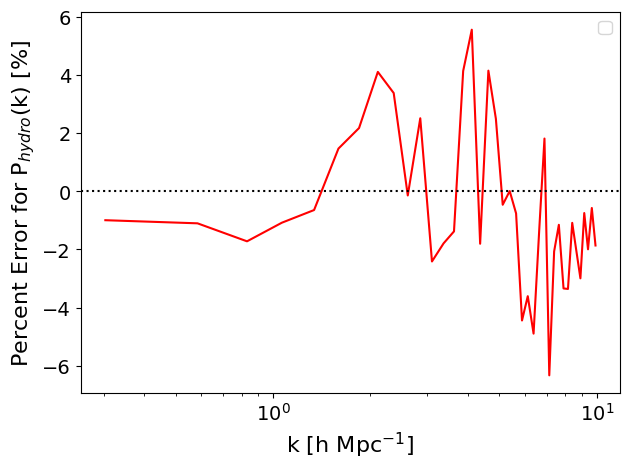

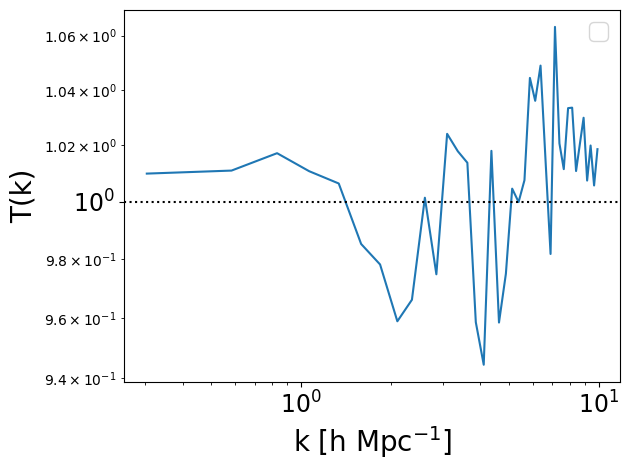

In [16]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_L1_epoch10/15_Fourier_[1,10]_Butterworth'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
order = 2 
low_pass = 1 / (1 + (k / 10)**(2 * order))
high_pass = 1 / (1 + (3 / k)**(2 * order))
filter_mask = low_pass*high_pass
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = [0, 100, 200]
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    diff = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

## L1 + epoch 2/10 Fourier [3,10]* 1e-5 lr:1e-3 adamw decay: 1e-5 -> 1e-2  Butterworth window for L_fft **no high pass**
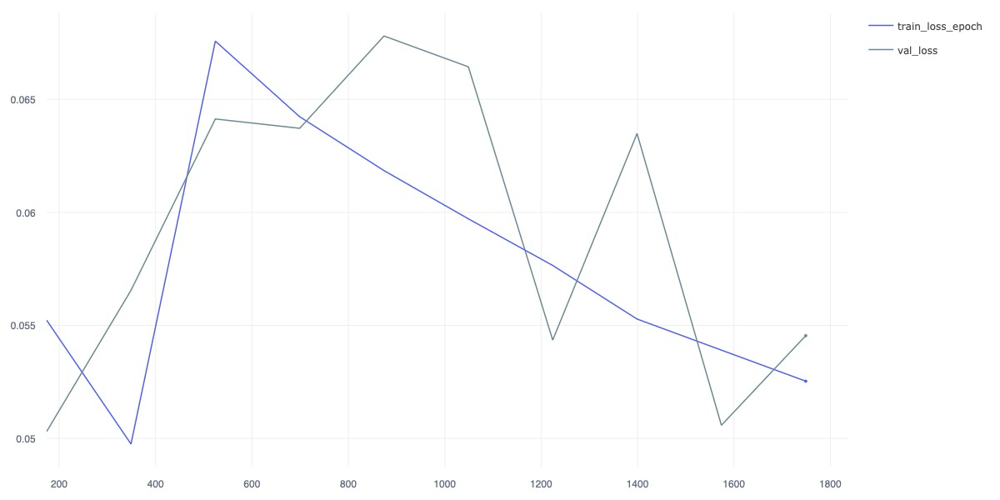

suite: Astrid
no high pass


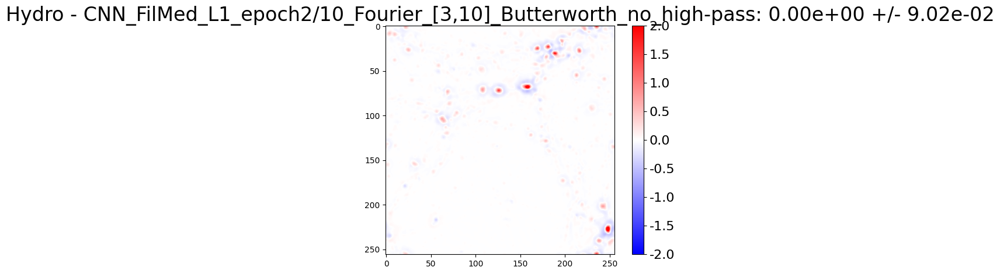

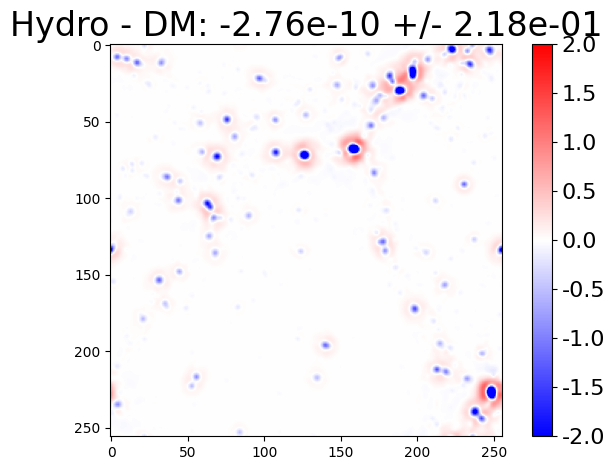

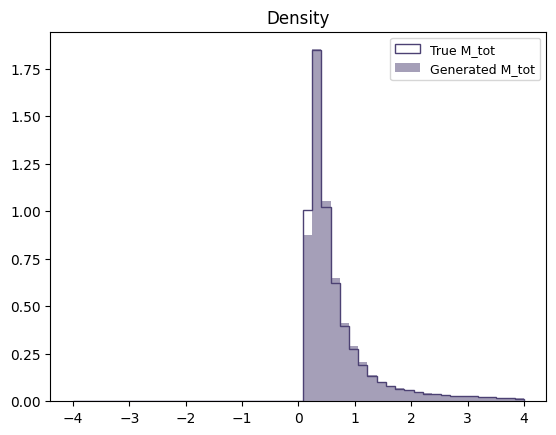


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


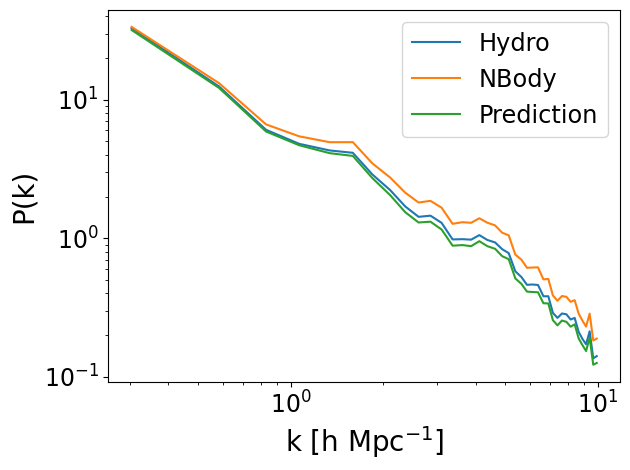

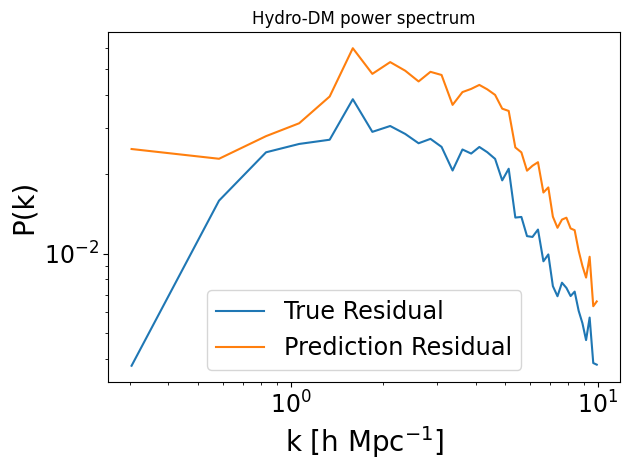

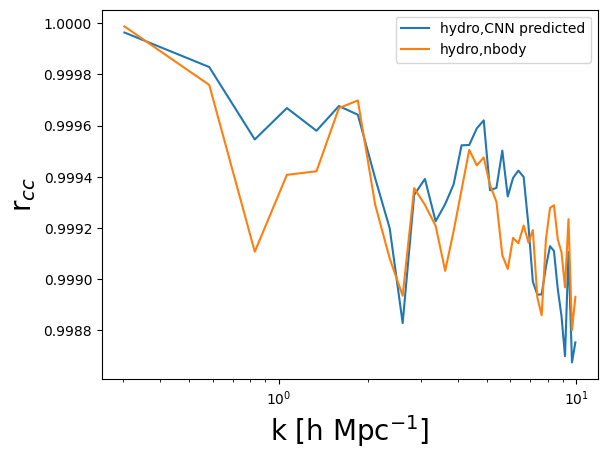

/tmp/ipykernel_54516/2979125856.py:126: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='large')


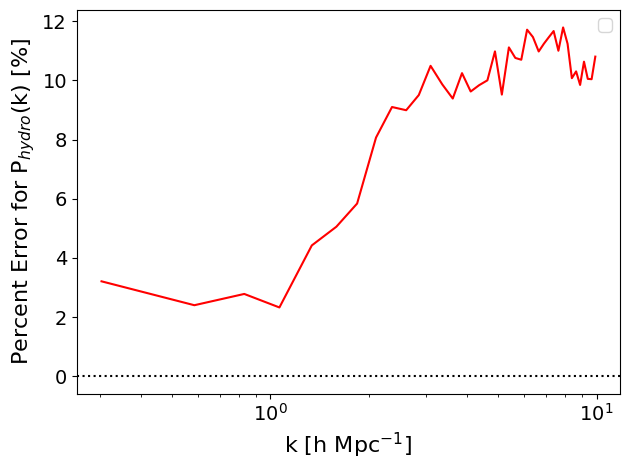

/tmp/ipykernel_54516/2979125856.py:136: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(fontsize='xx-large')


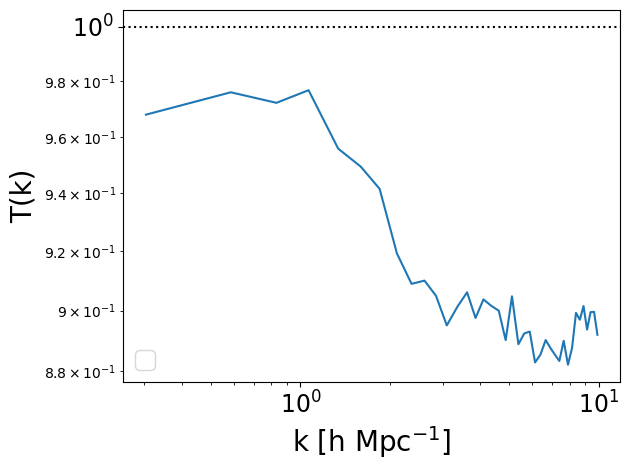

suite: Astrid
no high pass


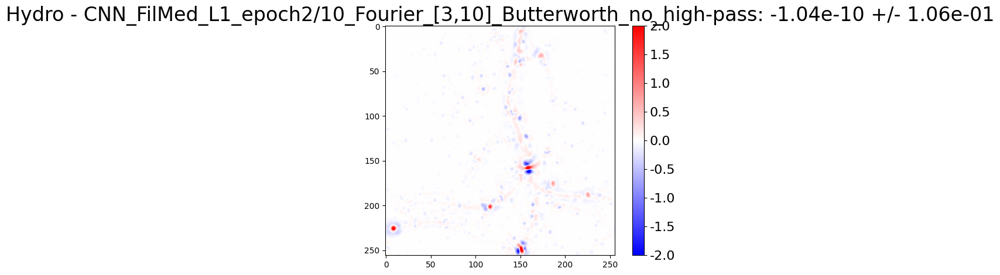

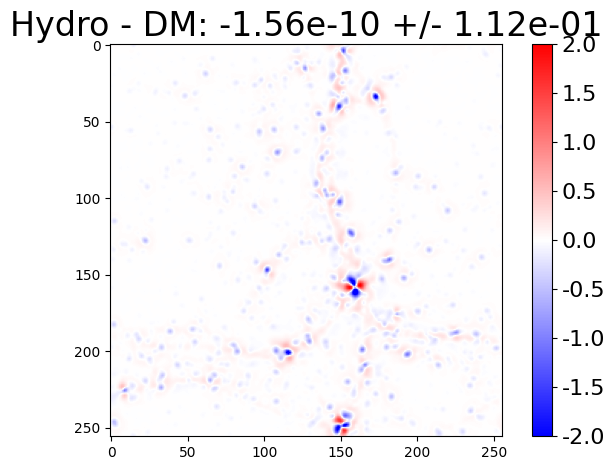

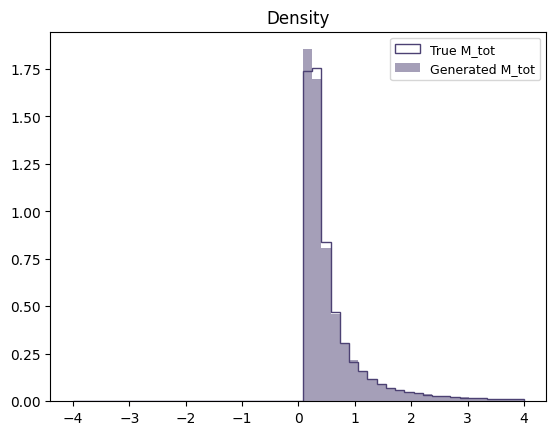


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


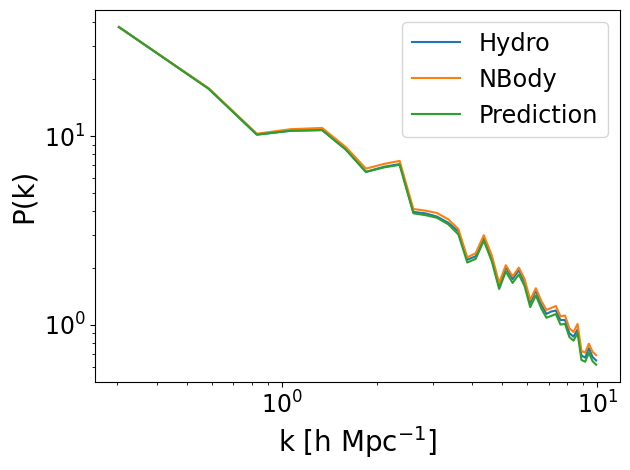

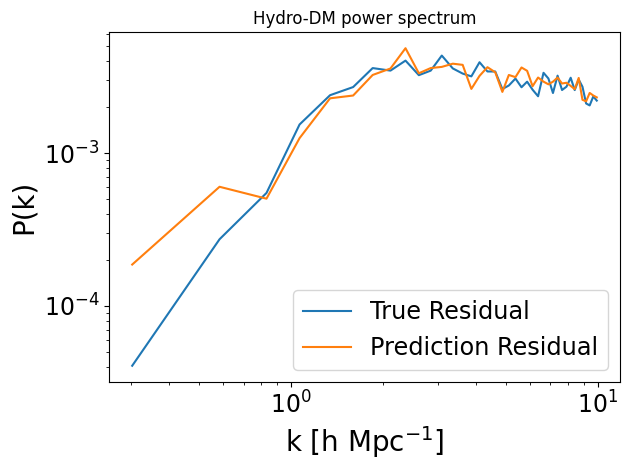

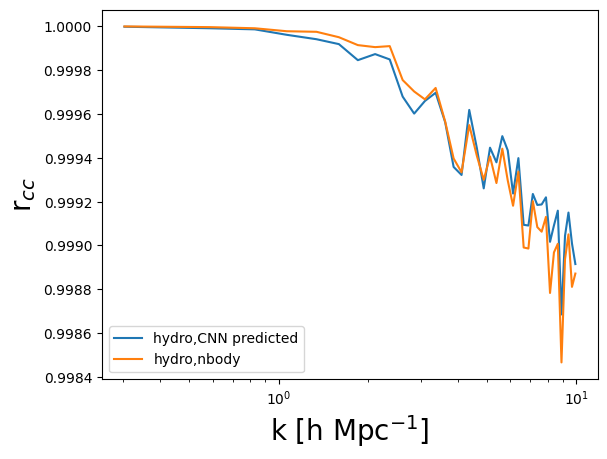

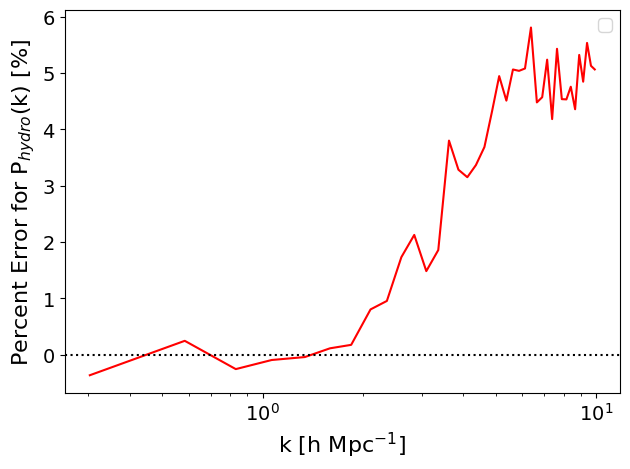

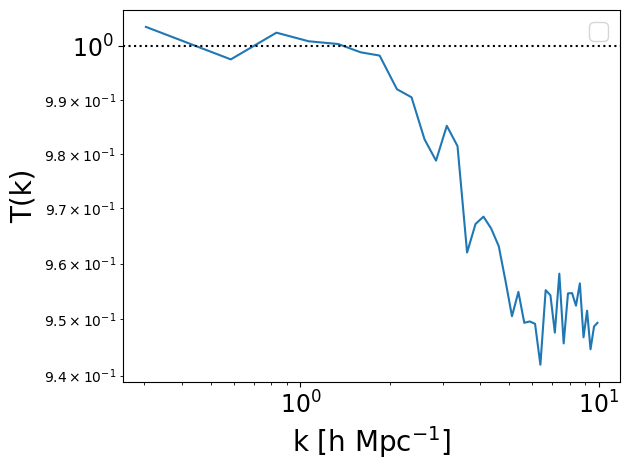

suite: Astrid
no high pass


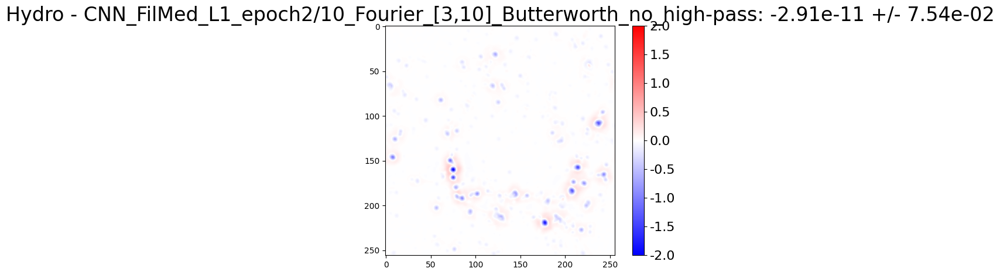

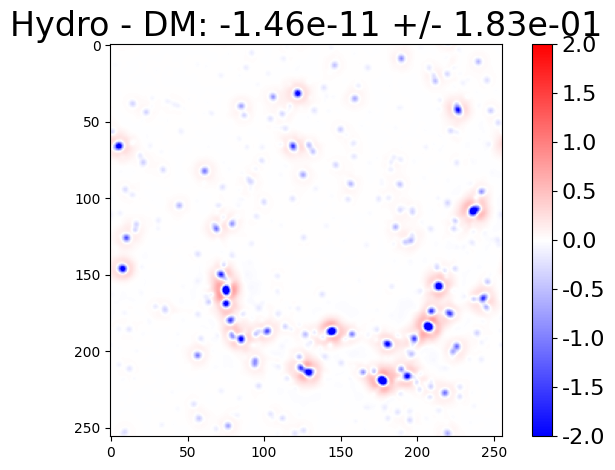

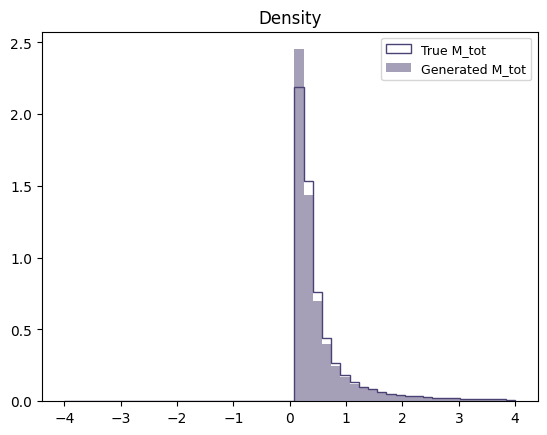


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.00
Time taken = 0.01 seconds


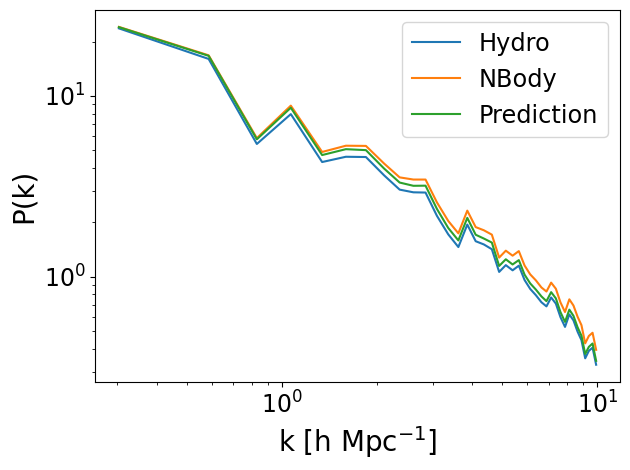

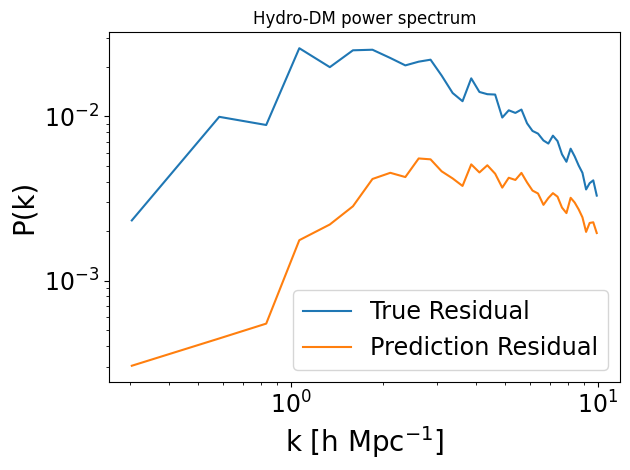

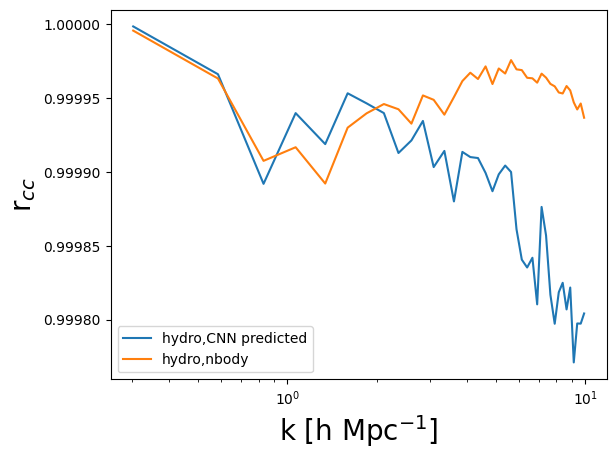

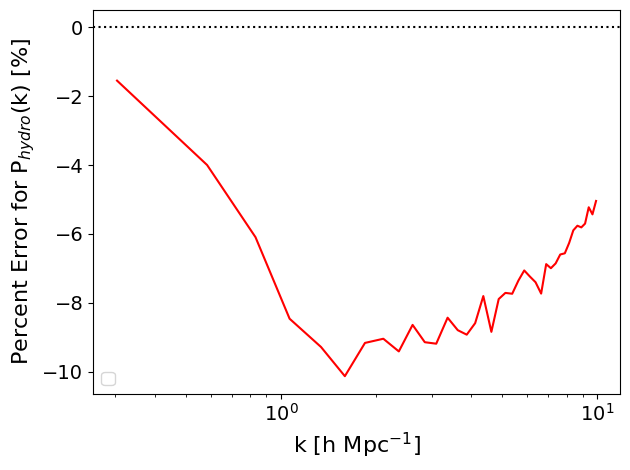

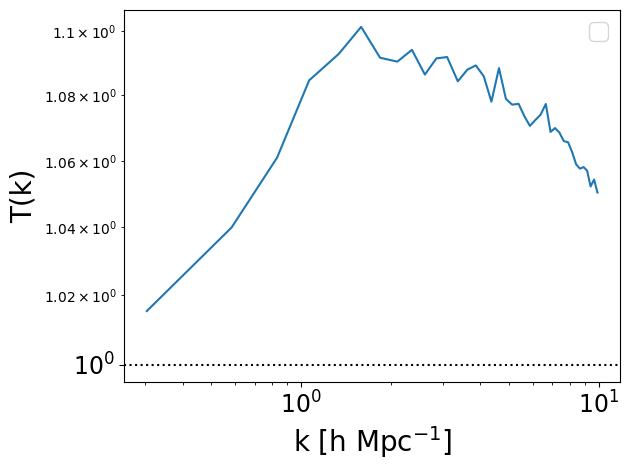

suite: Astrid
no high pass


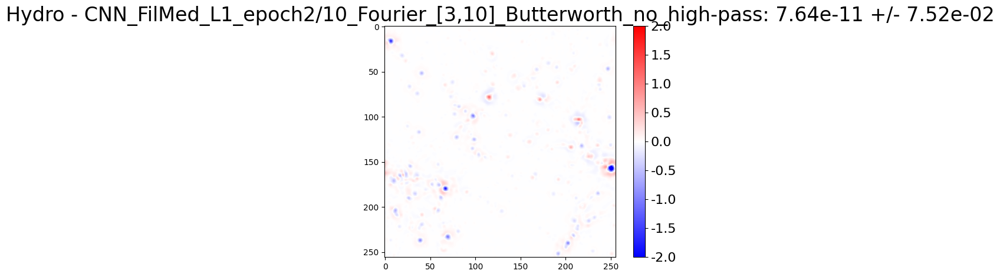

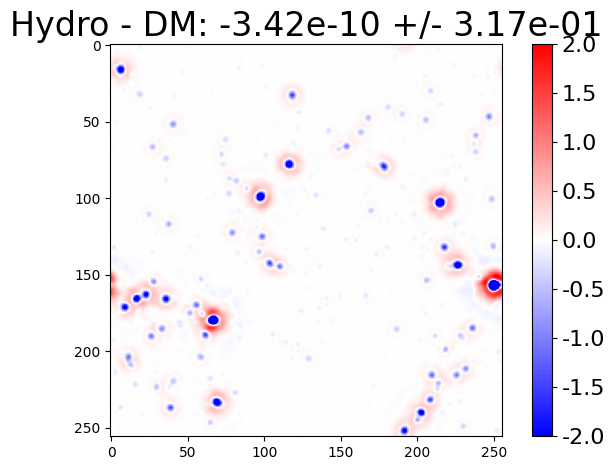

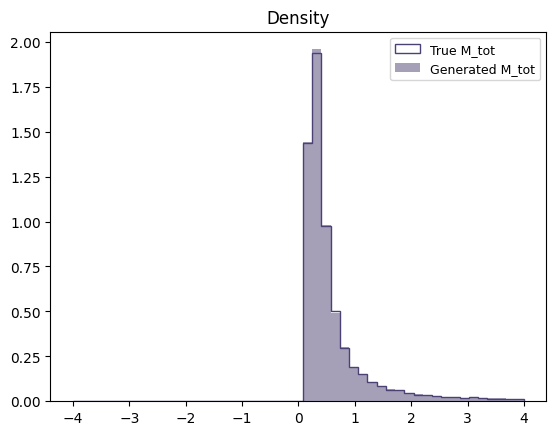


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


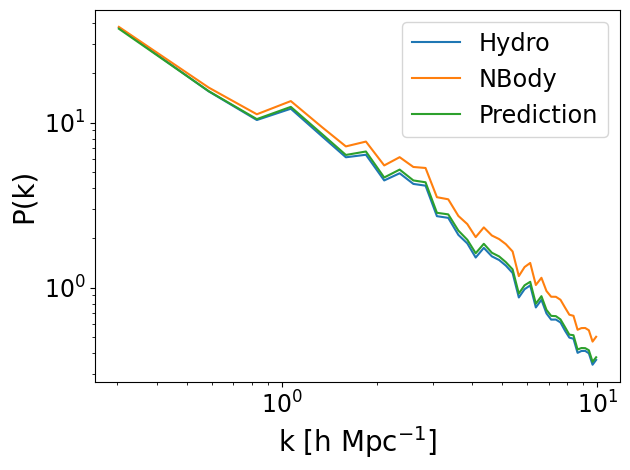

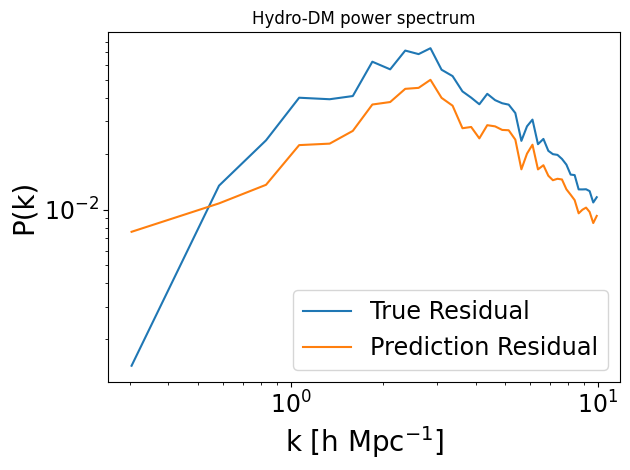

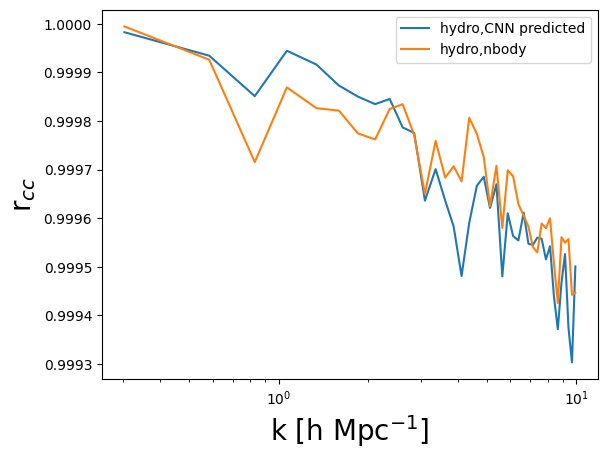

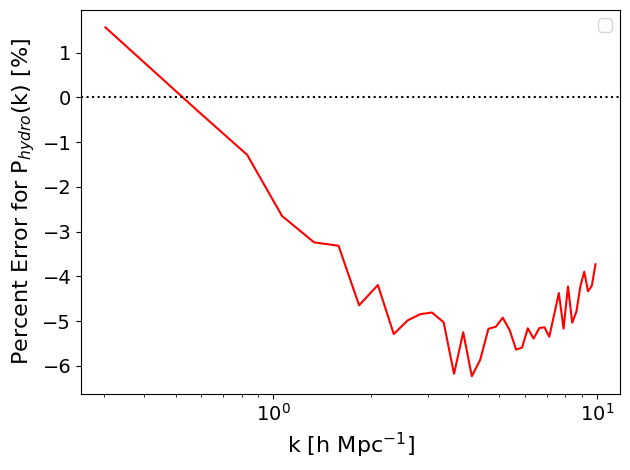

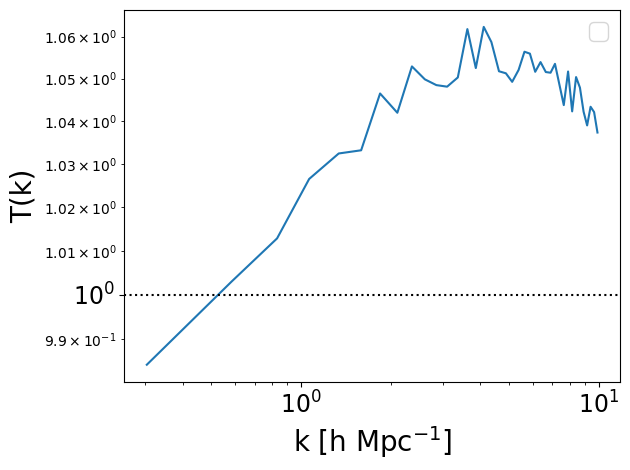

suite: Astrid
no high pass


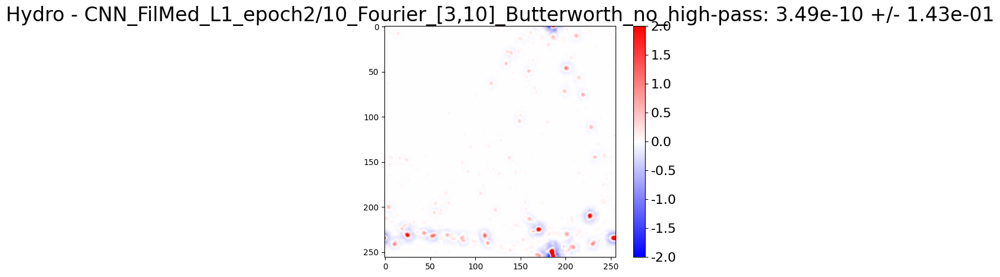

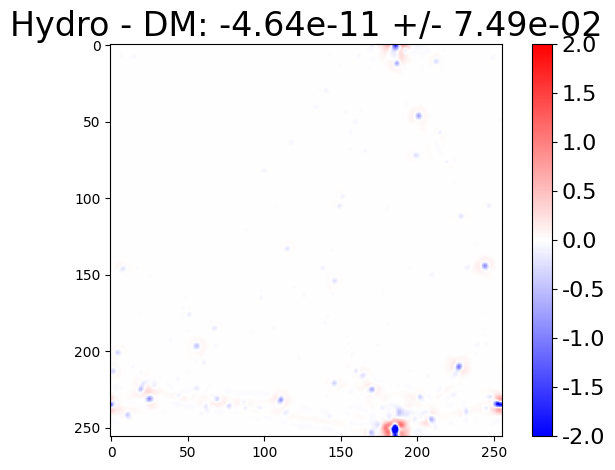

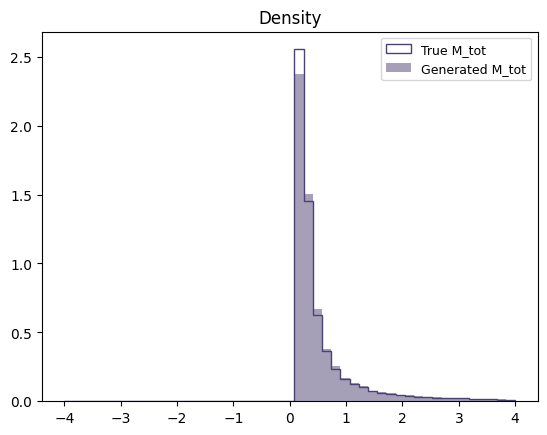


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


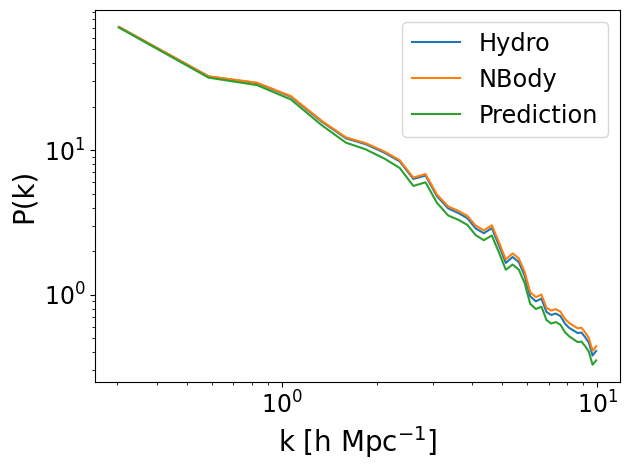

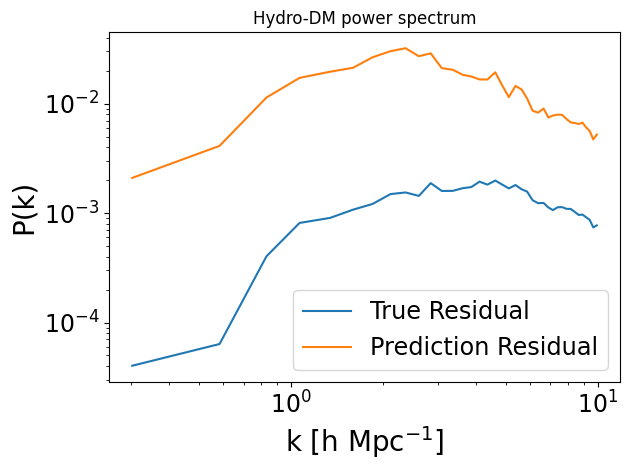

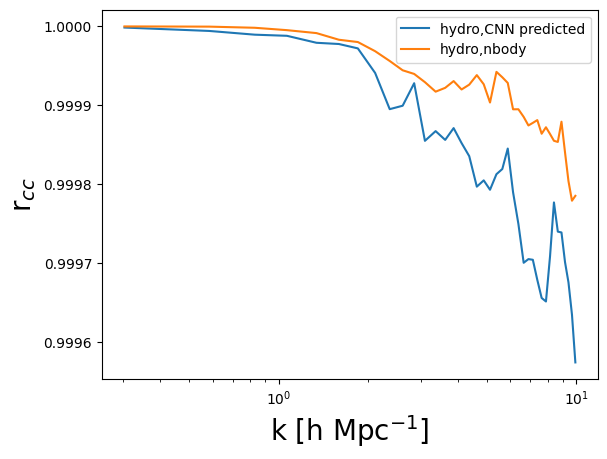

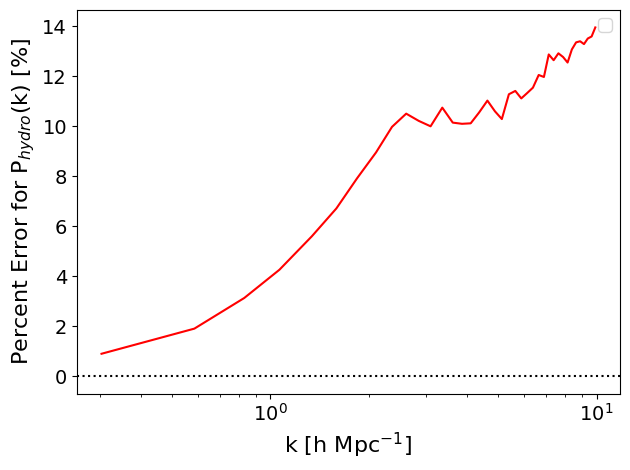

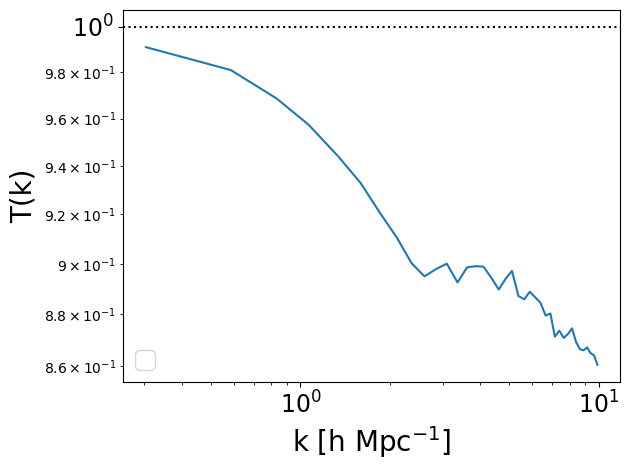

suite: Astrid
no high pass


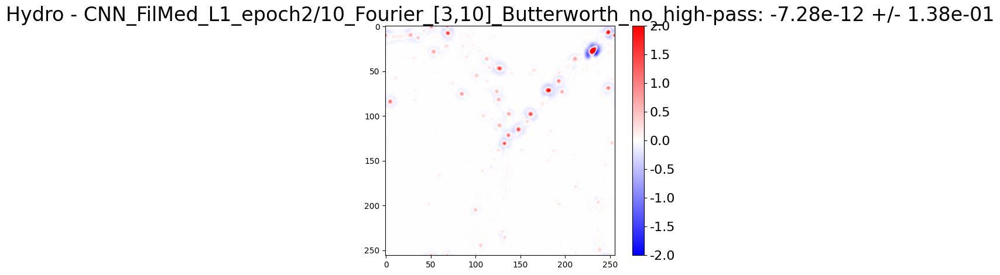

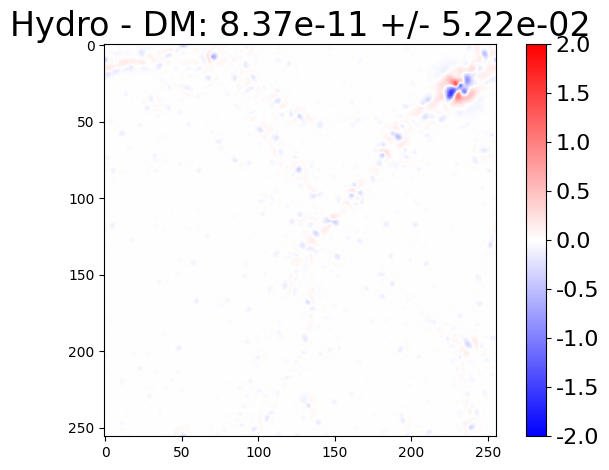

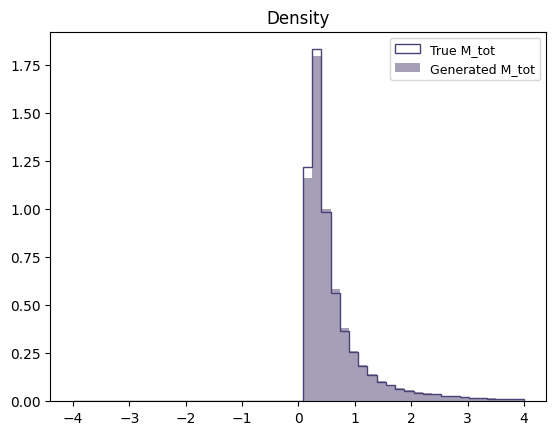


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


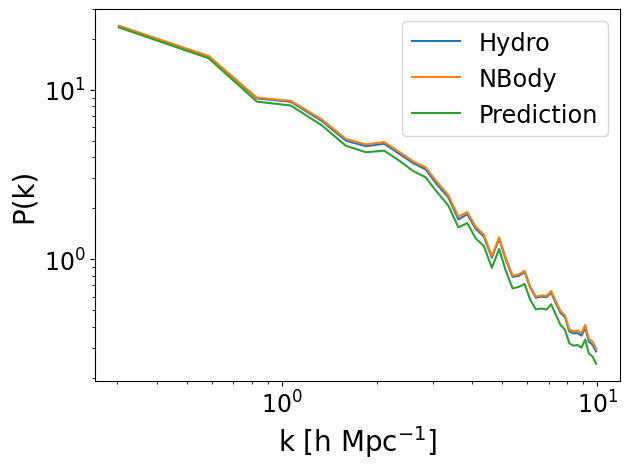

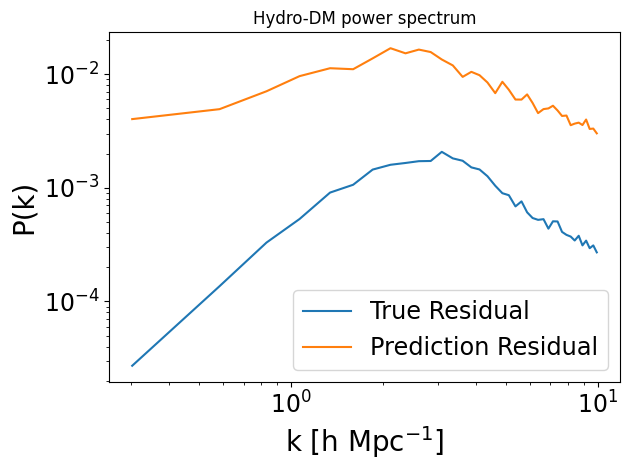

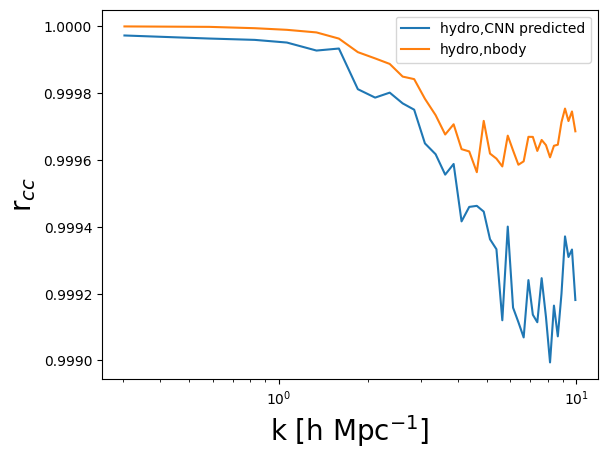

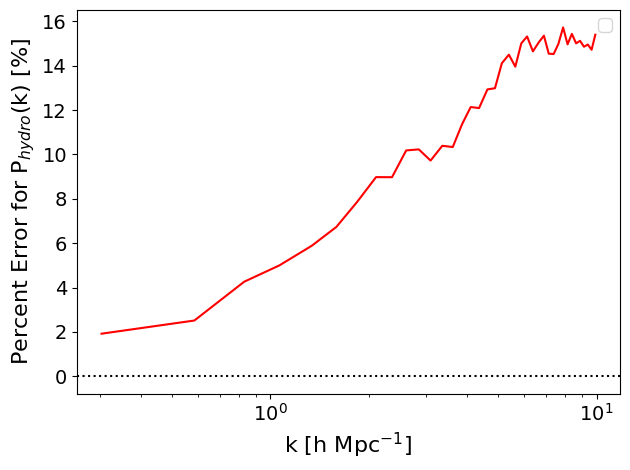

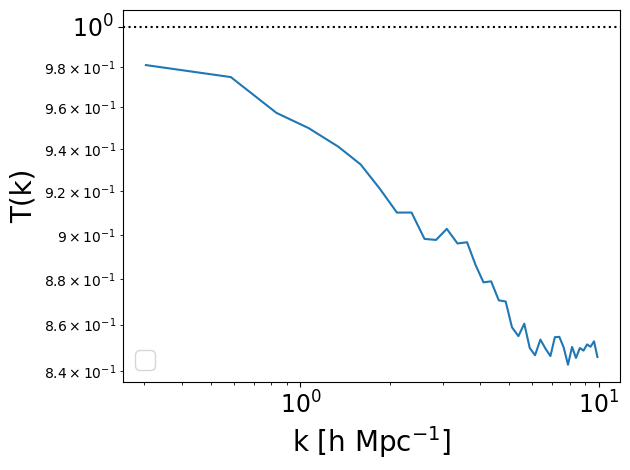

suite: Astrid
no high pass


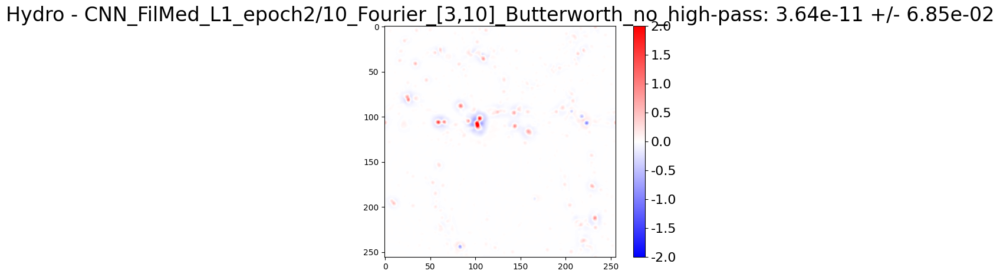

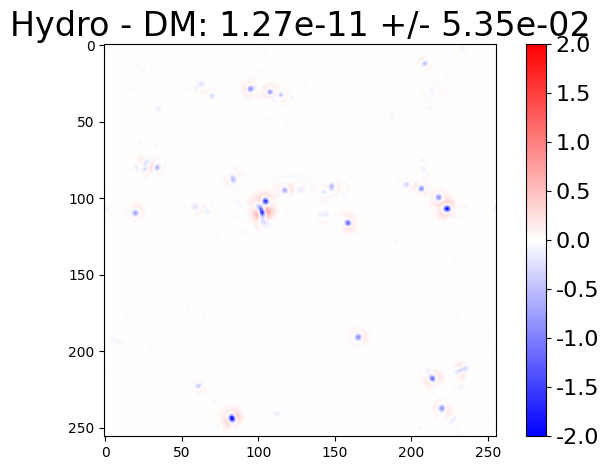

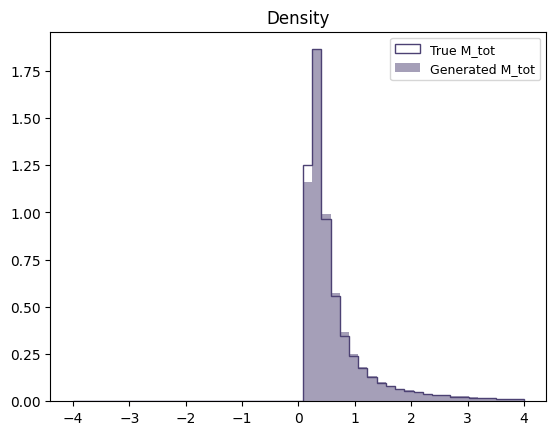


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


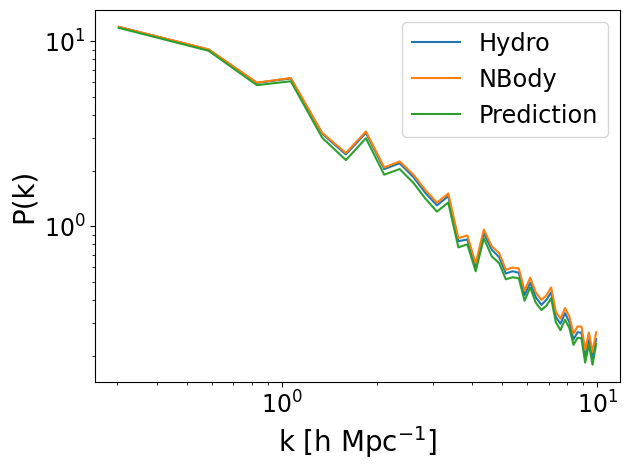

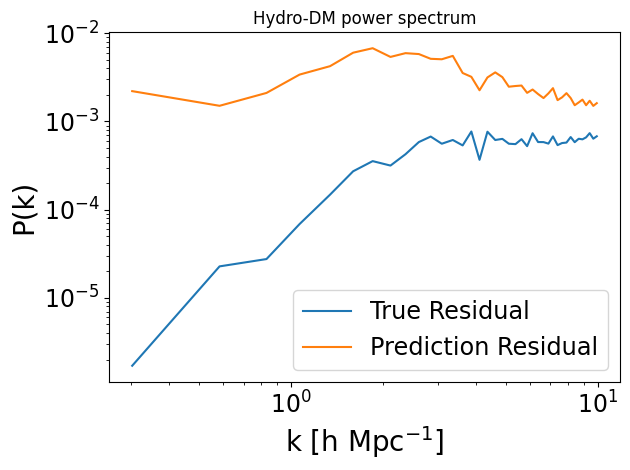

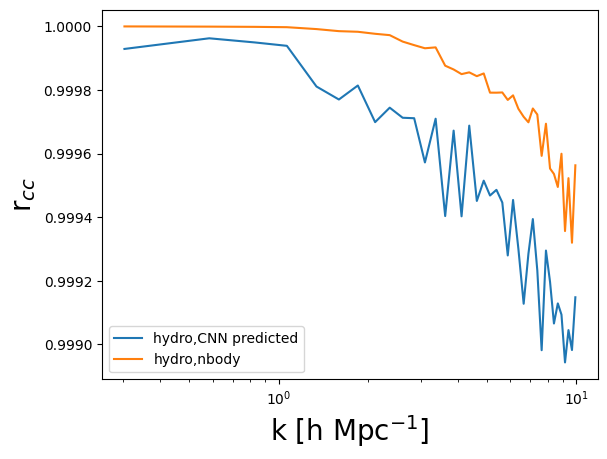

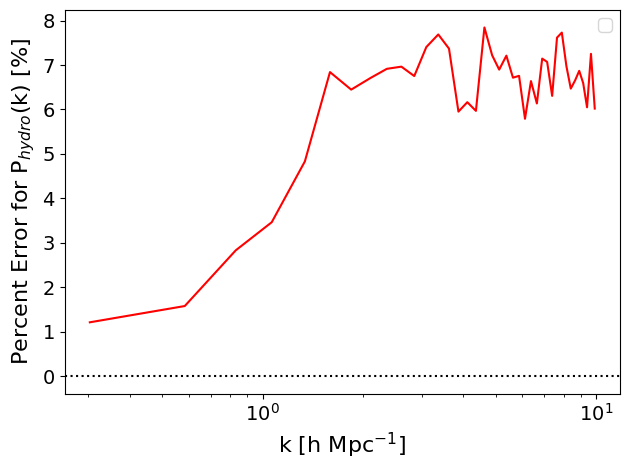

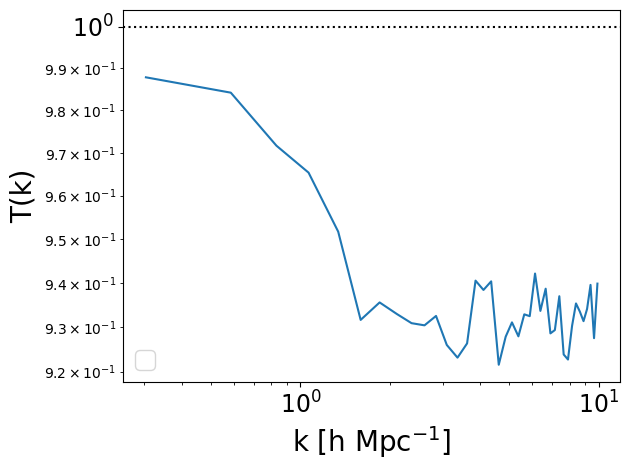

suite: Astrid
no high pass


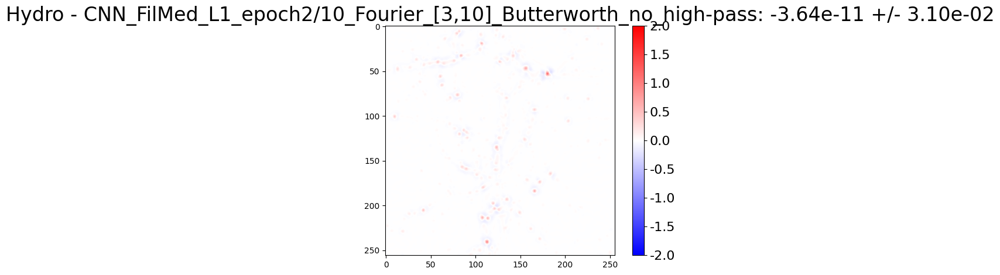

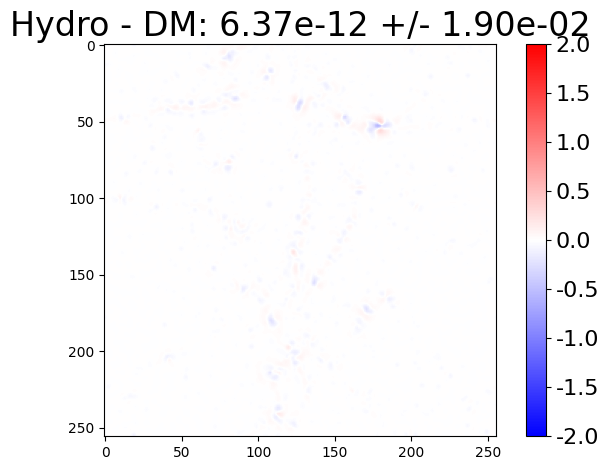

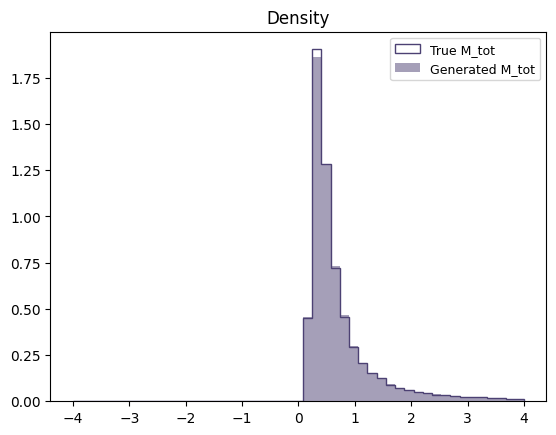


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


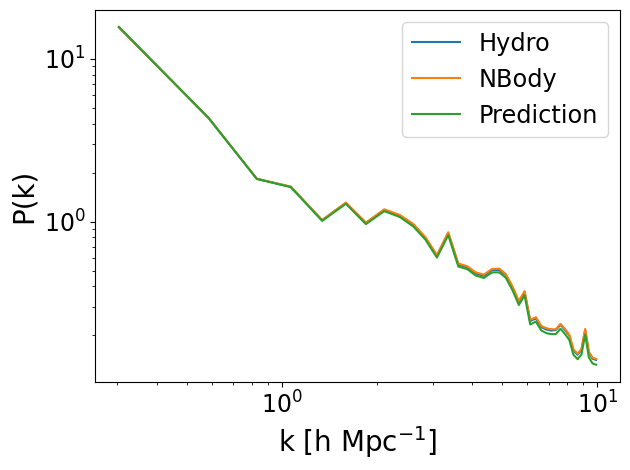

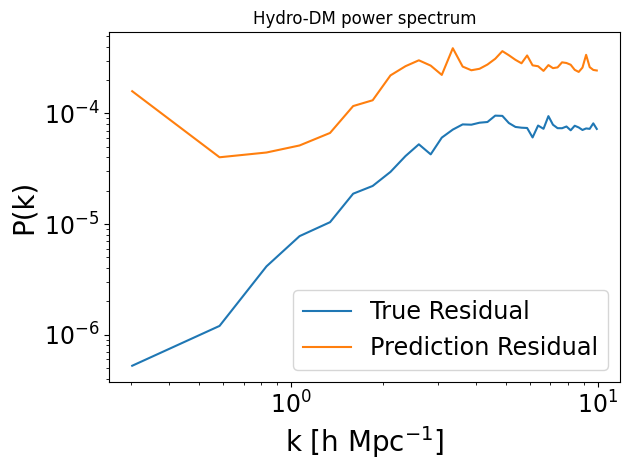

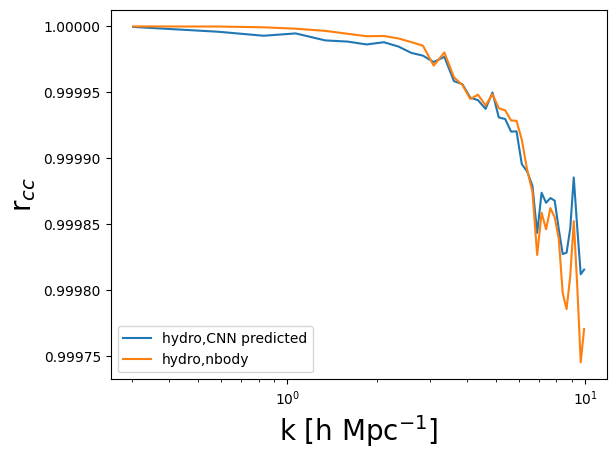

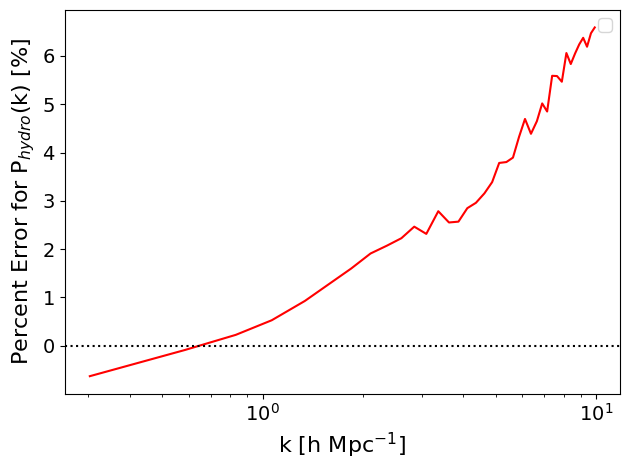

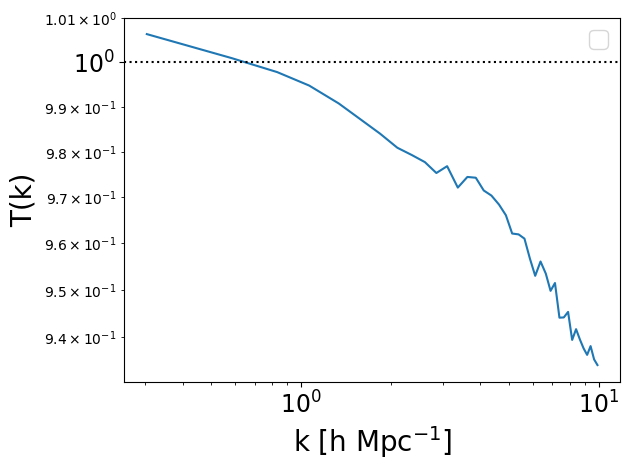

suite: Astrid
no high pass


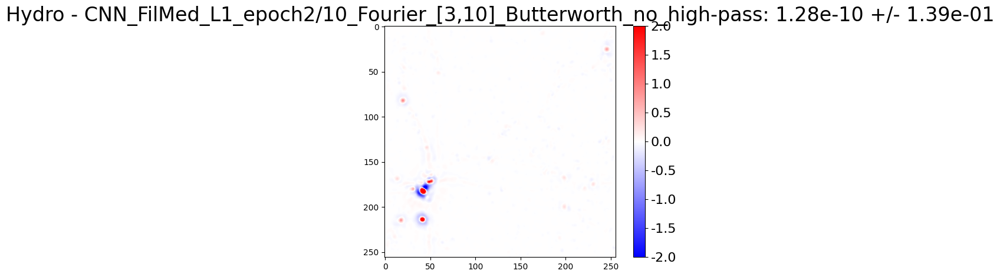

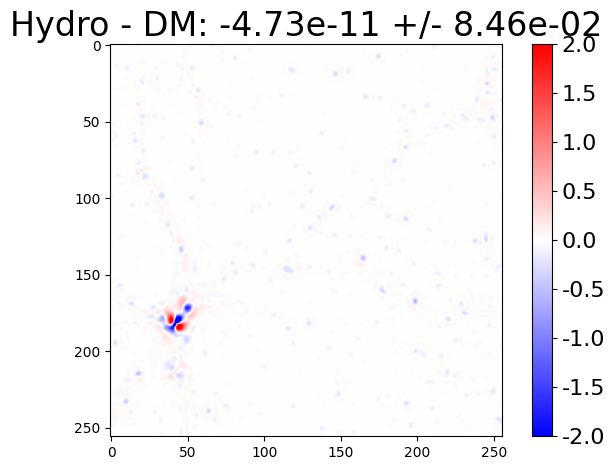

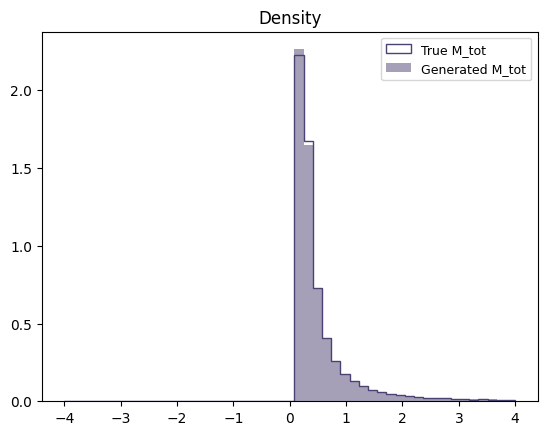


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


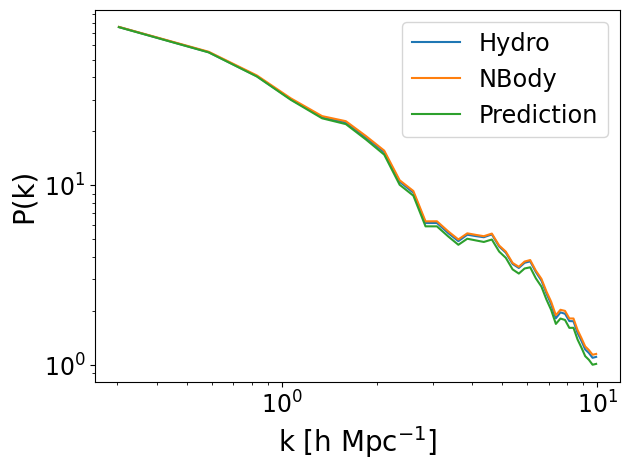

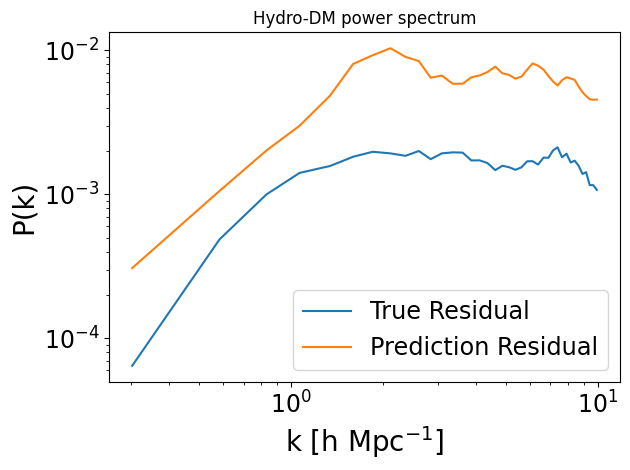

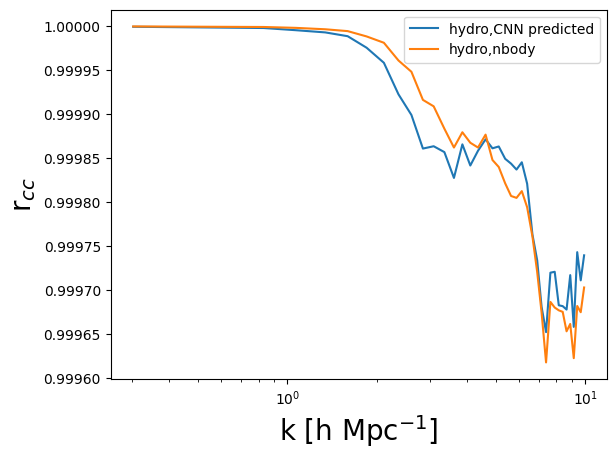

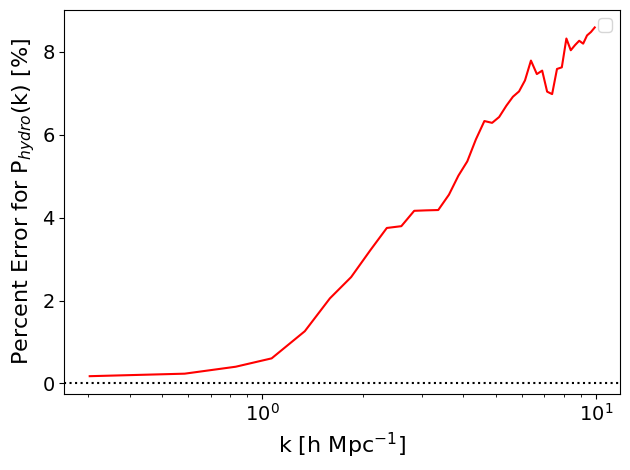

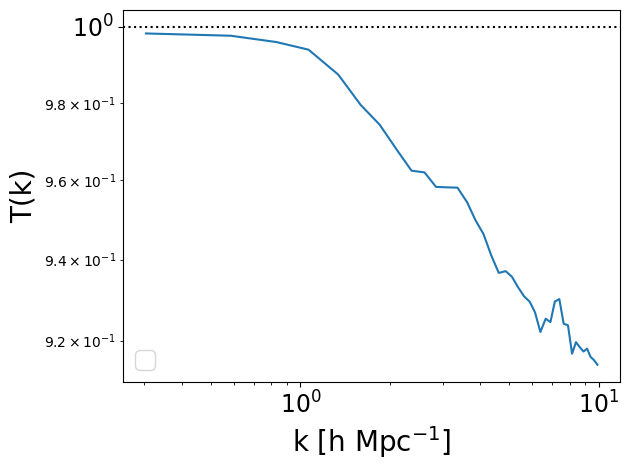

suite: Astrid
no high pass


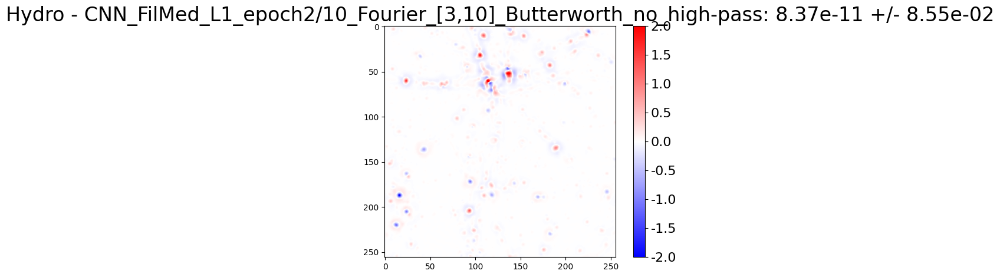

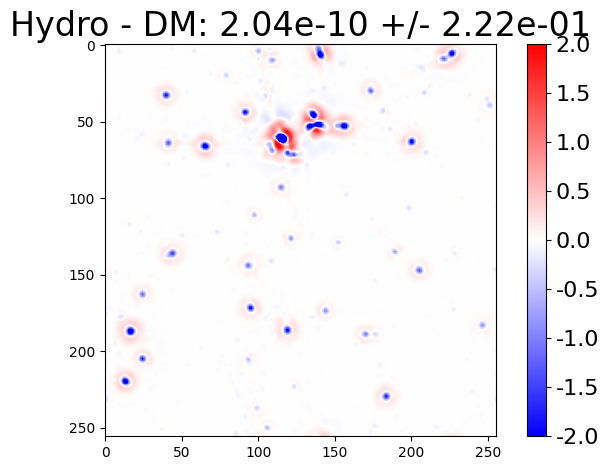

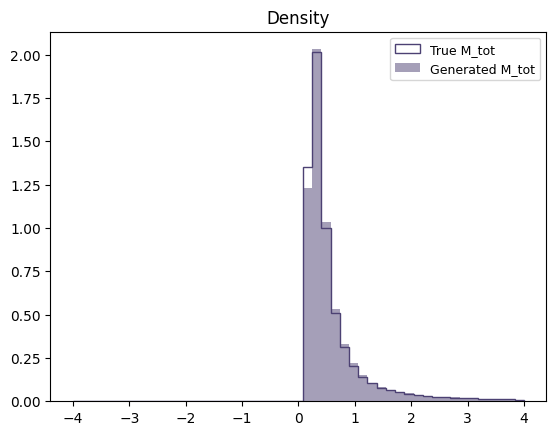


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


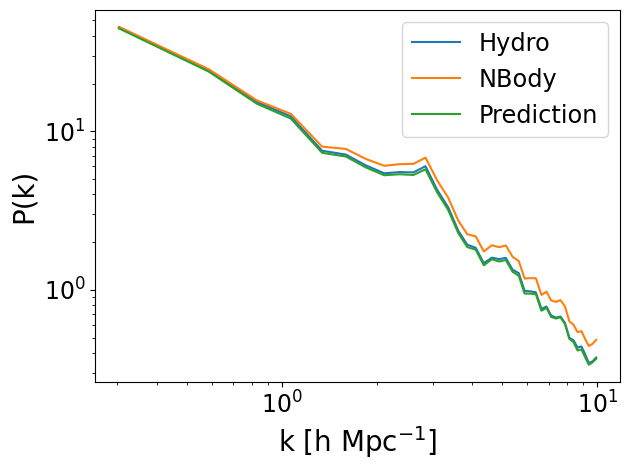

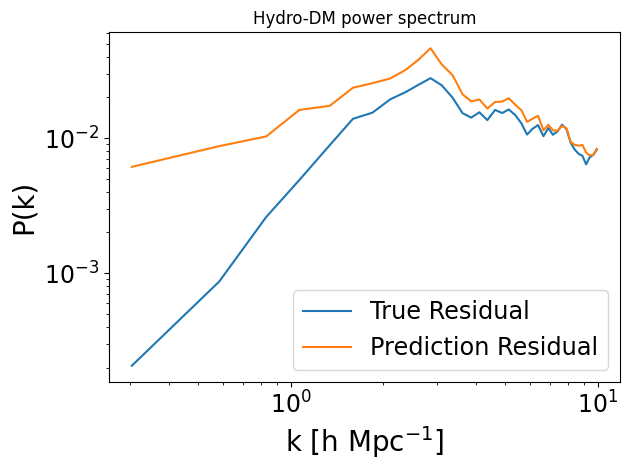

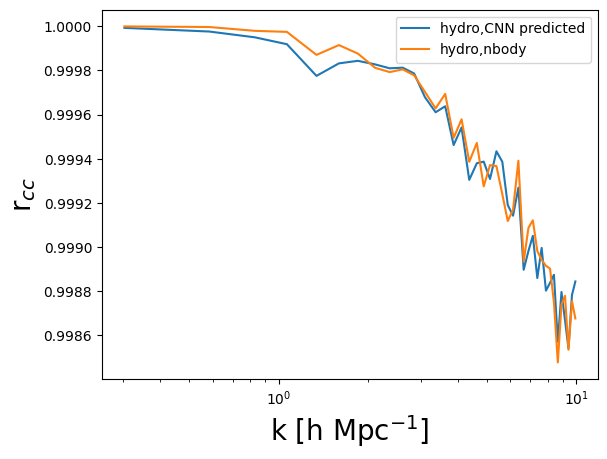

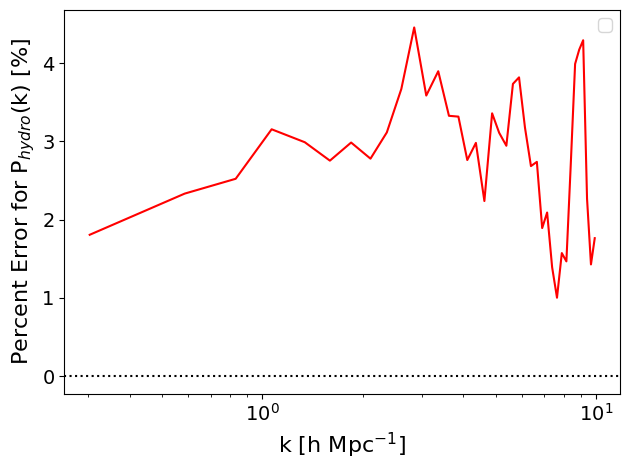

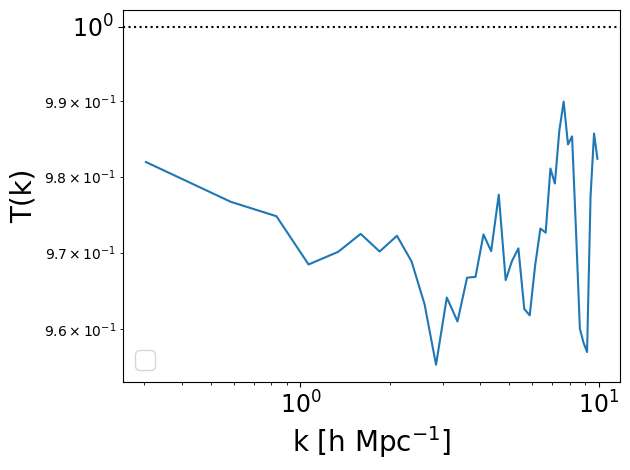

suite: Astrid
no high pass


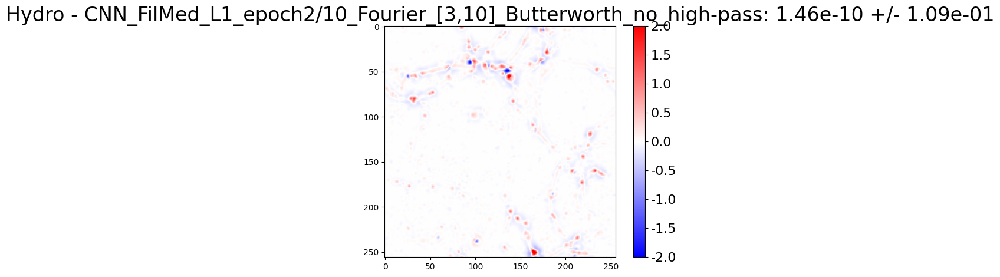

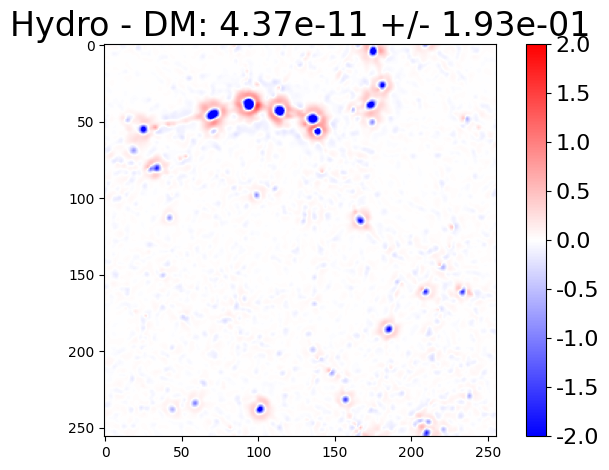

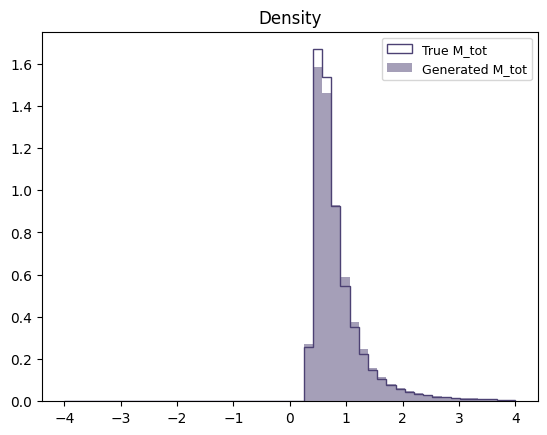


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


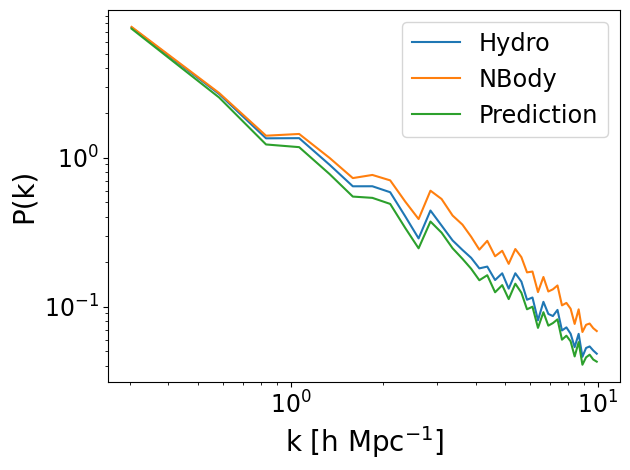

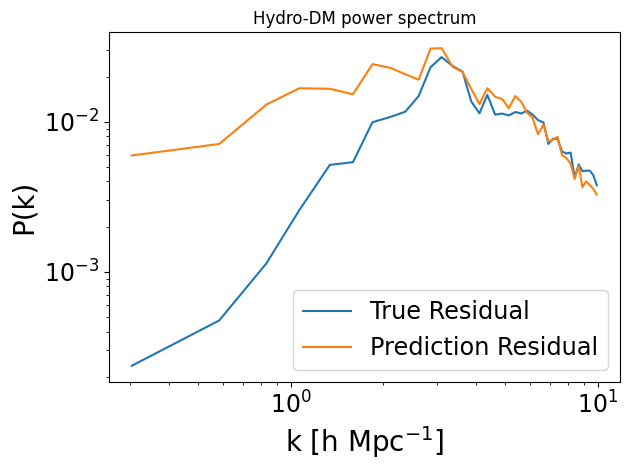

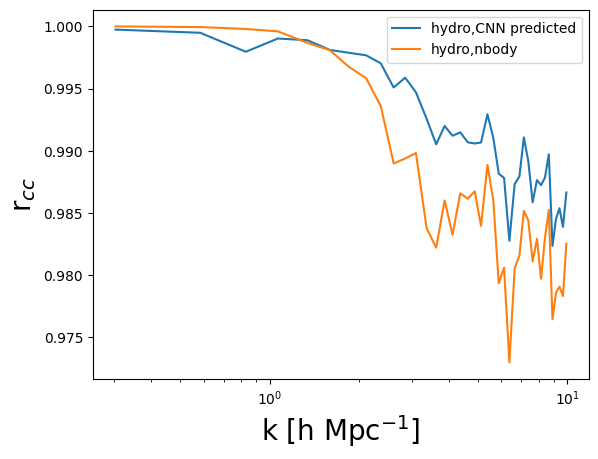

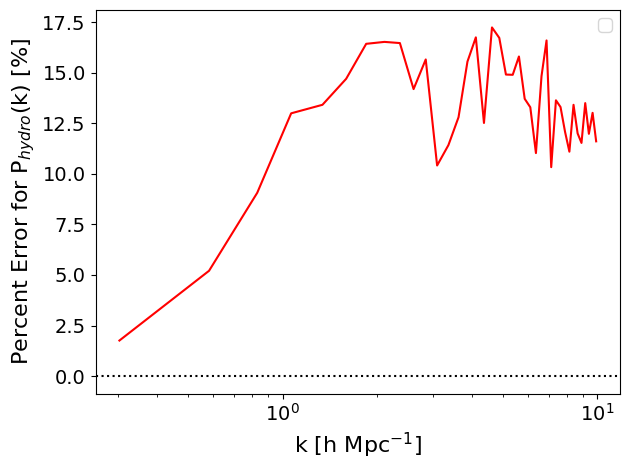

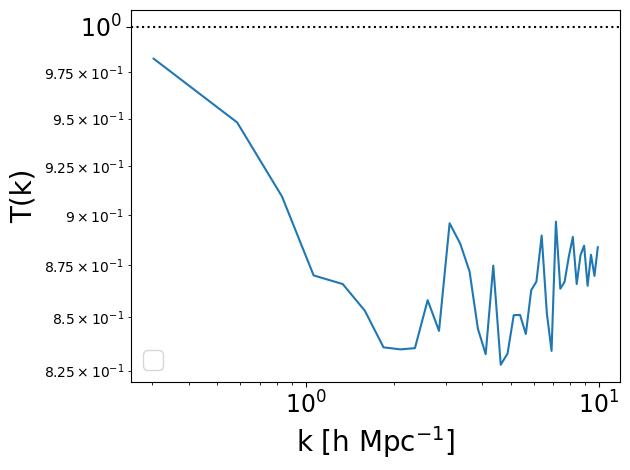

suite: Astrid
no high pass


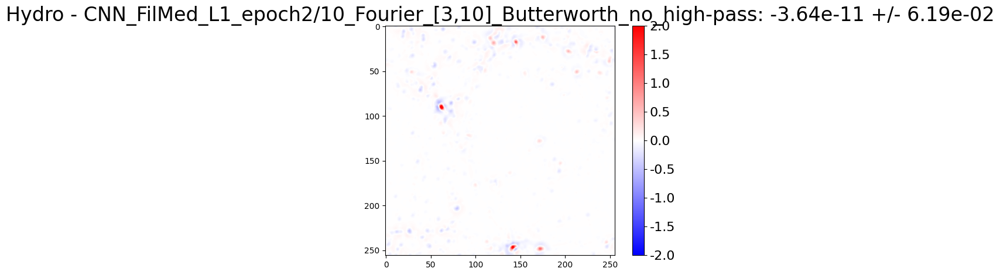

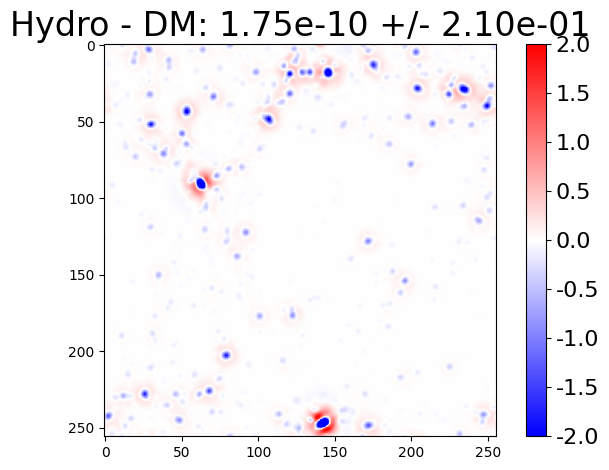

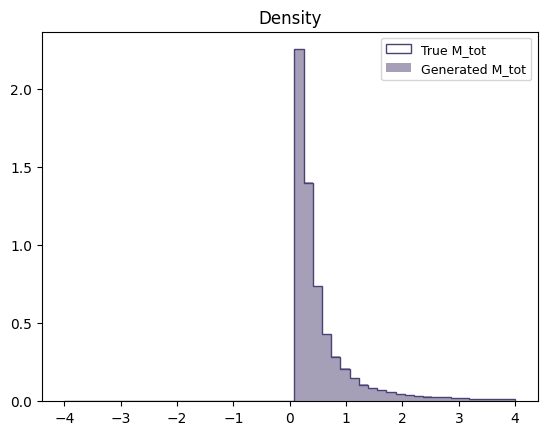


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


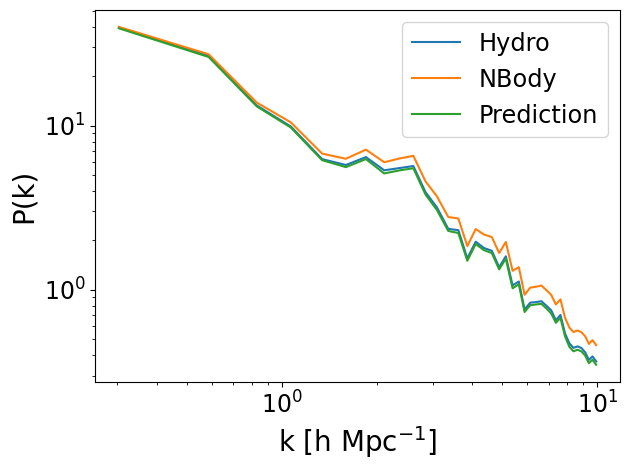

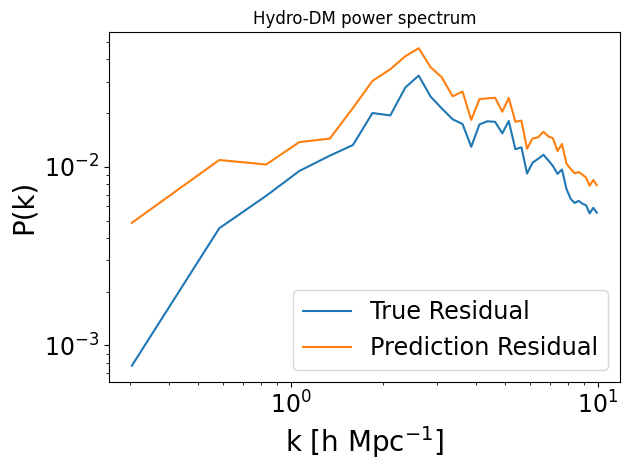

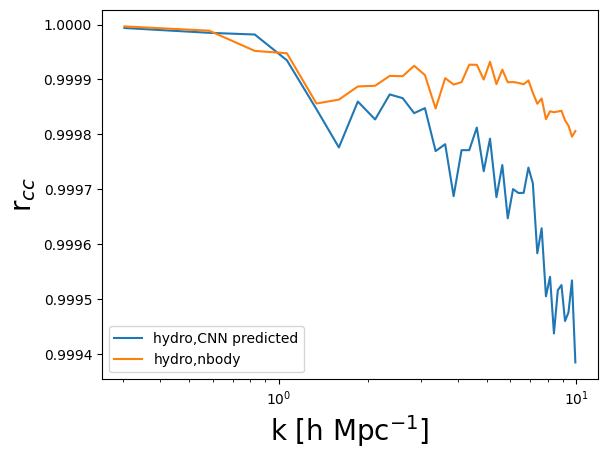

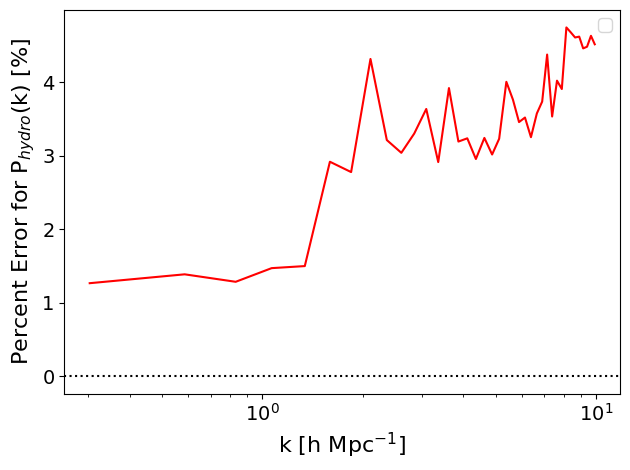

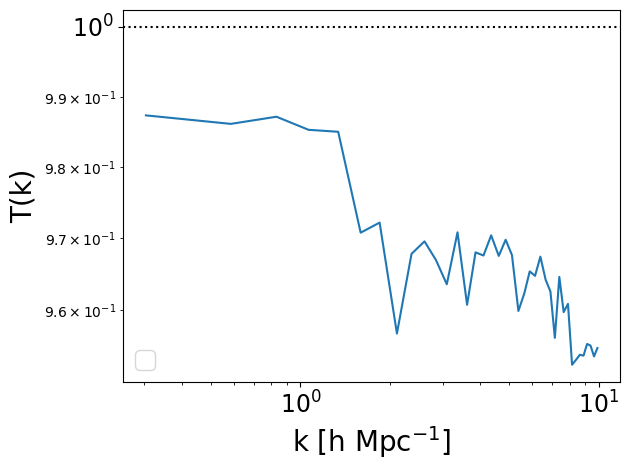

suite: Astrid
no high pass


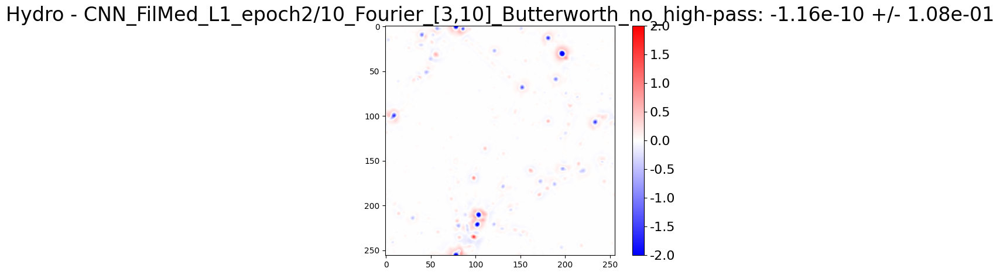

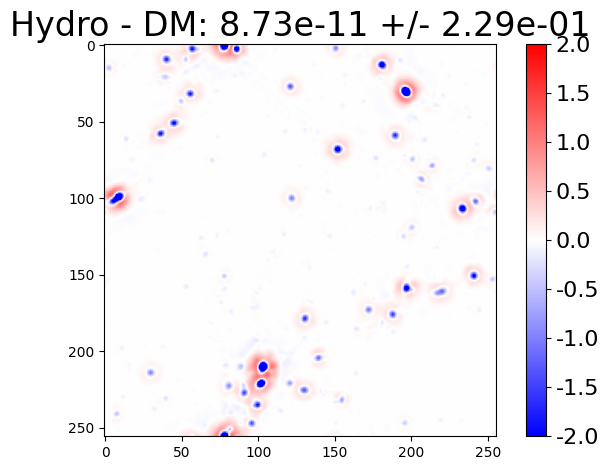

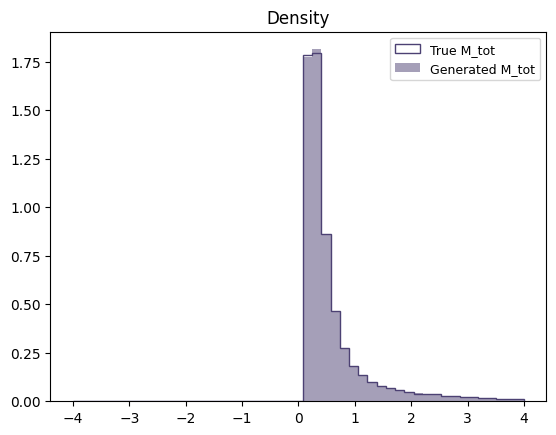


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


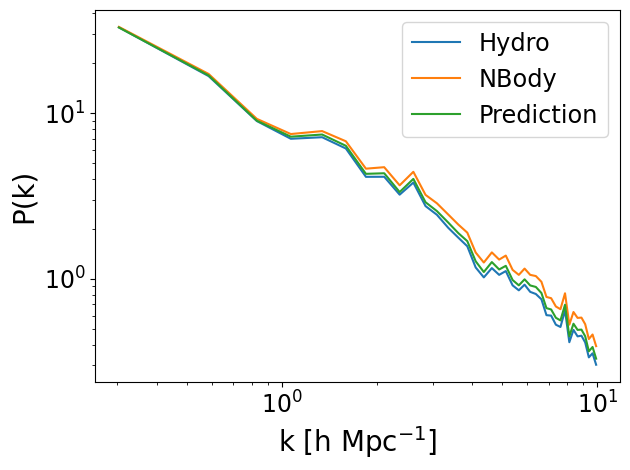

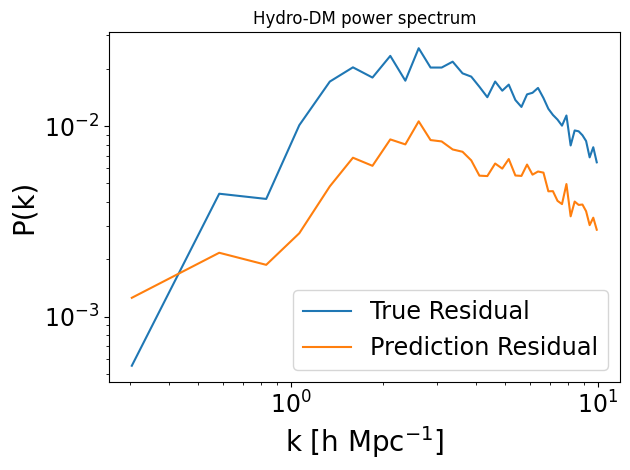

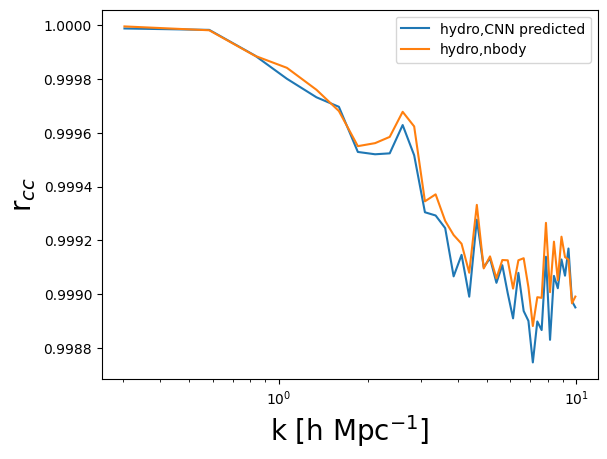

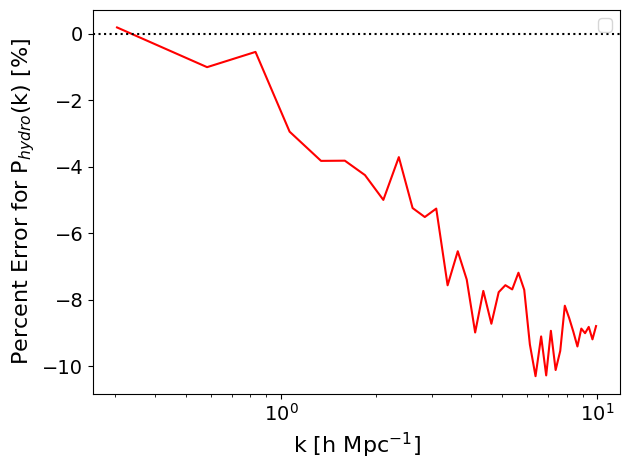

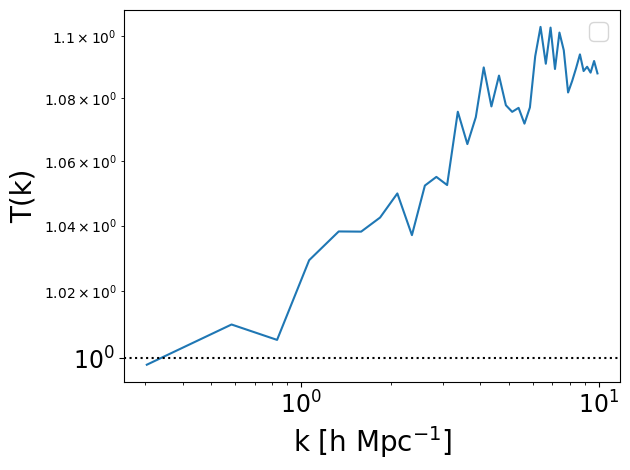

suite: Astrid
no high pass


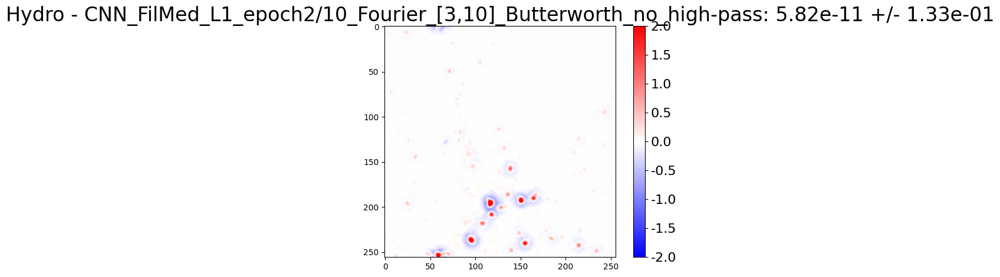

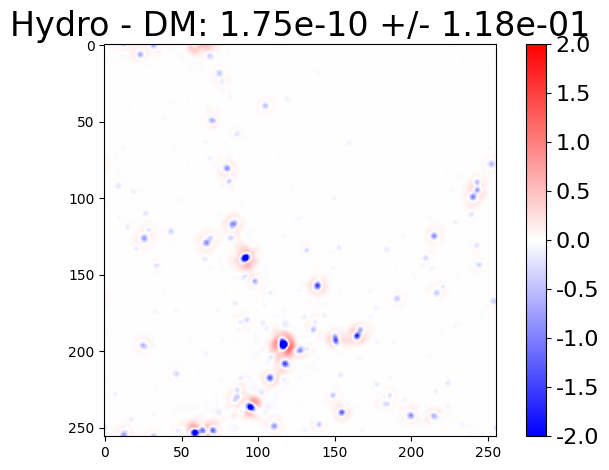

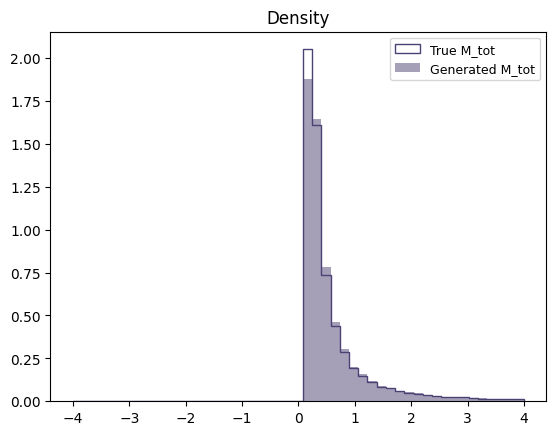


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


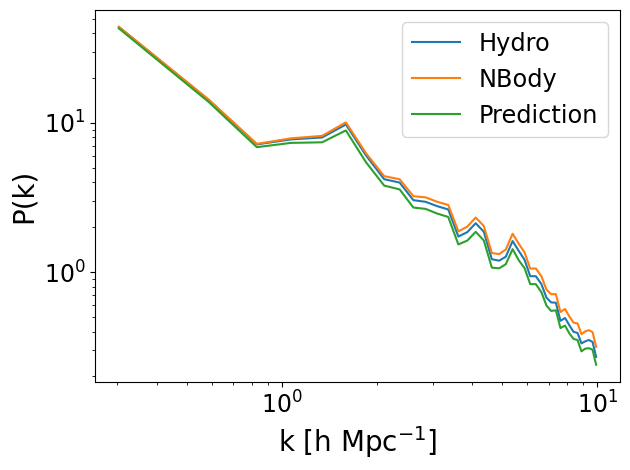

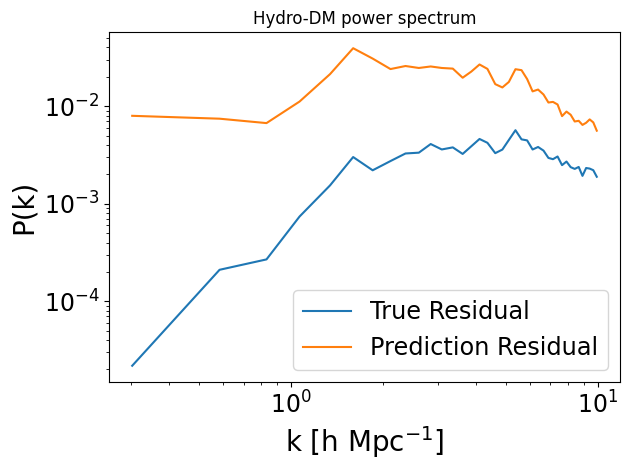

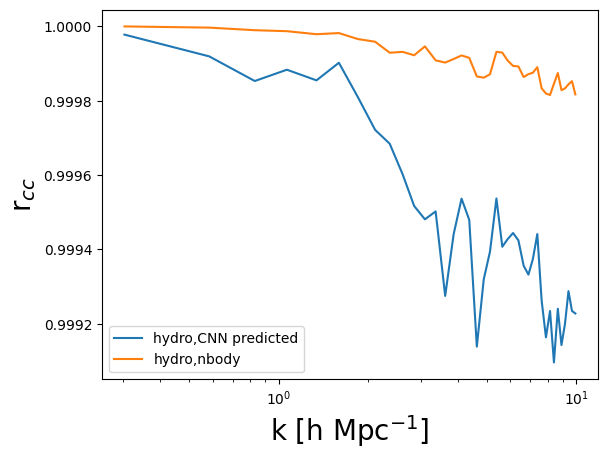

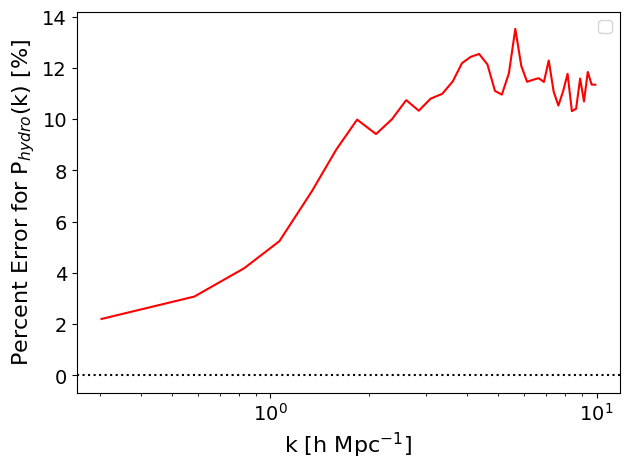

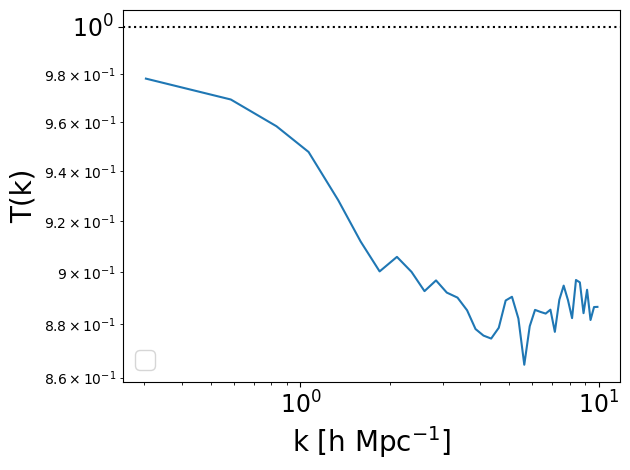

suite: Astrid
no high pass


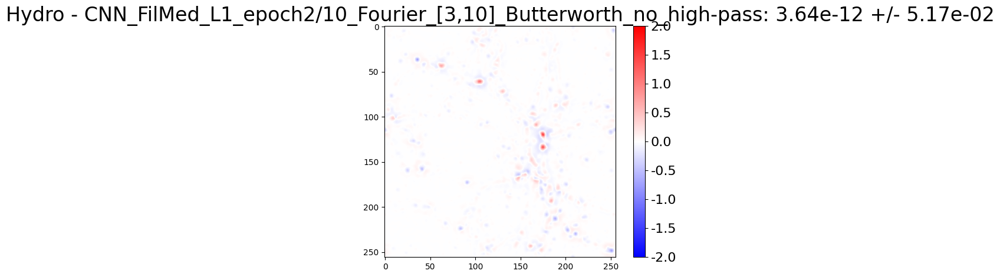

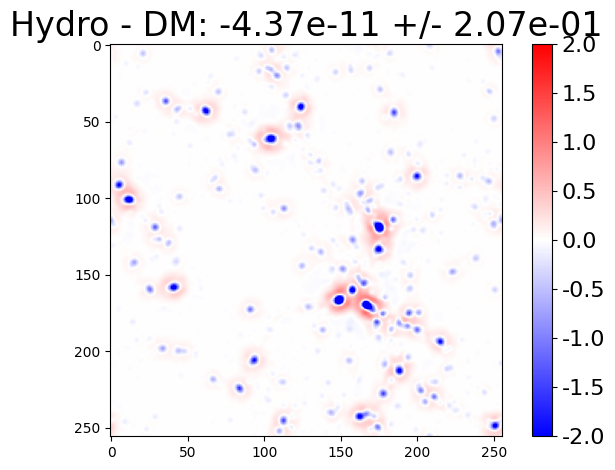

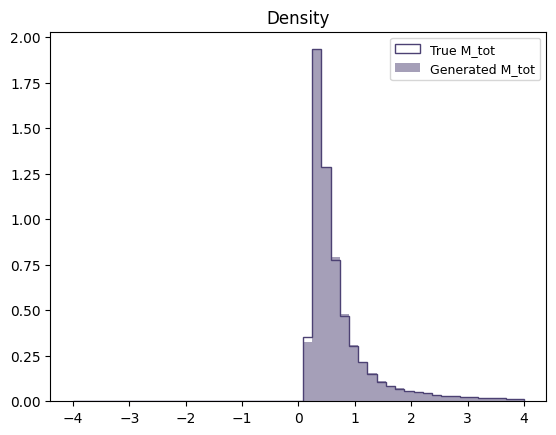


Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds

Computing power spectra of the fields...
Time FFTS = 0.00
Time loop = 0.01
Time taken = 0.01 seconds


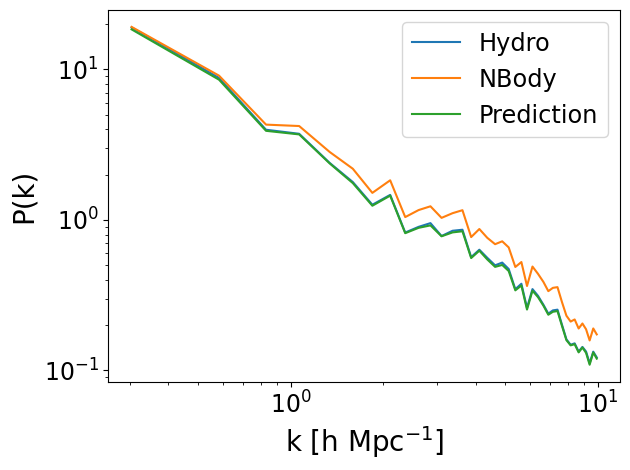

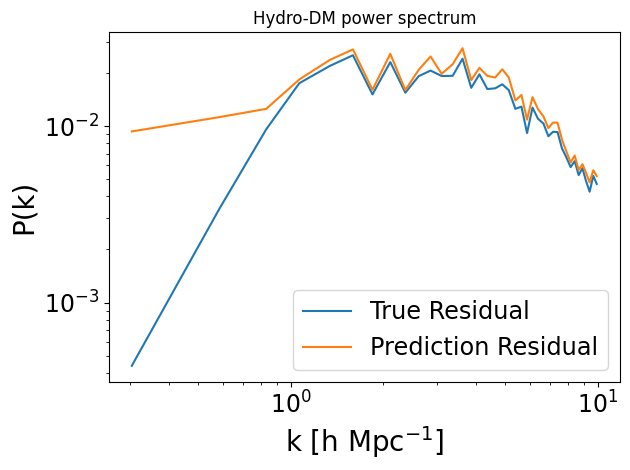

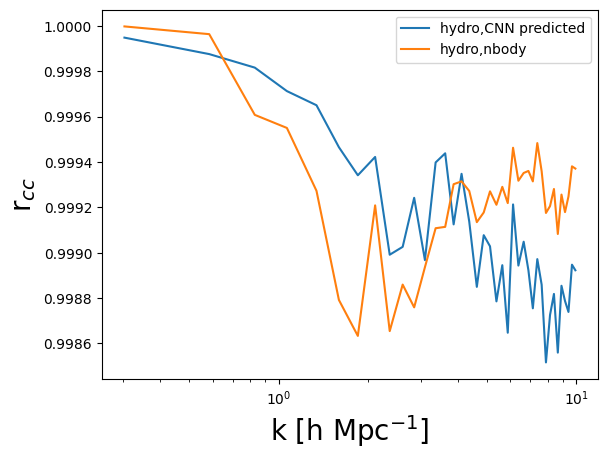

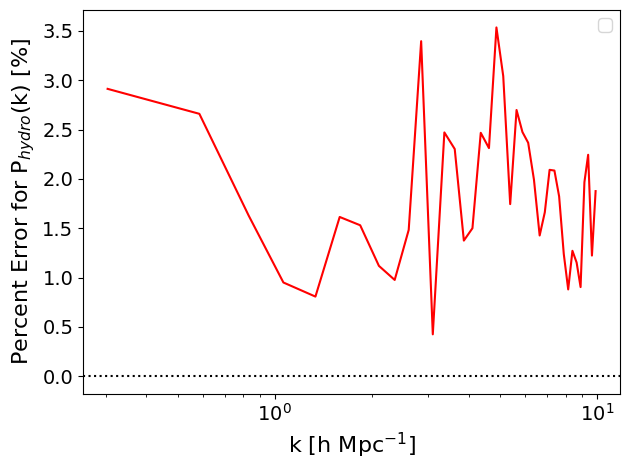

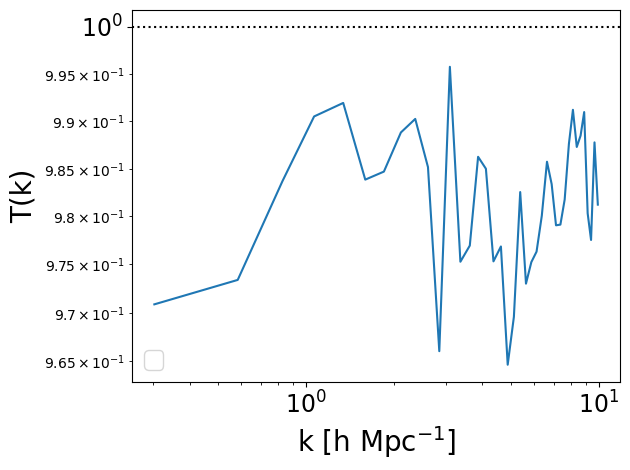

In [43]:
grid    = 256     #the map will have grid^2 pixels
BoxSize = 25 #Mpc/h
MAS     = 'None'  #MAS used to create the image; 'NGP', 'CIC', 'TSC', 'PCS' o 'None'
threads = 1       #number of openmp threads
axis = 0
verbose = False
model = 'CNN_FilMed_L1_epoch2/10_Fourier_[3,10]_Butterworth_no_high-pass'
kx = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
ky = torch.fft.fftfreq(grid, d=1. / (grid * 2 * np.pi / BoxSize))
kx, ky = torch.meshgrid(kx, ky, indexing="ij")
k = torch.sqrt(kx**2 + ky**2)
    
# Apply the low-pass filter
order = 2 
low_pass = 1 / (1 + (k / 10)**(2 * order))
high_pass = 1 / (1 + (3 / k)**(2 * order))
filter_mask = low_pass*high_pass
    
# Perform Fourier transform, apply filter, and inverse transform
#filtered_image = fft.ifft2(fft.fft2(image) * filter_mask).real

simulations = np.arange(0, 300, 20)
for i in simulations:
    conditioning, params, target = dm_25_thick.test_data[i]
    residual_grid, postTF_grid = applyCNN(conditioning[np.newaxis,:], cond=True, params = params[np.newaxis,:]) #path_UNet_Film_10_epochs_ONLY_fourier_loss_3_10_zeros_elsewhere

        
    diff = target.reshape(256,256) - residual_grid.reshape(256,256)
    diff = fft.ifft2(fft.fft2(diff) * filter_mask).real
    im = plt.imshow(diff.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - {model}: {diff.mean():.2e} +/- {diff.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    true = target.reshape(256,256)
    true = fft.ifft2(fft.fft2(true) * filter_mask).real
    im = plt.imshow(true.detach().numpy(), cmap=cmap, vmin=vmin, vmax=vmax)
    cbar = plt.colorbar(im, format=FormatStrFormatter('%.1f'))
    cbar.ax.tick_params(labelsize=16)
    plt.title(f'Hydro - DM: {true.mean():.2e} +/- {true.std():.2e}', fontsize=24)
    plt.tight_layout()
    plt.show()

    plt.hist((conditioning+target).detach().flatten(), bins=np.linspace(-4, 4, 50), histtype='step', color='#4c4173', label="True M_tot", density=True)
    plt.hist(postTF_grid.detach().flatten(), bins=np.linspace(-4, 4, 50), alpha=0.5, color='#4c4173', label="Generated M_tot", density=True)
    plt.legend(fontsize=9)
    plt.title("Density")
    plt.show()

    Pk2D_hydro = PKL.Pk_plane((conditioning+target-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose)
    Pk2D_Nbody = PKL.Pk_plane((conditioning-1).detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_postTF = PKL.Pk_plane((postTF_grid-1).detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    Pk2D_res = PKL.Pk_plane(residual_grid.detach().numpy().reshape([256,256]), BoxSize,  MAS, threads, verbose)
    Pk2D_res_true = PKL.Pk_plane(target.detach().numpy().reshape([256,256]), BoxSize, MAS, threads, verbose) 
    k_Hydro   = Pk2D_hydro.k
    Pk_Hydro   = Pk2D_hydro.Pk
    k_NBody   = Pk2D_Nbody.k
    Pk_NBody   = Pk2D_Nbody.Pk
    k_postTF   = Pk2D_postTF.k
    Pk_postTF   = Pk2D_postTF.Pk
    k_res   = Pk2D_res.k
    Pk_res   = Pk2D_res.Pk
    k_res_true   = Pk2D_res_true.k
    Pk_res_true   = Pk2D_res_true.Pk
    #post-fit Cross-correlation -- more wiggly, slightly under saved Rcc from k~8
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(postTF_grid-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc   = Pkcc.k
    Pk0_X = Pkcc.r
    Pkcc = PKL.XPk_plane((conditioning+target-1).detach().numpy().reshape([256,256]),(conditioning-1).detach().numpy().reshape([256,256]),  BoxSize, MAS,MAS, threads=1) 
    kcc_true   = Pkcc.k
    Pk0_X_true = Pkcc.r
    
    plt.figure()
    mask = k_Hydro <= 10
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_Hydro[mask], Pk_Hydro[mask], label='Hydro')
    plt.plot(k_NBody[mask], Pk_NBody[mask], label='NBody')
    plt.plot(k_postTF[mask], Pk_postTF[mask], label = 'Prediction')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()
    
    plt.figure()
    # Apply the mask to filter k values and P(k) values
    plt.plot(k_res_true[mask], Pk_res_true[mask], label='True Residual')
    plt.plot(k_res[mask], Pk_res[mask], label = 'Prediction Residual')    
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'P(k)', fontsize=20)
    plt.title('Hydro-DM power spectrum')
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    plt.show()
    
    plt.figure()
    plt.plot(kcc[kcc <= 10], Pk0_X[kcc <= 10],label = f'hydro,CNN predicted')
    plt.plot(kcc_true[kcc <= 10], Pk0_X_true[kcc <= 10],label = f'hydro,nbody')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'r$_{cc}$', fontsize=20)
    plt.legend()
    plt.show()
    
    error = 100*(Pk_Hydro-Pk_postTF)/Pk_Hydro
    plt.plot(k_NBody[mask], error[mask], color='r')
    plt.axhline(ls=':',c='k')
    plt.xscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=16)
    plt.ylabel(r'Percent Error for P$_{hydro}$(k) [%]', fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14) 
    plt.legend(fontsize='large')
    plt.tight_layout()
    plt.show()
    
    plt.plot(k_Hydro[mask], (Pk_postTF/Pk_Hydro)[mask])
    plt.axhline(y=1, ls=':',c='k')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel(r'k [h Mpc$^{-1}$]', fontsize=20)
    plt.ylabel(r'T(k)', fontsize=20)
    plt.legend(fontsize='xx-large')
    plt.tight_layout()     
    plt.xticks(fontsize=17)
    plt.yticks(fontsize=17)
    plt.tight_layout()
    # plt.savefig('GPemu-PaperPlots/{}_{}_{}_z={}_fl_Pk.pdf'.format(sim, s, res, z))
    plt.show()

In [39]:
print(k_postTF)

[ 0.30337902  0.58437161  0.83117282  1.0653402   1.33925157  1.59278167
  1.84406617  2.10770235  2.35938611  2.60792049  2.85046149  3.0977842
  3.36484188  3.623149    3.86744896  4.11195997  4.36369547  4.62723537
  4.88084598  5.12402245  5.38505299  5.63522094  5.87766455  6.12362993
  6.38139828  6.64706834  6.8960405   7.13574841  7.38648044  7.63864897
  7.897229    8.15027569  8.40064853  8.65595791  8.90440707  9.15137497
  9.39924595  9.65740701  9.91315087 10.15564772 10.40609783 10.66095909
 10.91892677 11.17361638 11.41875794 11.66592541 11.91609797 12.16908714
 12.42004061 12.67888959 12.9347777  13.18020535 13.42846821 13.67568597
 13.93310319 14.18730039 14.43666601 14.68502191 14.93441804 15.18848056
 15.44327929 15.6968549  15.94675748 16.19341448 16.4466226  16.69779415
 16.94645339 17.20229692 17.45457011 17.70132664 17.94798992 18.20289312
 18.45917104 18.71177387 18.96146058 19.21372262 19.46749861 19.71551368
 19.96397183 20.2173861  20.46898201 20.72204934 20.